# 1

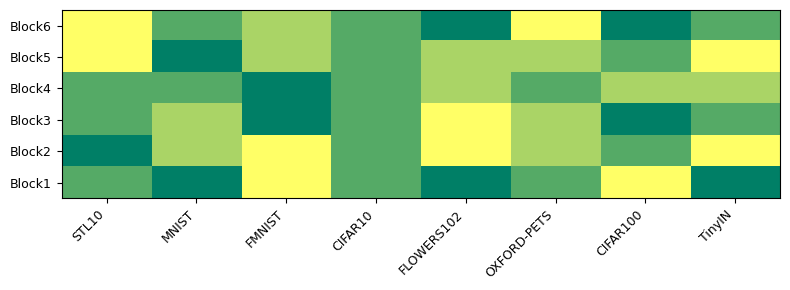

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Define 8 sequences of 6 values from the set {1, 2, 3, 4}
data = np.array([
    [2, 1, 2, 2, 4, 4],
    [1, 3, 3, 2, 1, 2],
    [4, 4, 1, 1, 3, 3],
    [2, 2, 2, 2, 2, 2],
    [1, 4, 4, 3, 3, 1],
    [2, 3, 3, 2, 3, 4],
    [4, 2, 1, 3, 2, 1],
    [1, 4, 2, 3, 4, 2]
])

# Transpose and reverse the row order to flip Y-axis (Blocks)
cmap_data = data.T[::-1]

# Define axis labels
x_labels = ['STL10', 'MNIST', 'FMNIST', 'CIFAR10', 'FLOWERS102', 'OXFORD-PETS', 'CIFAR100', 'TinyIN']
y_labels = [f'Block{i+1}' for i in range(6)][::-1]  # Block6 to Block1

# Create the plot
fig, ax = plt.subplots(figsize=(8, 3))

# Show the data with 'hot' colormap and hard edges
cax = ax.imshow(cmap_data, cmap='summer', aspect='auto', interpolation='none')

# Customize axis ticks
ax.set_xticks(np.arange(len(x_labels)))
ax.set_xticklabels(x_labels, rotation=45, ha='right', fontsize=9)

ax.set_yticks(np.arange(len(y_labels)))
ax.set_yticklabels(y_labels, fontsize=9)

# Final layout adjustments
plt.tight_layout()
plt.show()

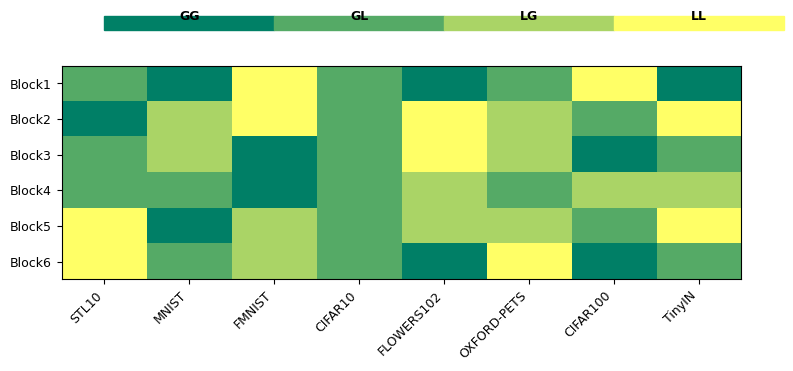

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.colors import ListedColormap, BoundaryNorm

# Define the data
data = np.array([
    [2, 1, 2, 2, 4, 4],
    [1, 3, 3, 2, 1, 2],
    [4, 4, 1, 1, 3, 3],
    [2, 2, 2, 2, 2, 2],
    [1, 4, 4, 3, 3, 1],
    [2, 3, 3, 2, 3, 4],
    [4, 2, 1, 3, 2, 1],
    [1, 4, 2, 3, 4, 2]
])

# Transpose and reverse the row order to flip Y-axis (Blocks)
cmap_data = data.T[::-1]

# Label mapping
label_mapping = {
    1: 'GG',
    2: 'GL',
    3: 'LG',
    4: 'LL'
}

# Use 'summer' colormap for 4 discrete values
cmap = plt.get_cmap('summer', 4)
norm = BoundaryNorm([0.5, 1.5, 2.5, 3.5, 4.5], cmap.N)

# Axis labels
x_labels = ['STL10', 'MNIST', 'FMNIST', 'CIFAR10', 'FLOWERS102', 'OXFORD-PETS', 'CIFAR100', 'TinyIN']
y_labels = [f'Block{i+1}' for i in range(6)][::-1]

# Plotting
fig, ax = plt.subplots(figsize=(8, 4))

# Add labeled color boxes above the heatmap
for i, k in enumerate(label_mapping):
    # Draw colored rectangle
    ax.add_patch(plt.Rectangle(
        (i * 2, 6.5), 2, 0.4, color=cmap(norm(k)), transform=ax.transData, clip_on=False
    ))
    # Add label text
    ax.text(i * 2 + 1, 6.7, label_mapping[k], color='black', ha='center',
            va='bottom', fontsize=9, fontweight='bold', transform=ax.transData)

# Draw the heatmap
cax = ax.imshow(cmap_data, cmap=cmap, norm=norm, aspect='auto', interpolation='none')

# Configure axis ticks and labels
ax.set_xticks(np.arange(len(x_labels)))
ax.set_xticklabels(x_labels, rotation=45, ha='right', fontsize=9)

ax.set_yticks(np.arange(len(y_labels)))
ax.set_yticklabels(y_labels, fontsize=9)

# Adjust viewing limits to make space for labels above
ax.set_ylim(-0.5, 5.5)
ax.set_xlim(-0.5, 7.5)

# Layout
plt.tight_layout()
plt.show()


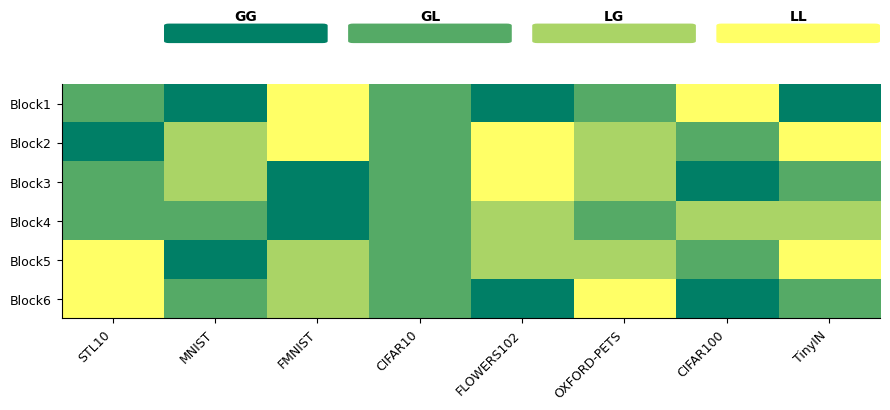

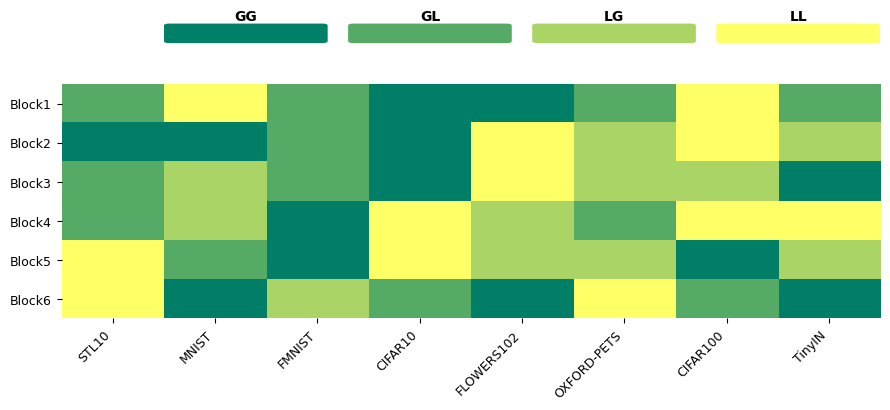

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.colors import ListedColormap, BoundaryNorm
from matplotlib.patches import FancyBboxPatch

# Define the data
data = np.array([
    [2, 1, 2, 2, 4, 4], #STL10
    [4, 1, 3, 3, 2, 1], #MNIST
    [2, 2, 2, 1, 1, 3], #FMNIST
    [1, 1, 1, 4, 4, 2], #CIFAR10
    [1, 4, 4, 3, 3, 1], #FLOWERS102
    [2, 3, 3, 2, 3, 4], #OXFORD-PETS
    [4, 4, 3, 4, 1, 2], #CIFAR100
    [2, 3, 1, 4, 3, 1]  #TinyIN
])

# Flip vertically for heatmap layout
cmap_data = data.T[::-1]

# Value-to-label mapping
label_mapping = {
    1: 'GG',
    2: 'GL',
    3: 'LG',
    4: 'LL'
}

# Define colormap and normalization
cmap = plt.get_cmap('summer', 4)
norm = BoundaryNorm([0.5, 1.5, 2.5, 3.5, 4.5], cmap.N)

# X and Y axis labels
x_labels = ['STL10', 'MNIST', 'FMNIST', 'CIFAR10', 'FLOWERS102', 'OXFORD-PETS', 'CIFAR100', 'TinyIN']
y_labels = [f'Block{i+1}' for i in range(6)][::-1]

# Create figure and axis with transparent background
fig, ax = plt.subplots(figsize=(9, 4.5), facecolor='none')
fig.patch.set_alpha(0.0)
ax.set_facecolor('none')

# Display heatmap
cax = ax.imshow(cmap_data, cmap=cmap, norm=norm, aspect='auto', interpolation='none')

# Draw legend boxes (rounded + aligned)
box_width = 1.5
spacing = 0.3
start_x = (len(x_labels) - (4 * box_width + 3 * spacing)) / 2
legend_y = 6.6

for i, k in enumerate(label_mapping):
    x = start_x + i * (box_width + spacing)
    # Rounded color box
    box = FancyBboxPatch((x, legend_y), box_width, 0.4,
                         boxstyle="round,pad=0.05", edgecolor='none',
                         facecolor=cmap(norm(k)), transform=ax.transData, clip_on=False)
    ax.add_patch(box)
    # Label text
    ax.text(x + box_width / 2, legend_y + 0.46, label_mapping[k],
            ha='center', va='bottom', fontsize=10, fontweight='bold', transform=ax.transData)

# Set axis ticks and labels
ax.set_xticks(np.arange(len(x_labels)))
ax.set_xticklabels(x_labels, rotation=45, ha='right', fontsize=9)

ax.set_yticks(np.arange(len(y_labels)))
ax.set_yticklabels(y_labels, fontsize=9)

# Adjust view limits for spacing
ax.set_ylim(-0.5, 5.5)
ax.set_xlim(-0.5, 7.5)

# Remove borders for clean transparent look
for spine in ax.spines.values():
    spine.set_visible(False)

plt.tight_layout()
plt.savefig("temprature_map")
plt.show()




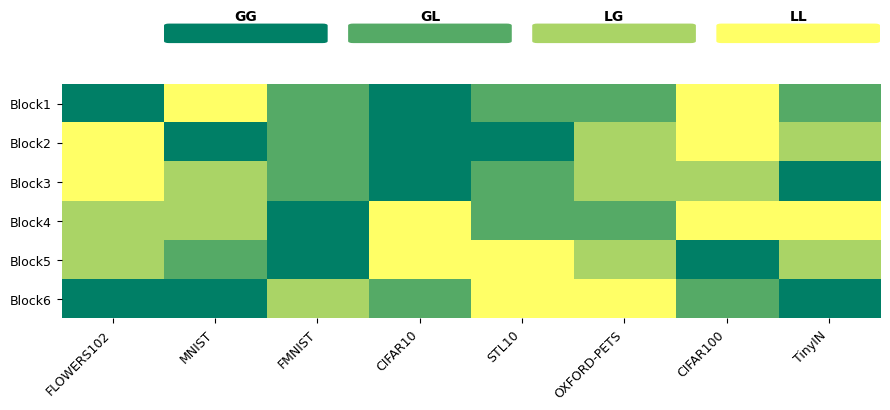

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.colors import ListedColormap, BoundaryNorm
from matplotlib.patches import FancyBboxPatch

# Define the data
data = np.array([
    [1, 4, 4, 3, 3, 1], #FLOWERS102
    [4, 1, 3, 3, 2, 1], #MNIST
    [2, 2, 2, 1, 1, 3], #FMNIST
    [1, 1, 1, 4, 4, 2], #CIFAR10
    [2, 1, 2, 2, 4, 4], #STL10
    [2, 3, 3, 2, 3, 4], #OXFORD-PETS
    [4, 4, 3, 4, 1, 2], #CIFAR100
    [2, 3, 1, 4, 3, 1]  #TinyIN
])

# Flip vertically for heatmap layout
cmap_data = data.T[::-1]

# Value-to-label mapping
label_mapping = {
    1: 'GG',
    2: 'GL',
    3: 'LG',
    4: 'LL'
}

# Define colormap and normalization
cmap = plt.get_cmap('summer', 4)
norm = BoundaryNorm([0.5, 1.5, 2.5, 3.5, 4.5], cmap.N)

# X and Y axis labels
x_labels = ['FLOWERS102', 'MNIST', 'FMNIST', 'CIFAR10', 'STL10', 'OXFORD-PETS', 'CIFAR100', 'TinyIN']
y_labels = [f'Block{i+1}' for i in range(6)][::-1]

# Create figure and axis with transparent background
fig, ax = plt.subplots(figsize=(9, 4.5), facecolor='none')
fig.patch.set_alpha(0.0)
ax.set_facecolor('none')

# Display heatmap
cax = ax.imshow(cmap_data, cmap=cmap, norm=norm, aspect='auto', interpolation='none')

# Draw legend boxes (rounded + aligned)
box_width = 1.5
spacing = 0.3
start_x = (len(x_labels) - (4 * box_width + 3 * spacing)) / 2
legend_y = 6.6

for i, k in enumerate(label_mapping):
    x = start_x + i * (box_width + spacing)
    # Rounded color box
    box = FancyBboxPatch((x, legend_y), box_width, 0.4,
                         boxstyle="round,pad=0.05", edgecolor='none',
                         facecolor=cmap(norm(k)), transform=ax.transData, clip_on=False)
    ax.add_patch(box)
    # Label text
    ax.text(x + box_width / 2, legend_y + 0.46, label_mapping[k],
            ha='center', va='bottom', fontsize=10, fontweight='bold', transform=ax.transData)

# Set axis ticks and labels
ax.set_xticks(np.arange(len(x_labels)))
ax.set_xticklabels(x_labels, rotation=45, ha='right', fontsize=9)

ax.set_yticks(np.arange(len(y_labels)))
ax.set_yticklabels(y_labels, fontsize=9)

# Adjust view limits for spacing
ax.set_ylim(-0.5, 5.5)
ax.set_xlim(-0.5, 7.5)

# Remove borders for clean transparent look
for spine in ax.spines.values():
    spine.set_visible(False)

plt.tight_layout()
plt.savefig("temprature_map")
plt.show()




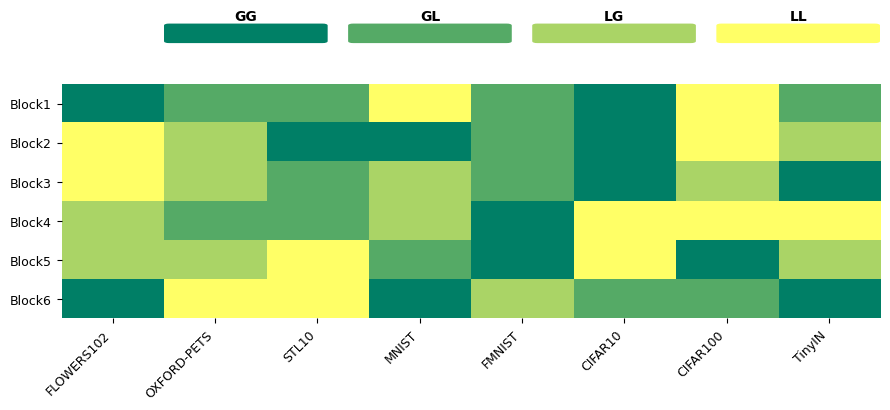

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.colors import ListedColormap, BoundaryNorm
from matplotlib.patches import FancyBboxPatch

# Define the data
data = np.array([
    [1, 4, 4, 3, 3, 1], #FLOWERS102
    [2, 3, 3, 2, 3, 4], #OXFORD-PETS
    [2, 1, 2, 2, 4, 4], #STL10
    [4, 1, 3, 3, 2, 1], #MNIST
    [2, 2, 2, 1, 1, 3], #FMNIST
    [1, 1, 1, 4, 4, 2], #CIFAR10
    [4, 4, 3, 4, 1, 2], #CIFAR100
    [2, 3, 1, 4, 3, 1]  #TinyIN
])

# Flip vertically for heatmap layout
cmap_data = data.T[::-1]

# Value-to-label mapping
label_mapping = {
    1: 'GG',
    2: 'GL',
    3: 'LG',
    4: 'LL'
}

# Define colormap and normalization
cmap = plt.get_cmap('summer', 4)
norm = BoundaryNorm([0.5, 1.5, 2.5, 3.5, 4.5], cmap.N)

# X and Y axis labels
x_labels = ['FLOWERS102', 'OXFORD-PETS', 'STL10', 'MNIST', 'FMNIST', 'CIFAR10', 'CIFAR100', 'TinyIN']
y_labels = [f'Block{i+1}' for i in range(6)][::-1]

# Create figure and axis with transparent background
fig, ax = plt.subplots(figsize=(9, 4.5), facecolor='none')
fig.patch.set_alpha(0.0)
ax.set_facecolor('none')

# Display heatmap
cax = ax.imshow(cmap_data, cmap=cmap, norm=norm, aspect='auto', interpolation='none')

# Draw legend boxes (rounded + aligned)
box_width = 1.5
spacing = 0.3
start_x = (len(x_labels) - (4 * box_width + 3 * spacing)) / 2
legend_y = 6.6

for i, k in enumerate(label_mapping):
    x = start_x + i * (box_width + spacing)
    # Rounded color box
    box = FancyBboxPatch((x, legend_y), box_width, 0.4,
                         boxstyle="round,pad=0.05", edgecolor='none',
                         facecolor=cmap(norm(k)), transform=ax.transData, clip_on=False)
    ax.add_patch(box)
    # Label text
    ax.text(x + box_width / 2, legend_y + 0.46, label_mapping[k],
            ha='center', va='bottom', fontsize=10, fontweight='bold', transform=ax.transData)

# Set axis ticks and labels
ax.set_xticks(np.arange(len(x_labels)))
ax.set_xticklabels(x_labels, rotation=45, ha='right', fontsize=9)

ax.set_yticks(np.arange(len(y_labels)))
ax.set_yticklabels(y_labels, fontsize=9)

# Adjust view limits for spacing
ax.set_ylim(-0.5, 5.5)
ax.set_xlim(-0.5, 7.5)

# Remove borders for clean transparent look
for spine in ax.spines.values():
    spine.set_visible(False)

plt.tight_layout()
plt.savefig("temprature_map")
plt.show()




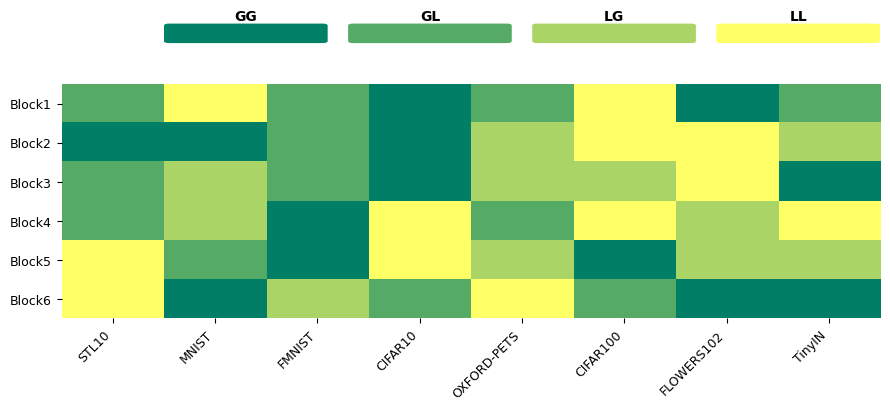

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.colors import ListedColormap, BoundaryNorm
from matplotlib.patches import FancyBboxPatch

# Define the data
data = np.array([
    [2, 1, 2, 2, 4, 4], #STL10
    [4, 1, 3, 3, 2, 1], #MNIST
    [2, 2, 2, 1, 1, 3], #FMNIST
    [1, 1, 1, 4, 4, 2], #CIFAR10
    [2, 3, 3, 2, 3, 4], #OXFORD-PETS
    [4, 4, 3, 4, 1, 2], #CIFAR100
    [1, 4, 4, 3, 3, 1], #FLOWERS102
    [2, 3, 1, 4, 3, 1]  #TinyIN
])

# Flip vertically for heatmap layout
cmap_data = data.T[::-1]

# Value-to-label mapping
label_mapping = {
    1: 'GG',
    2: 'GL',
    3: 'LG',
    4: 'LL'
}

# Define colormap and normalization
cmap = plt.get_cmap('summer', 4)
norm = BoundaryNorm([0.5, 1.5, 2.5, 3.5, 4.5], cmap.N)

# X and Y axis labels
x_labels = ['STL10', 'MNIST', 'FMNIST', 'CIFAR10', 'OXFORD-PETS', 'CIFAR100', 'FLOWERS102', 'TinyIN']
y_labels = [f'Block{i+1}' for i in range(6)][::-1]

# Create figure and axis with transparent background
fig, ax = plt.subplots(figsize=(9, 4.5), facecolor='none')
fig.patch.set_alpha(0.0)
ax.set_facecolor('none')

# Display heatmap
cax = ax.imshow(cmap_data, cmap=cmap, norm=norm, aspect='auto', interpolation='none')

# Draw legend boxes (rounded + aligned)
box_width = 1.5
spacing = 0.3
start_x = (len(x_labels) - (4 * box_width + 3 * spacing)) / 2
legend_y = 6.6

for i, k in enumerate(label_mapping):
    x = start_x + i * (box_width + spacing)
    # Rounded color box
    box = FancyBboxPatch((x, legend_y), box_width, 0.4,
                         boxstyle="round,pad=0.05", edgecolor='none',
                         facecolor=cmap(norm(k)), transform=ax.transData, clip_on=False)
    ax.add_patch(box)
    # Label text
    ax.text(x + box_width / 2, legend_y + 0.46, label_mapping[k],
            ha='center', va='bottom', fontsize=10, fontweight='bold', transform=ax.transData)

# Set axis ticks and labels
ax.set_xticks(np.arange(len(x_labels)))
ax.set_xticklabels(x_labels, rotation=45, ha='right', fontsize=9)

ax.set_yticks(np.arange(len(y_labels)))
ax.set_yticklabels(y_labels, fontsize=9)

# Adjust view limits for spacing
ax.set_ylim(-0.5, 5.5)
ax.set_xlim(-0.5, 7.5)

# Remove borders for clean transparent look
for spine in ax.spines.values():
    spine.set_visible(False)

plt.tight_layout()
plt.savefig("temprature_map")
plt.show()




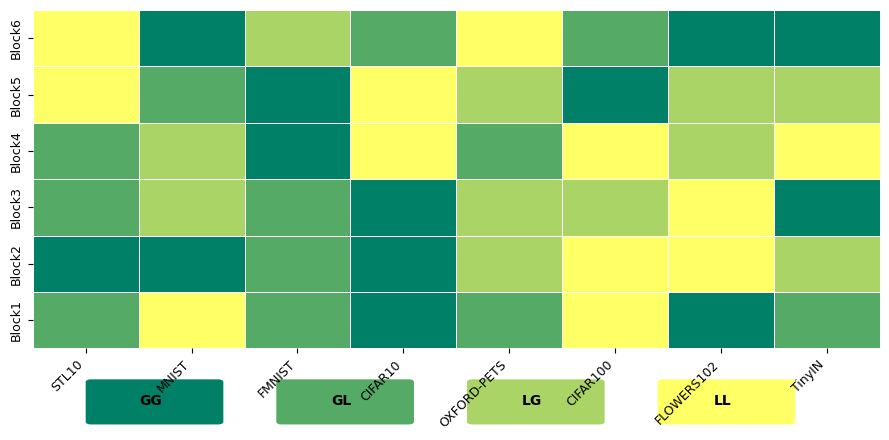

In [ ]:
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap, BoundaryNorm
from matplotlib.patches import FancyBboxPatch

# Define the data
data = np.array([
    [2, 1, 2, 2, 4, 4],  # STL10
    [4, 1, 3, 3, 2, 1],  # MNIST
    [2, 2, 2, 1, 1, 3],  # FMNIST
    [1, 1, 1, 4, 4, 2],  # CIFAR10
    [2, 3, 3, 2, 3, 4],  # OXFORD-PETS
    [4, 4, 3, 4, 1, 2],  # CIFAR100
    [1, 4, 4, 3, 3, 1],  # FLOWERS102
    [2, 3, 1, 4, 3, 1]   # TinyIN
])

# Flip vertically for heatmap layout
cmap_data = data.T[::-1]

# Labels
x_labels = ['STL10', 'MNIST', 'FMNIST', 'CIFAR10', 'OXFORD-PETS', 'CIFAR100', 'FLOWERS102', 'TinyIN']
y_labels = [f'Block{i+1}' for i in range(6)][::-1]

# Value-to-label mapping
label_mapping = {1: 'GG', 2: 'GL', 3: 'LG', 4: 'LL'}

# Create discrete colormap from 'summer'
base_cmap = plt.get_cmap('summer')
colors = base_cmap(np.linspace(0, 1, 4))  # Sample 4 colors
custom_cmap = ListedColormap(colors)
norm = BoundaryNorm([0.5, 1.5, 2.5, 3.5, 4.5], custom_cmap.N)

# Create figure with transparent background
fig, ax = plt.subplots(figsize=(9, 4.5), facecolor='none')
fig.patch.set_alpha(0.0)
ax.set_facecolor('none')

# Draw heatmap using seaborn
sns.heatmap(
    cmap_data,
    ax=ax,
    cmap=custom_cmap,
    cbar=False,
    square=False,
    linewidths=0.5,
    linecolor='white',
    xticklabels=x_labels,
    yticklabels=y_labels,
    norm=norm
)

# Rotate and align x-tick labels
ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right', fontsize=9)
ax.set_yticklabels(ax.get_yticklabels(), fontsize=9)

# Remove spines
for spine in ax.spines.values():
    spine.set_visible(False)

# Add custom legend
box_width = 1.5
spacing = 0.3
start_x = (len(x_labels) - (4 * box_width + 3 * spacing)) / 2
legend_y = 6.6
# legend_y = -1.6
for i, k in enumerate(label_mapping):
    x = start_x + i * (box_width + spacing)
    box = FancyBboxPatch((x, legend_y), box_width-0.3, 0.7,
                         boxstyle="round,pad=0.05", edgecolor='none',
                         facecolor=custom_cmap(norm(k)), transform=ax.transData, clip_on=False)
    ax.add_patch(box)
    ax.text(x + box_width / 2 - 0.185, legend_y + 0.46, label_mapping[k],
            ha='center', va='bottom', fontsize=10, fontweight='bold', transform=ax.transData)

plt.tight_layout()
plt.savefig("temperature_map.png", transparent=True, dpi=300)
plt.show()


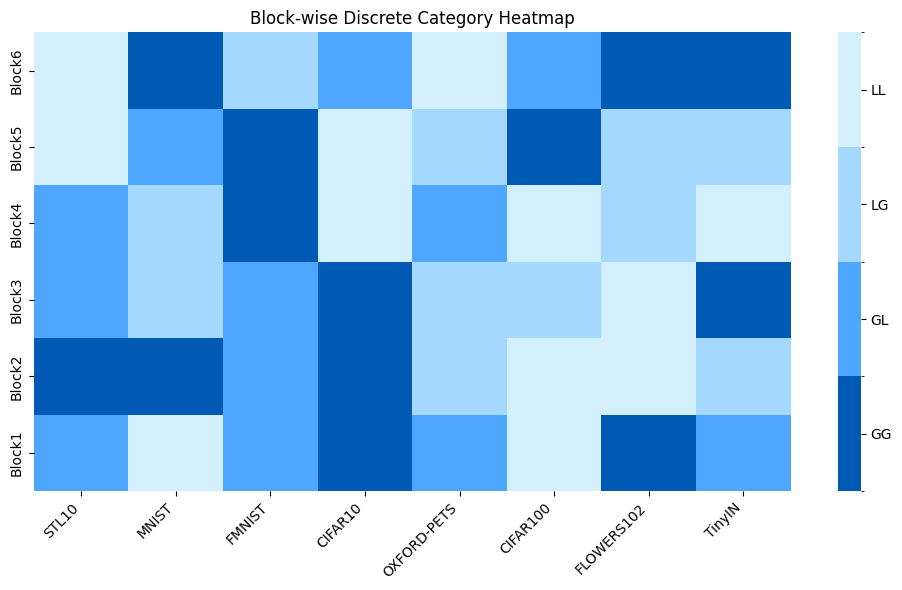

In [ ]:
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap, BoundaryNorm

# Data
data = np.array([
    [2, 1, 2, 2, 4, 4],  # STL10
    [4, 1, 3, 3, 2, 1],  # MNIST
    [2, 2, 2, 1, 1, 3],  # FMNIST
    [1, 1, 1, 4, 4, 2],  # CIFAR10
    [2, 3, 3, 2, 3, 4],  # OXFORD-PETS
    [4, 4, 3, 4, 1, 2],  # CIFAR100
    [1, 4, 4, 3, 3, 1],  # FLOWERS102
    [2, 3, 1, 4, 3, 1]   # TinyIN
])

# Transpose to match blocks as rows
data = data.T[::-1]

# Labels
x_labels = ['STL10', 'MNIST', 'FMNIST', 'CIFAR10', 'OXFORD-PETS', 'CIFAR100', 'FLOWERS102', 'TinyIN']
y_labels = [f'Block{i+1}' for i in range(6)][::-1]

# Value to label mapping
label_mapping = {1: '', 2: '', 3: '', 4: ''}
label_data = np.vectorize(label_mapping.get)(data)

# Define discrete colormap and normalization

palettes = {
    'Oriinal_Blue': ['#0059b3', '#4fa6ff', '#a5d8ff', '#d4f0ff'],
    'Summer':        ['#00ff66', '#33ff8b', '#66ffb1', '#99ffd6'],
    'Pastel1':       ['#fbb4ae', '#b3cde3', '#ccebc5', '#decbe4'],
    'Set2':          ['#66c2a5', '#fc8d62', '#8da0cb', '#e78ac3'],
    'Accent':        ['#7fc97f', '#beaed4', '#fdc086', '#ffff99'],
    'Paired':        ['#a6cee3', '#1f78b4', '#b2df8a', '#33a02c'],
    'Dark2':         ['#1b9e77', '#d95f02', '#7570b3', '#e7298a'],
    'Coolwarm':      ['#3b4cc0', '#86a9e1', '#f1aa8d', '#b40426'],
    'Viridis':       ['#440154', '#3b528b', '#21908d', '#5dc963'],
    'Spectral':      ['#9e0142', '#f46d43', '#fdae61', '#66bd63'],
    'Cubehelix':     ['#1c0c4b', '#5e3876', '#a67782', '#eedc84'],
    # NEW palettes sampled from Matplotlib colormaps
    'Plasma': ['#0d0887', '#7e03a8', '#cc4778', '#f0f921'],
    'Magma': ['#000004', '#3b0f70', '#b63679', '#fcfdbf'],
    'Cividis': ['#00204c', '#445e86', '#a5a585', '#ffffe0'],
    'Turbo': ['#30123b', '#ca4678', '#fca338', '#f6f966'],
    'Gnuplot': ['#000000', '#aa0000', '#00aaaa', '#ffffff']
}

colors = palettes['Oriinal_Blue']
cmap = ListedColormap(colors)
bounds = [0.5, 1.5, 2.5, 3.5, 4.5]
norm = BoundaryNorm(bounds, cmap.N)

# Plot
plt.figure(figsize=(10, 6))
ax = sns.heatmap(data, cmap=cmap, norm=norm, annot=label_data, fmt='',
                 xticklabels=x_labels, yticklabels=y_labels, cbar_kws={"ticks": [1, 2, 3, 4]})
colorbar = ax.collections[0].colorbar
colorbar.set_ticklabels(['GG', 'GL', 'LG', 'LL'])
# Ticks and style
plt.xticks(rotation=45, ha='right')
plt.title("Block-wise Discrete Category Heatmap")
plt.tight_layout()
plt.show()


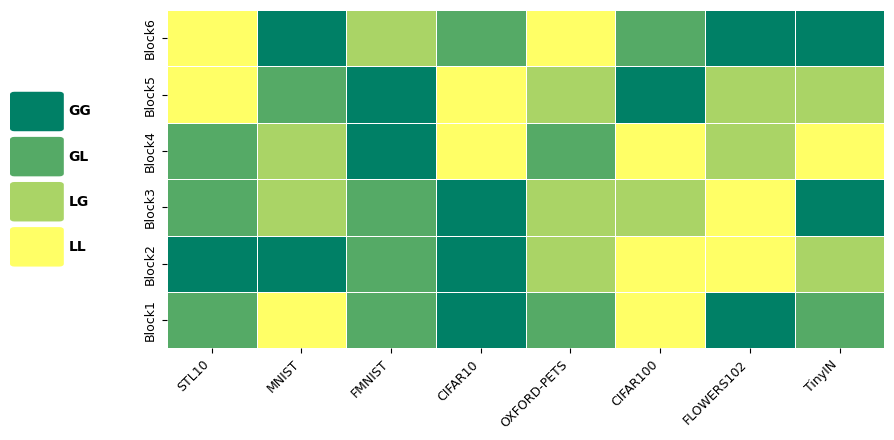

In [ ]:
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap, BoundaryNorm
from matplotlib.patches import FancyBboxPatch

# Define the data
data = np.array([
    [2, 1, 2, 2, 4, 4],  # STL10
    [4, 1, 3, 3, 2, 1],  # MNIST
    [2, 2, 2, 1, 1, 3],  # FMNIST
    [1, 1, 1, 4, 4, 2],  # CIFAR10
    [2, 3, 3, 2, 3, 4],  # OXFORD-PETS
    [4, 4, 3, 4, 1, 2],  # CIFAR100
    [1, 4, 4, 3, 3, 1],  # FLOWERS102
    [2, 3, 1, 4, 3, 1]   # TinyIN
])

# Flip vertically for heatmap layout
cmap_data = data.T[::-1]

# Labels
x_labels = ['STL10', 'MNIST', 'FMNIST', 'CIFAR10', 'OXFORD-PETS', 'CIFAR100', 'FLOWERS102', 'TinyIN']
y_labels = [f'Block{i+1}' for i in range(6)][::-1]

# Value-to-label mapping
label_mapping = {1: 'GG', 2: 'GL', 3: 'LG', 4: 'LL'}

# Create discrete colormap from 'summer'
base_cmap = plt.get_cmap('summer')
colors = base_cmap(np.linspace(0, 1, 4))
custom_cmap = ListedColormap(colors)
norm = BoundaryNorm([0.5, 1.5, 2.5, 3.5, 4.5], custom_cmap.N)

# Create figure
fig, ax = plt.subplots(figsize=(9, 4.5), facecolor='none')
fig.patch.set_alpha(0.0)
ax.set_facecolor('none')

# Draw heatmap
sns.heatmap(
    cmap_data,
    ax=ax,
    cmap=custom_cmap,
    cbar=False,
    square=False,
    linewidths=0.5,
    linecolor='white',
    xticklabels=x_labels,
    yticklabels=y_labels,
    norm=norm
)

# Rotate and align ticks
ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right', fontsize=9)
ax.set_yticklabels(ax.get_yticklabels(), fontsize=9)

# Remove spines
for spine in ax.spines.values():
    spine.set_visible(False)

# Add vertical legend (left side)
box_height = 0.6
spacing = 0.2
start_y = (6 - (4 * box_height + 3 * spacing)) / 2  # 6 is number of y-ticks
legend_x = -1.7  # Left of y-axis

for i, k in enumerate(label_mapping):
    y = start_y + i * (box_height + spacing)
    box = FancyBboxPatch((legend_x, y), 0.5, box_height,
                         boxstyle="round,pad=0.05", edgecolor='none',
                         facecolor=custom_cmap(norm(k)), transform=ax.transData, clip_on=False)
    ax.add_patch(box)
    ax.text(legend_x + 0.6, y + box_height / 2, label_mapping[k],
            ha='left', va='center', fontsize=10, fontweight='bold', transform=ax.transData)

plt.tight_layout()
plt.savefig("temperature_map_vertical_legend.png", transparent=True, dpi=300)
plt.show()


# Final >

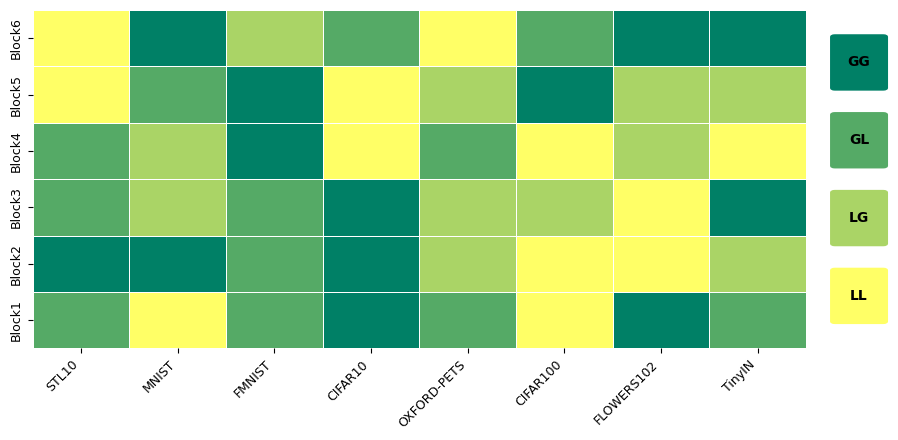

In [ ]:
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap, BoundaryNorm
from matplotlib.patches import FancyBboxPatch


# Define the data
data = np.array([
    [2, 1, 2, 2, 4, 4],  # STL10
    [4, 1, 3, 3, 2, 1],  # MNIST
    [2, 2, 2, 1, 1, 3],  # FMNIST
    [1, 1, 1, 4, 4, 2],  # CIFAR10
    [2, 3, 3, 2, 3, 4],  # OXFORD-PETS
    [4, 4, 3, 4, 1, 2],  # CIFAR100
    [1, 4, 4, 3, 3, 1],  # FLOWERS102
    [2, 3, 1, 4, 3, 1]   # TinyIN
])

# Flip vertically for heatmap layout
cmap_data = data.T[::-1]

# Labels
x_labels = ['STL10', 'MNIST', 'FMNIST', 'CIFAR10', 'OXFORD-PETS', 'CIFAR100', 'FLOWERS102', 'TinyIN']
y_labels = [f'Block{i+1}' for i in range(6)][::-1]

# Value-to-label mapping
label_mapping = {1: 'GG', 2: 'GL', 3: 'LG', 4: 'LL'}

# Create discrete colormap from 'summer'
base_cmap = plt.get_cmap('summer')
colors = base_cmap(np.linspace(0, 1, 4))
custom_cmap = ListedColormap(colors)
norm = BoundaryNorm([0.5, 1.5, 2.5, 3.5, 4.5], custom_cmap.N)

# Create figure
fig, ax = plt.subplots(figsize=(9, 4.5), facecolor='none')
fig.patch.set_alpha(0.0)
ax.set_facecolor('none')

# Draw heatmap
sns.heatmap(
    cmap_data,
    ax=ax,
    cmap=custom_cmap,
    cbar=False,
    square=False,
    linewidths=0.5,
    linecolor='white',
    xticklabels=x_labels,
    yticklabels=y_labels,
    norm=norm
)

# Rotate and align ticks
ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right', fontsize=9)
ax.set_yticklabels(ax.get_yticklabels(), fontsize=9)

# Remove spines
for spine in ax.spines.values():
    spine.set_visible(False)

# Add vertical cluemap to the right side
box_height = 0.9  # Fit in the total height
total_height = len(y_labels)
box_width = 0.5
spacing = (total_height - 4 * box_height) / 5  # 4 boxes + 5 spaces = 6 intervals
start_y = spacing
legend_x = len(x_labels) + 0.3  # To the right of heatmap

for i, k in enumerate(label_mapping):
    y = start_y + i * (box_height + spacing)
    box = FancyBboxPatch((legend_x, y), box_width, box_height,
                         boxstyle="round,pad=0.05", edgecolor='none',
                         facecolor=custom_cmap(norm(k)), transform=ax.transData, clip_on=False)
    ax.add_patch(box)
    ax.text(
    legend_x + box_width / 2, y + box_height / 2, label_mapping[k],
    ha='center', va='center', fontsize=10, color='black', fontweight='bold',
    transform=ax.transData
    )
# plt.title("asd")
plt.tight_layout()
plt.savefig("temprature_map.png", transparent=True, dpi=300)
plt.show()


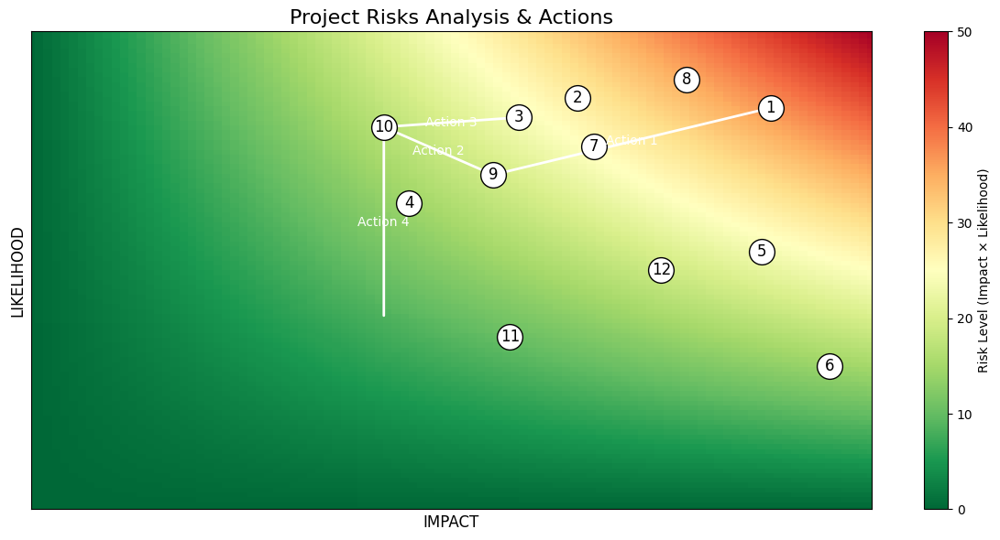

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.patches as mpatches

# Define risk points as (x, y) = (impact, likelihood)
risks = {
    1: (8.8, 4.2), 2: (6.5, 4.3), 3: (5.8, 4.1),
    4: (4.5, 3.2), 5: (8.7, 2.7), 6: (9.5, 1.5),
    7: (6.7, 3.8), 8: (7.8, 4.5), 9: (5.5, 3.5),
    10: (4.2, 4.0), 11: (5.7, 1.8), 12: (7.5, 2.5)
}

# Define actions as arrows between points
actions = {
    "Action 1": ((5.5, 3.5), (8.8, 4.2)),
    "Action 2": ((4.2, 4.0), (5.5, 3.5)),
    "Action 3": ((4.2, 4.0), (5.8, 4.1)),
    "Action 4": ((4.2, 2.0), (4.2, 4.0))
}

# Create gradient background
x = np.linspace(0, 10, 100)
y = np.linspace(0, 5, 100)
X, Y = np.meshgrid(x, y)
Z = X * Y  # Impact * Likelihood heatmap

fig, ax = plt.subplots(figsize=(12, 6))
cmap = plt.cm.RdYlGn_r  # reversed colormap (green to red)

# Plot heatmap
c = ax.pcolormesh(X, Y, Z, cmap=cmap, shading='auto')

# Plot risk points
for key, (x, y) in risks.items():
    ax.scatter(x, y, s=400, color='white', edgecolors='black', zorder=3)
    ax.text(x, y, str(key), color='black', fontsize=12, ha='center', va='center', zorder=4)

# Plot action arrows and labels
for label, ((x0, y0), (x1, y1)) in actions.items():
    ax.annotate('', xy=(x1, y1), xytext=(x0, y0),
                arrowprops=dict(arrowstyle="->", color='white', lw=2), zorder=2)
    mid_x, mid_y = (x0 + x1) / 2, (y0 + y1) / 2
    ax.text(mid_x, mid_y, label, fontsize=10, color='white', ha='center', va='center', zorder=5)

# Axis labels and title
ax.set_xlabel("IMPACT", fontsize=12)
ax.set_ylabel("LIKELIHOOD", fontsize=12)
ax.set_title("Project Risks Analysis & Actions", fontsize=16)

# Axis limits
ax.set_xlim(0, 10)
ax.set_ylim(0, 5)

# Remove ticks
ax.set_xticks([])
ax.set_yticks([])

plt.colorbar(c, ax=ax, label='Risk Level (Impact × Likelihood)')
plt.tight_layout()
plt.show()


In [ ]:
import numpy as np

# Original data
data = np.array([
    [2, 1, 2, 2, 4, 4],  # STL10
    [4, 1, 3, 3, 2, 1],  # MNIST
    [2, 2, 2, 1, 1, 3],  # FMNIST
    [1, 1, 1, 4, 4, 2],  # CIFAR10
    [2, 3, 3, 2, 3, 4],  # OXFORD-PETS
    [4, 4, 3, 4, 1, 2],  # CIFAR100
    [1, 4, 4, 3, 3, 1],  # FLOWERS102
    [2, 3, 1, 4, 3, 1]   # TinyIN
])

# Mapping dictionary
mapping = {
    1: (1, 1),
    2: (1, 0),
    3: (0, 1),
    4: (0, 0)
}

# Convert each number to its 2D coordinate
result = np.array([[[mapping[num] for num in row] for row in data]])

# Reshape to separate the coordinates
# The resulting shape will be (8, 6, 2) - 8 datasets, 6 entries, 2 coordinates each
result = result.reshape(data.shape[0], data.shape[1], 2)

print(result)

[[[1 0]
  [1 1]
  [1 0]
  [1 0]
  [0 0]
  [0 0]]

 [[0 0]
  [1 1]
  [0 1]
  [0 1]
  [1 0]
  [1 1]]

 [[1 0]
  [1 0]
  [1 0]
  [1 1]
  [1 1]
  [0 1]]

 [[1 1]
  [1 1]
  [1 1]
  [0 0]
  [0 0]
  [1 0]]

 [[1 0]
  [0 1]
  [0 1]
  [1 0]
  [0 1]
  [0 0]]

 [[0 0]
  [0 0]
  [0 1]
  [0 0]
  [1 1]
  [1 0]]

 [[1 1]
  [0 0]
  [0 0]
  [0 1]
  [0 1]
  [1 1]]

 [[1 0]
  [0 1]
  [1 1]
  [0 0]
  [0 1]
  [1 1]]]


In [ ]:
result.shape

(8, 6, 2)

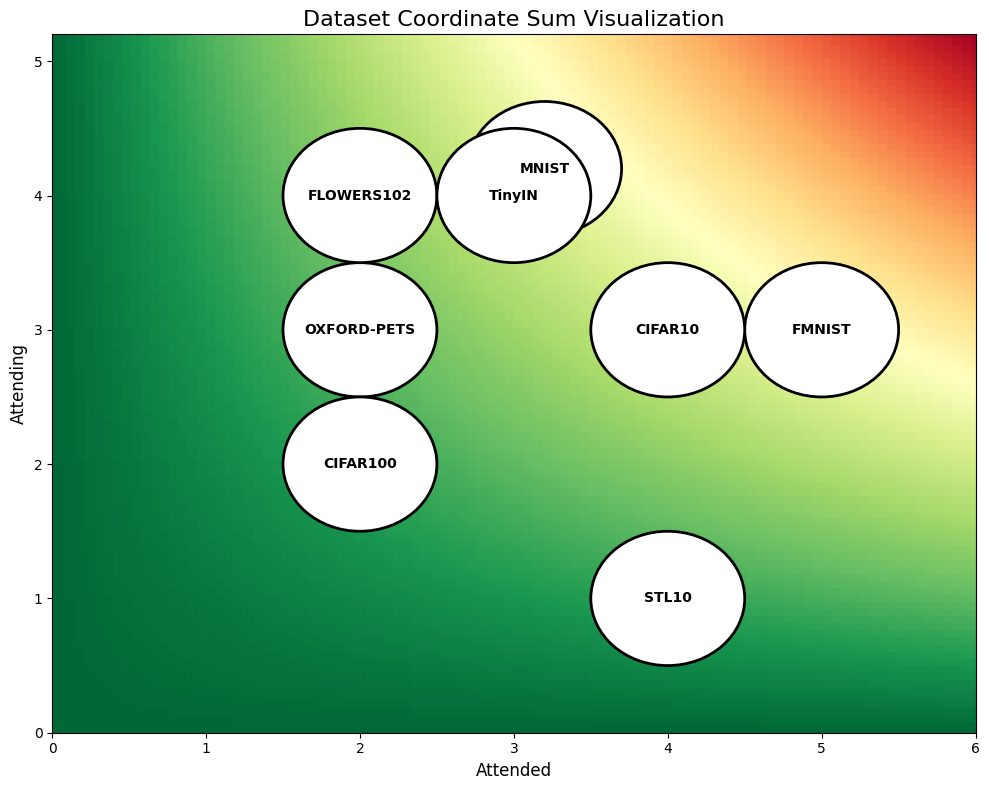

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Original data and mapping
data = np.array([
    [2, 1, 2, 2, 4, 4],  # STL10
    [4, 5, 3, 3, 2, 5],  # MNIST
    [2, 2, 2, 1, 1, 3],  # FMNIST
    [1, 1, 1, 4, 4, 2],  # CIFAR10
    [2, 3, 3, 2, 3, 4],  # OXFORD-PETS
    [4, 4, 3, 4, 1, 2],  # CIFAR100
    [1, 4, 4, 3, 3, 1],  # FLOWERS102
    [2, 3, 1, 4, 3, 1]   # TinyIN
])

dataset_names = ['STL10', 'MNIST', 'FMNIST', 'CIFAR10', 'OXFORD-PETS',
                 'CIFAR100', 'FLOWERS102', 'TinyIN']

mapping = {
    1: np.array([1, 1]),
    2: np.array([1, 0]),
    3: np.array([0, 1]),
    4: np.array([0, 0]),
    5: np.array([1.1, 1.1]),
}

# Calculate sums for each dataset
sums = np.array([sum(mapping[num] for num in row) for row in data])

# Create figure
fig, ax = plt.subplots(figsize=(10, 8))

# Create gradient background
x = np.linspace(0, max(sums[:,0])+1, 100)
y = np.linspace(0, max(sums[:,1])+1, 100)
X, Y = np.meshgrid(x, y)
Z = X * Y  # Impact * Likelihood heatmap

# Plot heatmap
cmap = plt.cm.RdYlGn_r  # reversed colormap (green to red)
c = ax.pcolormesh(X, Y, Z, cmap=cmap, shading='auto')

# Plot dataset points with names
for (x, y), name in zip(sums, dataset_names):
    circle = plt.Circle((x, y), radius=0.5, color='white', ec='black', lw=2)
    ax.add_patch(circle)
    ax.text(x, y, name, color='black', fontsize=10,
            ha='center', va='center', weight='bold')

# Axis labels
ax.set_xlabel("Attended", fontsize=12)
ax.set_ylabel("Attending", fontsize=12)
ax.set_title("Dataset Coordinate Sum Visualization", fontsize=16)

# Set axis limits with some padding
ax.set_xlim(0, max(sums[:,0])+1)
ax.set_ylim(0, max(sums[:,1])+1)

# Add grid and colorbar
# ax.grid(True, linestyle='--', alpha=0.7)
# plt.colorbar(c, ax=ax, label='X × Y Value')

plt.tight_layout()
plt.show()

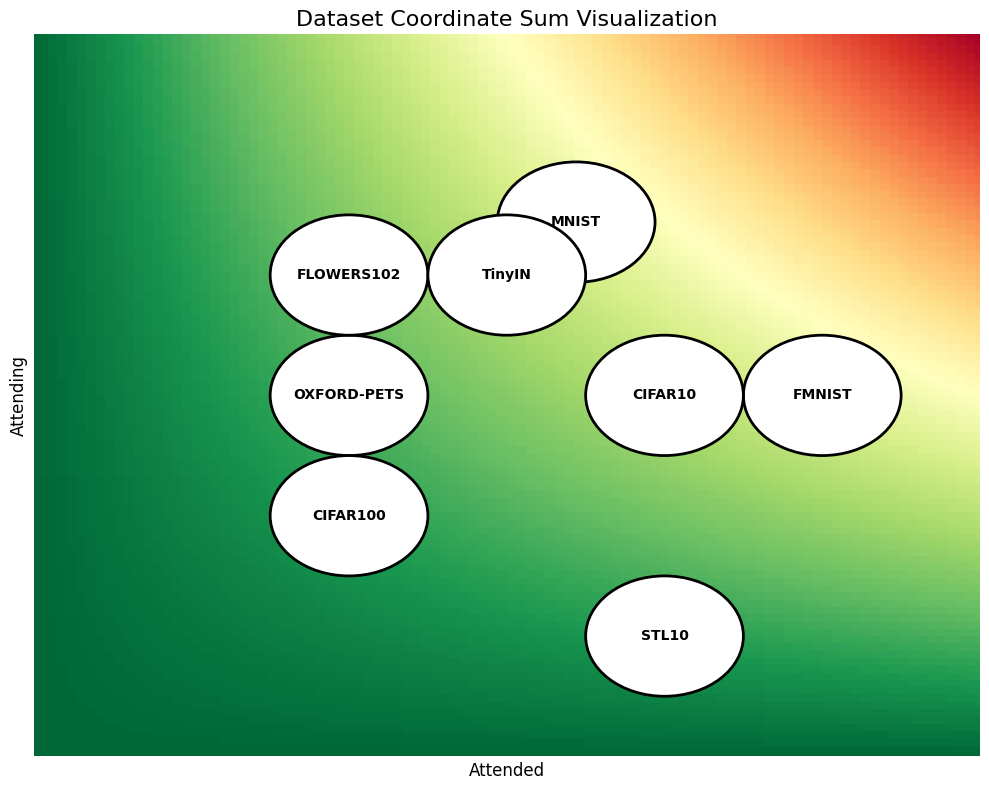

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Original data and mapping
data = np.array([
    [2, 1, 2, 2, 4, 4],  # STL10
    [4, 5, 3, 3, 2, 5],  # MNIST
    [2, 2, 2, 1, 1, 3],  # FMNIST
    [1, 1, 1, 4, 4, 2],  # CIFAR10
    [2, 3, 3, 2, 3, 4],  # OXFORD-PETS
    [4, 4, 3, 4, 1, 2],  # CIFAR100
    [1, 4, 4, 3, 3, 1],  # FLOWERS102
    [2, 3, 1, 4, 3, 1]   # TinyIN
])

dataset_names = ['STL10', 'MNIST', 'FMNIST', 'CIFAR10', 'OXFORD-PETS',
                 'CIFAR100', 'FLOWERS102', 'TinyIN']

mapping = {
    1: np.array([1, 1]),
    2: np.array([1, 0]),
    3: np.array([0, 1]),
    4: np.array([0, 0]),
    5: np.array([1.22, 1.22]),
}


# Calculate sums for each dataset
sums = np.array([sum(mapping[num] for num in row) for row in data])

# Create figure
fig, ax = plt.subplots(figsize=(10, 8))

# Create gradient background
x = np.linspace(0, 6, 100)  # Fixed range 0-6
y = np.linspace(0, 6, 100)  # Fixed range 0-6
X, Y = np.meshgrid(x, y)
Z = X * Y  # Impact * Likelihood heatmap

# Plot heatmap
cmap = plt.cm.RdYlGn_r  # reversed colormap (green to red)
c = ax.pcolormesh(X, Y, Z, cmap=cmap, shading='auto')

# Plot dataset points with names
for (x, y), name in zip(sums, dataset_names):
    circle = plt.Circle((x, y), radius=0.5, color='white', ec='black', lw=2)
    ax.add_patch(circle)
    ax.text(x, y, name, color='black', fontsize=10,
            ha='center', va='center', weight='bold')

# Axis labels
ax.set_xlabel("Attended", fontsize=12)
ax.set_ylabel("Attending", fontsize=12)
ax.set_title("Dataset Coordinate Sum Visualization", fontsize=16)

# Set axis limits
ax.set_xlim(0, 6)
ax.set_ylim(0, 6)

# # Add Local/Global labels with larger font and more prominent positioning
# ax.text(0, -0.7, 'Local', ha='center', va='top', fontsize=12, weight='bold')
# ax.text(6, -0.7, 'Global', ha='center', va='top', fontsize=12, weight='bold')
# ax.text(-0.7, 0, 'Local', ha='right', va='center', fontsize=12, weight='bold')
# ax.text(-0.7, 6, 'Global', ha='right', va='center', fontsize=12, weight='bold')

# Remove all ticks and tick labels
ax.set_xticks([])
ax.set_yticks([])

# Remove the spines (optional)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.spines['left'].set_visible(False)

plt.tight_layout()
plt.show()

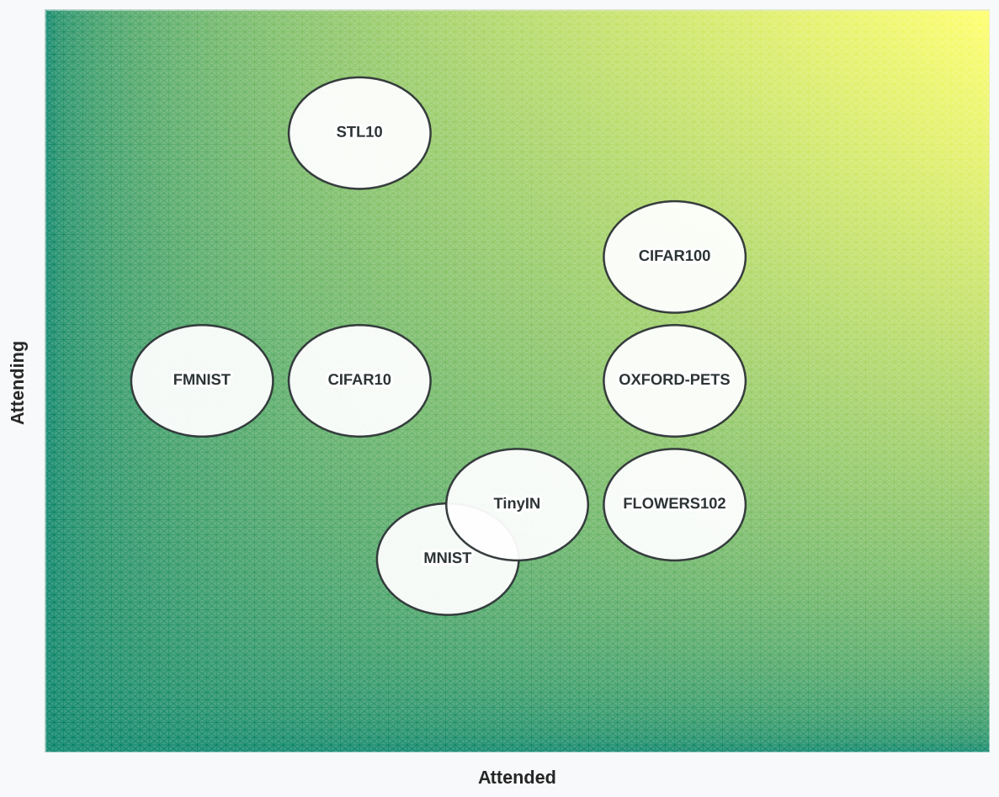

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.colors import LinearSegmentedColormap
from matplotlib import patheffects  # Correct import for path effects

# Original data and mapping
data = np.array([
    [2, 1, 2, 2, 4, 4],  # STL10
    [4, 5, 3, 3, 2, 5],  # MNIST
    [2, 2, 2, 1, 1, 3],  # FMNIST
    [1, 1, 1, 4, 4, 2],  # CIFAR10
    [2, 3, 3, 2, 3, 4],  # OXFORD-PETS
    [4, 4, 3, 4, 1, 2],  # CIFAR100
    [1, 4, 4, 3, 3, 1],  # FLOWERS102
    [2, 3, 1, 4, 3, 1]   # TinyIN
])

dataset_names = ['STL10', 'MNIST', 'FMNIST', 'CIFAR10', 'OXFORD-PETS',
                 'CIFAR100', 'FLOWERS102', 'TinyIN']

mapping = {
    4: np.array([1, 1]),
    3: np.array([1, 0]),
    2: np.array([0, 1]),
    1: np.array([0, 0]),
    5: np.array([-0.22, -0.22]),
}

# Calculate sums for each dataset
sums = np.array([sum(mapping[num] for num in row) for row in data])

# Create figure with better style
plt.style.use('seaborn-v0_8-whitegrid')
fig, ax = plt.subplots(figsize=(10, 8), dpi=120)
fig.set_facecolor('#f8f9fa')

# Create pleasant color gradient
colors = ["#4e79a7", "#59a14f", "#9c755f", "#f28e2b", "#e15759", "#76b7b2", "#edc948", "#b07aa1"]
# cmap = LinearSegmentedColormap.from_list("custom_div", colors)
cmap = plt.cm.summer

# Create gradient background
x = np.linspace(0, 6, 100)
y = np.linspace(0, 6, 100)
X, Y = np.meshgrid(x, y)
Z = np.sqrt(X * Y)  # Better color distribution

# Plot heatmap
c = ax.pcolormesh(X, Y, Z, cmap=cmap, shading='gouraud', alpha=0.8)

# Plot elegant dataset points
for (x, y), name in zip(sums, dataset_names):
    # Create circle with subtle shadow
    circle = plt.Circle((x, y), radius=0.45,
                        color='white', ec='#2d3436',
                        lw=1.5, zorder=3, alpha=0.95)
    ax.add_patch(circle)

    # Add text with white halo effect
    ax.text(x, y, name, color='#2d3436', fontsize=11,
            ha='center', va='center', weight='bold', zorder=4,
            path_effects=[patheffects.withStroke(linewidth=4, foreground="white")])

# Stylish axis labels
ax.set_xlabel("Attended", fontsize=13, labelpad=12, weight='bold')
ax.set_ylabel("Attending", fontsize=13, labelpad=12, weight='bold')
# ax.set_title("Dataset Attention Map", fontsize=16, pad=20, weight='bold', color='#2d3436')

# Set axis limits
ax.set_xlim(0, 6)
ax.set_ylim(0, 6)

# Clean axis presentation
ax.set_xticks([])
ax.set_yticks([])
for spine in ax.spines.values():
    spine.set_visible(False)

# Modern endpoint labels
# endpoint_style = {'fontsize': 12, 'weight': 'bold', 'color': '#636e72', 'alpha': 0.9}
# ax.text(0.1, -0.4, 'LOCAL', ha='left', va='top', **endpoint_style)
# ax.text(5.9, -0.4, 'GLOBAL', ha='right', va='top', **endpoint_style)
# ax.text(-0.4, 0.1, 'LOCAL', ha='right', va='bottom', **endpoint_style)
# ax.text(-0.4, 5.9, 'GLOBAL', ha='right', va='top', **endpoint_style)

# Add subtle grid
ax.grid(True, color='white', linestyle='-', linewidth=1, alpha=0.5)

# # Professional colorbar
# cbar = plt.colorbar(c, ax=ax, shrink=0.7, pad=0.03)
# cbar.outline.set_visible(False)
# cbar.set_label('Attention Level', fontsize=11, weight='bold', labelpad=10)
# cbar.ax.tick_params(labelsize=9)

# Add delicate frame
frame = plt.Rectangle((0,0), 6, 6, fill=False, ec='#dfe6e9', lw=1.5, zorder=1, alpha=0.7)
ax.add_patch(frame)

plt.tight_layout()
plt.show()

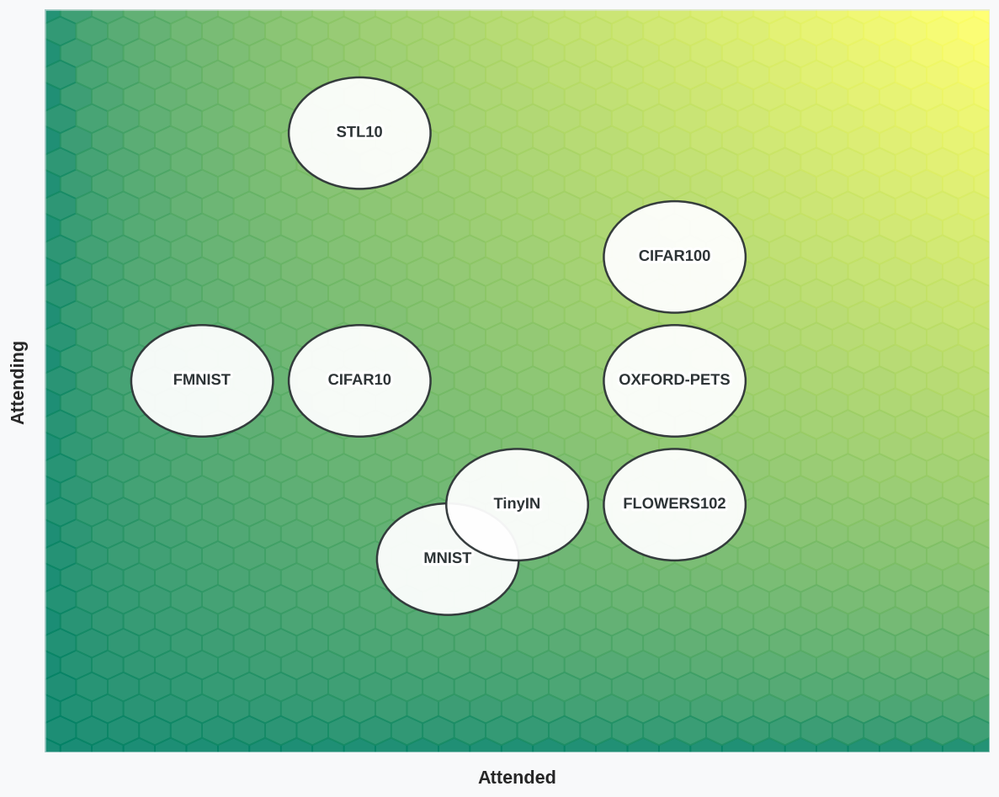

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.colors import LinearSegmentedColormap
from matplotlib import patheffects  # Correct import for path effects

# Original data and mapping
data = np.array([
    [2, 1, 2, 2, 4, 4],  # STL10
    [4, 5, 3, 3, 2, 5],  # MNIST
    [2, 2, 2, 1, 1, 3],  # FMNIST
    [1, 1, 1, 4, 4, 2],  # CIFAR10
    [2, 3, 3, 2, 3, 4],  # OXFORD-PETS
    [4, 4, 3, 4, 1, 2],  # CIFAR100
    [1, 4, 4, 3, 3, 1],  # FLOWERS102
    [2, 3, 1, 4, 3, 1]   # TinyIN
])

dataset_names = ['STL10', 'MNIST', 'FMNIST', 'CIFAR10', 'OXFORD-PETS',
                 'CIFAR100', 'FLOWERS102', 'TinyIN']

mapping = {
    4: np.array([1, 1]),
    3: np.array([1, 0]),
    2: np.array([0, 1]),
    1: np.array([0, 0]),
    5: np.array([-0.22, -0.22]),
}

# Calculate sums for each dataset
sums = np.array([sum(mapping[num] for num in row) for row in data])

# Create figure with better style
plt.style.use('seaborn-v0_8-whitegrid')
fig, ax = plt.subplots(figsize=(10, 8), dpi=120)
fig.set_facecolor('#f8f9fa')

# Create pleasant color gradient
colors = ["#4e79a7", "#59a14f", "#9c755f", "#f28e2b", "#e15759", "#76b7b2", "#edc948", "#b07aa1"]
# cmap = LinearSegmentedColormap.from_list("custom_div", colors)
cmap = plt.cm.summer

# Create gradient background
x = np.linspace(0, 6, 100)
y = np.linspace(0, 6, 100)
X, Y = np.meshgrid(x, y)
Z = np.sqrt(X * Y)  # Better color distribution

# Plot heatmap
# c = ax.pcolormesh(X, Y, Z, cmap=cmap, alpha=0.8)
c = ax.hexbin(X.ravel(), Y.ravel(), C=Z.ravel(), cmap=cmap, gridsize=30, alpha=0.9)


# Plot elegant dataset points
for (x, y), name in zip(sums, dataset_names):
    # Create circle with subtle shadow
    circle = plt.Circle((x, y), radius=0.45,
                        color='white', ec='#2d3436',
                        lw=1.5, zorder=3, alpha=0.95)
    ax.add_patch(circle)

    # Add text with white halo effect
    ax.text(x, y, name, color='#2d3436', fontsize=11,
            ha='center', va='center', weight='bold', zorder=4,
            path_effects=[patheffects.withStroke(linewidth=4, foreground="white")])

# Stylish axis labels
ax.set_xlabel("Attended", fontsize=13, labelpad=12, weight='bold')
ax.set_ylabel("Attending", fontsize=13, labelpad=12, weight='bold')

# Set axis limits
ax.set_xlim(0, 6)
ax.set_ylim(0, 6)

# Clean axis presentation
ax.set_xticks([])
ax.set_yticks([])
for spine in ax.spines.values():
    spine.set_visible(False)


# Add subtle grid
ax.grid(True, color='white', linestyle='-', linewidth=1, alpha=0.5)


# Add delicate frame
frame = plt.Rectangle((0,0), 6, 6, fill=False, ec='#dfe6e9', lw=1.5, zorder=1, alpha=0.7)
ax.add_patch(frame)

plt.tight_layout()
plt.show()

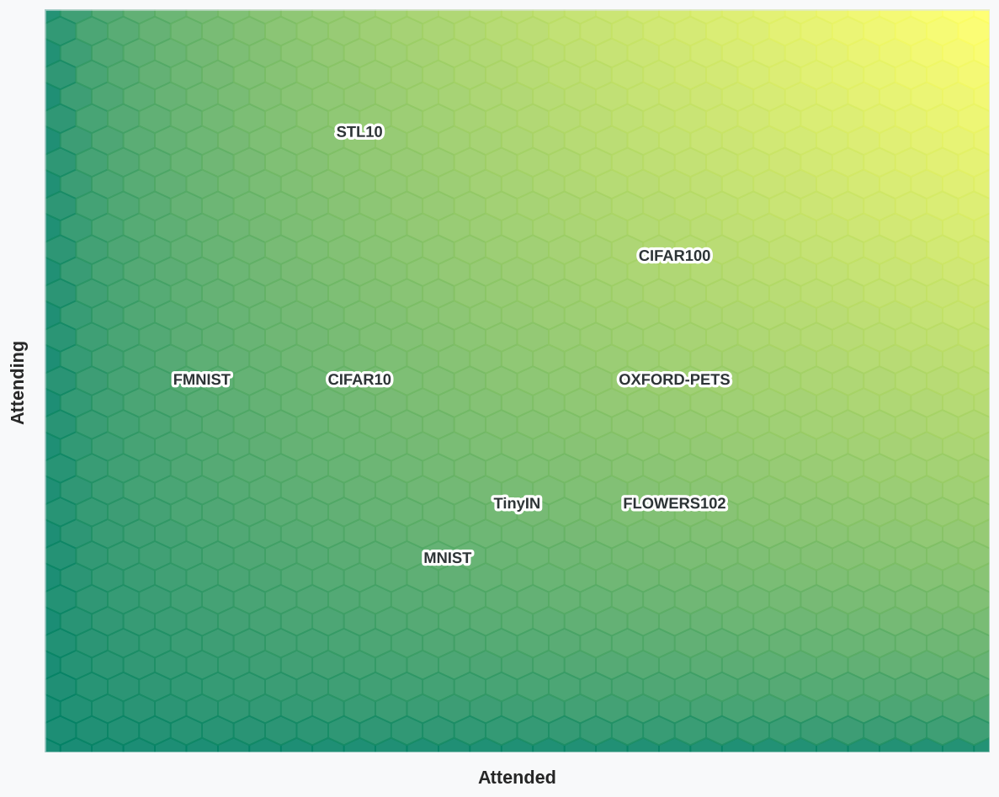

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.colors import LinearSegmentedColormap
from matplotlib import patheffects  # Correct import for path effects

# Original data and mapping
data = np.array([
    [2, 1, 2, 2, 4, 4],  # STL10
    [4, 5, 3, 3, 2, 5],  # MNIST
    [2, 2, 2, 1, 1, 3],  # FMNIST
    [1, 1, 1, 4, 4, 2],  # CIFAR10
    [2, 3, 3, 2, 3, 4],  # OXFORD-PETS
    [4, 4, 3, 4, 1, 2],  # CIFAR100
    [1, 4, 4, 3, 3, 1],  # FLOWERS102
    [2, 3, 1, 4, 3, 1]   # TinyIN
])

dataset_names = ['STL10', 'MNIST', 'FMNIST', 'CIFAR10', 'OXFORD-PETS',
                 'CIFAR100', 'FLOWERS102', 'TinyIN']

mapping = {
    4: np.array([1, 1]),
    3: np.array([1, 0]),
    2: np.array([0, 1]),
    1: np.array([0, 0]),
    5: np.array([-0.22, -0.22]),
}

# Calculate sums for each dataset
sums = np.array([sum(mapping[num] for num in row) for row in data])

# Create figure with better style
plt.style.use('seaborn-v0_8-whitegrid')
fig, ax = plt.subplots(figsize=(10, 8), dpi=120)
fig.set_facecolor('#f8f9fa')

# Create pleasant color gradient
colors = ["#4e79a7", "#59a14f", "#9c755f", "#f28e2b", "#e15759", "#76b7b2", "#edc948", "#b07aa1"]
# cmap = LinearSegmentedColormap.from_list("custom_div", colors)
cmap = plt.cm.summer

# Create gradient background
x = np.linspace(0, 6, 100)
y = np.linspace(0, 6, 100)
X, Y = np.meshgrid(x, y)
Z = np.sqrt(X * Y)  # Better color distribution

# Plot heatmap
# c = ax.pcolormesh(X, Y, Z, cmap=cmap, alpha=0.8)
c = ax.hexbin(X.ravel(), Y.ravel(), C=Z.ravel(), cmap=cmap, gridsize=30, alpha=0.9)


# Plot elegant dataset points
from matplotlib.patches import CirclePolygon

for (x, y), name in zip(sums, dataset_names):
    # Create circle with subtle shadow
    grad_circle = CirclePolygon((x, y), radius=0.45,
                              facecolor='none',
                              edgecolor='none',
                              zorder=3)
    ax.add_patch(grad_circle)

    # Add text with white halo effect
    ax.text(x, y, name, color='#2d3436', fontsize=11,
            ha='center', va='center', weight='bold', zorder=4,
            path_effects=[patheffects.withStroke(linewidth=4, foreground="white")])

# Stylish axis labels
ax.set_xlabel("Attended", fontsize=13, labelpad=12, weight='bold')
ax.set_ylabel("Attending", fontsize=13, labelpad=12, weight='bold')

# Set axis limits
ax.set_xlim(0, 6)
ax.set_ylim(0, 6)

# Clean axis presentation
ax.set_xticks([])
ax.set_yticks([])
for spine in ax.spines.values():
    spine.set_visible(False)


# Add subtle grid
ax.grid(True, color='white', linestyle='-', linewidth=1, alpha=0.5)


# Add delicate frame
frame = plt.Rectangle((0,0), 6, 6, fill=False, ec='#dfe6e9', lw=1.5, zorder=1, alpha=0.7)
ax.add_patch(frame)

plt.tight_layout()
plt.show()

# Final2

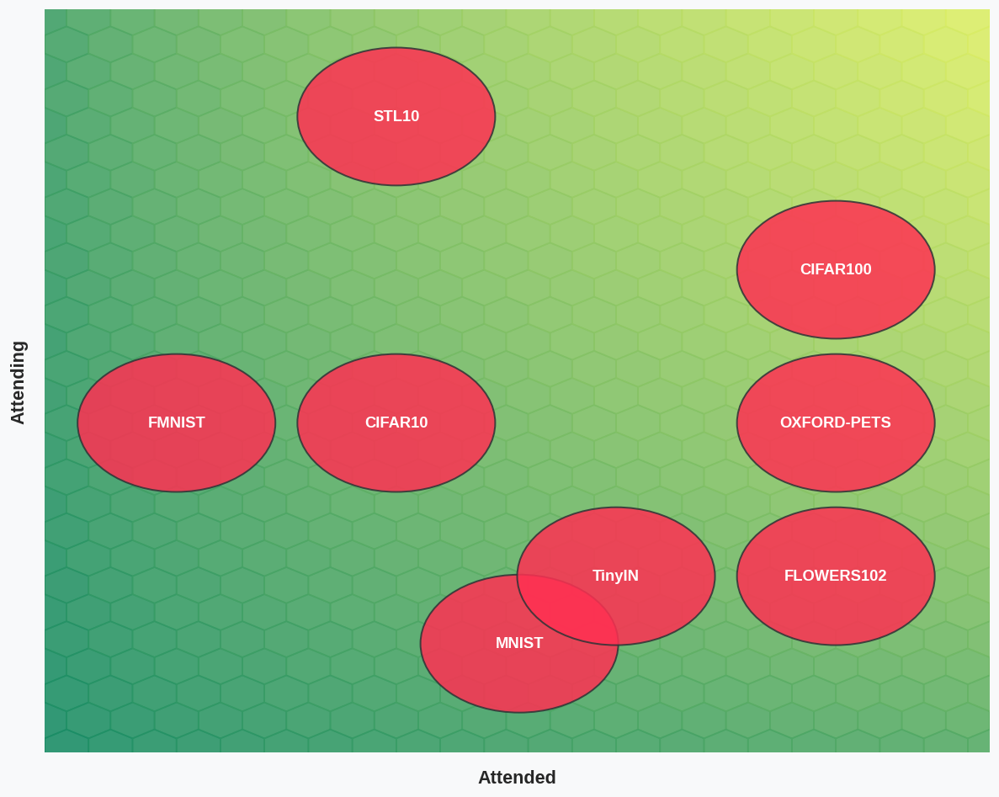

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.colors import LinearSegmentedColormap, to_rgb
from matplotlib import patheffects

# Original data and mapping
data = np.array([
    [2, 1, 2, 2, 4, 4],  # STL10
    [4, 5, 3, 3, 2, 5],  # MNIST
    [2, 2, 2, 1, 1, 3],  # FMNIST
    [1, 1, 1, 4, 4, 2],  # CIFAR10
    [2, 3, 3, 2, 3, 4],  # OXFORD-PETS
    [4, 4, 3, 4, 1, 2],  # CIFAR100
    [1, 4, 4, 3, 3, 1],  # FLOWERS102
    [2, 3, 1, 4, 3, 1]   # TinyIN
])

dataset_names = ['STL10', 'MNIST', 'FMNIST', 'CIFAR10', 'OXFORD-PETS',
                 'CIFAR100', 'FLOWERS102', 'TinyIN']

mapping = {
    4: np.array([1, 1]),
    3: np.array([1, 0]),
    2: np.array([0, 1]),
    1: np.array([0, 0]),
    5: np.array([-0.22, -0.22]),
}

# Calculate sums for each dataset
sums = np.array([sum(mapping[num] for num in row) for row in data])

# Create figure with better style
plt.style.use('seaborn-v0_8-whitegrid')
fig, ax = plt.subplots(figsize=(10, 8), dpi=120)
fig.set_facecolor('#f8f9fa')

# Create pleasant color gradient
cmap = plt.cm.summer

# Create gradient background
x = np.linspace(0, 6, 100)
y = np.linspace(0, 6, 100)
X, Y = np.meshgrid(x, y)
Z = np.sqrt(X * Y)  # Better color distribution

# Plot heatmap
c = ax.hexbin(X.ravel(), Y.ravel(), C=Z.ravel(), cmap=cmap, gridsize=30, alpha=0.9)

# Define a color palette for the circles
circle_colors = [
    "#FF3052",  # STL10 - Peach
    "#FF3052",  # MNIST - Light coral
    "#FF3052",  # FMNIST - Blush
    "#FF3052",  # CIFAR10 - Watermelon
    "#FF3052",  # OXFORD-PETS - Raspberry
    "#FF3052",  # CIFAR100 - Punch
    "#FF3052",  # FLOWERS102 - Bright red
    "#FF3052"   # TinyIN - Pure red
]
# Plot elegant dataset points with colored circles
for (x, y), name, color in zip(sums, dataset_names, circle_colors):
    # Convert hex color to RGB
    rgb = to_rgb(color)
    brightness = np.dot(rgb, [0.299, 0.587, 0.114])
    text_color = '#2d3436' if brightness > 0.6 else 'white'

    # Create circle with shadow
    shadow = plt.Circle((x+0.03, y-0.03), radius=0.45,
                       color='#7f7f7f',
                       alpha=0.1,
                       zorder=2.9)

    # Main colored circle
    circle = plt.Circle((x, y), radius=0.45,
                       color=color,
                       ec='#2d3436',
                       lw=1.2,
                       zorder=3,
                       alpha=0.85)

    # Inner highlight
    highlight = plt.Circle((x, y), radius=0.38,
                          color='white',
                          alpha=0.3,
                          zorder=3.1)

    # ax.add_patch(shadow)
    ax.add_patch(circle)
    # ax.add_patch(highlight)

    # Text with adaptive halo
    ax.text(x, y, name,
            color=text_color,
            fontsize=11,
            ha='center',
            va='center',
            weight='bold',
            zorder=4
            )

# Stylish axis labels
ax.set_xlabel("Attended", fontsize=13, labelpad=12, weight='bold')
ax.set_ylabel("Attending", fontsize=13, labelpad=12, weight='bold')

# Set axis limits
ax.set_xlim(0.4, 4.7)
ax.set_ylim(0.85, 5.7)

# Clean axis presentation
ax.set_xticks([])
ax.set_yticks([])
for spine in ax.spines.values():
    spine.set_visible(False)

# Add subtle grid
ax.grid(True, color='white', linestyle='-', linewidth=1, alpha=0.5)

# Add delicate frame
frame = plt.Rectangle((0,0), 6, 6, fill=False, ec='#dfe6e9', lw=1.5, zorder=1, alpha=0.7)
ax.add_patch(frame)

plt.tight_layout()
plt.savefig("temprature_map2.png", transparent=True, dpi=300)
plt.show()

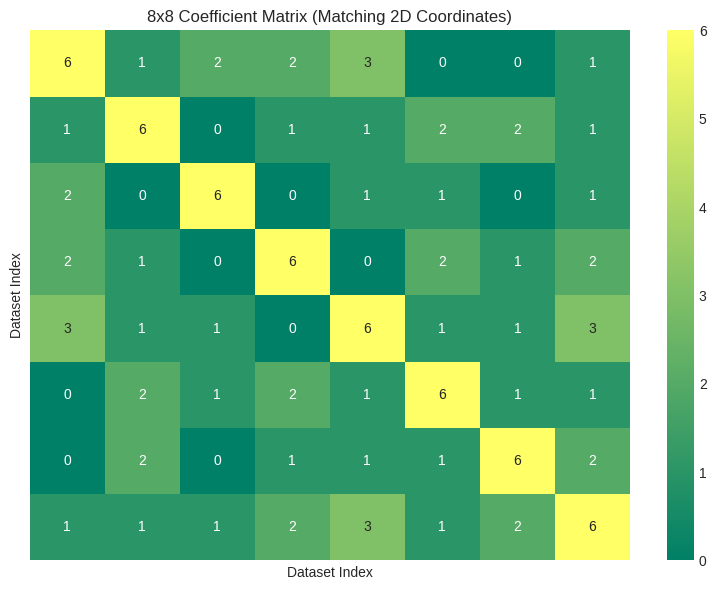

Coefficient Matrix:
   0  1  2  3  4  5  6  7
0  6  1  2  2  3  0  0  1
1  1  6  0  1  1  2  2  1
2  2  0  6  0  1  1  0  1
3  2  1  0  6  0  2  1  2
4  3  1  1  0  6  1  1  3
5  0  2  1  2  1  6  1  1
6  0  2  0  1  1  1  6  2
7  1  1  1  2  3  1  2  6


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

# Step 1: Original data
data = np.array([
    [2, 1, 2, 2, 4, 4],  # STL10
    [4, 1, 3, 3, 2, 1],  # MNIST
    [2, 2, 2, 1, 1, 3],  # FMNIST
    [1, 1, 1, 4, 4, 2],  # CIFAR10
    [2, 3, 3, 2, 3, 4],  # OXFORD-PETS
    [4, 4, 3, 4, 1, 2],  # CIFAR100
    [1, 4, 4, 3, 3, 1],  # FLOWERS102
    [2, 3, 1, 4, 3, 1]   # TinyIN
])

# Step 2: Mapping dictionary from int to 2D coordinate
mapping = {
    1: (1, 1),
    2: (1, 0),
    3: (0, 1),
    4: (0, 0)
}

# Step 3: Convert each number to its 2D coordinate
result = np.array([[[mapping[num] for num in row] for row in data]])
result = result.reshape(data.shape[0], data.shape[1], 2)

# Step 4: Compute 8x8 coefficient matrix
coefficient_matrix = np.zeros((8, 8), dtype=int)
for i in range(8):
    for j in range(8):
        coefficient_matrix[i, j] = np.sum(np.all(result[i] == result[j], axis=1))

# Step 5: Plot heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(coefficient_matrix, annot=True, cmap='summer', xticklabels=False, yticklabels=False)
plt.title("8x8 Coefficient Matrix (Matching 2D Coordinates)")
plt.xlabel("Dataset Index")
plt.ylabel("Dataset Index")
plt.tight_layout()
plt.show()

# Step 6: Print matrix
print("Coefficient Matrix:")
print(pd.DataFrame(coefficient_matrix))


In [ ]:
coefficient_matrix


array([[6, 1, 2, 2, 3, 0, 0, 1],
       [1, 6, 0, 1, 1, 2, 2, 1],
       [2, 0, 6, 0, 1, 1, 0, 1],
       [2, 1, 0, 6, 0, 2, 1, 2],
       [3, 1, 1, 0, 6, 1, 1, 3],
       [0, 2, 1, 2, 1, 6, 1, 1],
       [0, 2, 0, 1, 1, 1, 6, 2],
       [1, 1, 1, 2, 3, 1, 2, 6]])

Original Pearson Correlation Matrix:
             STL10  MNIST  FMNIST  CIFAR10  OXFORD-PETS  CIFAR100  FLOWERS102  \
STL10         1.00  -0.31    0.24     0.37         0.31     -0.60       -0.51   
MNIST        -0.31   1.00   -0.24    -0.03        -0.31      0.24       -0.17   
FMNIST        0.24  -0.24    1.00    -0.60        -0.12     -0.25        0.00   
CIFAR10       0.37  -0.03   -0.60     1.00         0.03     -0.12       -0.17   
OXFORD-PETS   0.31  -0.31   -0.12     0.03         1.00      0.12       -0.17   
CIFAR100     -0.60   0.24   -0.25    -0.12         0.12      1.00        0.00   
FLOWERS102   -0.51  -0.17    0.00    -0.17        -0.17      0.00        1.00   
TinyIN        0.03  -0.03   -0.24     0.31         0.37      0.24        0.17   

             TinyIN  
STL10          0.03  
MNIST         -0.03  
FMNIST        -0.24  
CIFAR10        0.31  
OXFORD-PETS    0.37  
CIFAR100       0.24  
FLOWERS102     0.17  
TinyIN         1.00  

Sorted Pearson Correlation Matrix:

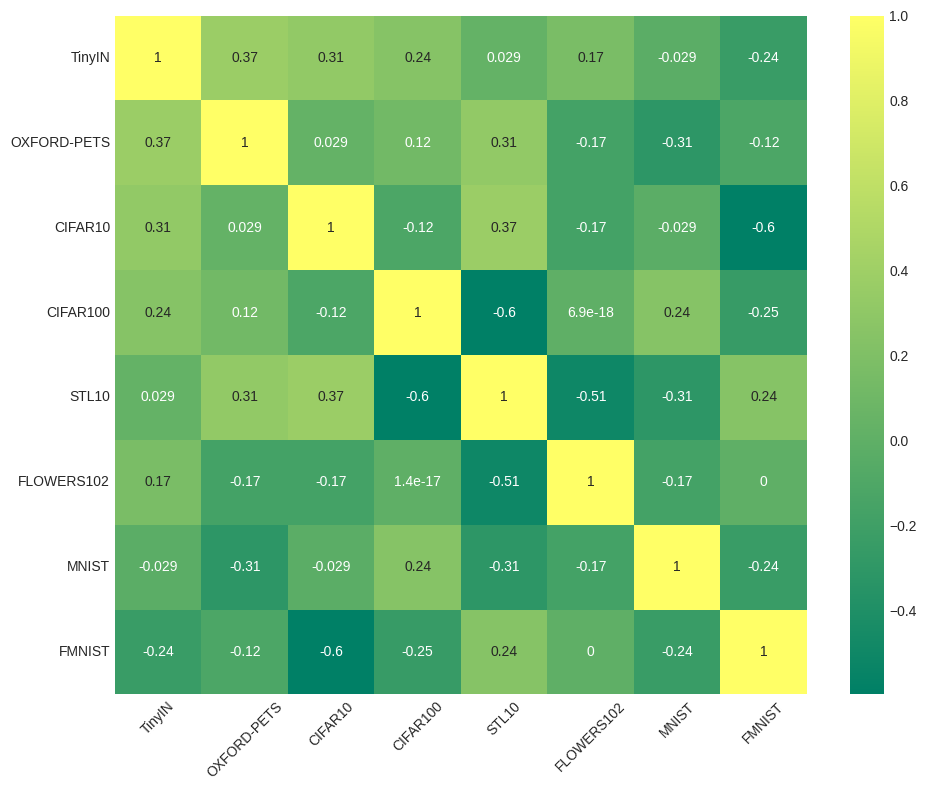

In [ ]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import pearsonr

# Dataset names in order
dataset_names = [
    "STL10", "MNIST", "FMNIST", "CIFAR10",
    "OXFORD-PETS", "CIFAR100", "FLOWERS102", "TinyIN"
]

# Original data
data = np.array([
    [2, 1, 2, 2, 4, 4],  # STL10
    [4, 1, 3, 3, 2, 1],  # MNIST
    [2, 2, 2, 1, 1, 3],  # FMNIST
    [1, 1, 1, 4, 4, 2],  # CIFAR10
    [2, 3, 3, 2, 3, 4],  # OXFORD-PETS
    [4, 4, 3, 4, 1, 2],  # CIFAR100
    [1, 4, 4, 3, 3, 1],  # FLOWERS102
    [2, 3, 1, 4, 3, 1]   # TinyIN
])

# Mapping from integers to 2D coordinates
mapping = {
    1: (1, 1),
    2: (1, 0),
    3: (0, 1),
    4: (0, 0)
}

# Convert each number to its 2D coordinate
result = np.array([[[mapping[num] for num in row] for row in data]])
result = result.reshape(data.shape[0], data.shape[1], 2)

# Compute Pearson correlation matrix
n = result.shape[0]
pearson_matrix = np.zeros((n, n))

for i in range(n):
    for j in range(n):
        vec_i = result[i].flatten()
        vec_j = result[j].flatten()
        corr, _ = pearsonr(vec_i, vec_j)
        pearson_matrix[i, j] = corr

# Convert to DataFrame with dataset names
df_pearson = pd.DataFrame(pearson_matrix, index=dataset_names, columns=dataset_names)

# Print original matrix
print("Original Pearson Correlation Matrix:")
print(df_pearson.round(2))

# Sort by total correlation per row
row_order = df_pearson.sum(axis=1).sort_values(ascending=False).index
sorted_df = df_pearson.loc[row_order, row_order]

# Print sorted matrix
print("\nSorted Pearson Correlation Matrix:")
print(sorted_df.round(2))

# Plot sorted matrix with labels
plt.figure(figsize=(10, 8))
sns.heatmap(sorted_df, annot=True, cmap='summer')
# plt.title("Sorted Pearson Correlation Matrix (with Dataset Names)")
plt.xticks(rotation=45)
plt.yticks(rotation=0)

plt.tight_layout()
plt.savefig("temprature_map3.png", transparent=True, dpi=300)
plt.show()


In [ ]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import pearsonr

# Dataset names
dataset_names = [
    "STL10", "MNIST", "FMNIST", "CIFAR10",
    "OXFORD-PETS", "CIFAR100", "FLOWERS102", "TinyIN"
]

# Original data
data = np.array([
    [2, 1, 2, 2, 4, 4],  # STL10
    [4, 1, 3, 3, 2, 1],  # MNIST
    [2, 2, 2, 1, 1, 3],  # FMNIST
    [1, 1, 1, 4, 4, 2],  # CIFAR10
    [2, 3, 3, 2, 3, 4],  # OXFORD-PETS
    [4, 4, 3, 4, 1, 2],  # CIFAR100
    [1, 4, 4, 3, 3, 1],  # FLOWERS102
    [2, 3, 1, 4, 3, 1]   # TinyIN
])

# Mapping dictionary
mapping = {
    1: (1, 1),
    2: (1, 0),
    3: (0, 1),
    4: (0, 0)
}

# Convert to (8, 6, 2) format
result = np.array([[[mapping[num] for num in row] for row in data]])
result = result.reshape(data.shape[0], data.shape[1], 2)

# Compute Pearson correlation matrix
n = result.shape[0]
pearson_matrix = np.zeros((n, n))

for i in range(n):
    for j in range(n):
        vec_i = result[i].flatten()
        vec_j = result[j].flatten()
        corr, _ = pearsonr(vec_i, vec_j)
        pearson_matrix[i, j] = corr

# Convert to DataFrame with names
df_pearson = pd.DataFrame(pearson_matrix, index=dataset_names, columns=dataset_names)

# Build sorted similarity list for each dataset
sorted_similarities = {}
for dataset in df_pearson.index:
    sorted_others = df_pearson.loc[dataset].drop(dataset).sort_values(ascending=False)
    sorted_similarities[dataset] = list(sorted_others.index)

# Format as DataFrame
sorted_similarity_df = pd.DataFrame(dict([(k, pd.Series(v)) for k, v in sorted_similarities.items()]))

# Print both
print("Pearson Correlation Matrix:\n")
print(df_pearson.round(2))

print("\nSorted Similarities Per Dataset:\n")
print(sorted_similarity_df)


Pearson Correlation Matrix:

             STL10  MNIST  FMNIST  CIFAR10  OXFORD-PETS  CIFAR100  FLOWERS102  \
STL10         1.00  -0.31    0.24     0.37         0.31     -0.60       -0.51   
MNIST        -0.31   1.00   -0.24    -0.03        -0.31      0.24       -0.17   
FMNIST        0.24  -0.24    1.00    -0.60        -0.12     -0.25        0.00   
CIFAR10       0.37  -0.03   -0.60     1.00         0.03     -0.12       -0.17   
OXFORD-PETS   0.31  -0.31   -0.12     0.03         1.00      0.12       -0.17   
CIFAR100     -0.60   0.24   -0.25    -0.12         0.12      1.00        0.00   
FLOWERS102   -0.51  -0.17    0.00    -0.17        -0.17      0.00        1.00   
TinyIN        0.03  -0.03   -0.24     0.31         0.37      0.24        0.17   

             TinyIN  
STL10          0.03  
MNIST         -0.03  
FMNIST        -0.24  
CIFAR10        0.31  
OXFORD-PETS    0.37  
CIFAR100       0.24  
FLOWERS102     0.17  
TinyIN         1.00  

Sorted Similarities Per Dataset:

        

The Pearson correlation matrix you've computed reflects how similarly your model selects features across different datasets. Each dataset's feature selection pattern is represented by a sequence of 2D coordinates derived from model outputs. When two datasets exhibit a high Pearson correlation, it means that the model tends to select similar types of features for both—possibly focusing on spatial or semantic patterns that are shared. This is particularly meaningful if you're assessing the transferability of learned feature importance across tasks or domains.

For example, CIFAR10 and STL10 show a high correlation, indicating that the model selects features in a very similar way for these two datasets. This makes sense because both are object-centric datasets, and the model likely focuses on similar spatial patterns, such as edges or object contours. Similarly, FMNIST (Fashion MNIST) shows moderate correlation with datasets like STL10 and OXFORD-PETS, which could mean that the model learns to identify consistent region-based features, like shapes or silhouettes, even across different domains like fashion and animals.

On the other hand, OXFORD-PETS and FLOWERS102 tend to have lower correlation with datasets like MNIST or CIFAR100. This suggests that the model adjusts its feature selection significantly when dealing with these datasets, likely because the nature of their visual features (textures, fur, pet faces) is quite distinct from simple digits or diverse object classes. Datasets like Tiny ImageNet (TinyIN) show moderate correlation with many others, suggesting a balanced and somewhat generalizable feature selection pattern. It neither strongly aligns nor diverges from the majority, indicating it may serve as a bridge between more distinct datasets.

In summary, datasets with higher Pearson correlation scores can be seen as more compatible in terms of how the model interprets and prioritizes their features. This insight can help guide transfer learning strategies—by choosing pretraining datasets with high feature selection similarity to your target dataset—or provide justification for grouping datasets with similar feature importance behaviors in multi-task learning settings.

Our model demonstrates consistent and interpretable feature selection behavior across a diverse range of datasets, as evidenced by the Pearson correlation analysis of the selected feature coordinates. High correlation values between datasets such as CIFAR10 and STL10 suggest that the model reliably identifies and prioritizes similar types of spatial features—such as edges and object structures—when presented with visually analogous tasks. This alignment supports the model's robustness and its capacity for feature generalization in object-centric domains.

Furthermore, moderate correlations observed between datasets of differing domains, such as FMNIST and STL10 or TinyIN and FLOWERS102, indicate that the model is adaptable without being erratic—it adjusts feature selection to account for domain-specific differences while maintaining some consistency. Lower correlation with datasets like OXFORD-PETS further underscores the model's flexibility in tailoring its internal representations to more specialized or visually distinct classes. Collectively, these results validate the model’s capacity to generalize where appropriate and specialize when necessary, making it a strong candidate for both single-domain learning and multi-domain transfer applications.

# CIFAR10

In [ ]:
import torch
from torchvision import datasets, transforms
import numpy as np
from matplotlib import pyplot as plt

### class 1

100%|██████████| 170M/170M [00:08<00:00, 20.0MB/s]


0


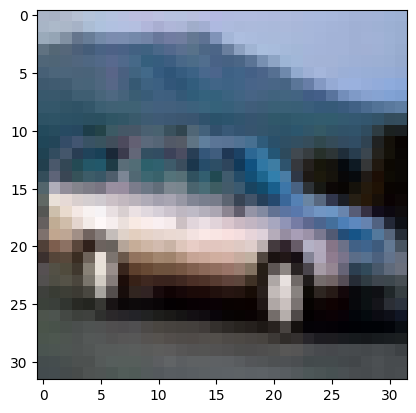

1


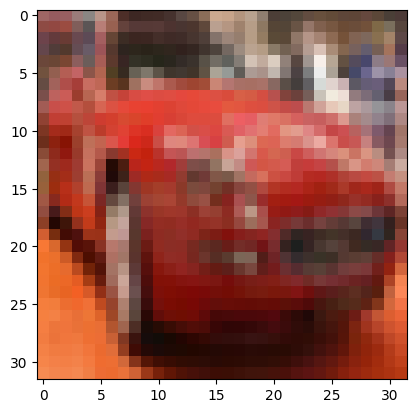

2


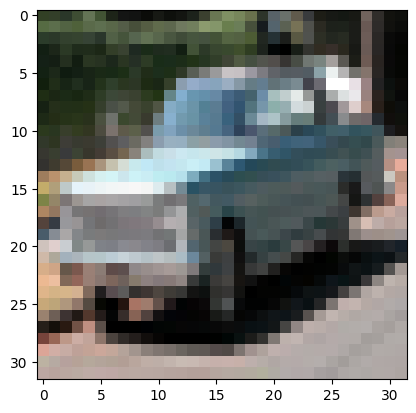

3


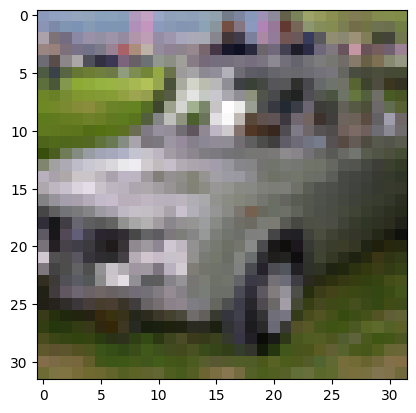

4


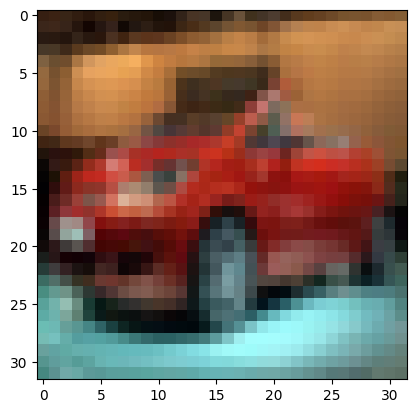

5


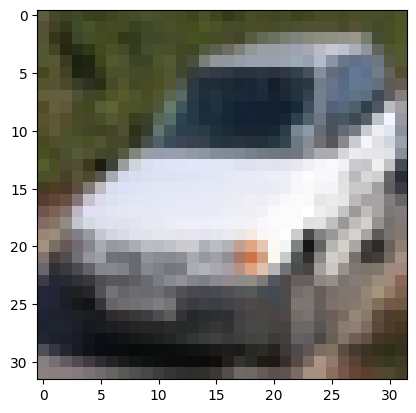

6


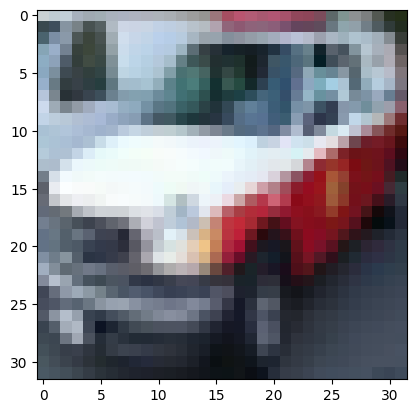

7


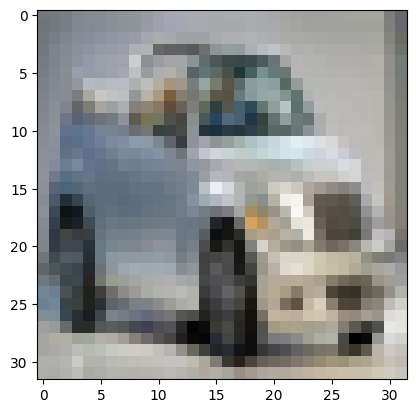

8


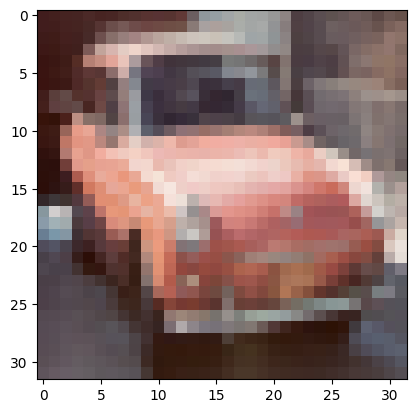

9


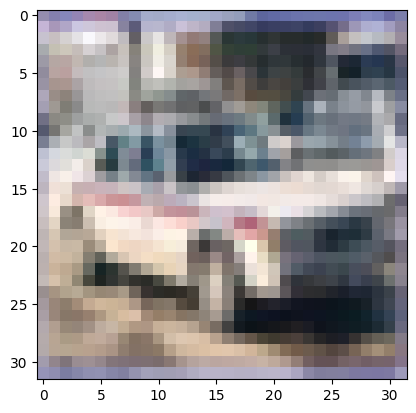

10


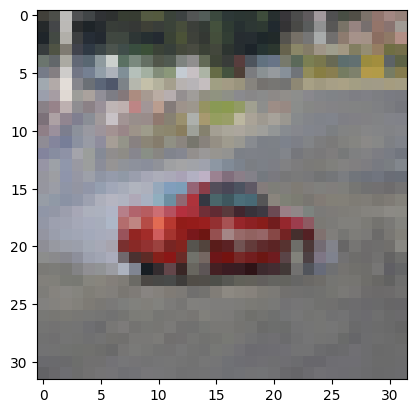

11


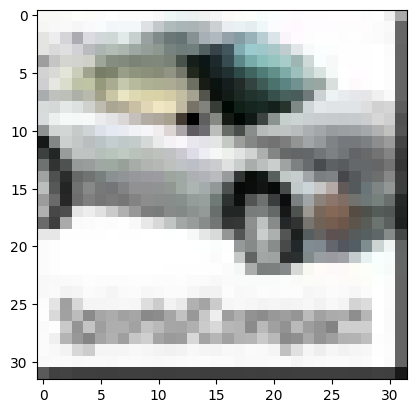

12


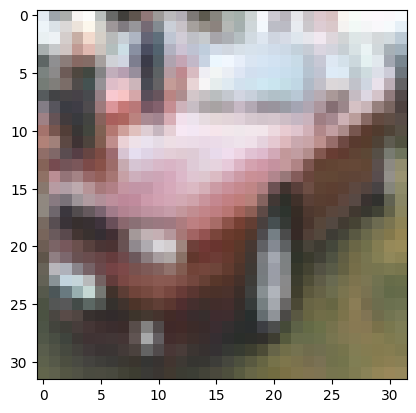

13


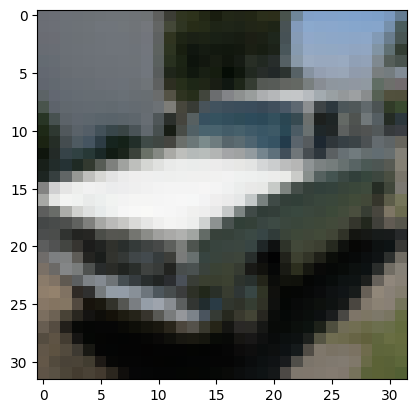

14


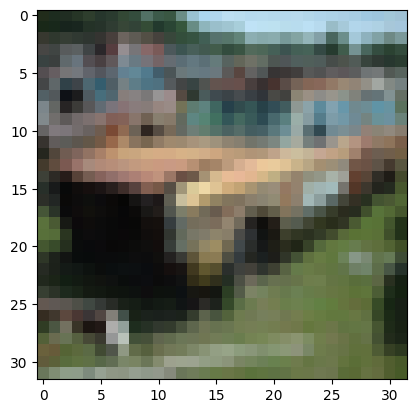

15


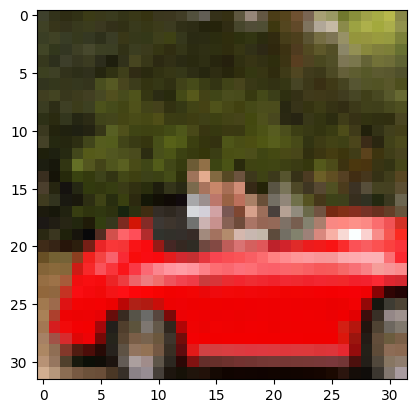

16


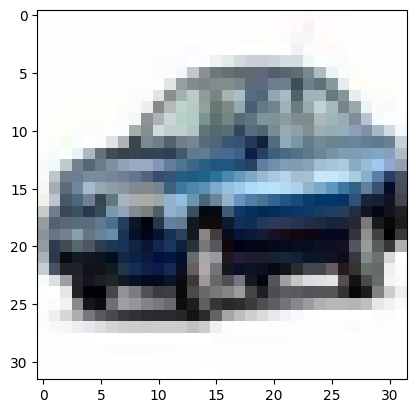

17


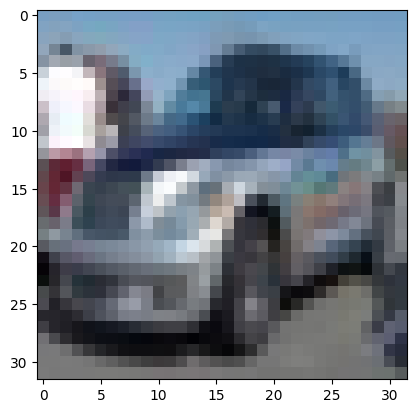

18


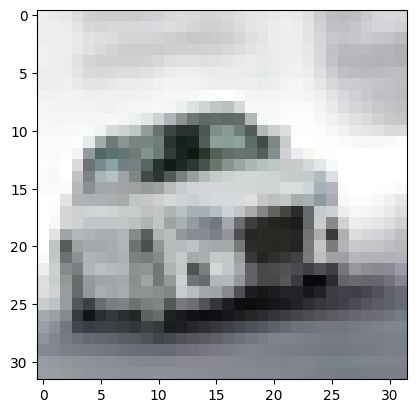

19


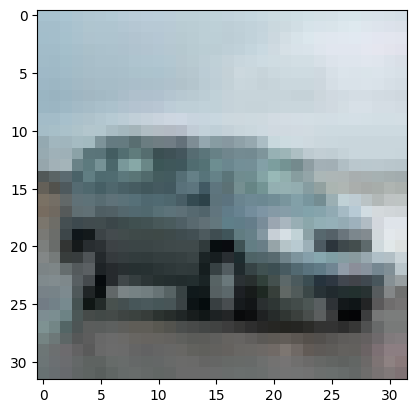

20


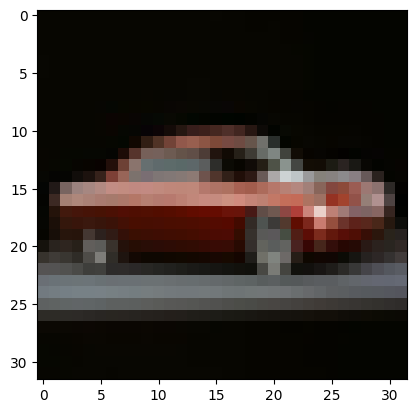

21


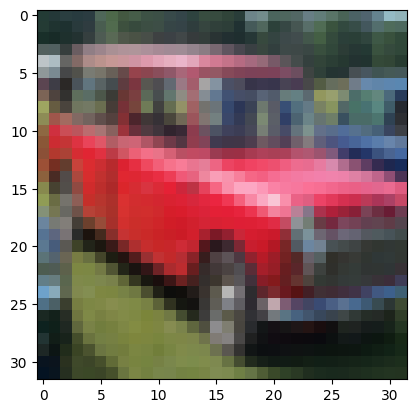

22


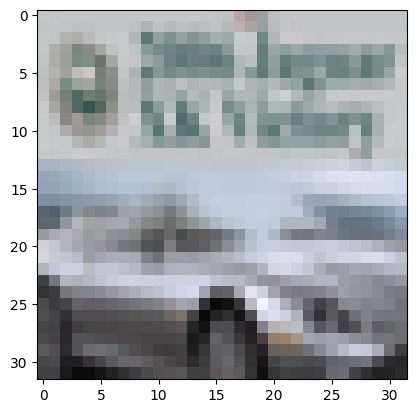

23


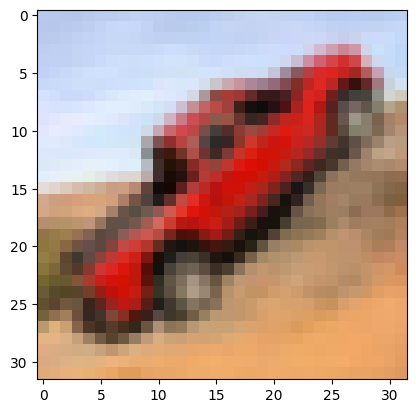

24


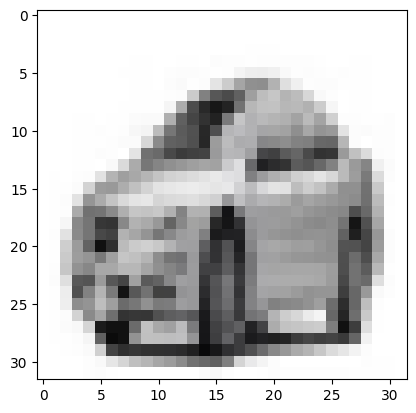

25


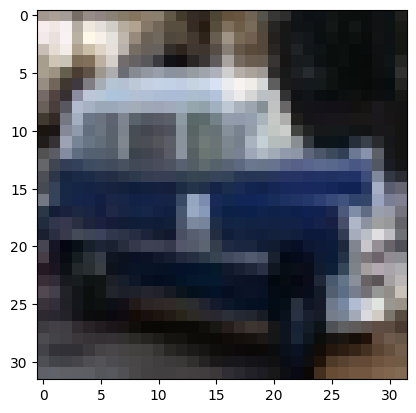

26


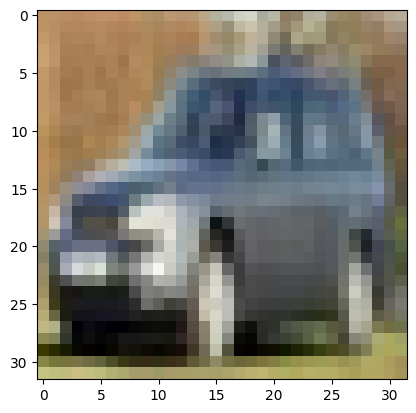

27


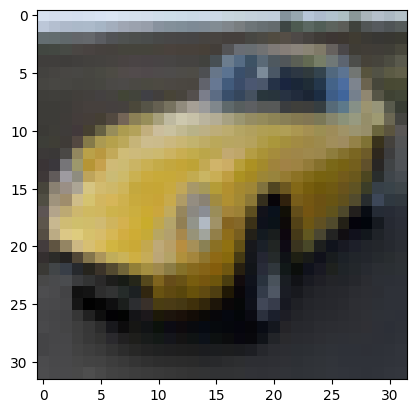

28


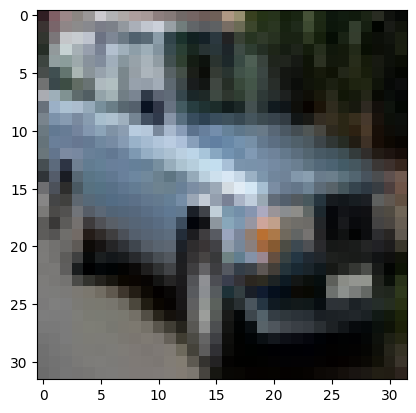

29


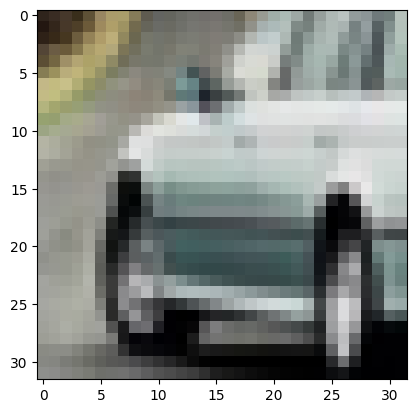

30


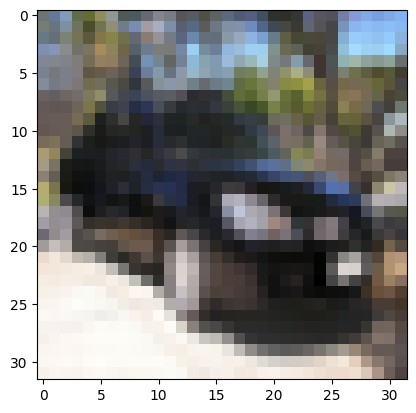

31


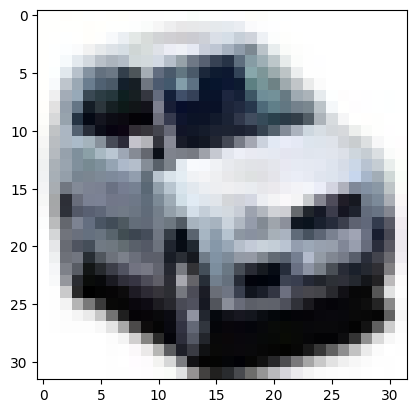

32


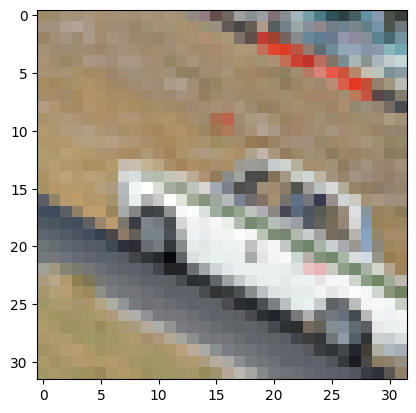

33


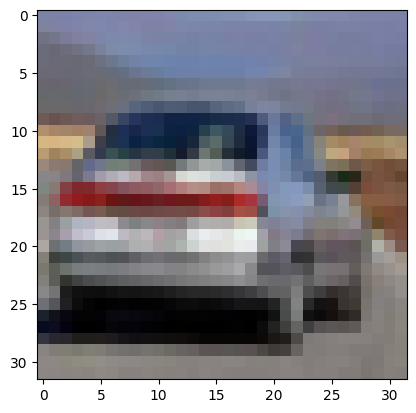

34


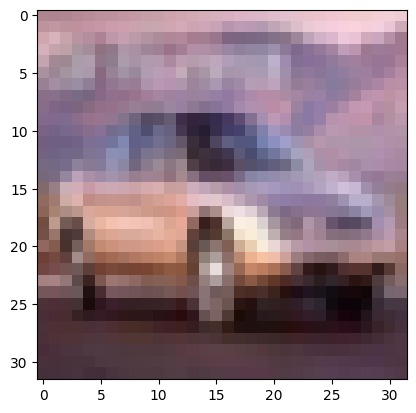

35


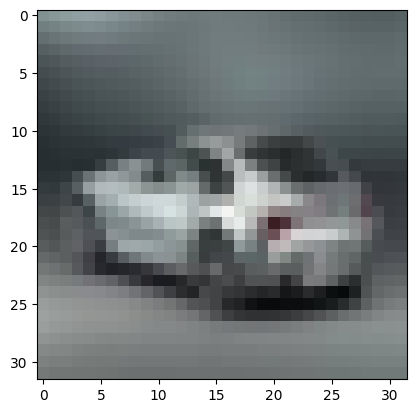

36


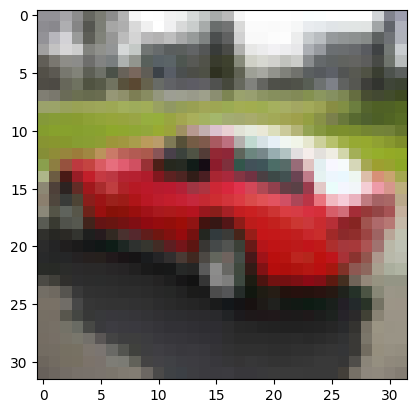

37


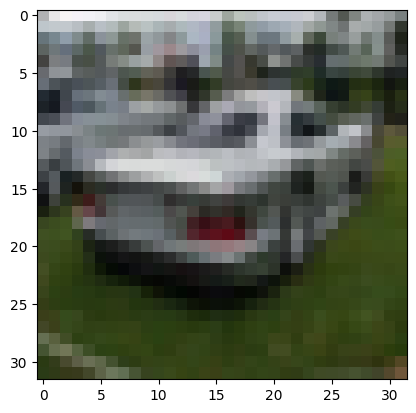

38


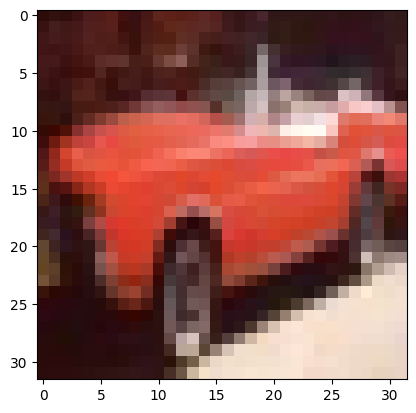

39


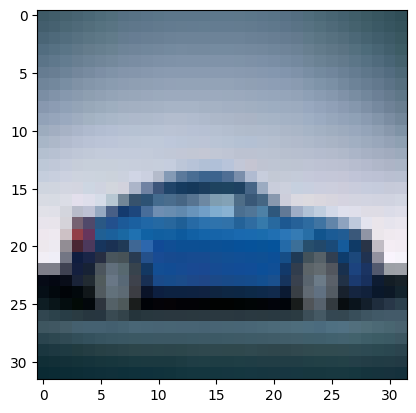

40


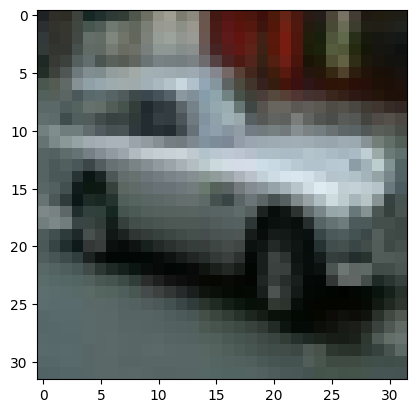

41


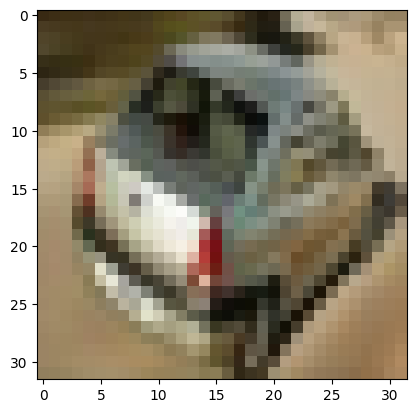

42


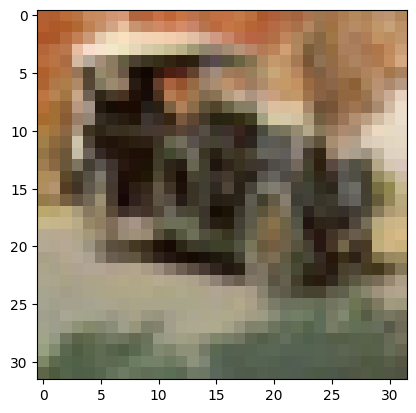

43


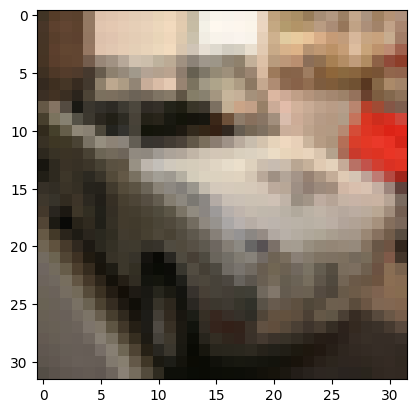

44


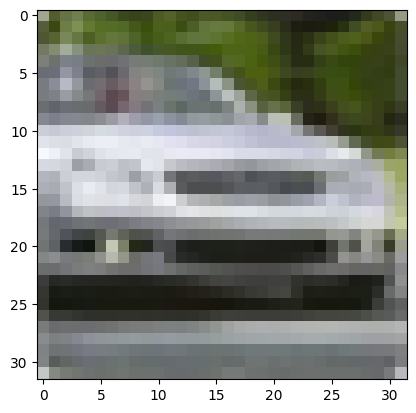

45


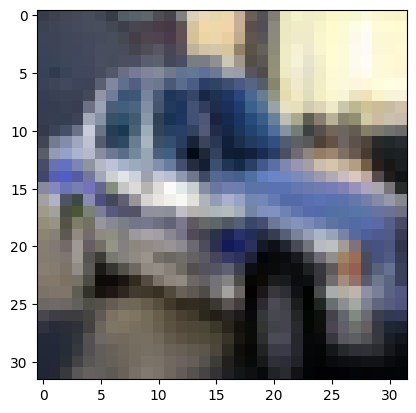

46


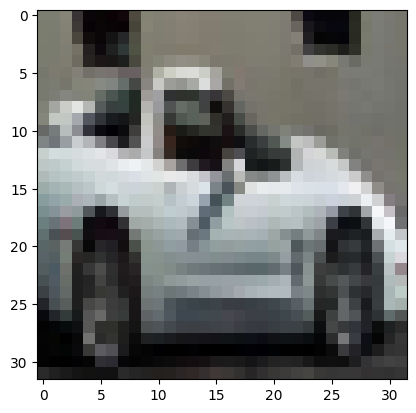

47


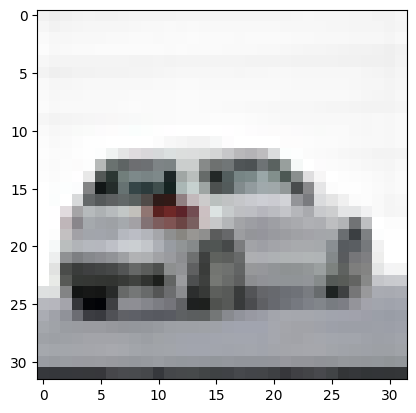

48


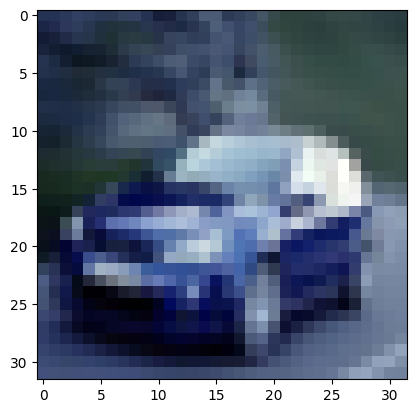

49


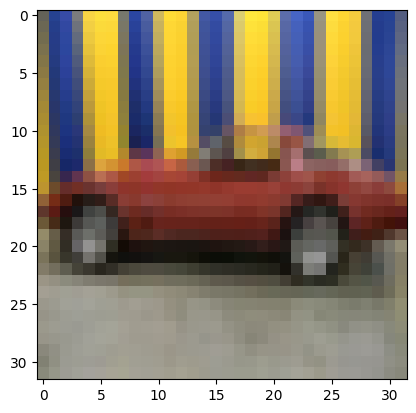

50


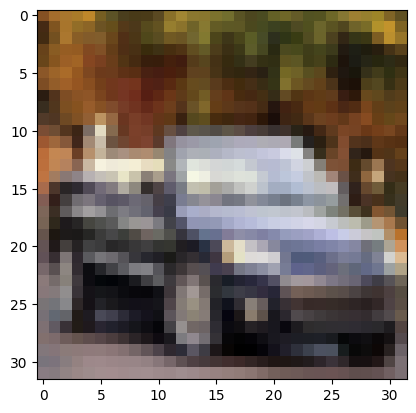

51


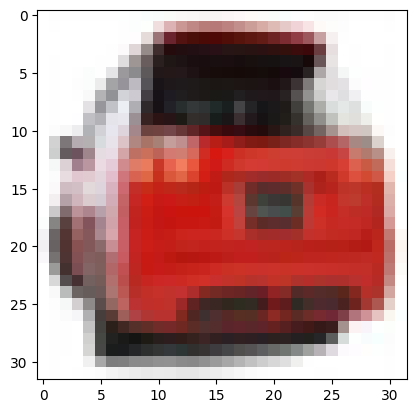

52


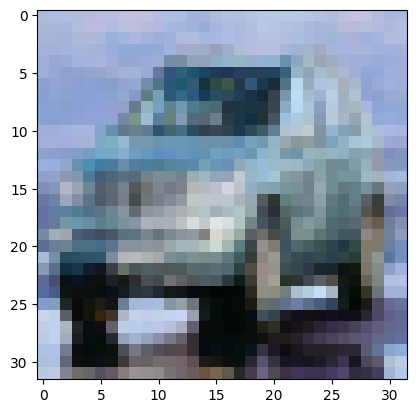

53


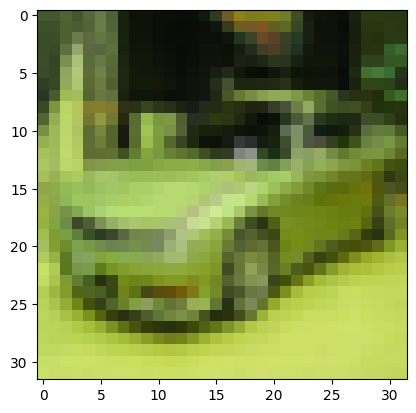

54


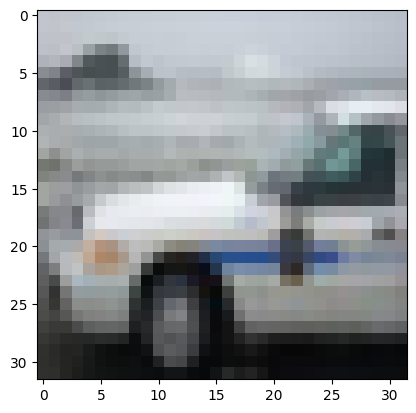

55


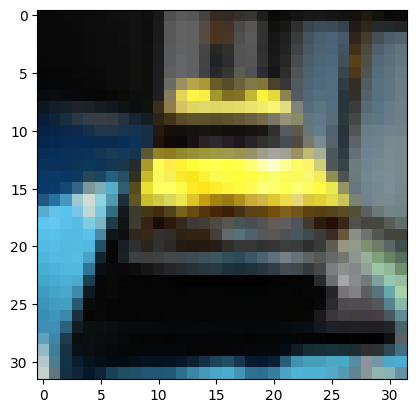

56


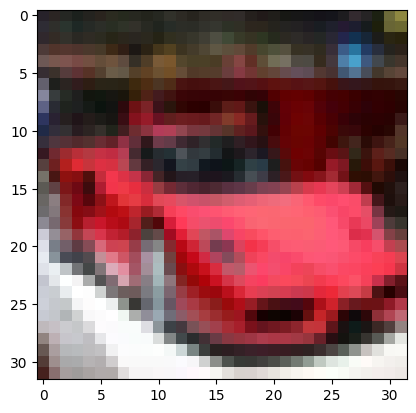

57


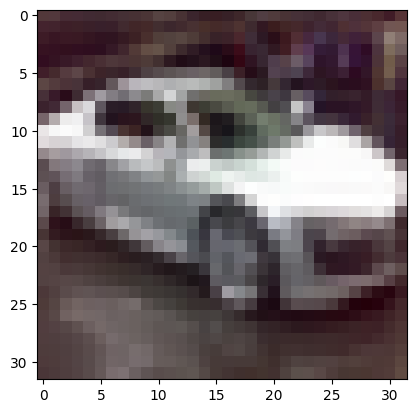

58


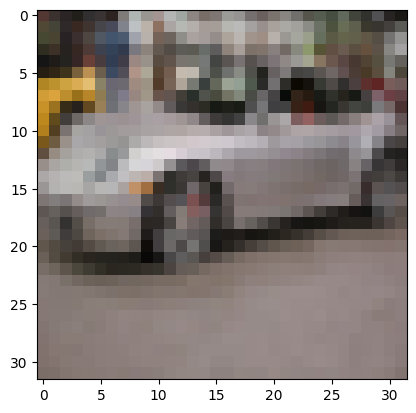

59


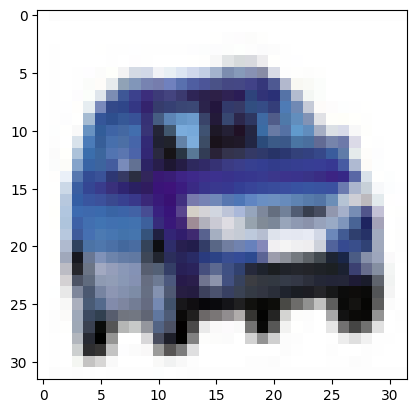

60


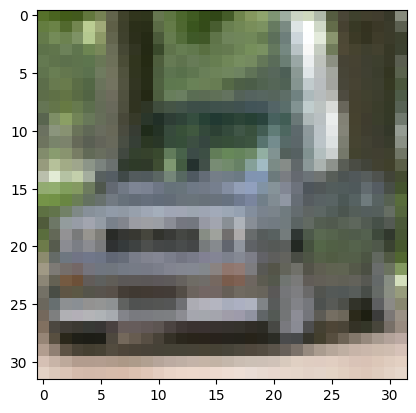

61


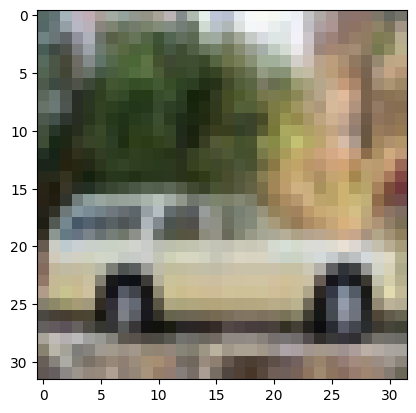

62


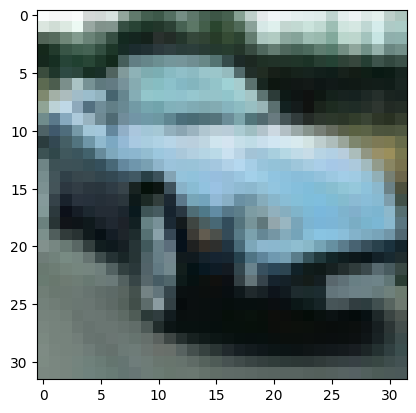

63


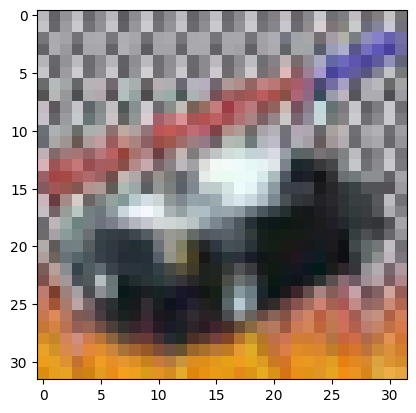

64


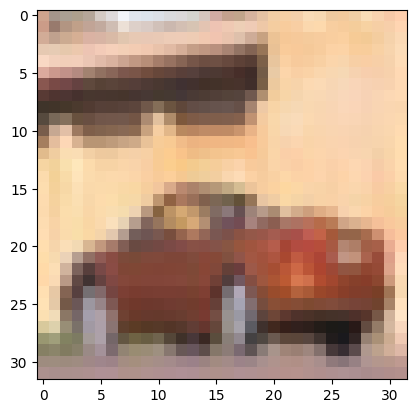

65


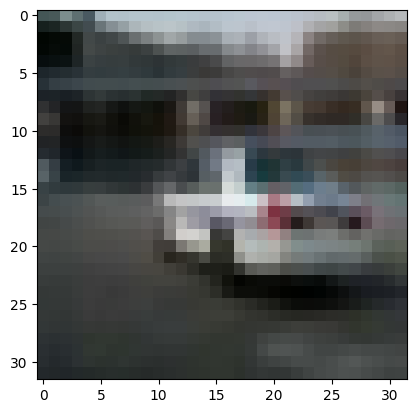

66


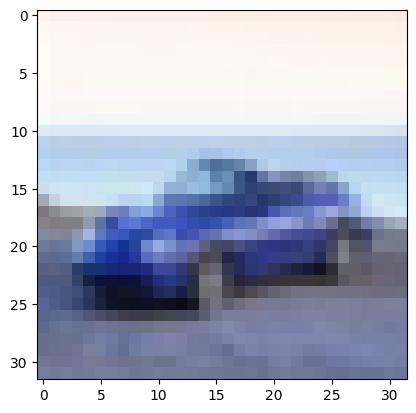

67


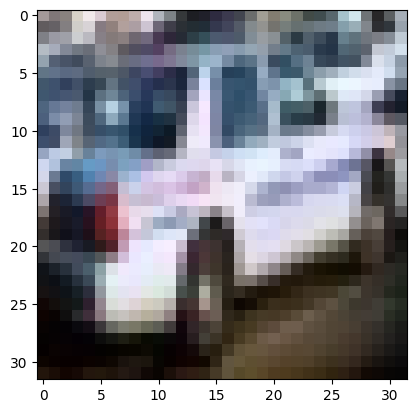

68


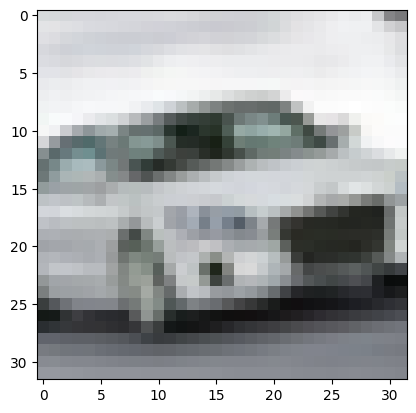

69


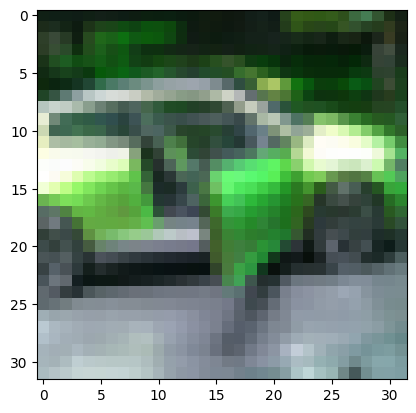

70


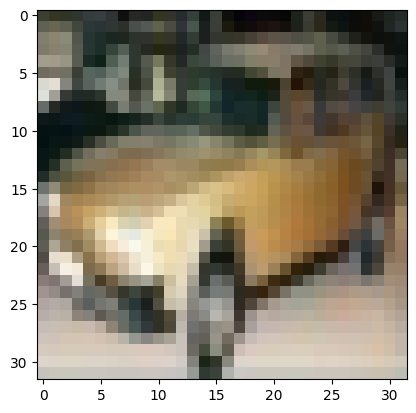

71


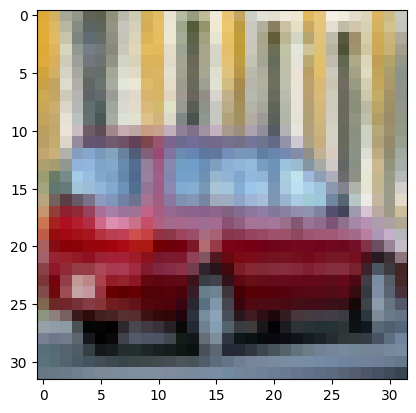

72


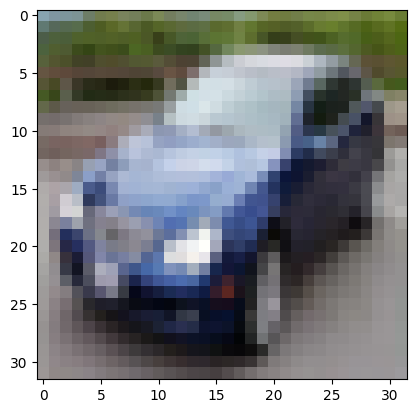

73


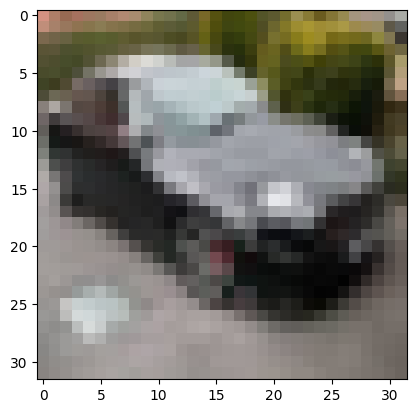

74


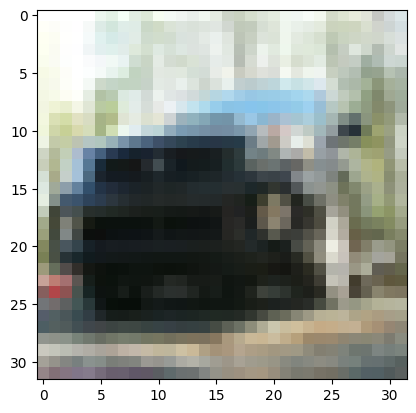

75


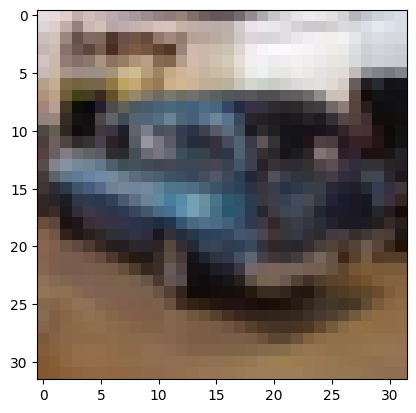

76


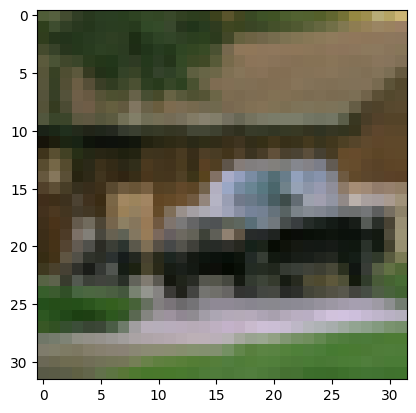

77


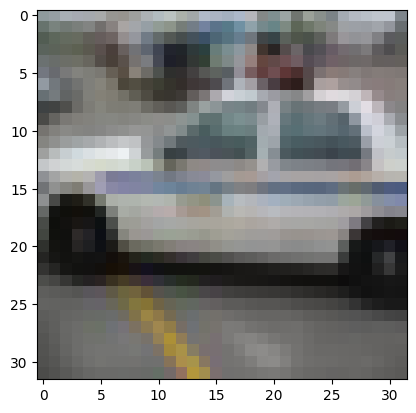

78


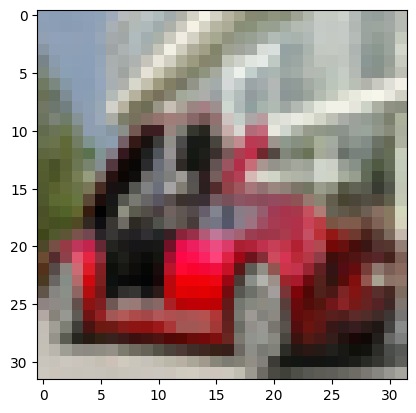

79


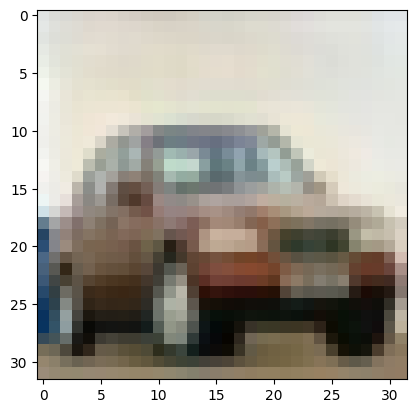

80


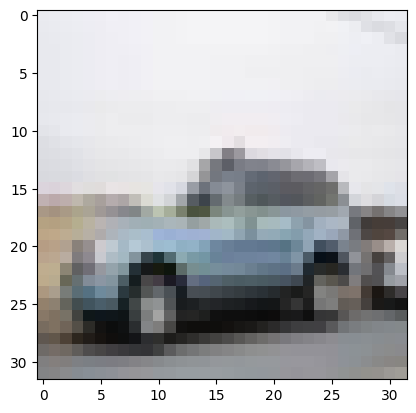

81


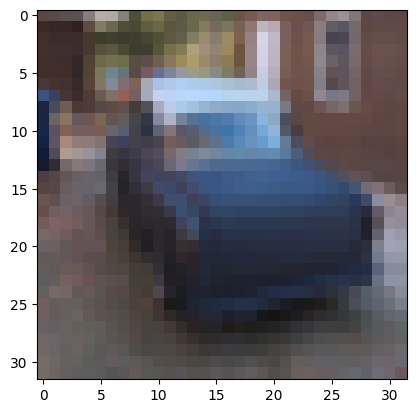

82


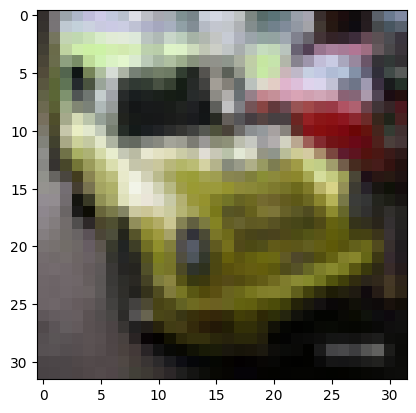

83


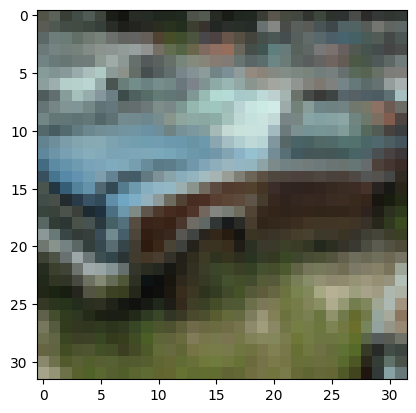

84


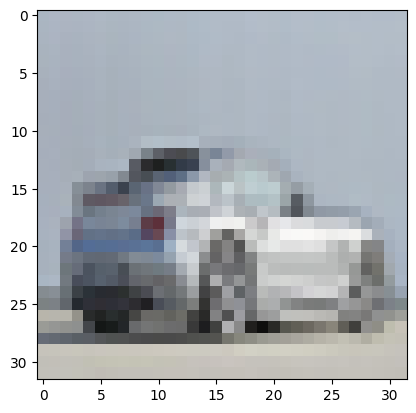

85


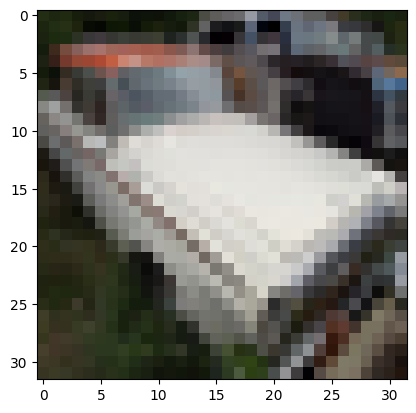

86


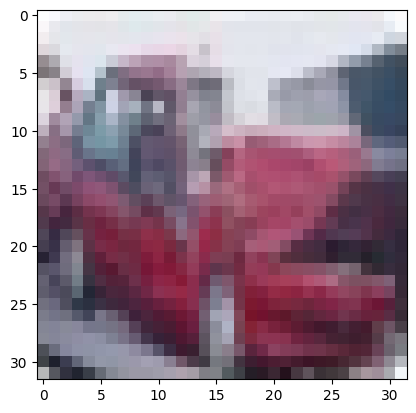

87


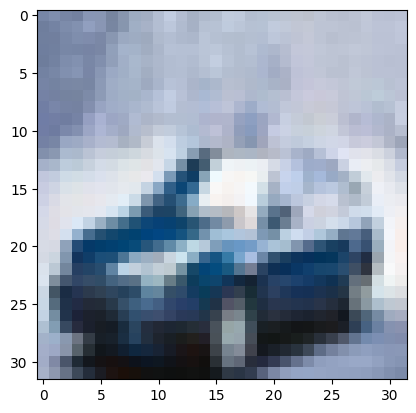

88


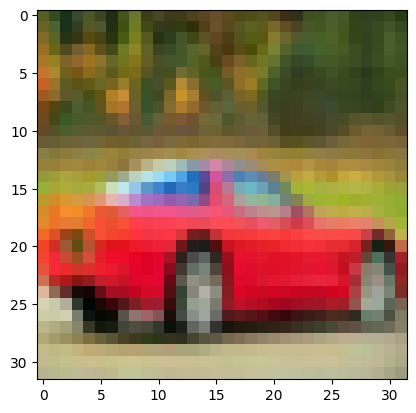

89


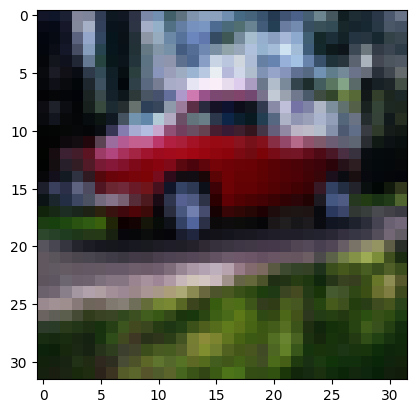

90


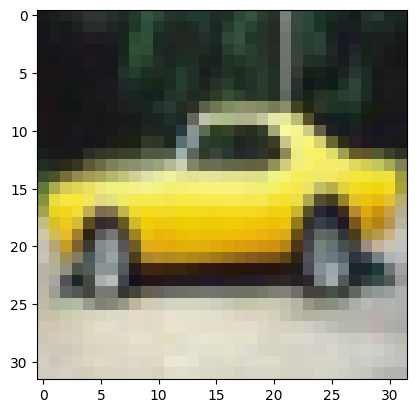

91


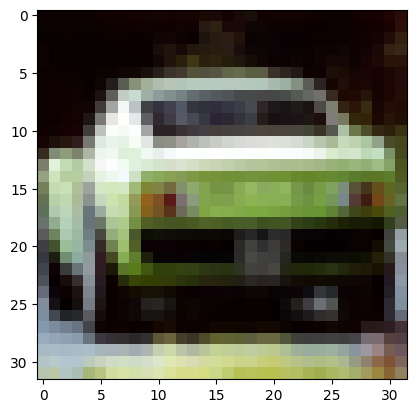

92


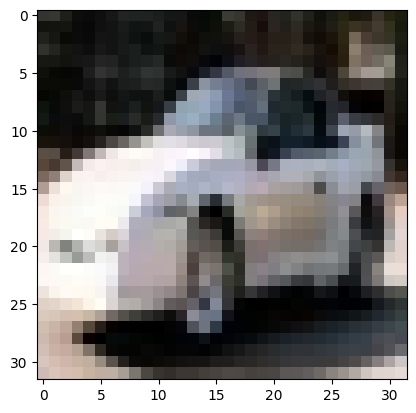

93


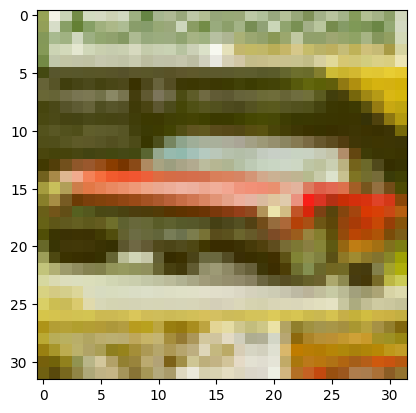

94


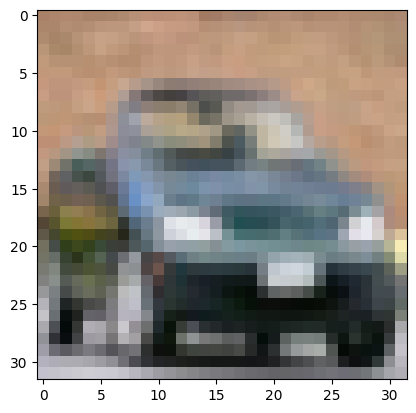

95


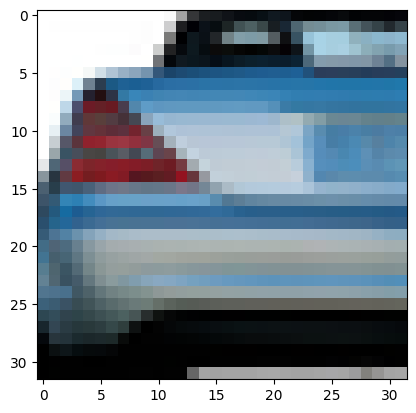

96


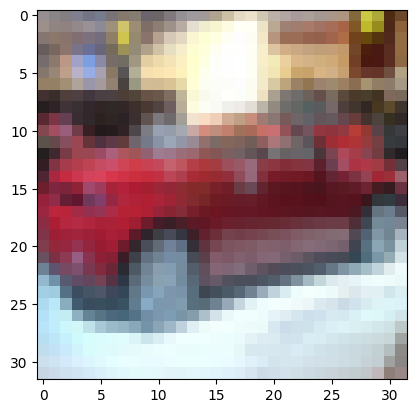

97


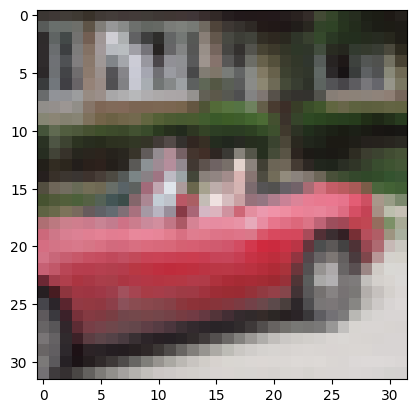

98


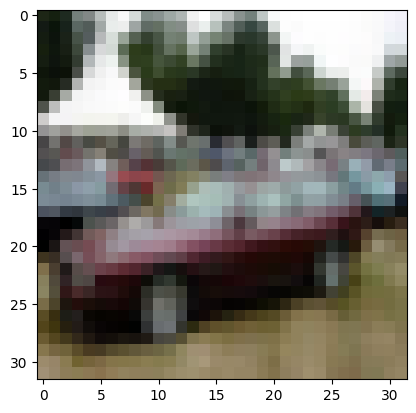

99


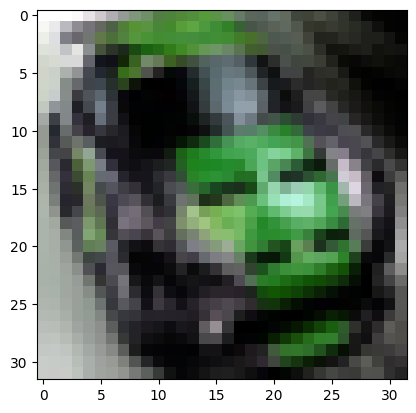

In [ ]:
# Load CIFAR-10
train_data = datasets.CIFAR10(root='./data', train=True, download=True)
clas = 1

# Get all ship images and labels
images1 = [img for img, label in train_data if label == clas]
#print(f"Number of 1 images: {len(ship_images)}")  # Output: 5000 (train)

for i in range(100):
  print(i)
  plt.imshow(images1[i])
  plt.show()

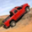

In [ ]:
images1[23]

### 2

0


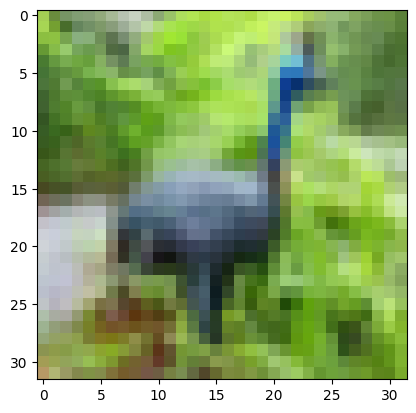

1


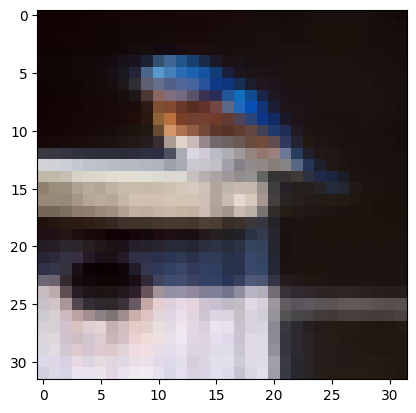

2


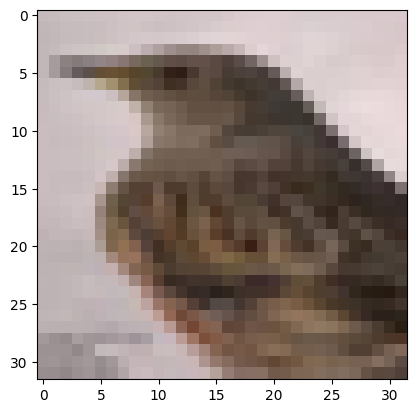

3


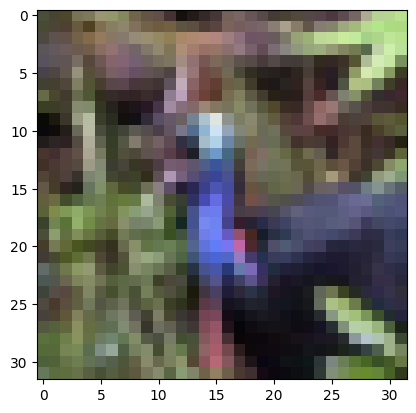

4


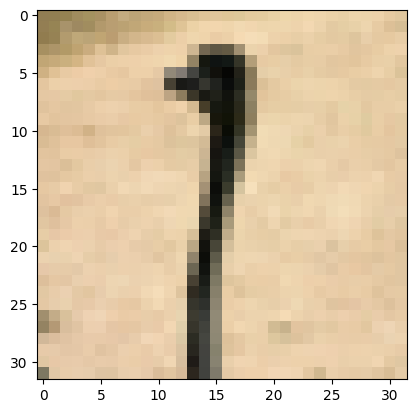

5


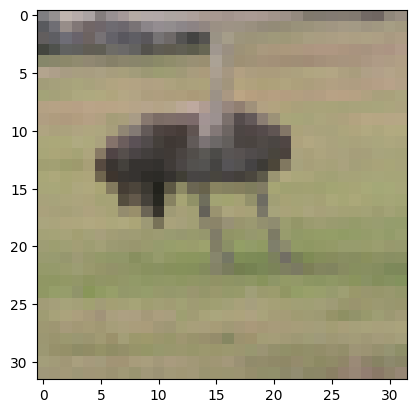

6


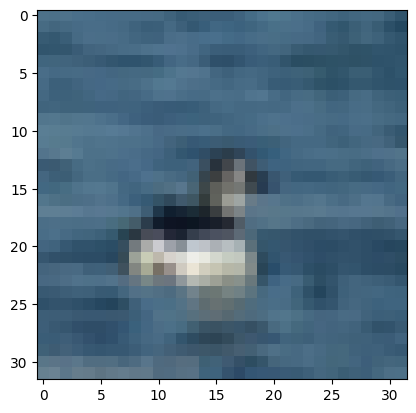

7


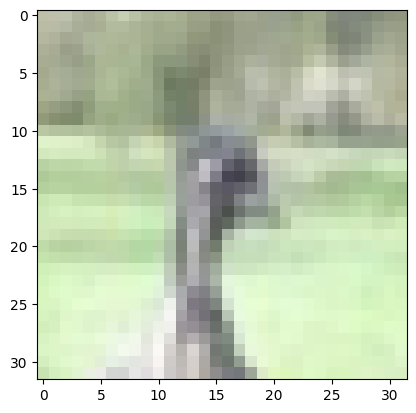

8


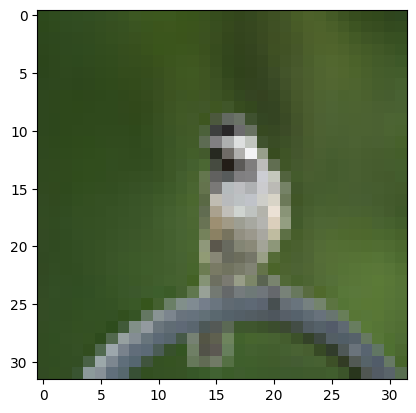

9


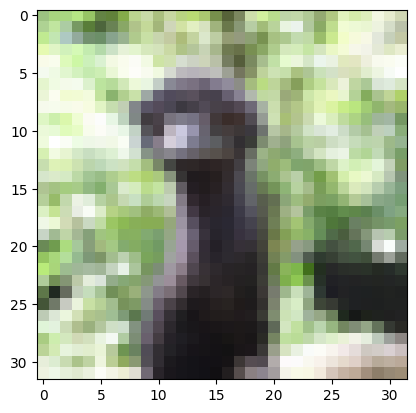

10


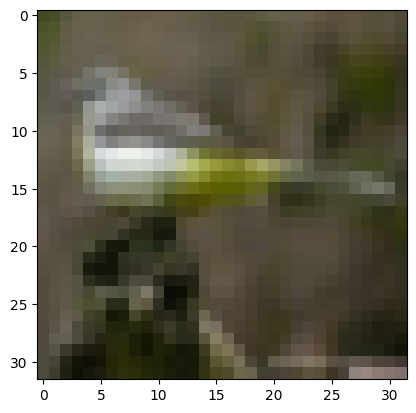

11


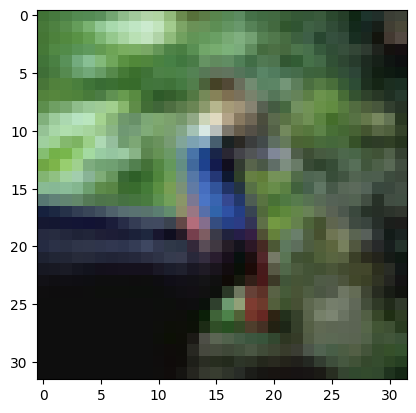

12


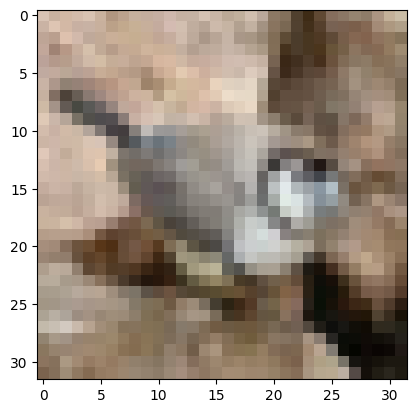

13


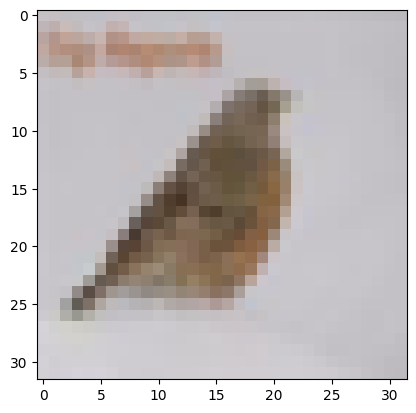

14


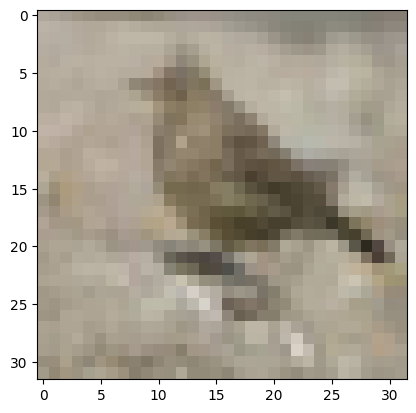

15


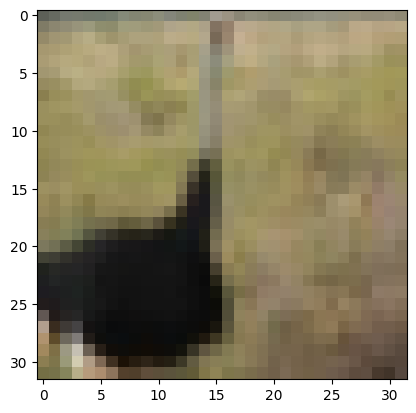

16


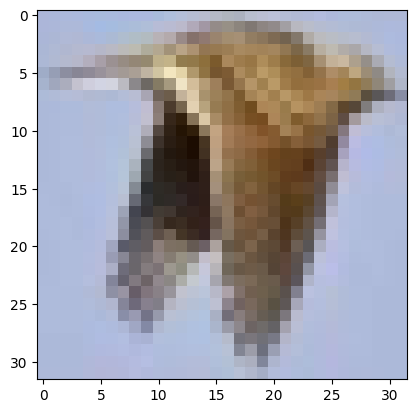

17


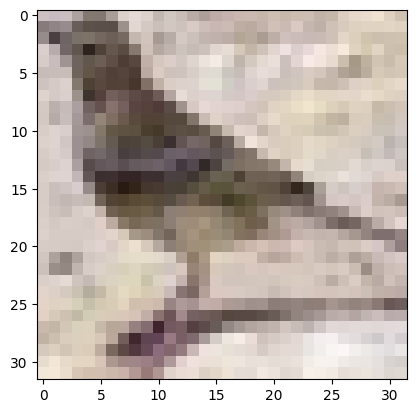

18


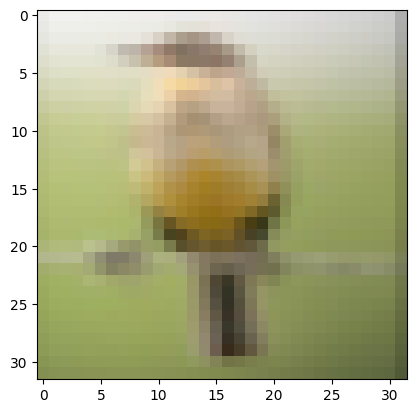

19


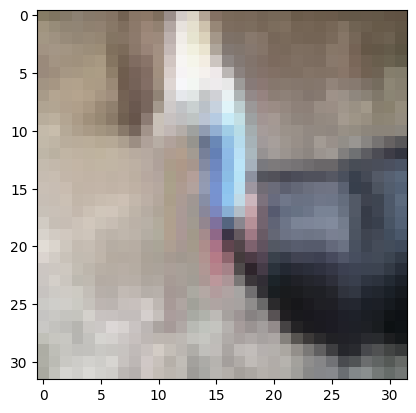

20


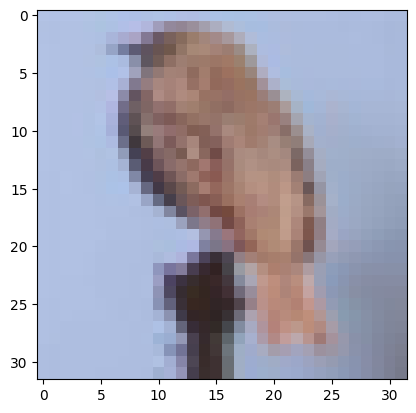

21


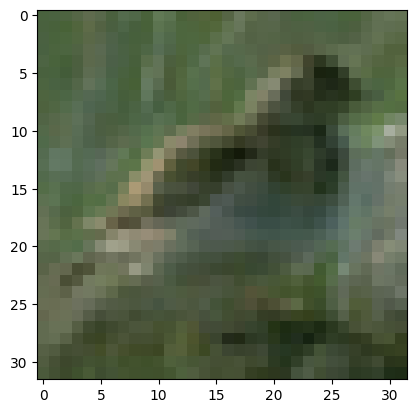

22


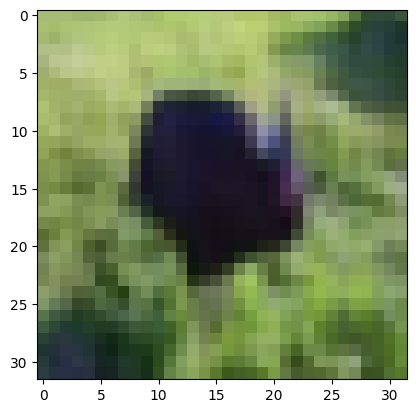

23


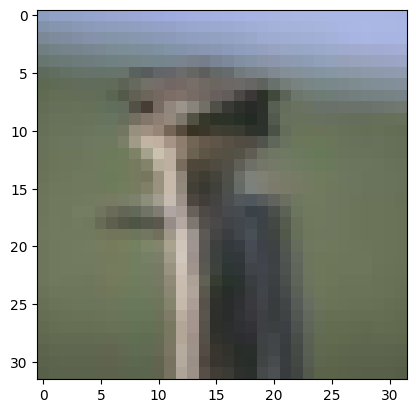

24


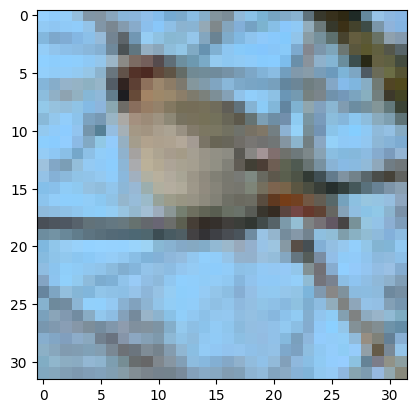

25


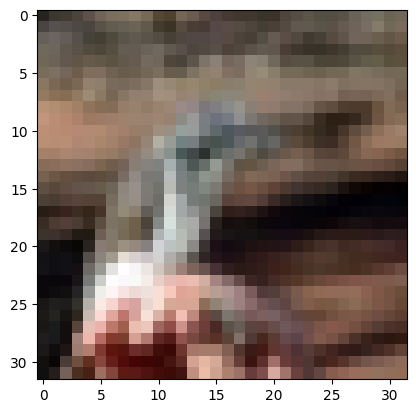

26


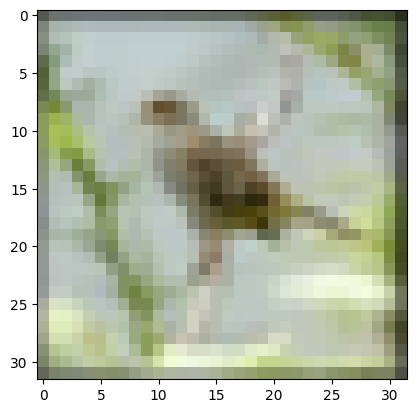

27


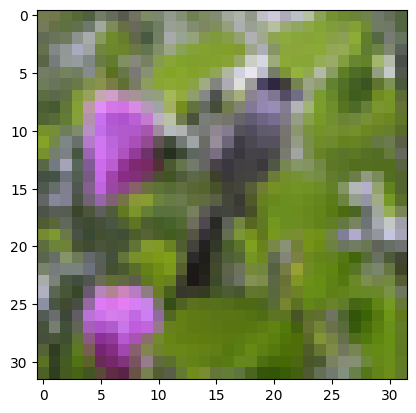

28


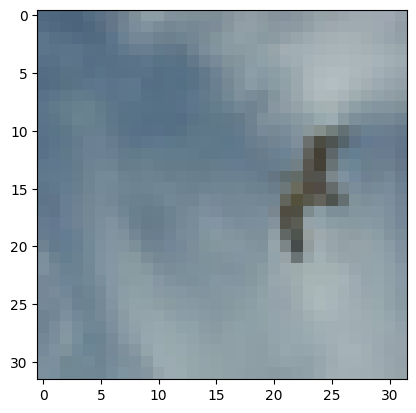

29


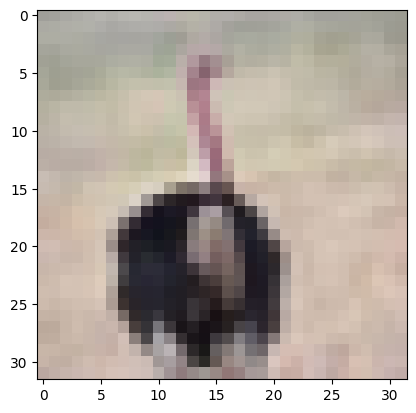

30


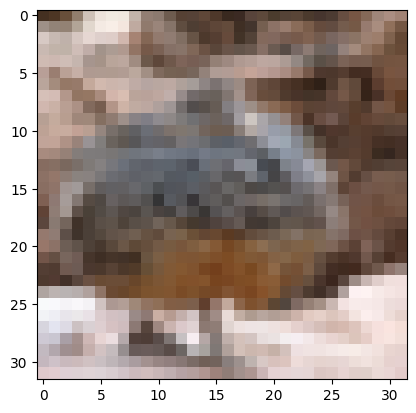

31


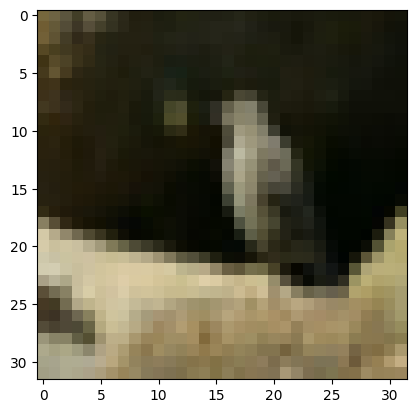

32


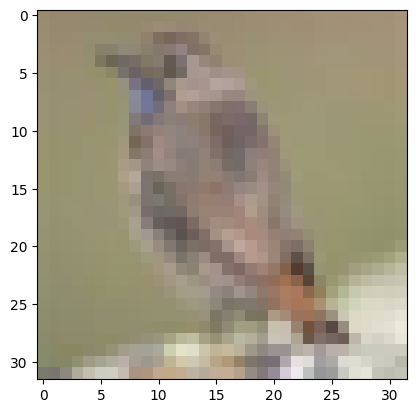

33


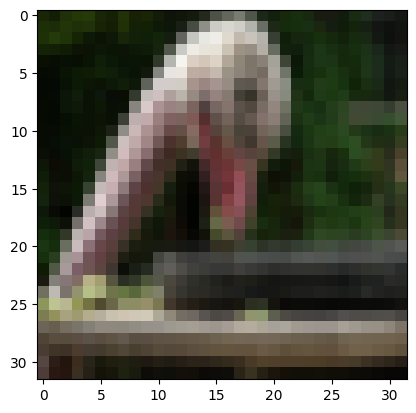

34


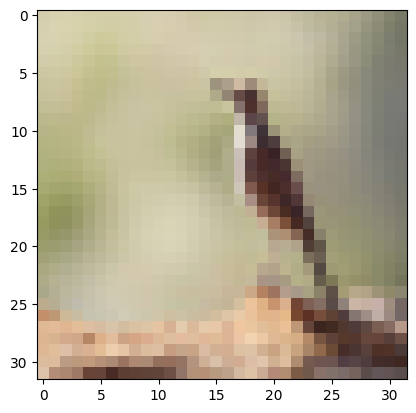

35


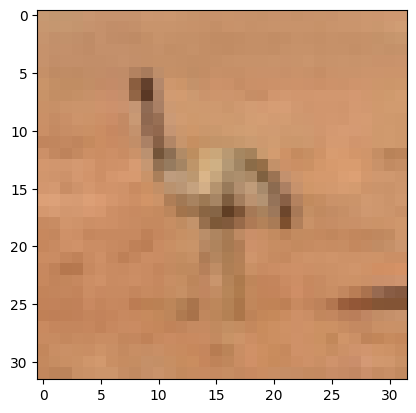

36


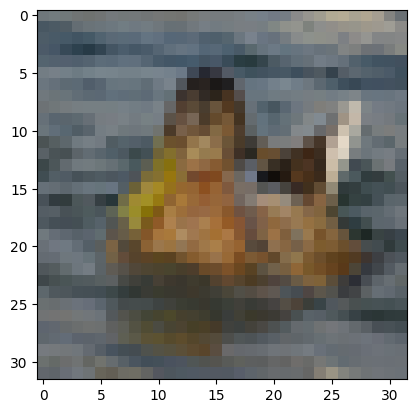

37


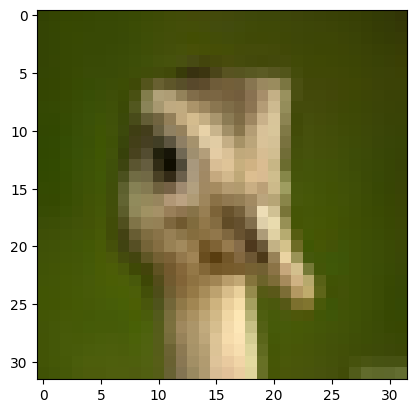

38


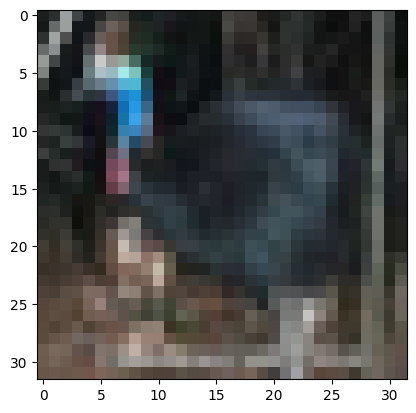

39


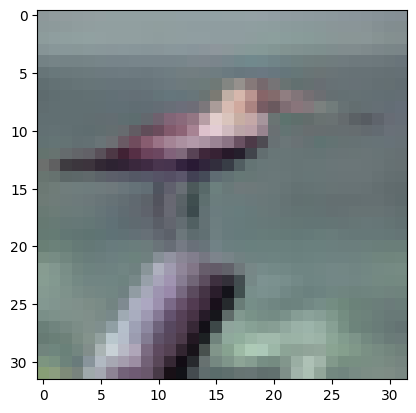

40


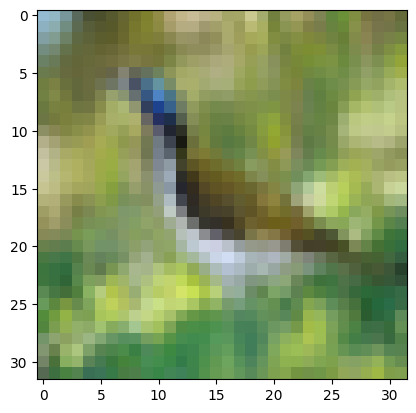

41


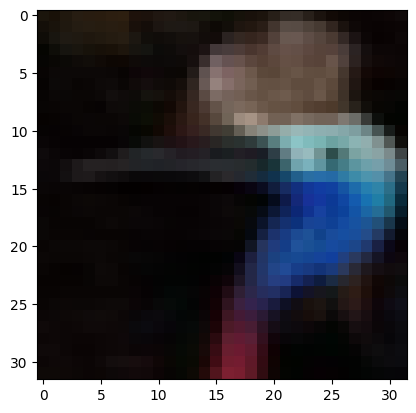

42


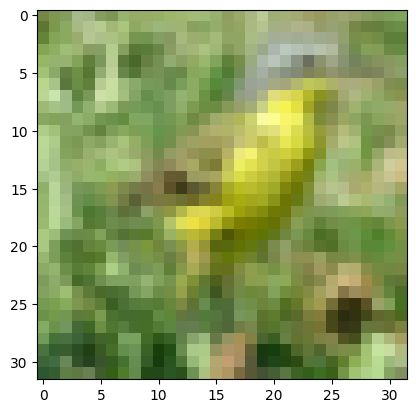

43


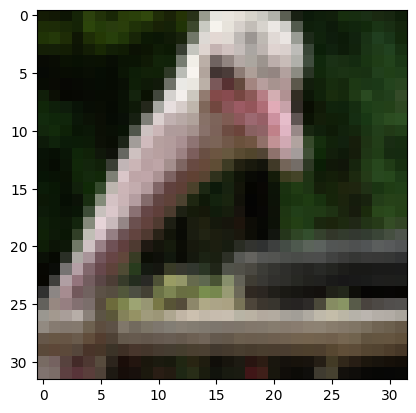

44


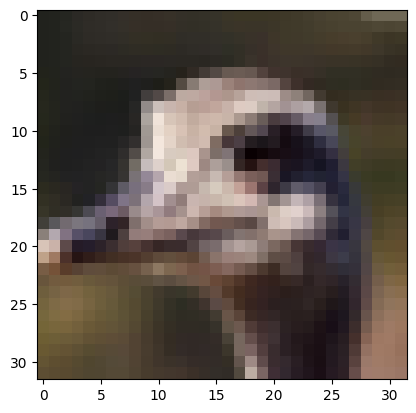

45


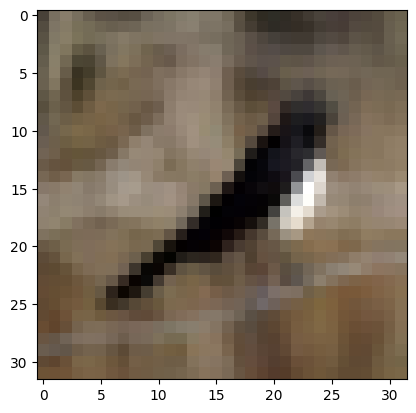

46


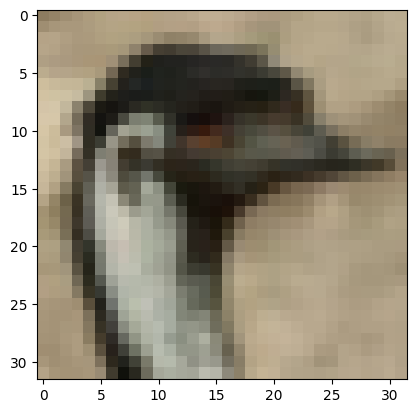

47


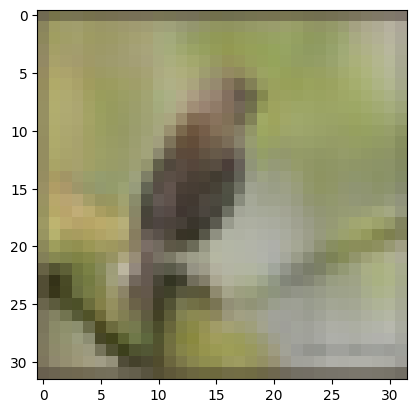

48


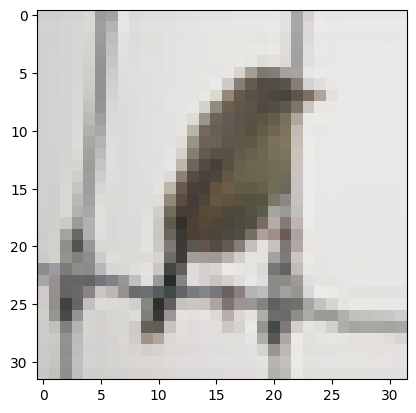

49


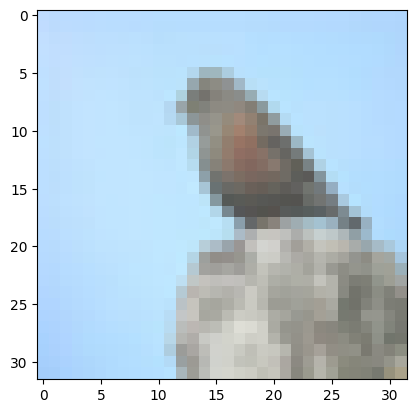

50


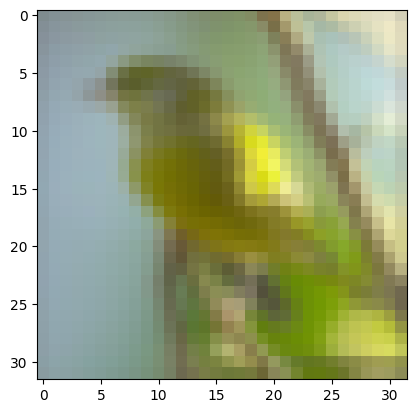

51


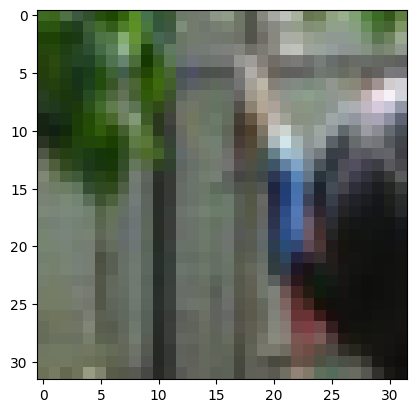

52


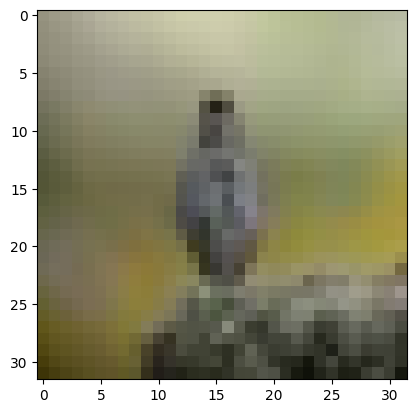

53


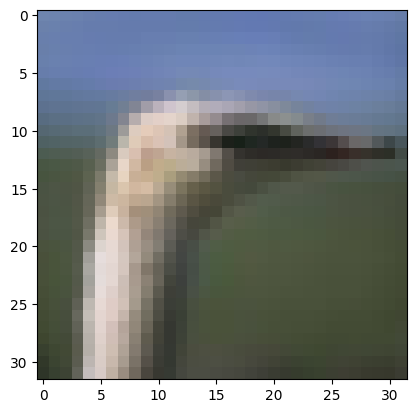

54


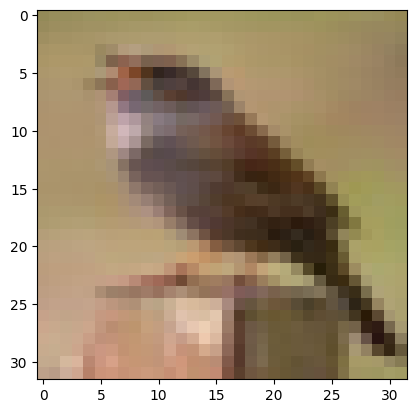

55


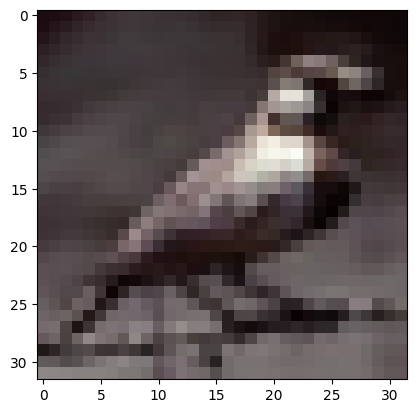

56


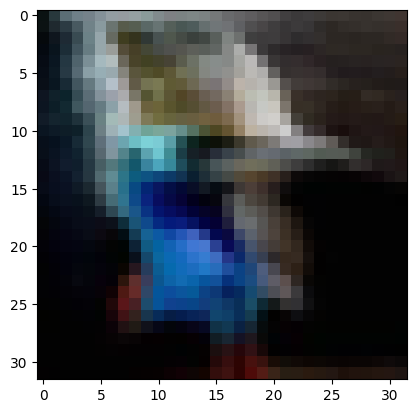

57


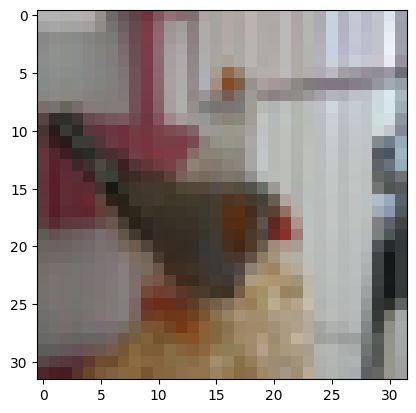

58


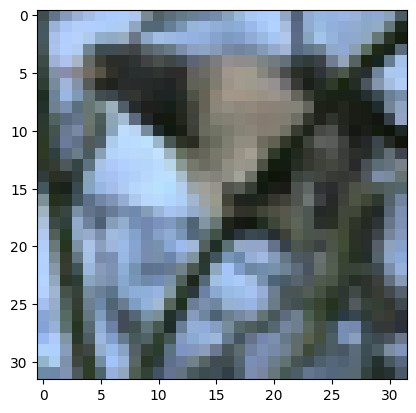

59


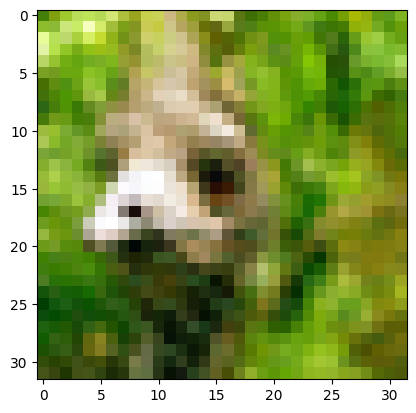

60


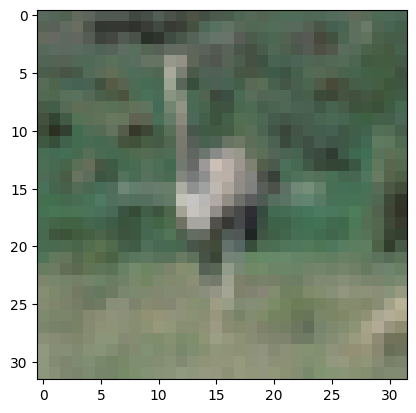

61


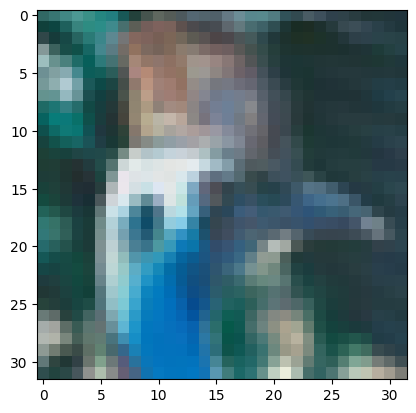

62


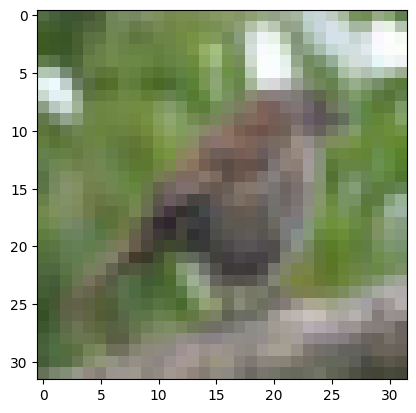

63


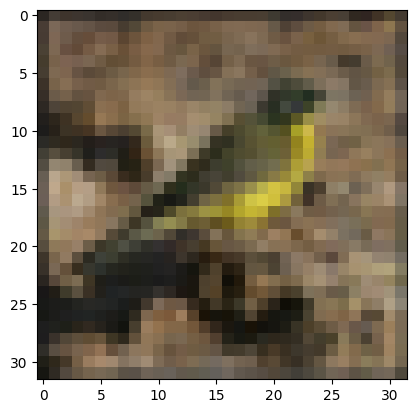

64


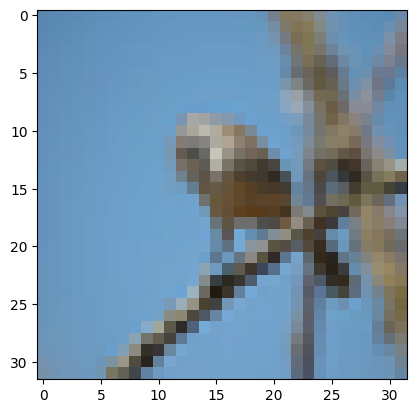

65


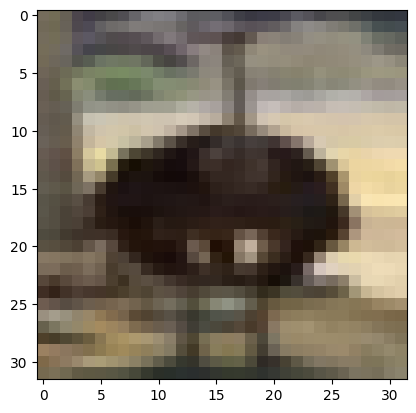

66


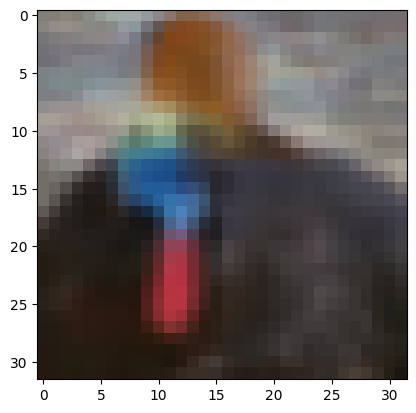

67


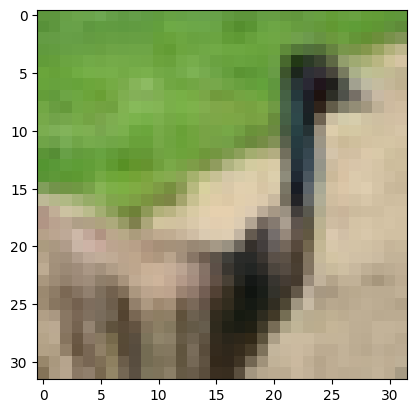

68


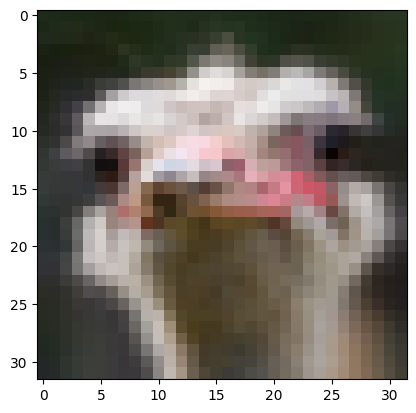

69


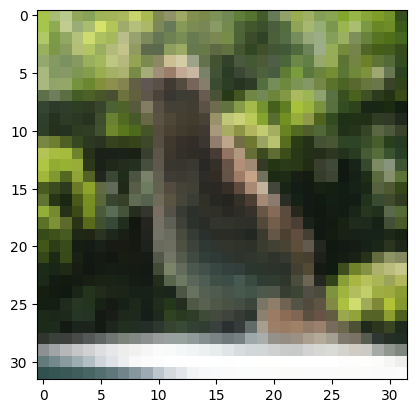

70


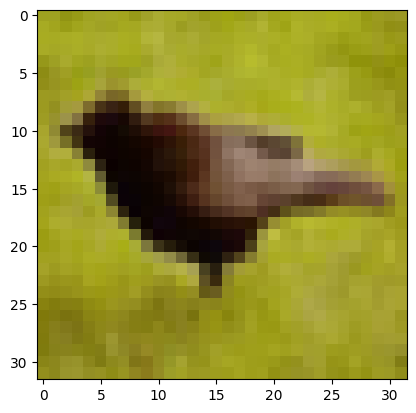

71


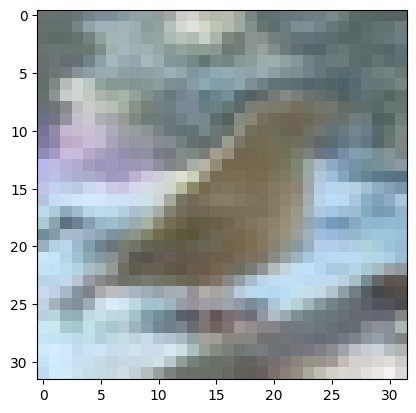

72


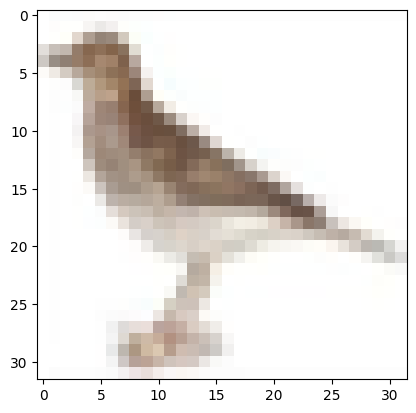

73


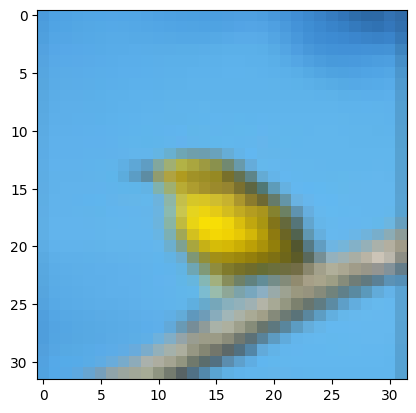

74


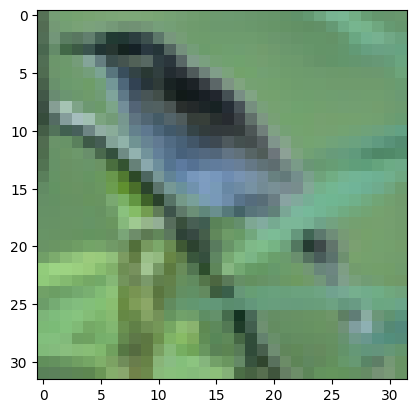

75


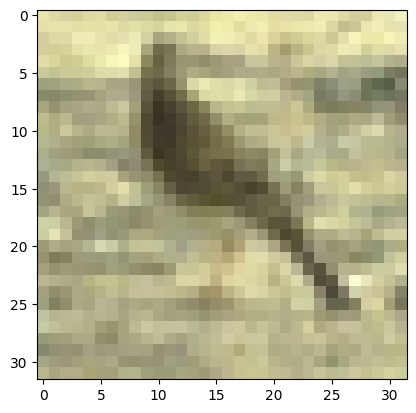

76


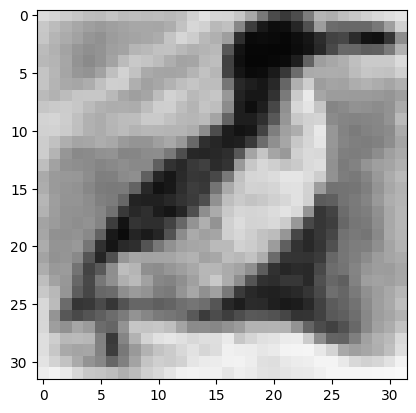

77


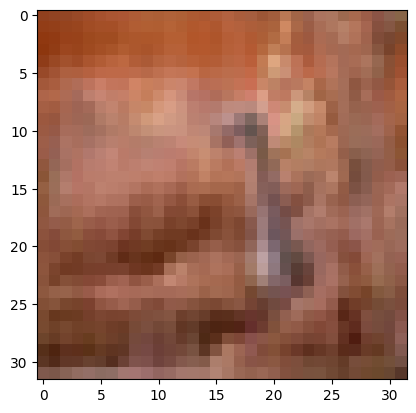

78


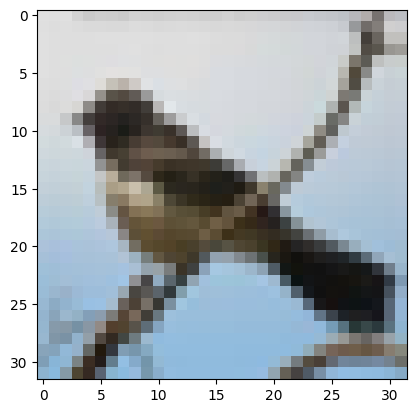

79


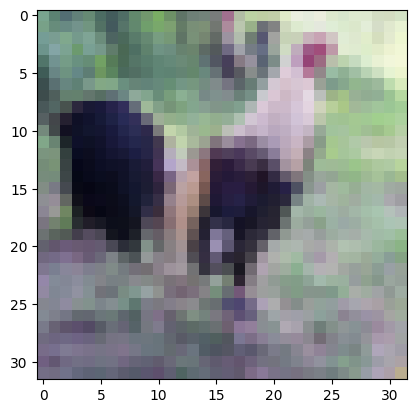

80


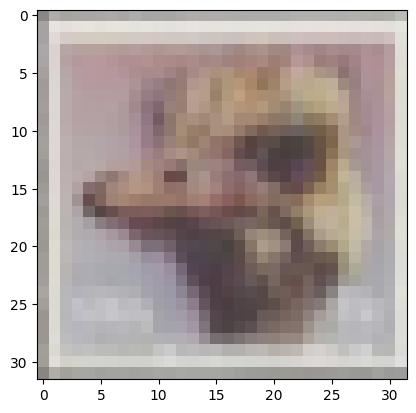

81


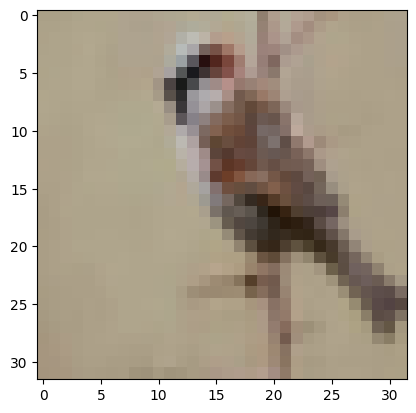

82


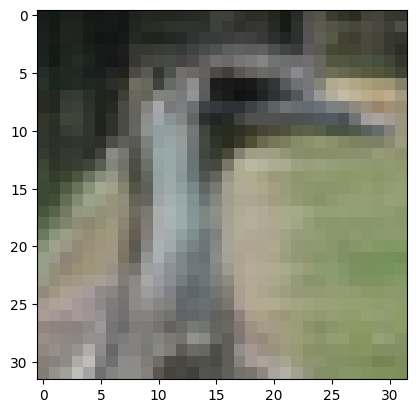

83


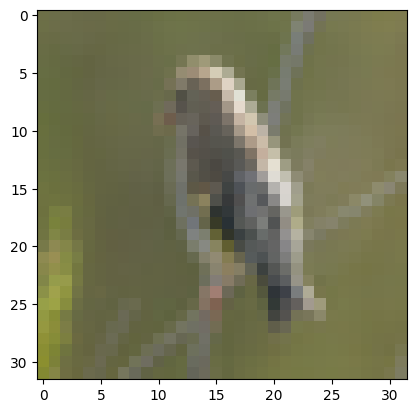

84


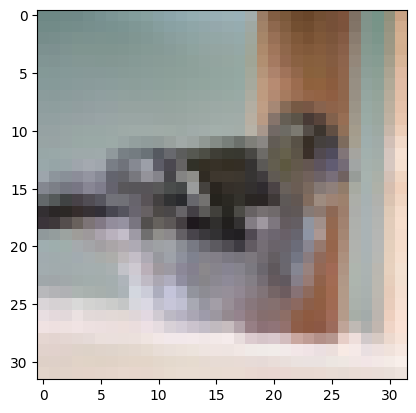

85


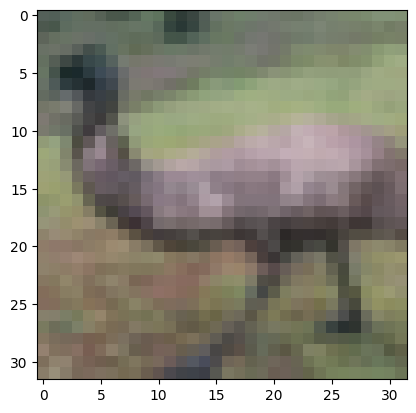

86


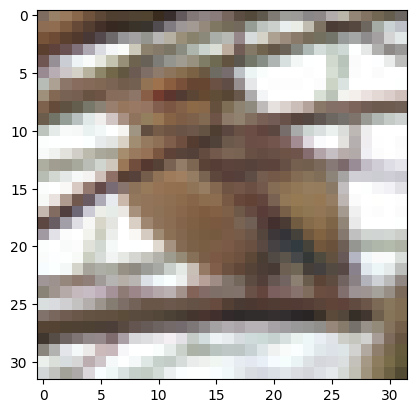

87


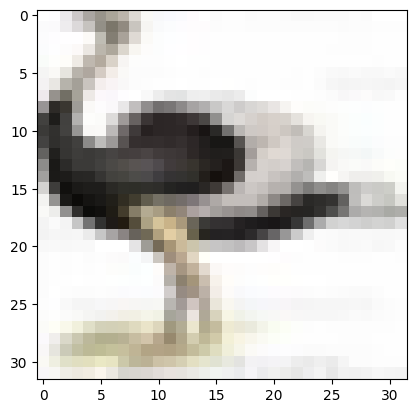

88


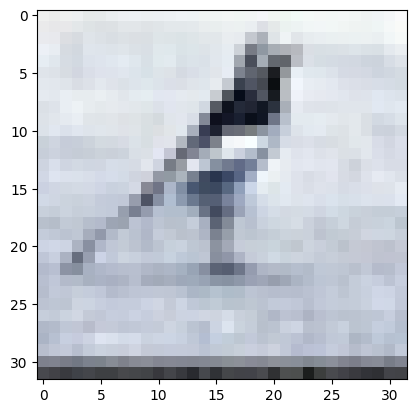

89


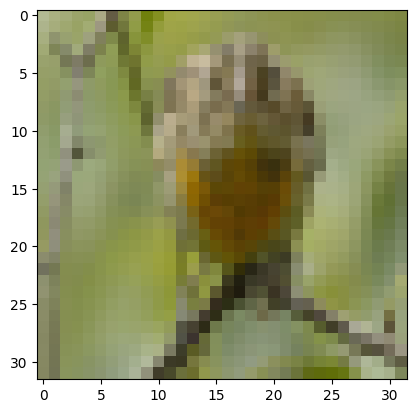

90


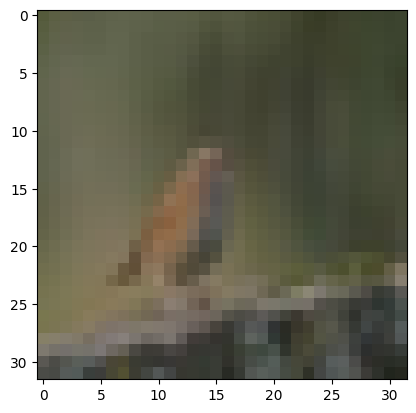

91


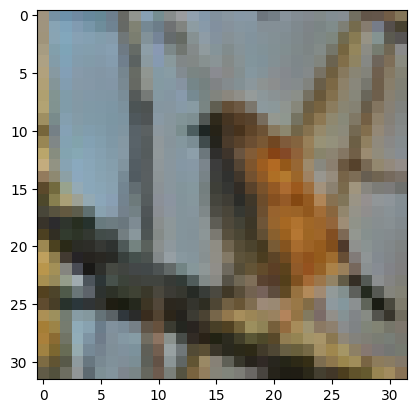

92


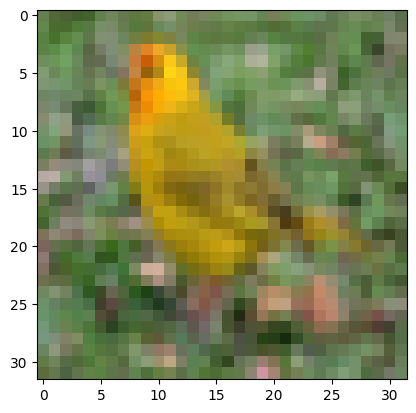

93


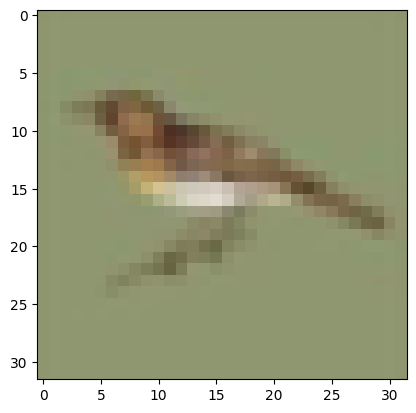

94


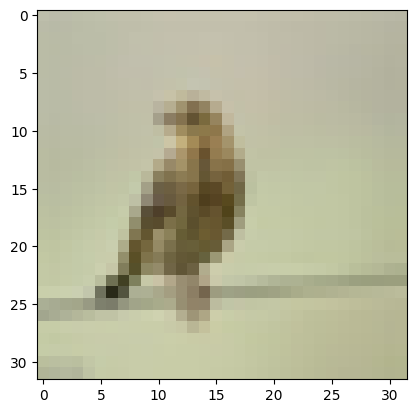

95


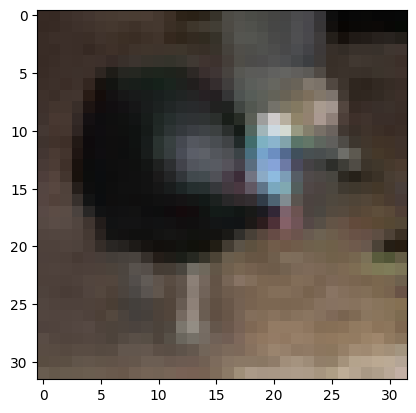

96


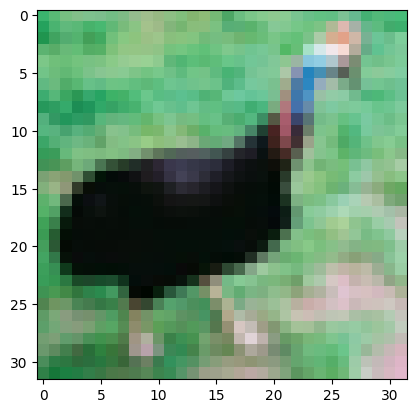

97


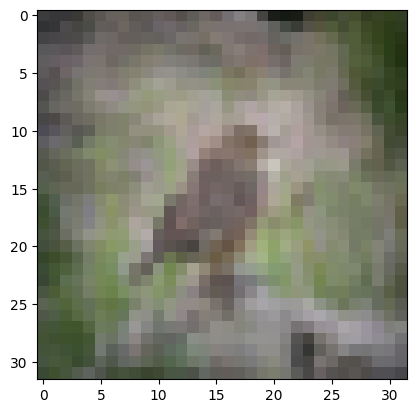

98


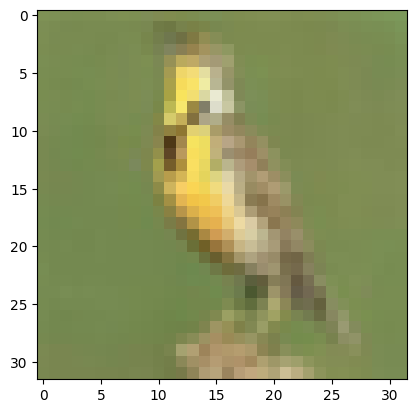

99


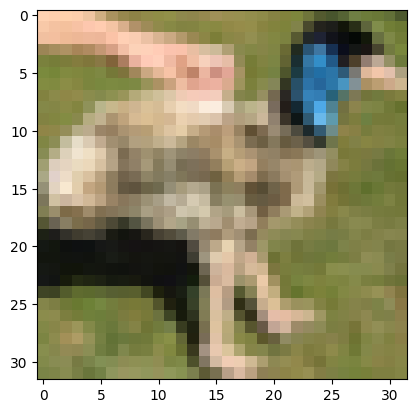

In [ ]:
# Load CIFAR-10
train_data = datasets.CIFAR10(root='./data', train=True, download=True)
clas = 2

# Get all ship images and labels
images2 = [img for img, label in train_data if label == clas]
#print(f"Number of 1 images: {len(ship_images)}")  # Output: 5000 (train)

for i in range(100):
  print(i)
  plt.imshow(images2[i])
  plt.show()

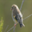

In [ ]:
images2[83]

### 3

0


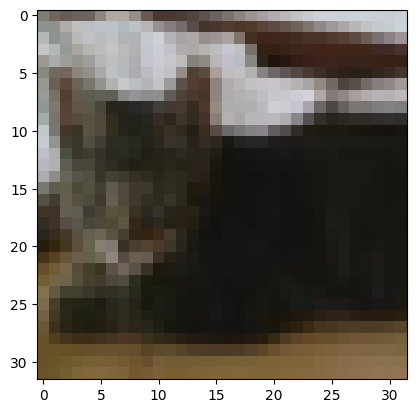

1


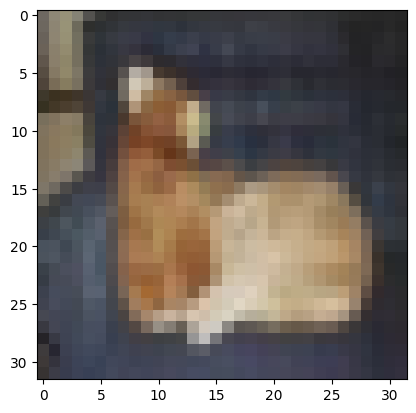

2


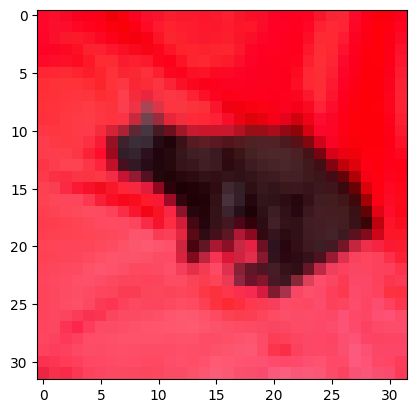

3


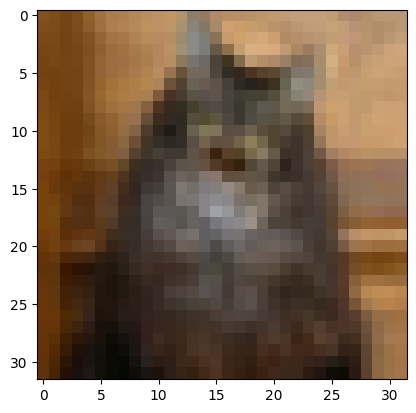

4


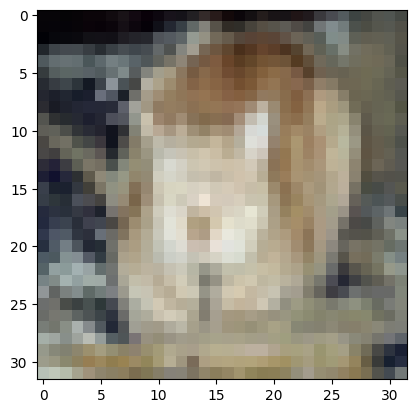

5


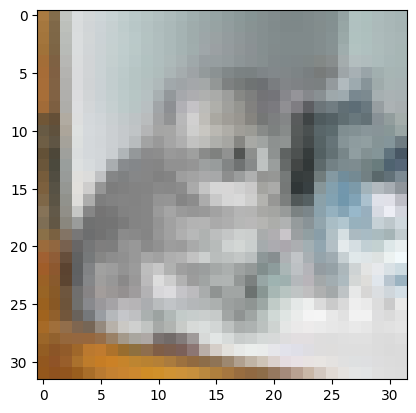

6


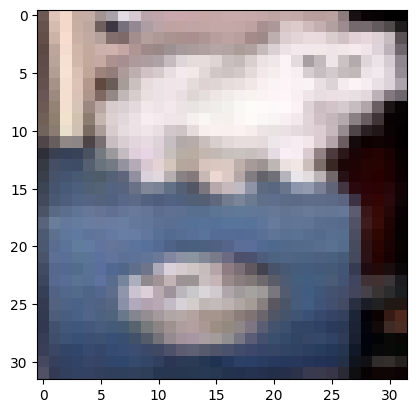

7


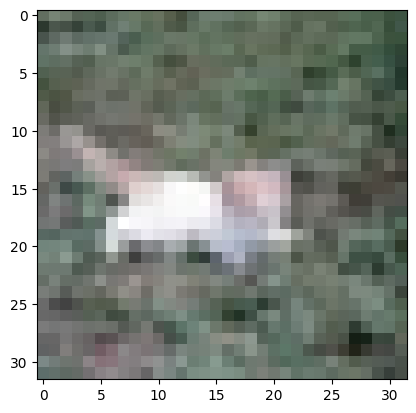

8


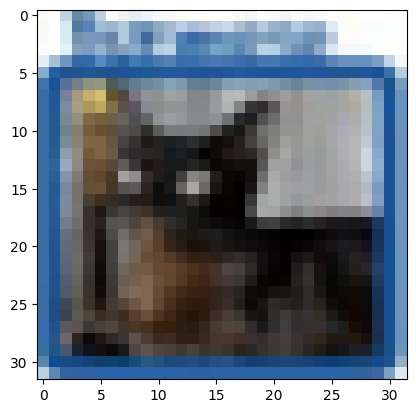

9


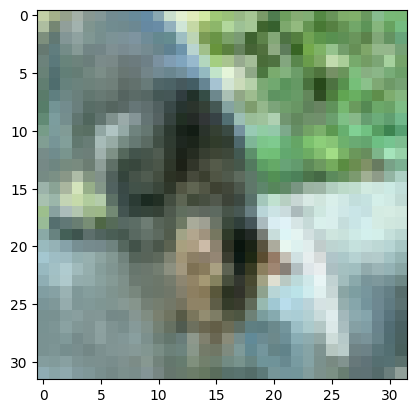

10


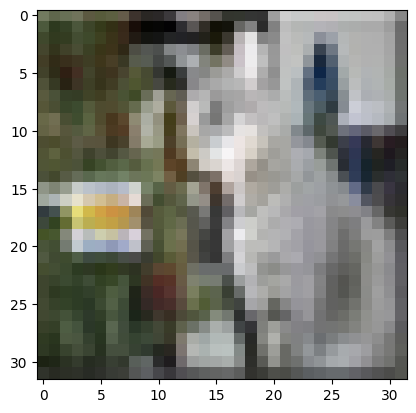

11


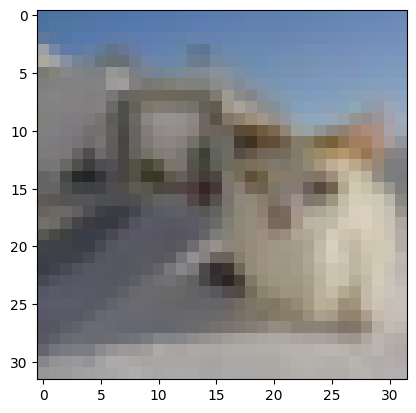

12


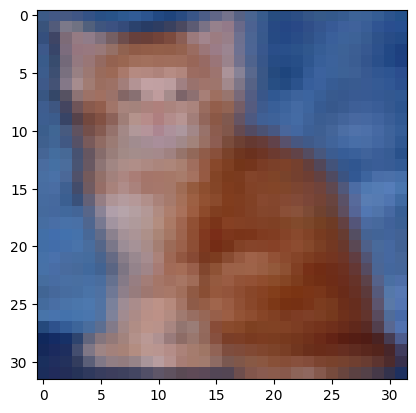

13


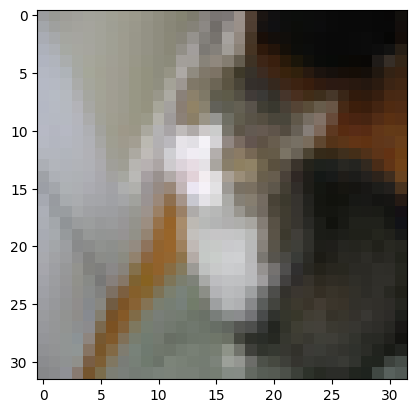

14


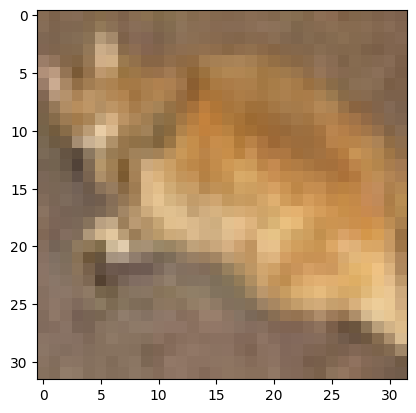

15


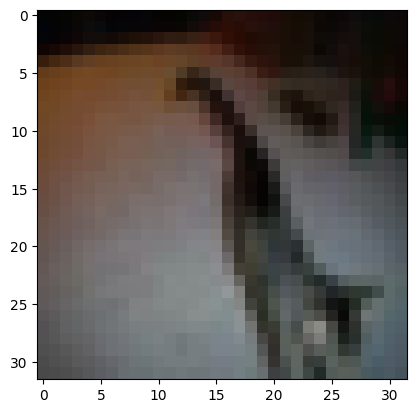

16


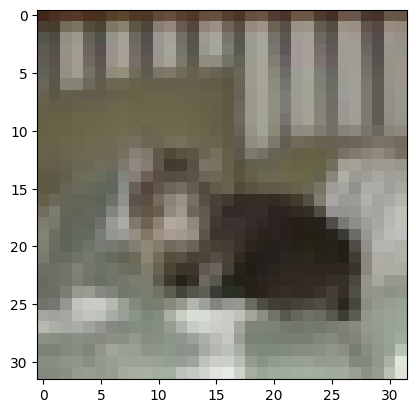

17


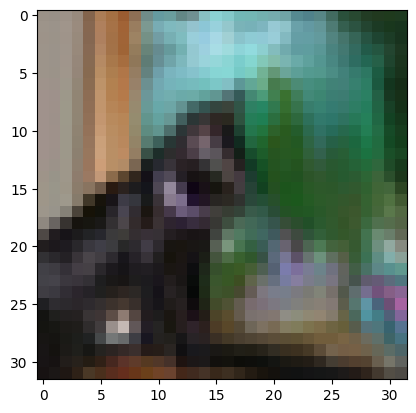

18


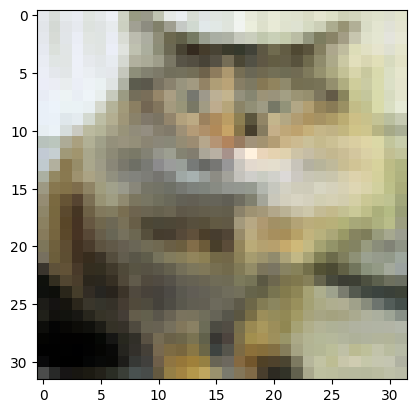

19


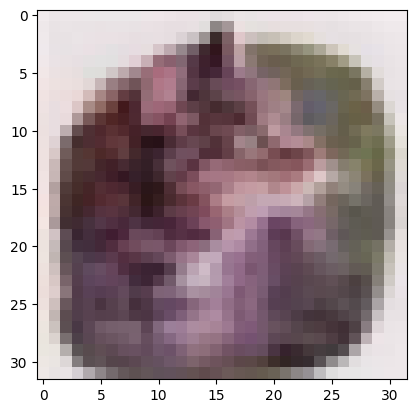

20


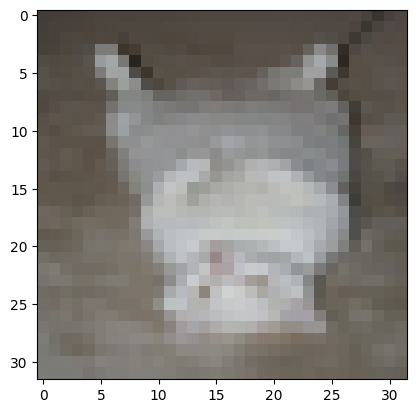

21


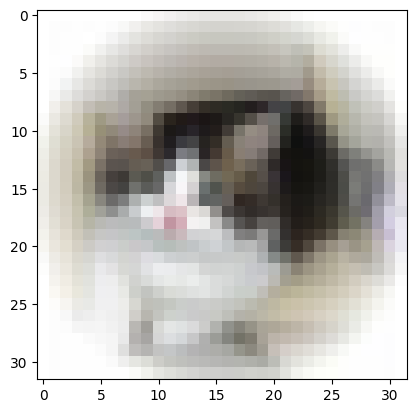

22


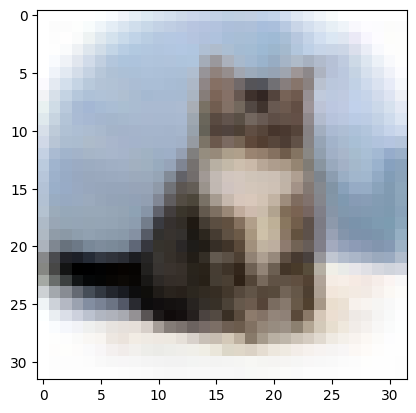

23


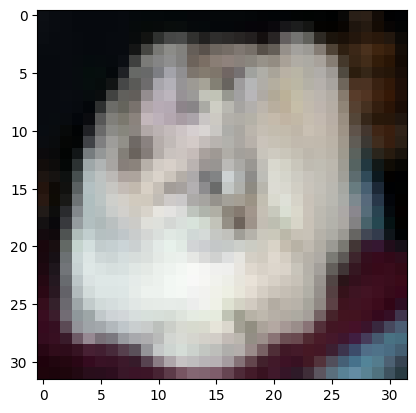

24


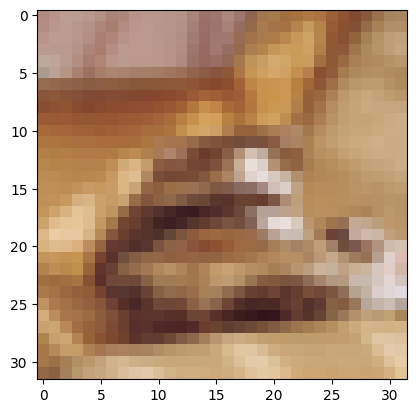

25


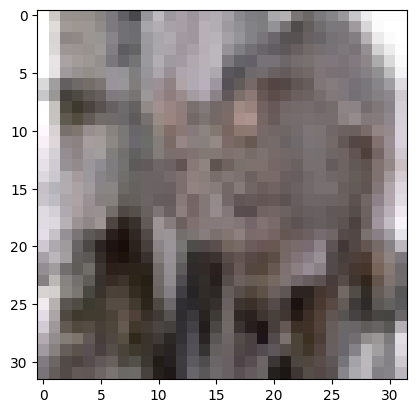

26


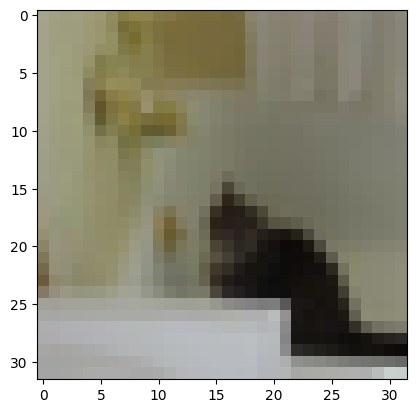

27


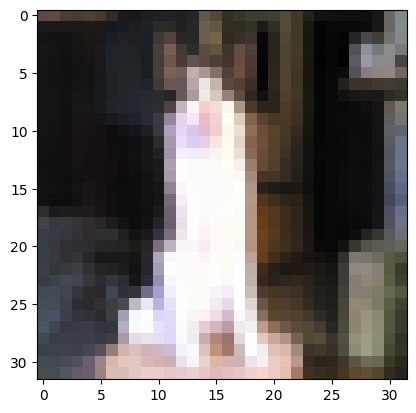

28


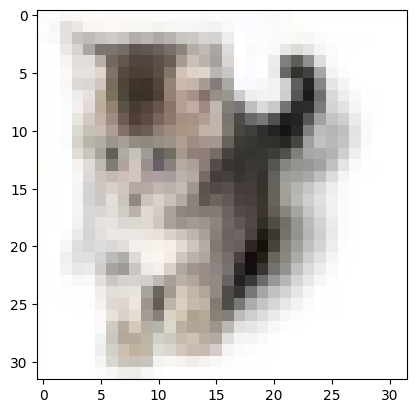

29


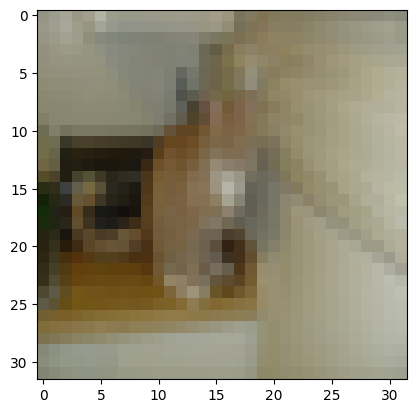

30


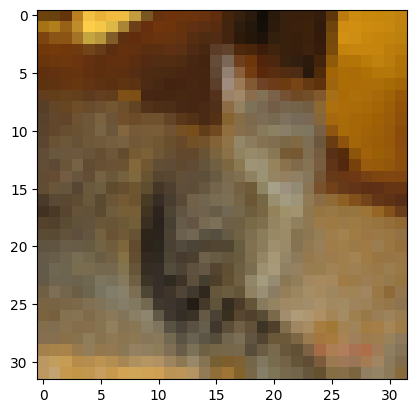

31


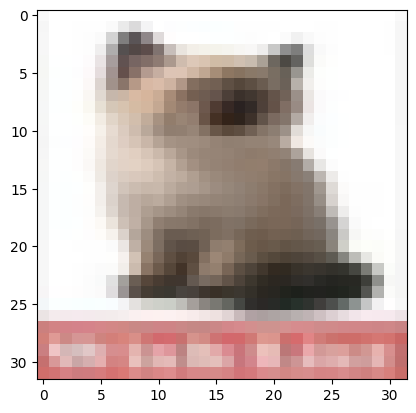

32


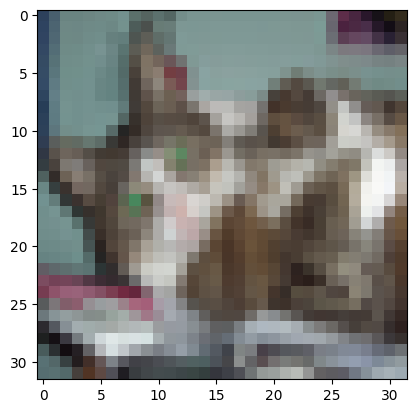

33


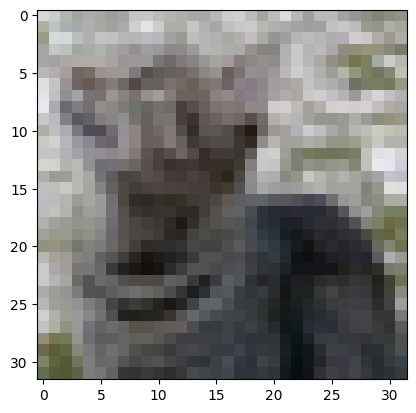

34


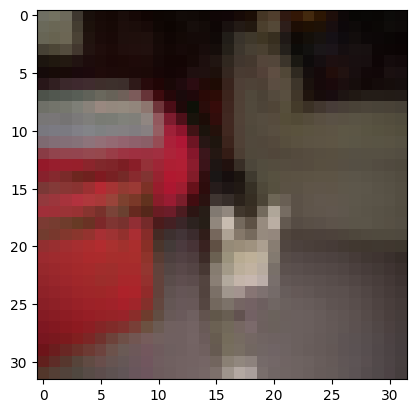

35


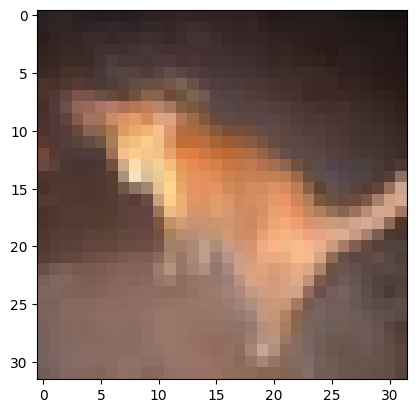

36


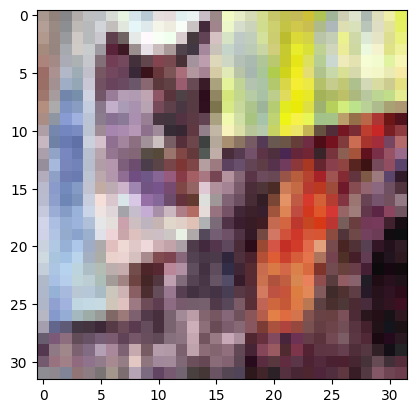

37


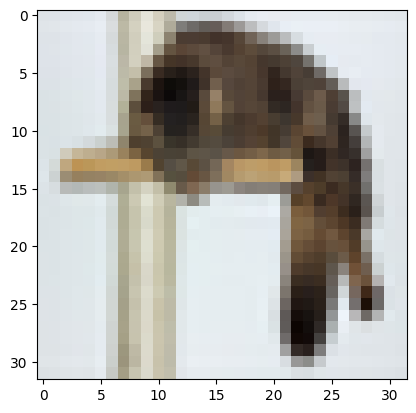

38


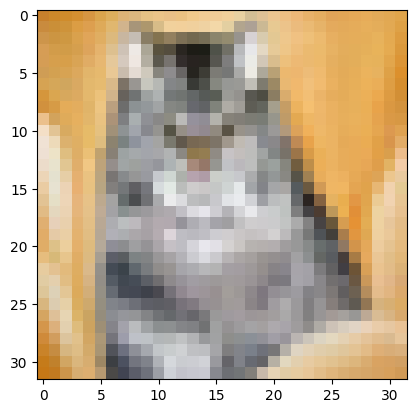

39


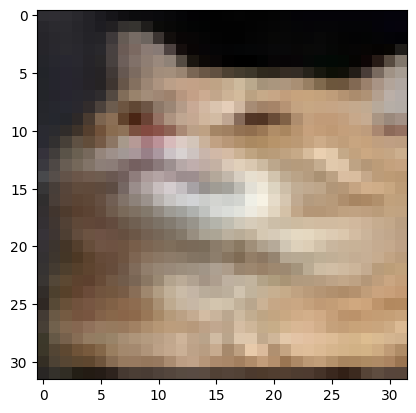

40


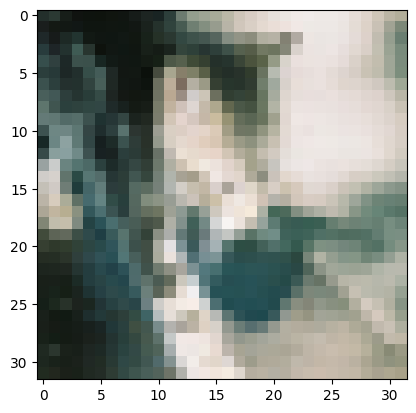

41


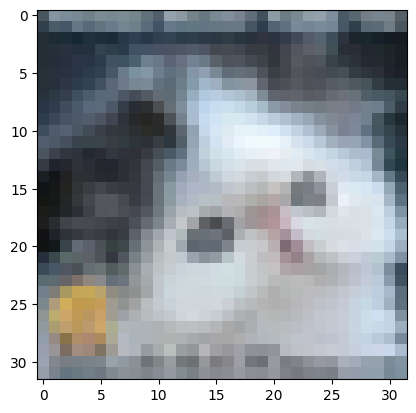

42


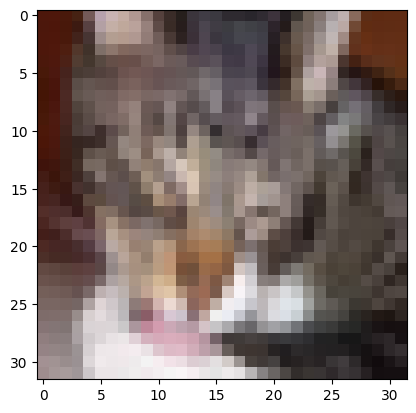

43


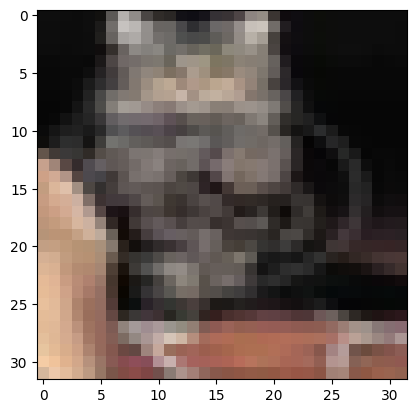

44


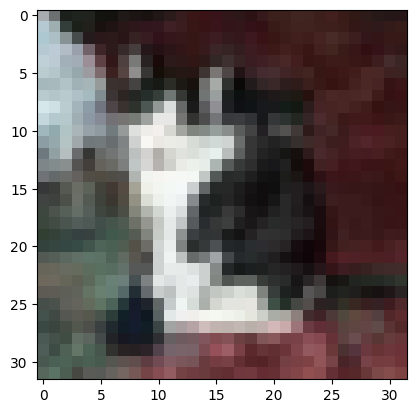

45


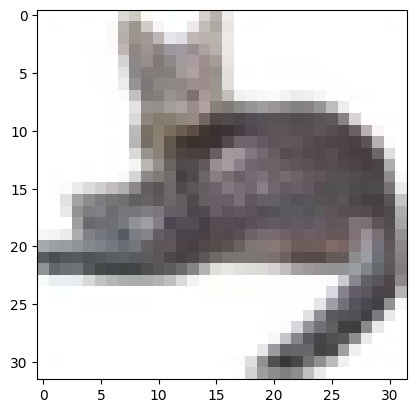

46


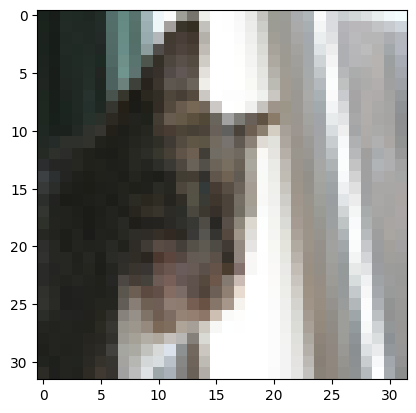

47


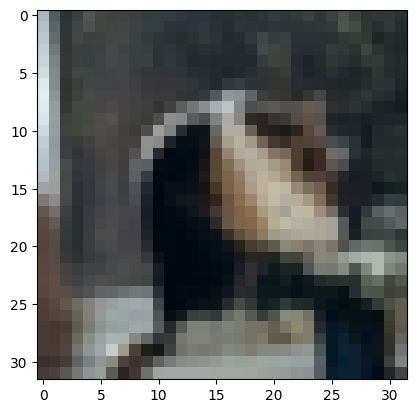

48


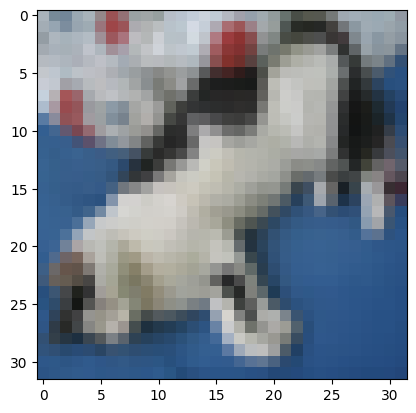

49


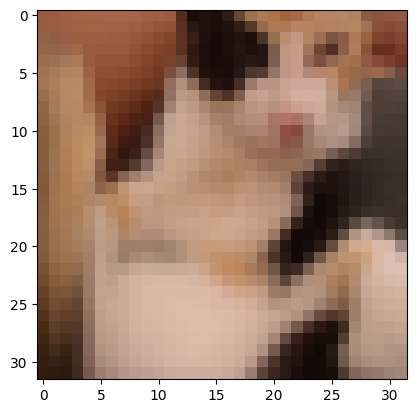

50


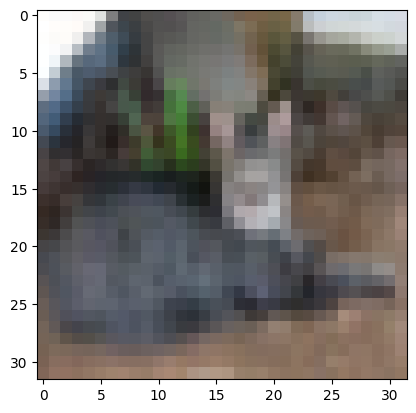

51


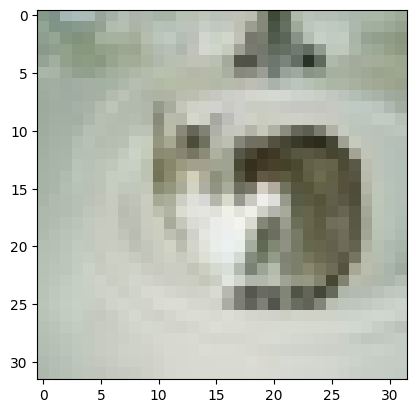

52


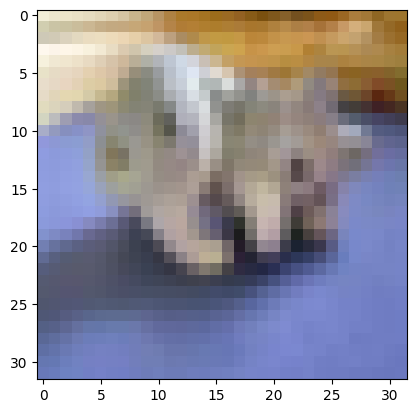

53


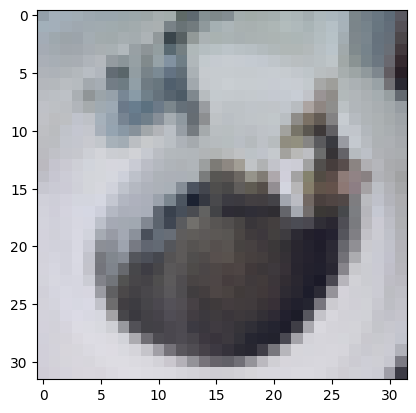

54


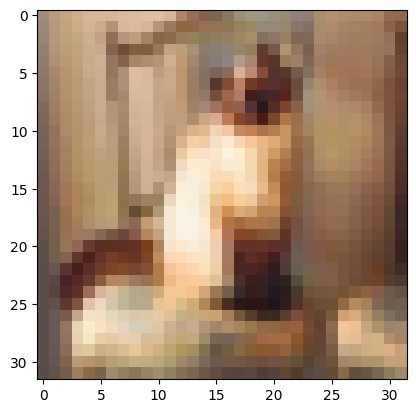

55


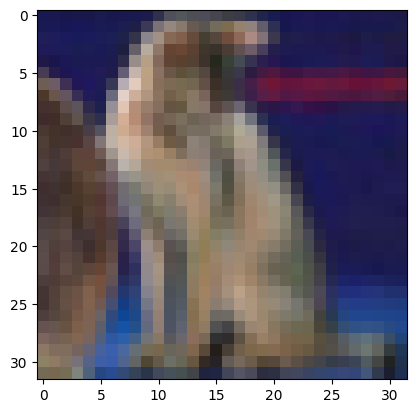

56


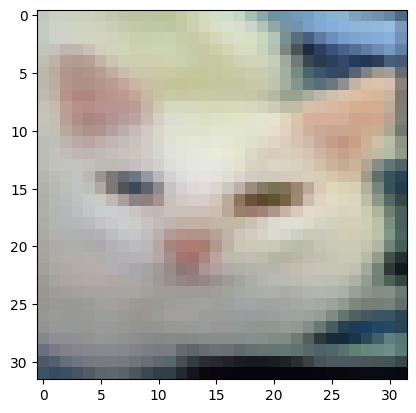

57


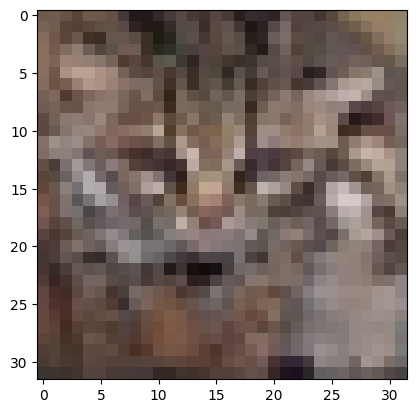

58


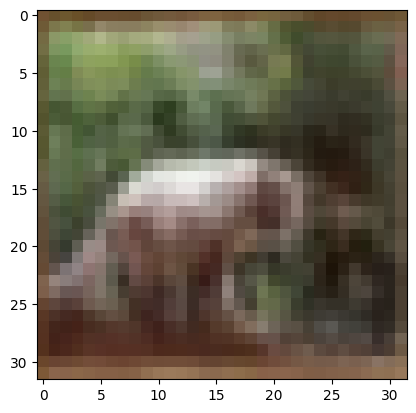

59


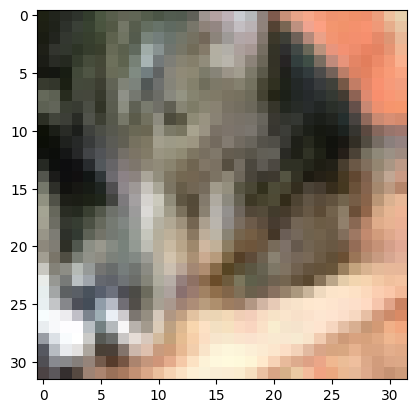

60


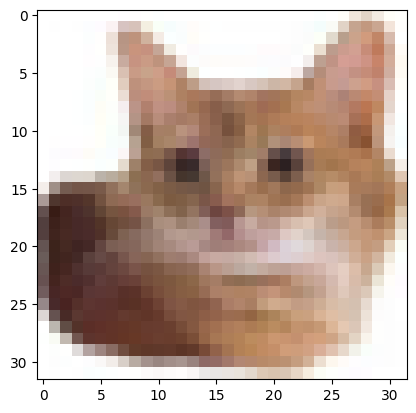

61


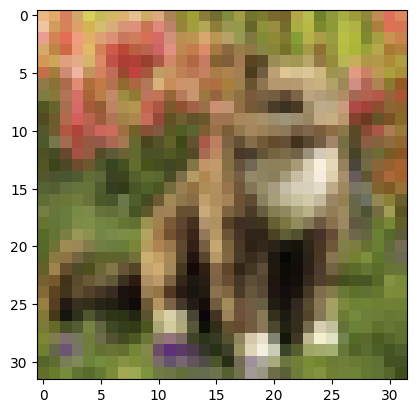

62


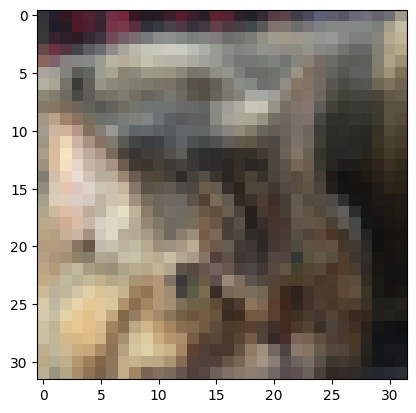

63


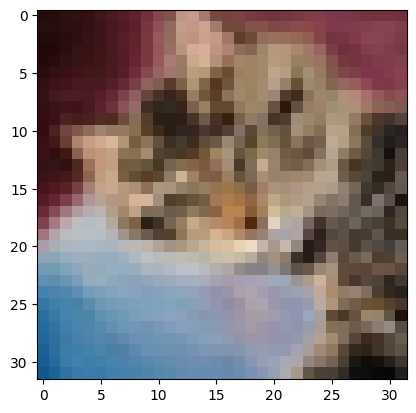

64


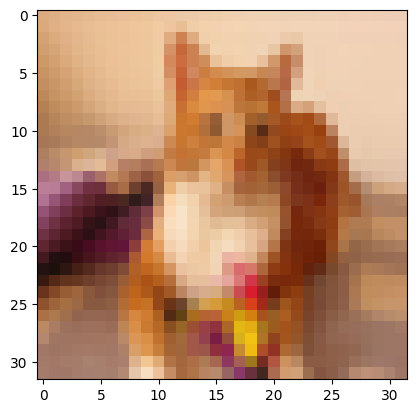

65


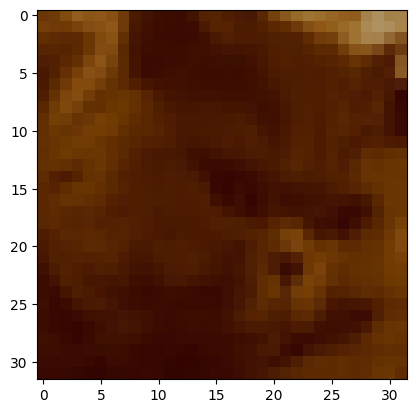

66


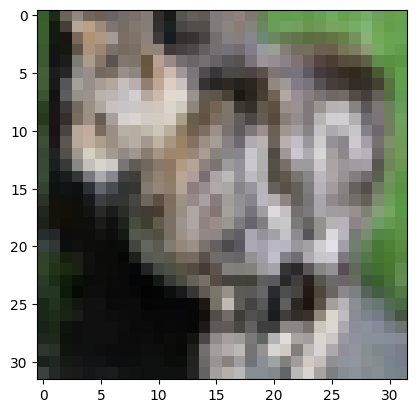

67


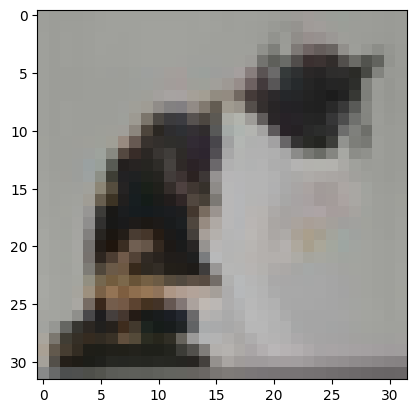

68


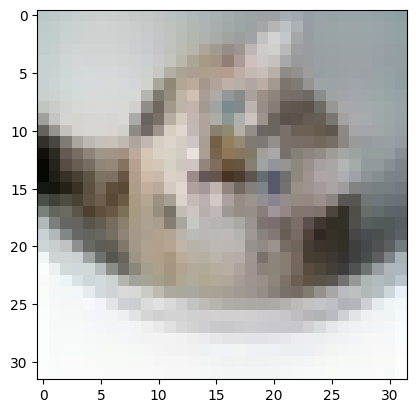

69


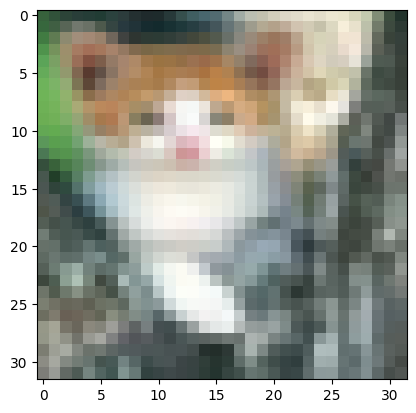

70


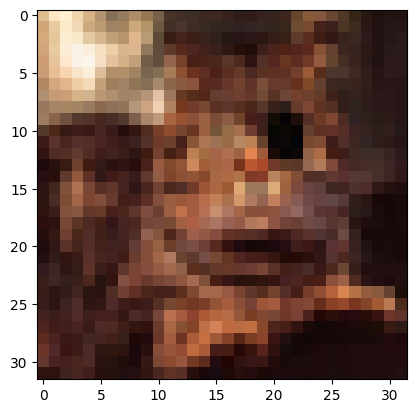

71


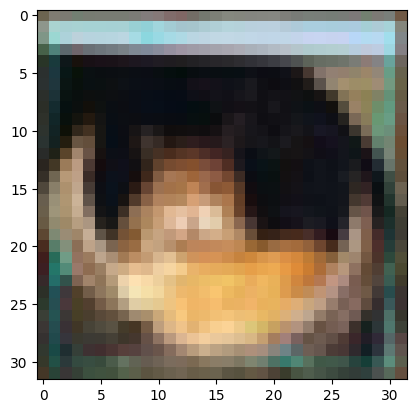

72


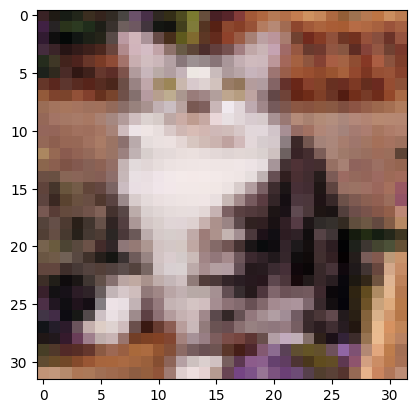

73


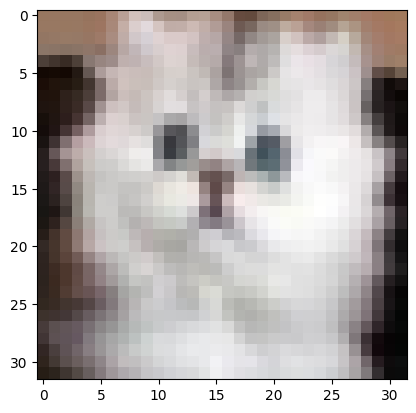

74


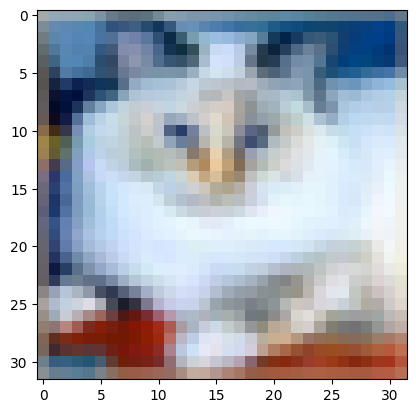

75


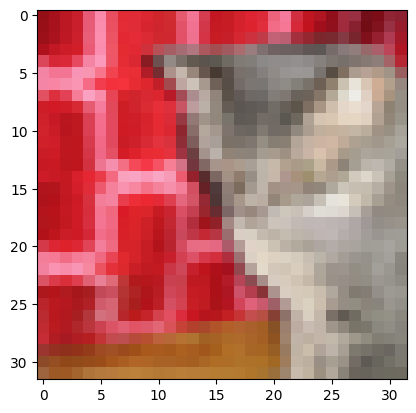

76


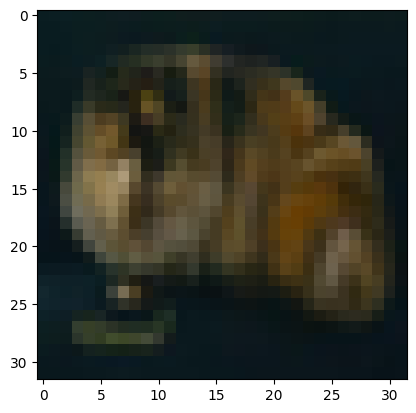

77


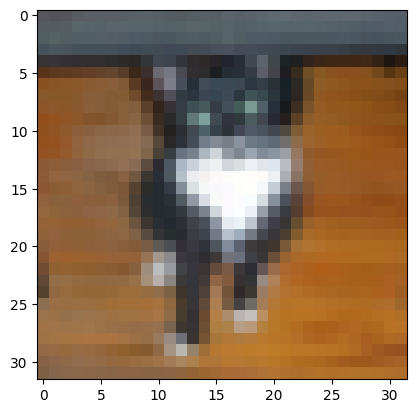

78


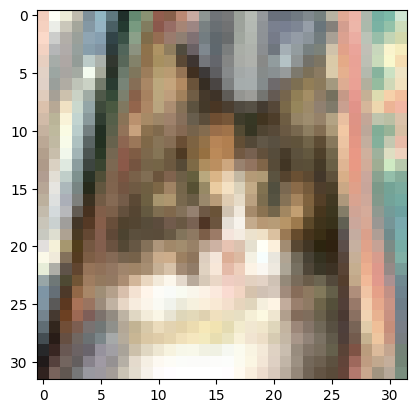

79


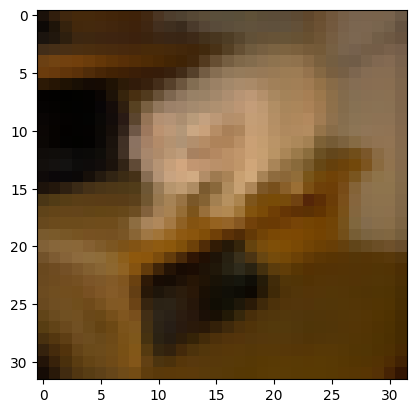

80


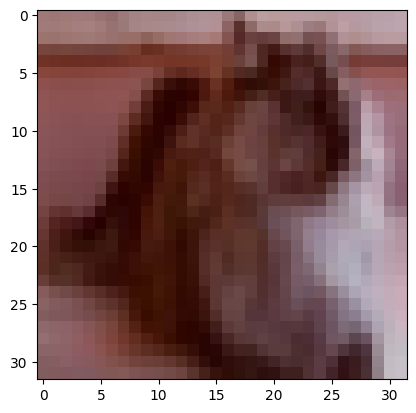

81


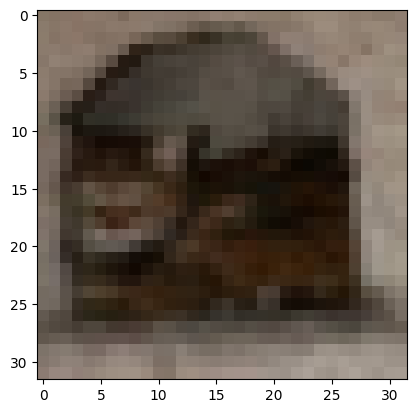

82


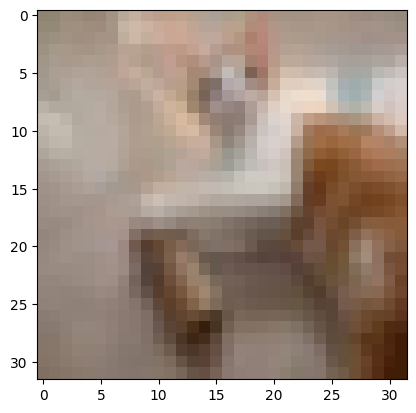

83


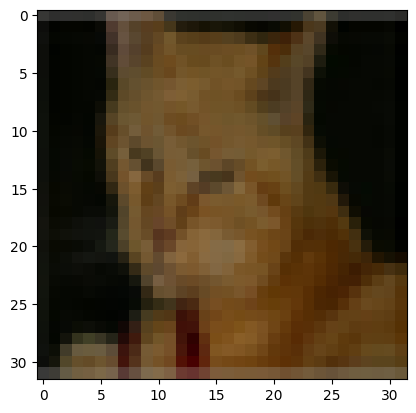

84


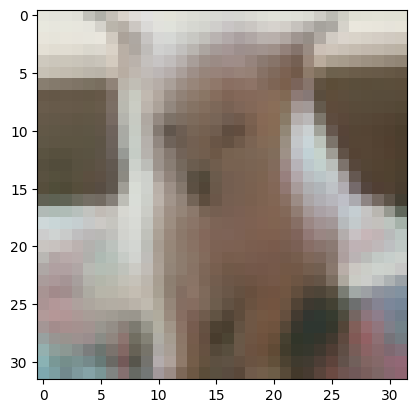

85


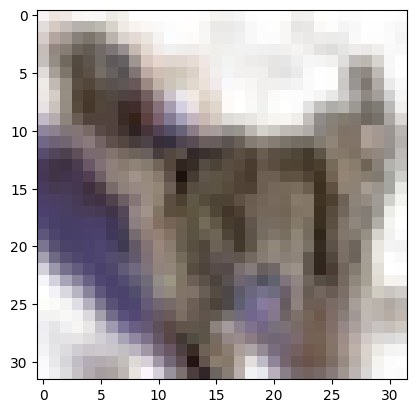

86


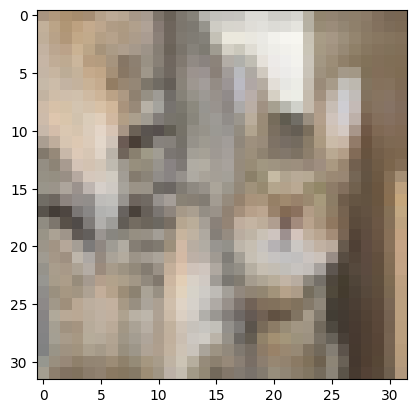

87


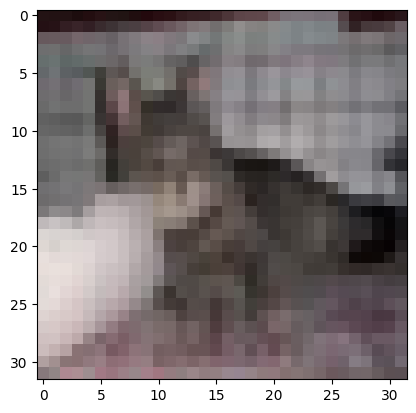

88


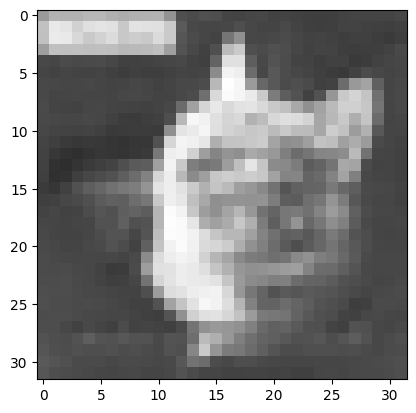

89


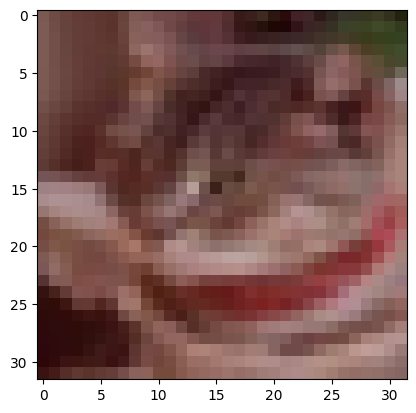

90


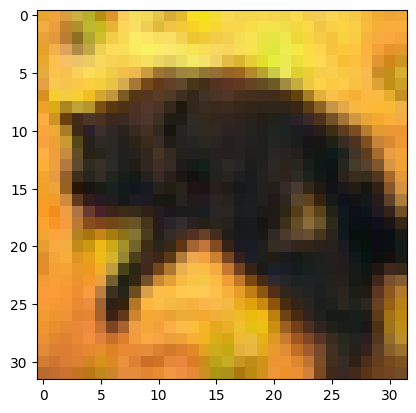

91


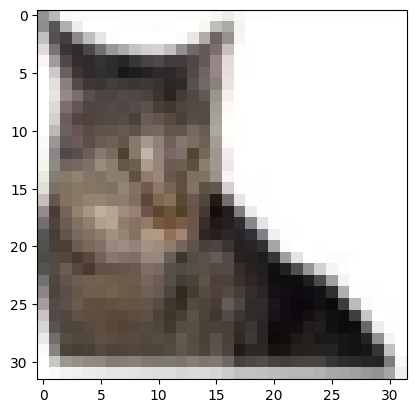

92


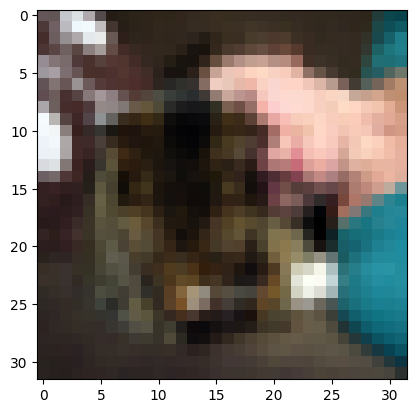

93


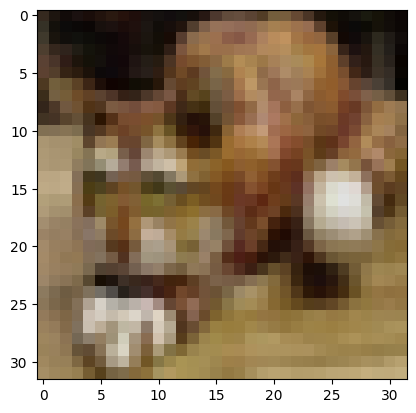

94


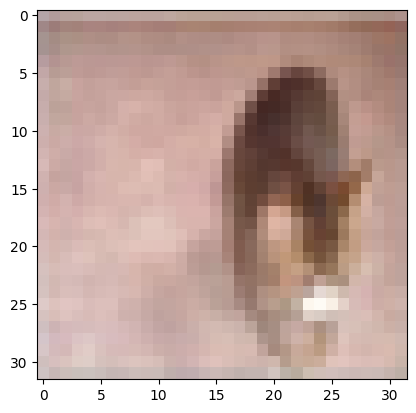

95


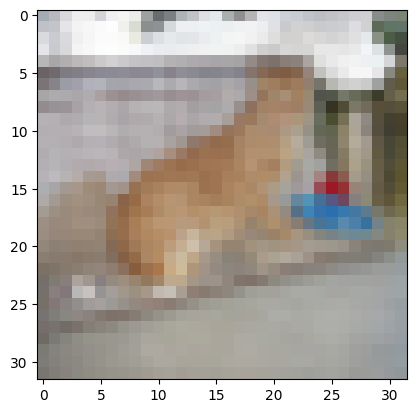

96


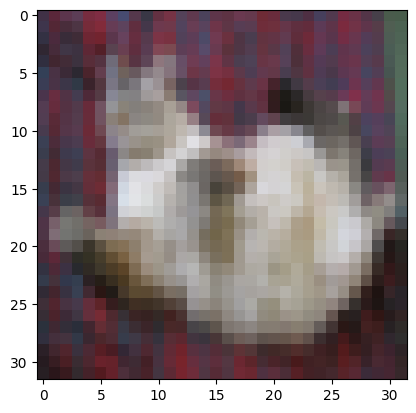

97


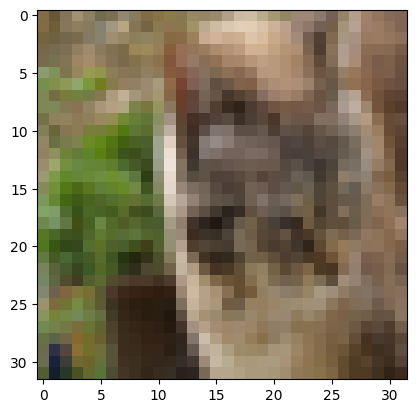

98


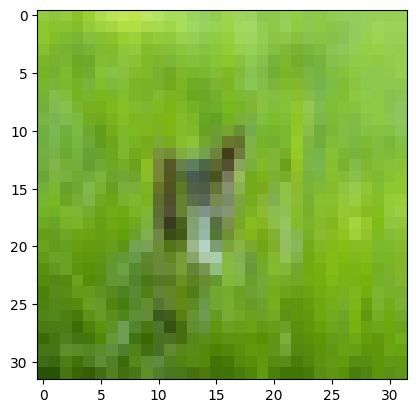

99


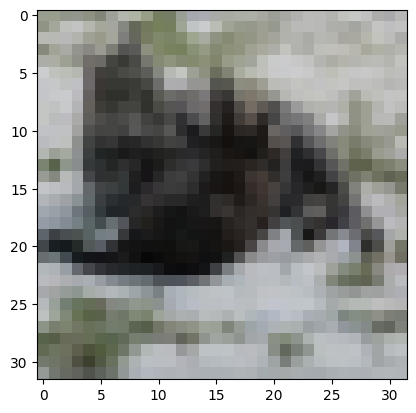

In [ ]:
# Load CIFAR-10
train_data = datasets.CIFAR10(root='./data', train=True, download=True)
clas = 3

# Get all ship images and labels
images3 = [img for img, label in train_data if label == clas]
#print(f"Number of 1 images: {len(ship_images)}")  # Output: 5000 (train)

for i in range(100):
  print(i)
  plt.imshow(images3[i])
  plt.show()

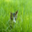

In [ ]:
images3[98]

### 4

0


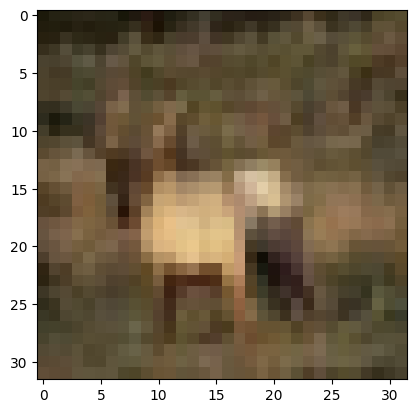

1


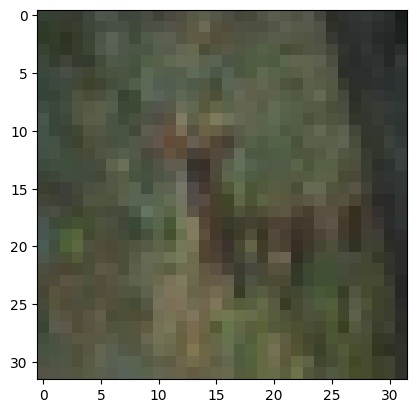

2


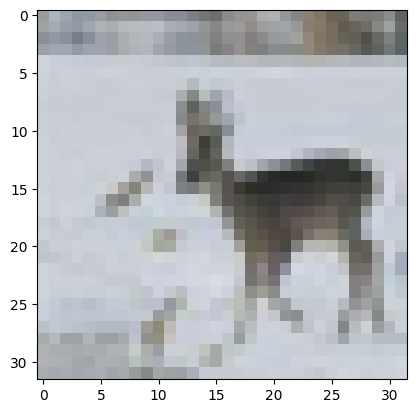

3


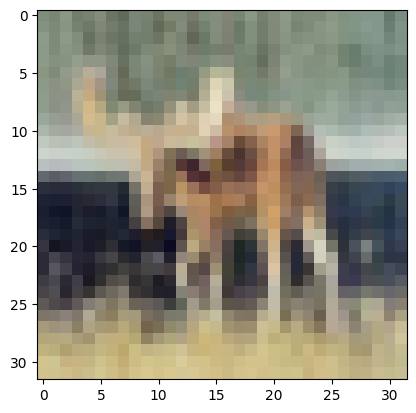

4


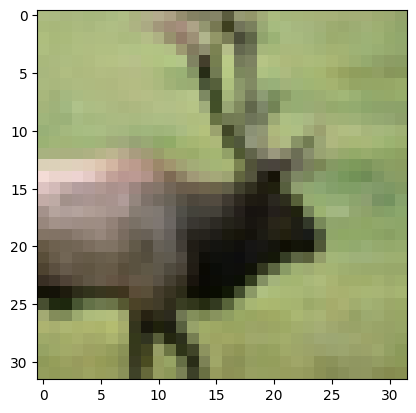

5


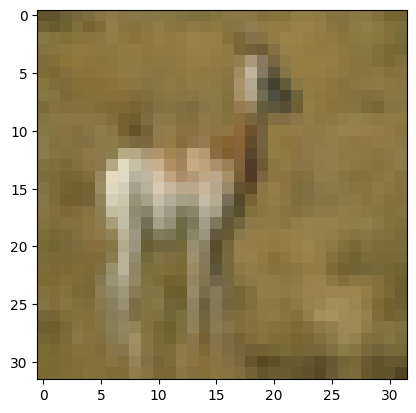

6


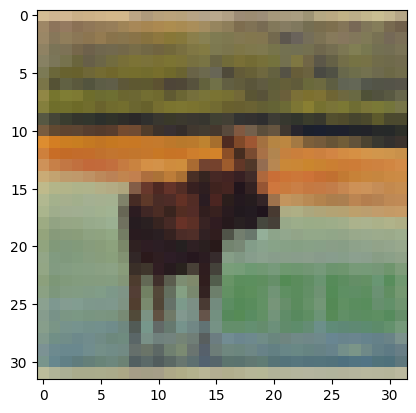

7


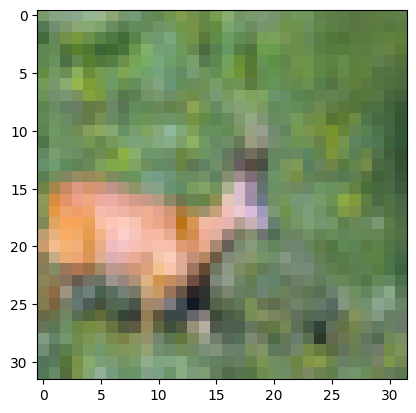

8


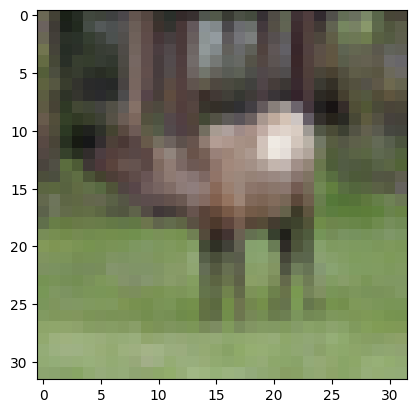

9


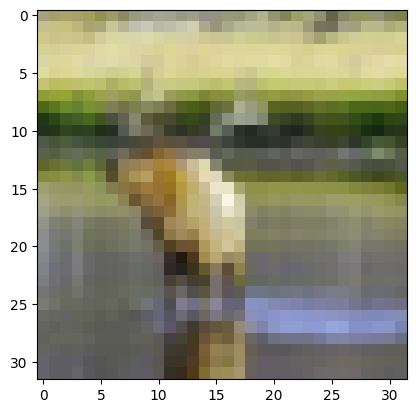

10


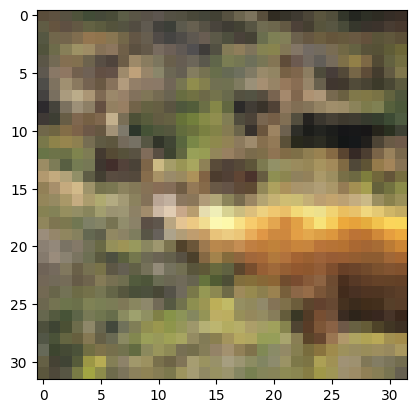

11


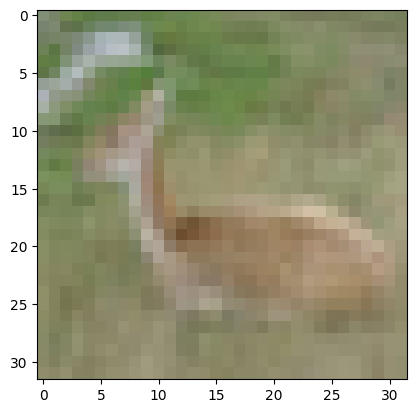

12


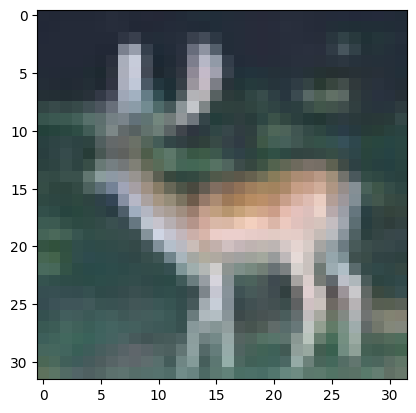

13


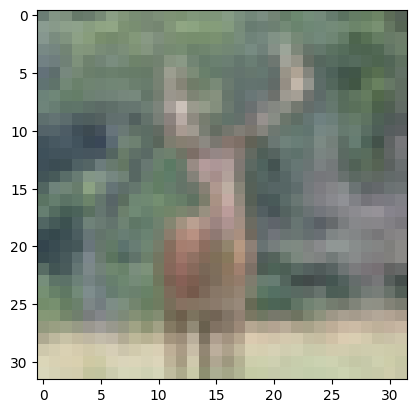

14


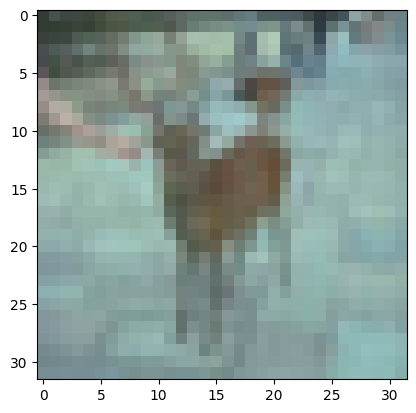

15


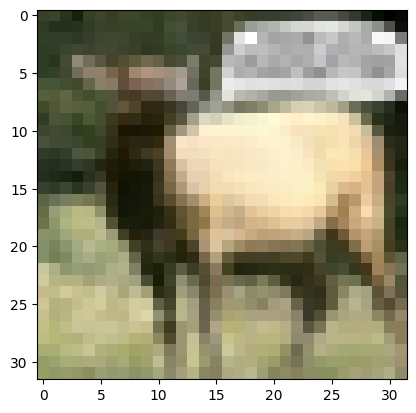

16


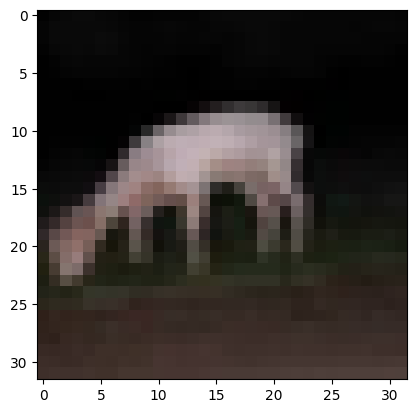

17


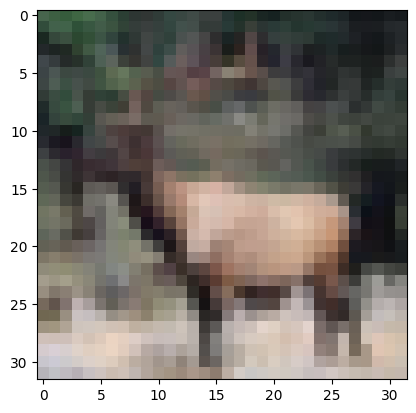

18


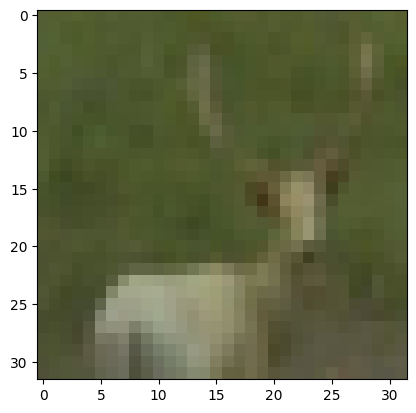

19


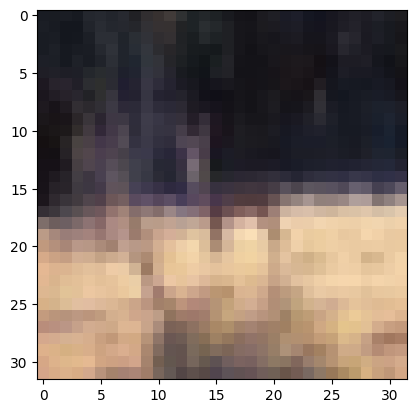

20


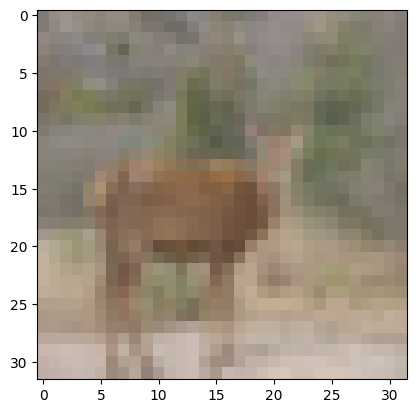

21


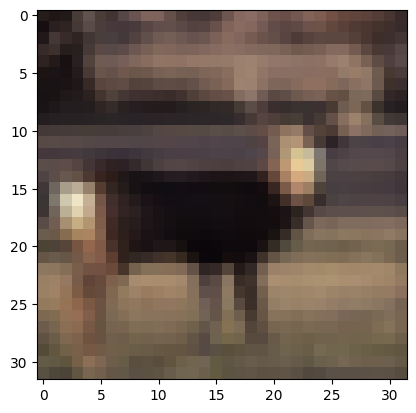

22


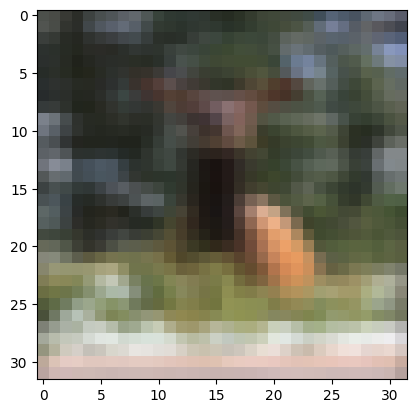

23


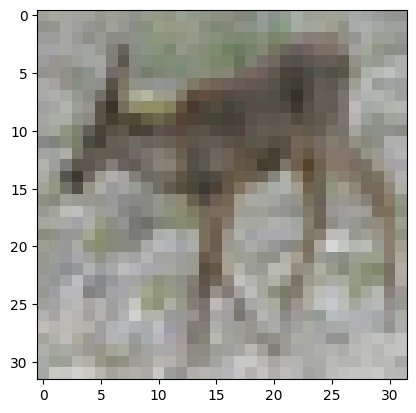

24


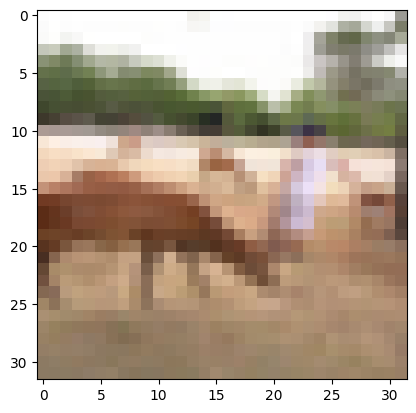

25


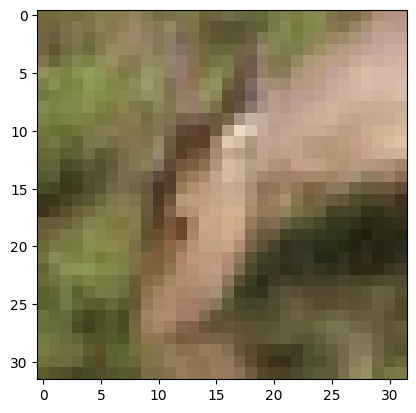

26


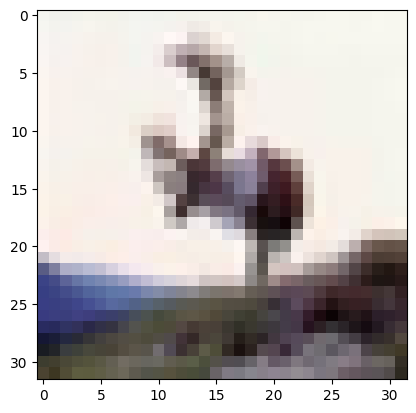

27


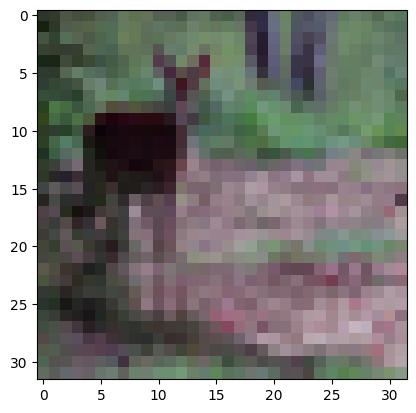

28


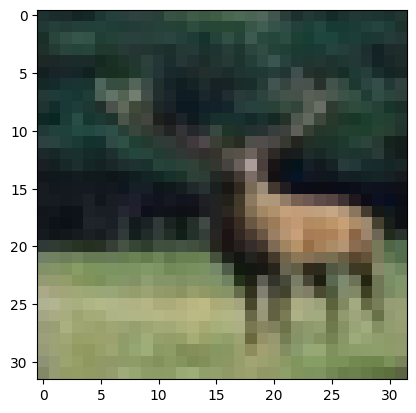

29


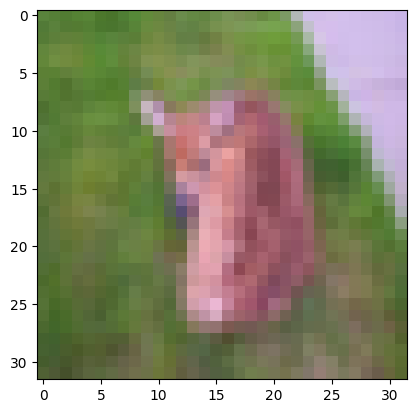

30


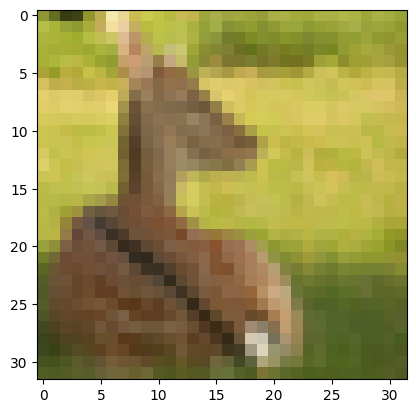

31


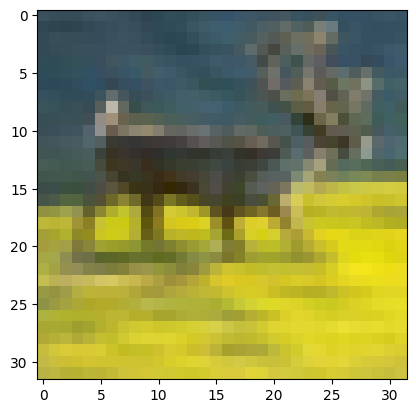

32


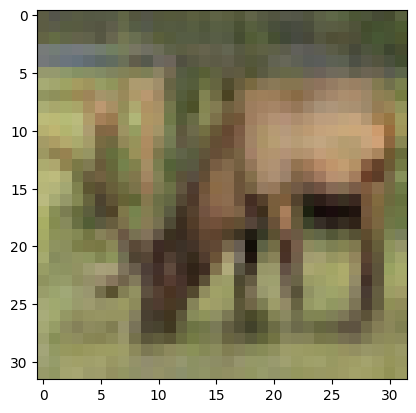

33


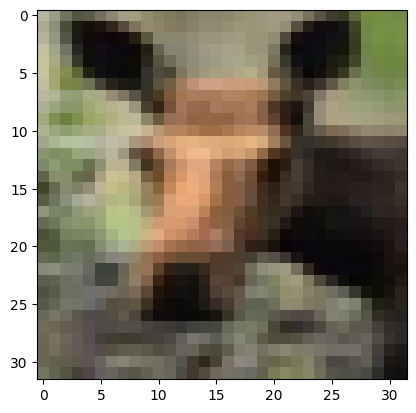

34


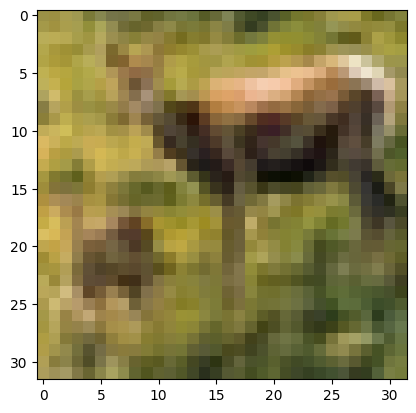

35


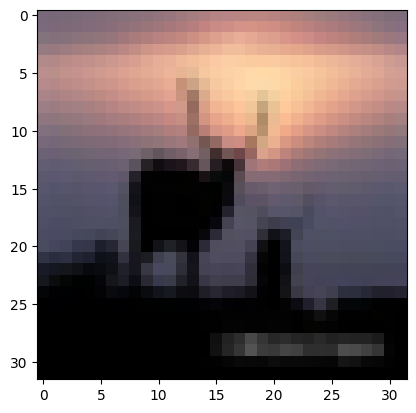

36


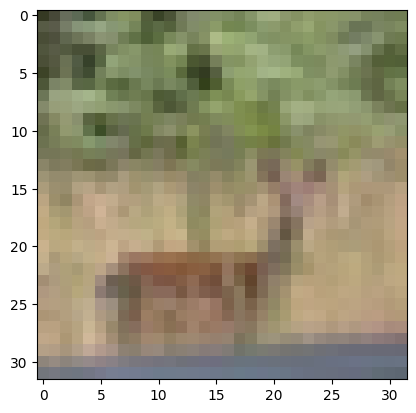

37


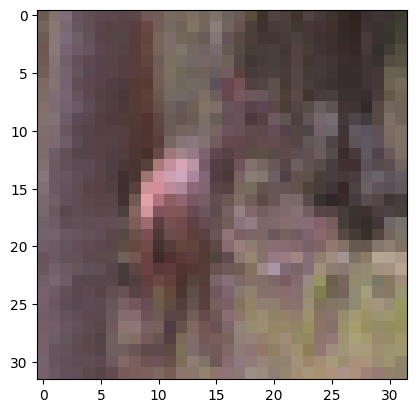

38


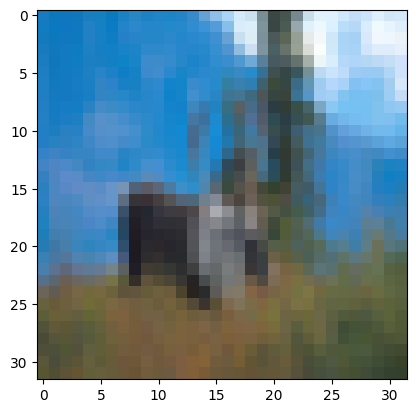

39


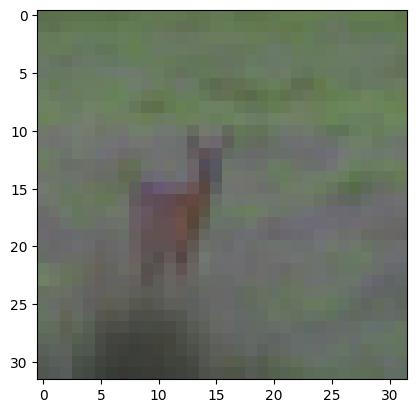

40


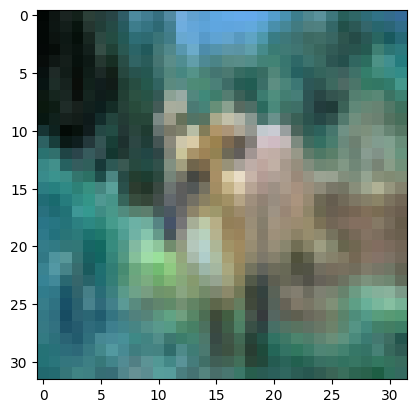

41


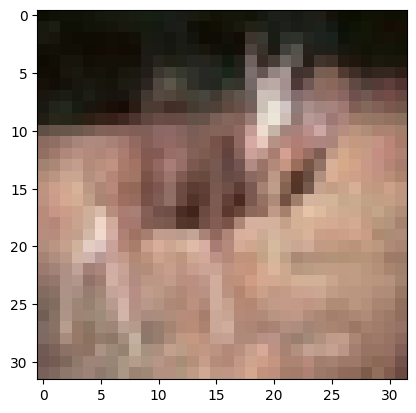

42


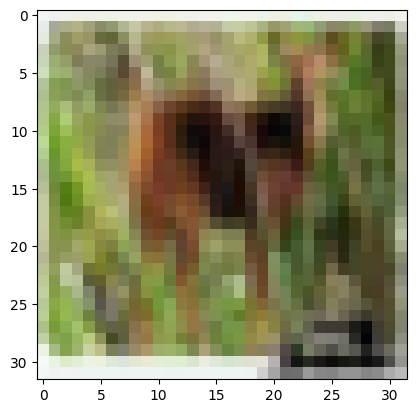

43


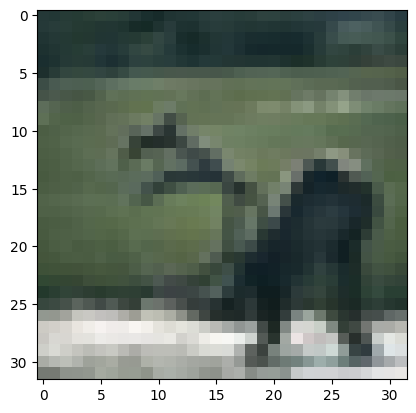

44


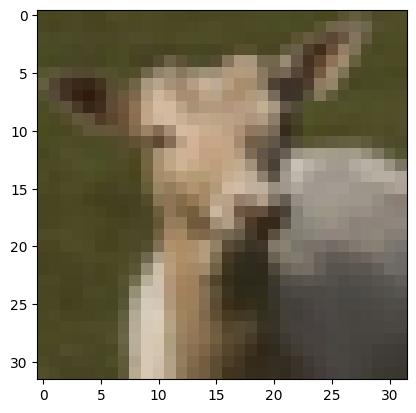

45


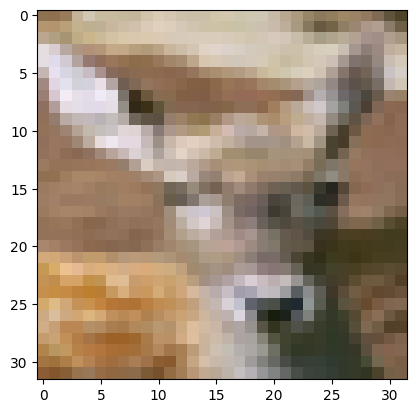

46


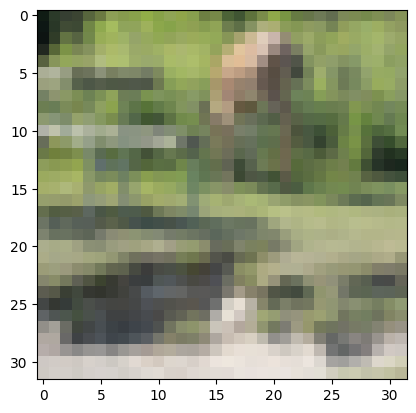

47


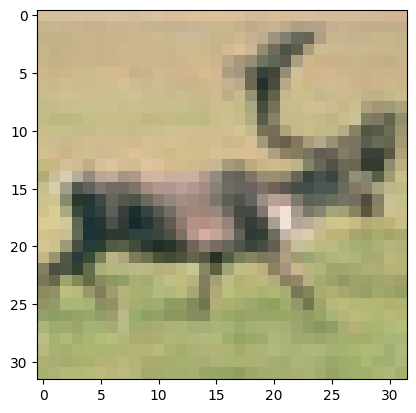

48


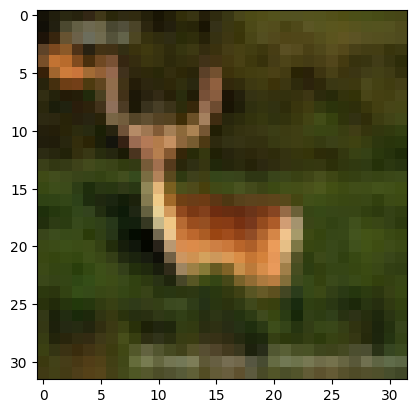

49


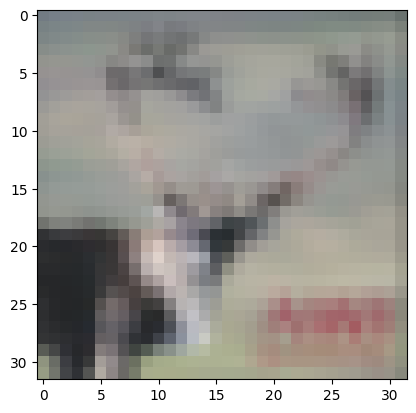

50


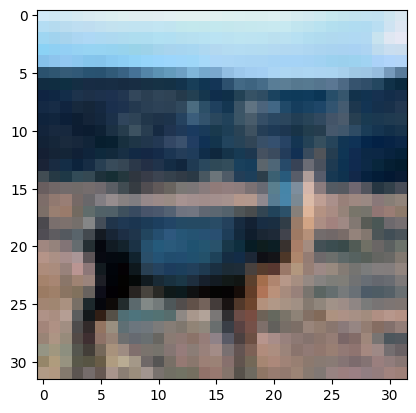

51


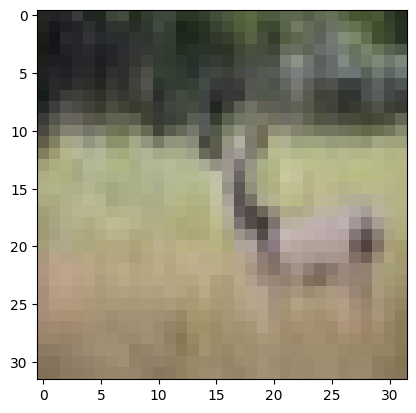

52


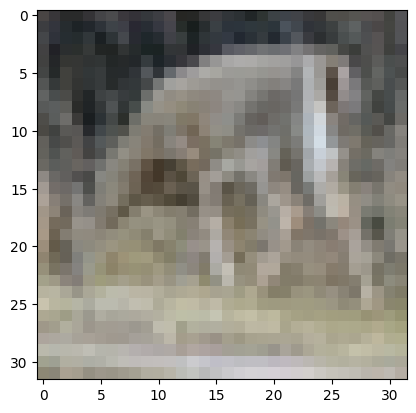

53


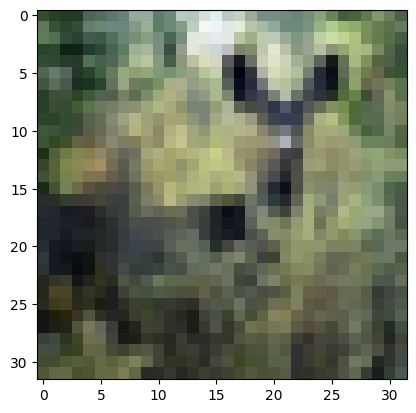

54


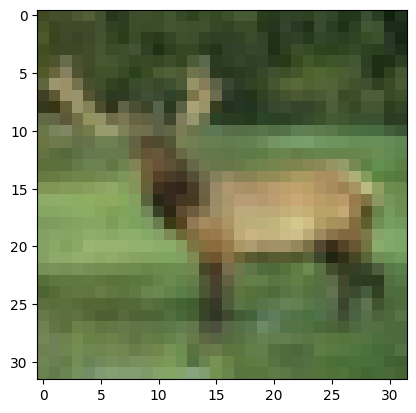

55


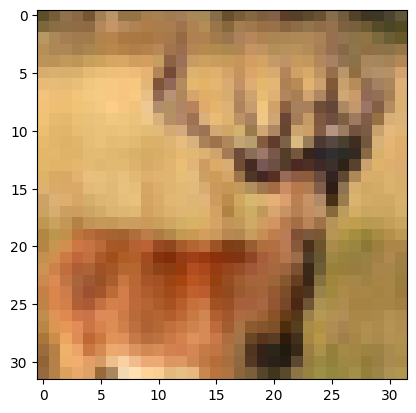

56


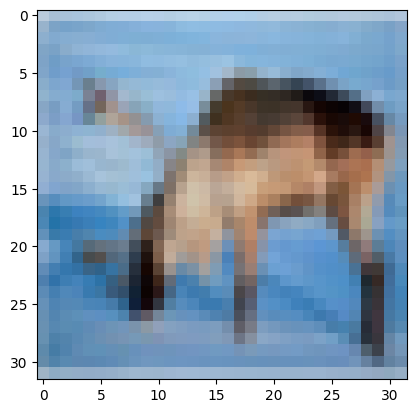

57


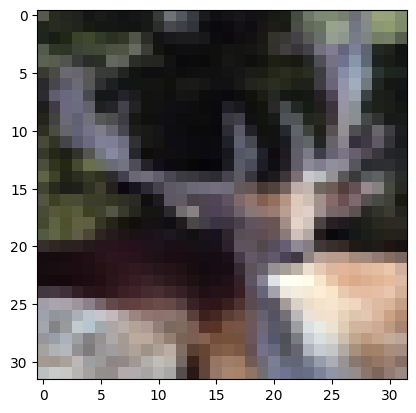

58


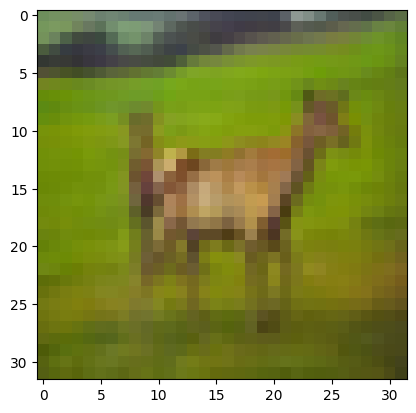

59


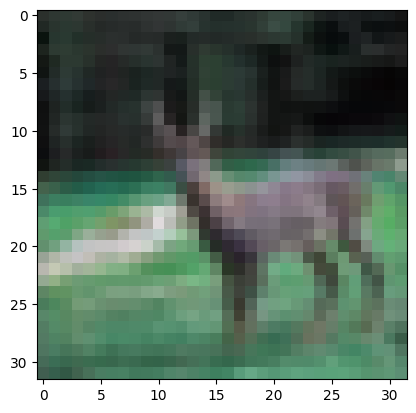

60


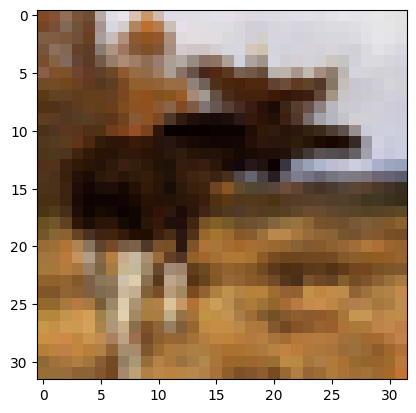

61


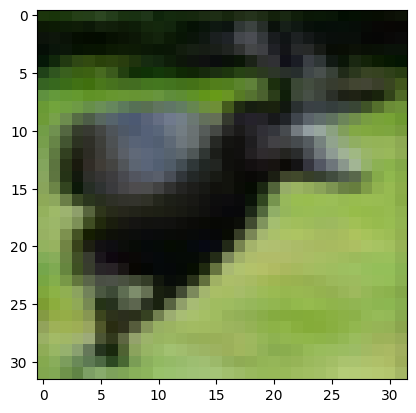

62


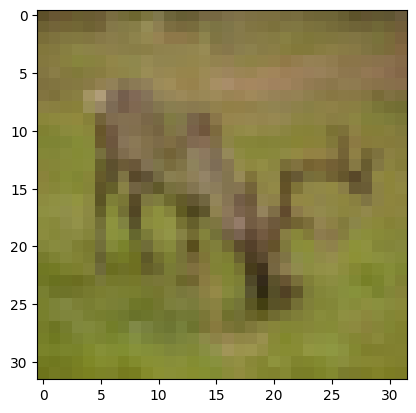

63


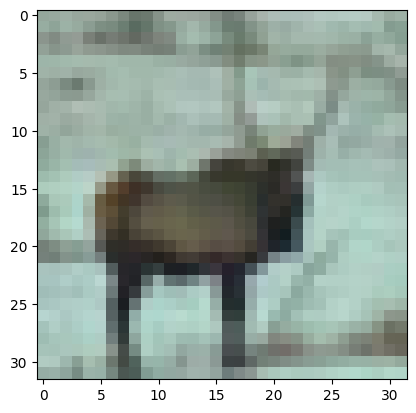

64


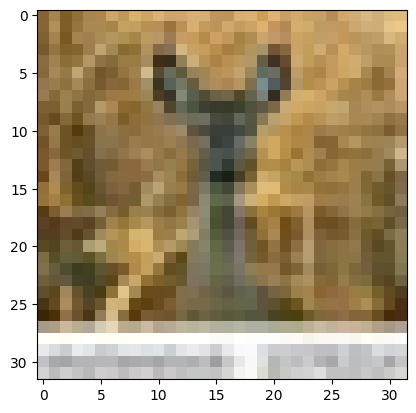

65


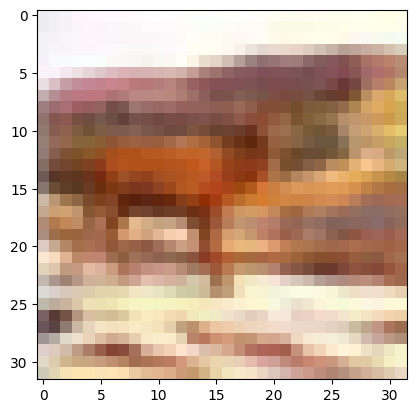

66


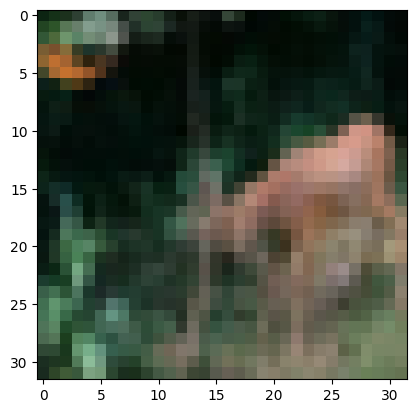

67


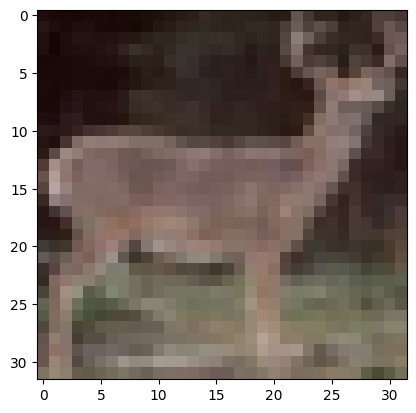

68


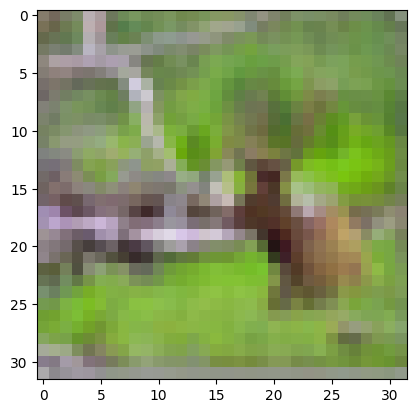

69


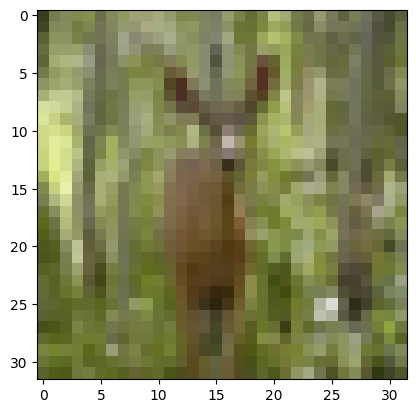

70


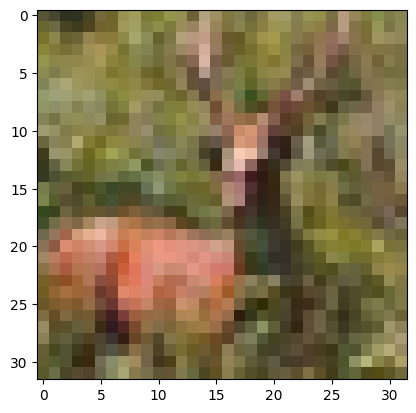

71


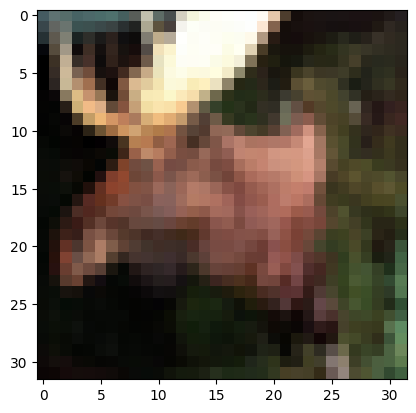

72


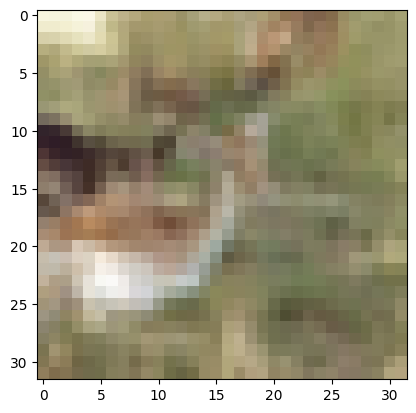

73


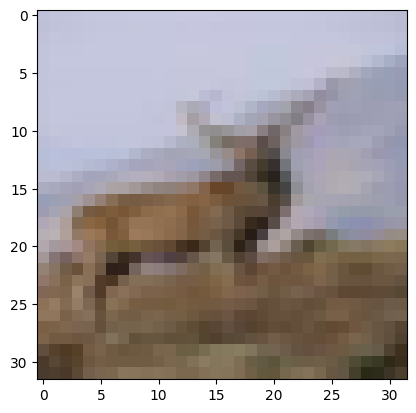

74


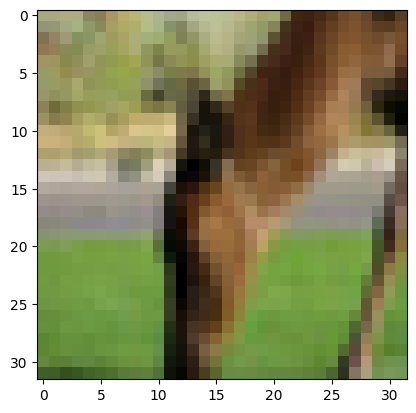

75


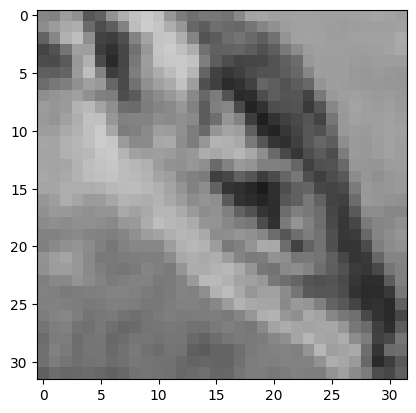

76


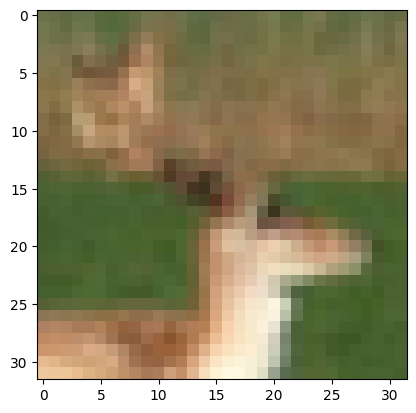

77


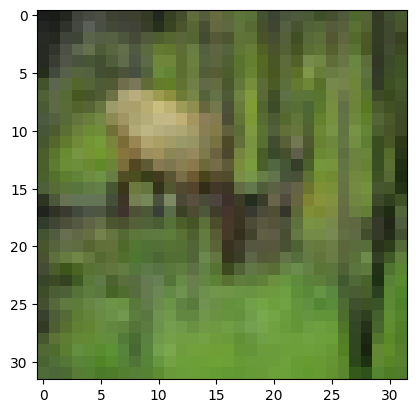

78


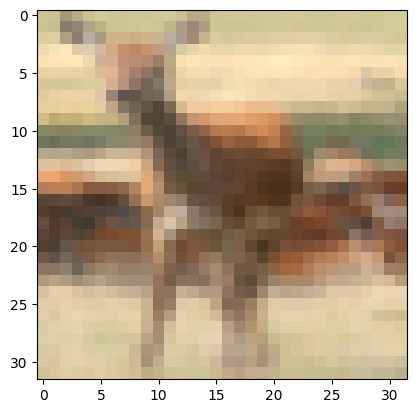

79


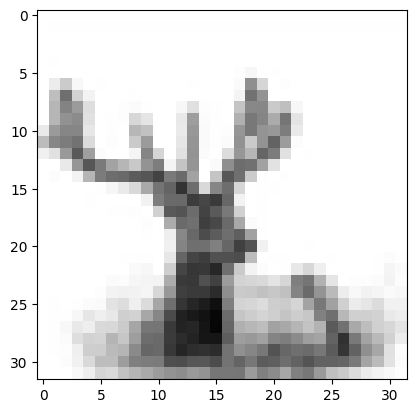

80


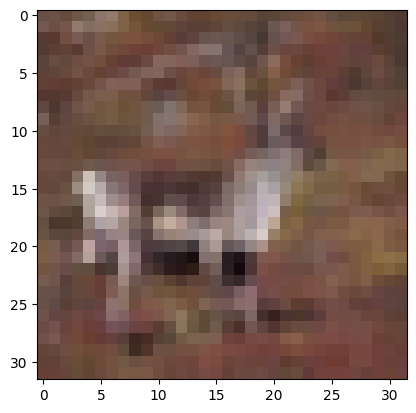

81


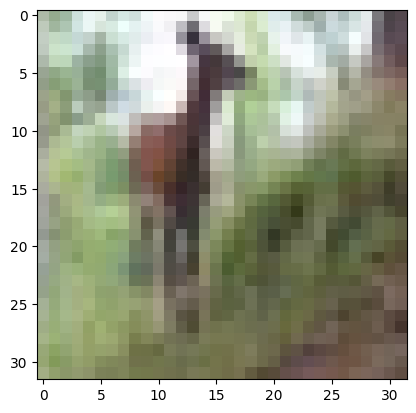

82


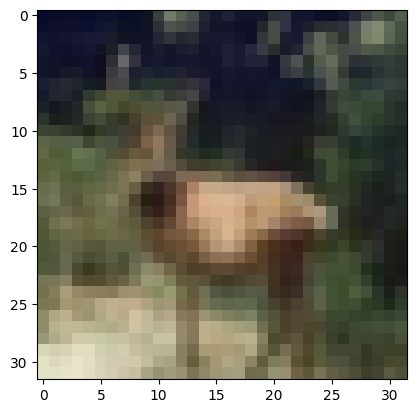

83


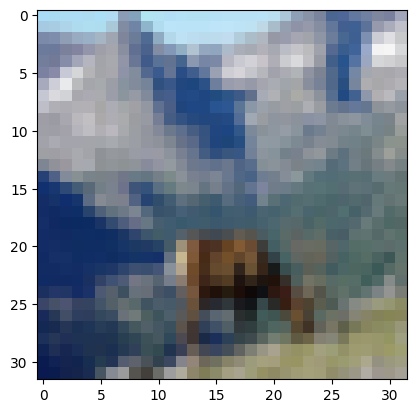

84


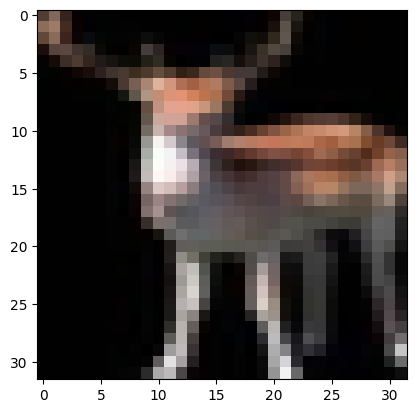

85


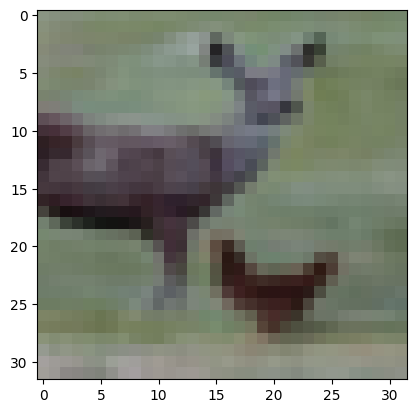

86


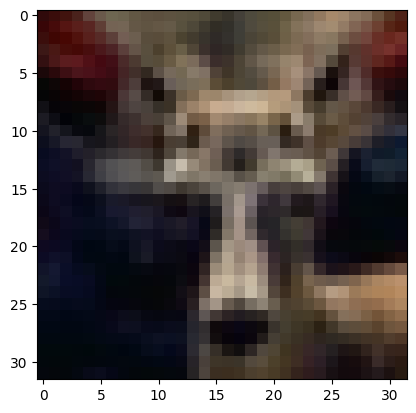

87


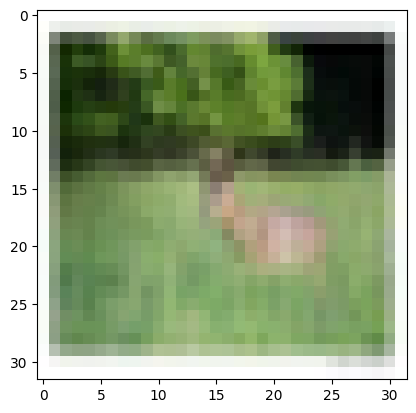

88


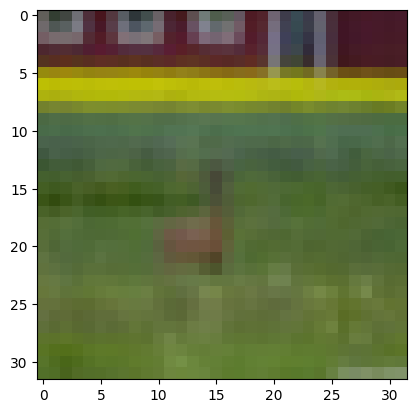

89


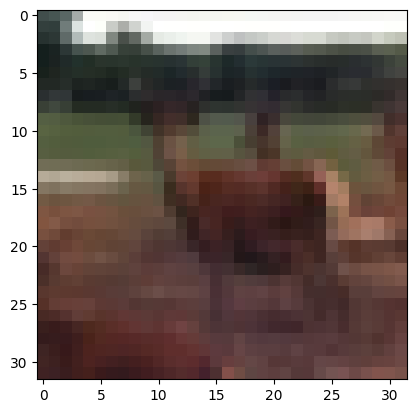

90


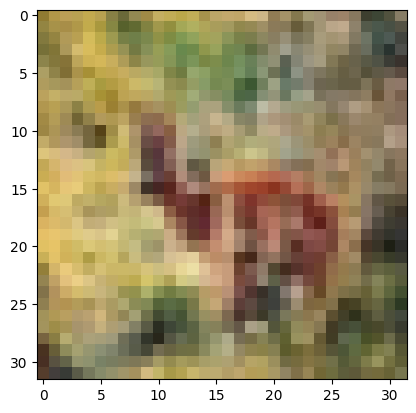

91


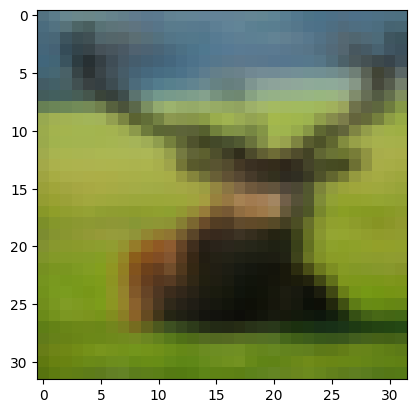

92


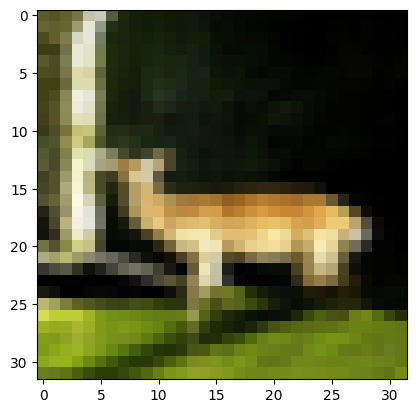

93


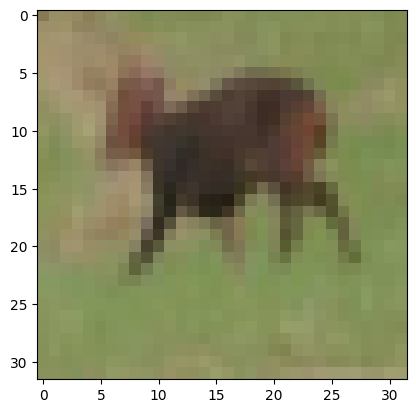

94


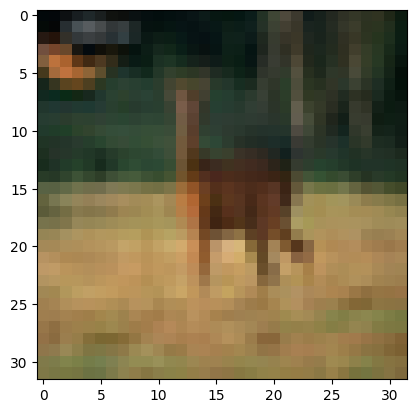

95


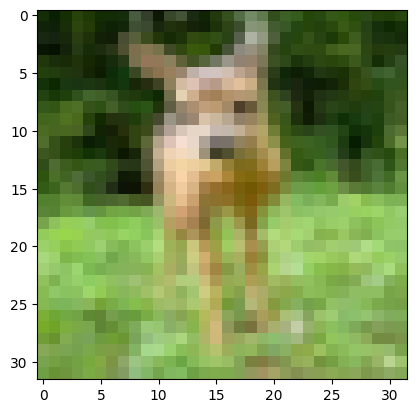

96


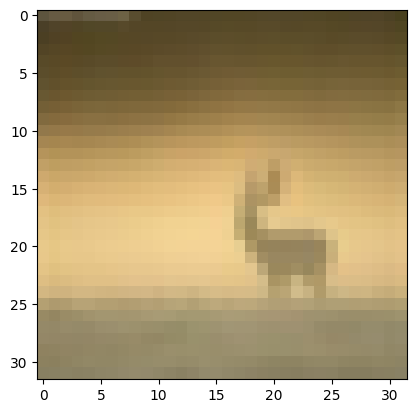

97


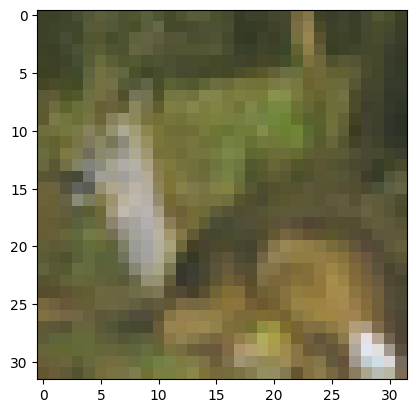

98


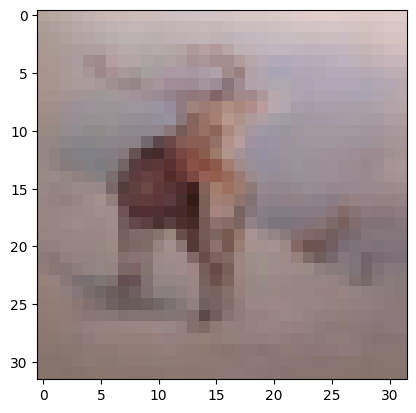

99


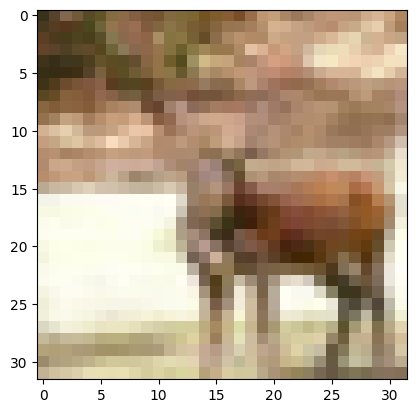

In [ ]:
# Load CIFAR-10
train_data = datasets.CIFAR10(root='./data', train=True, download=True)
clas = 4

# Get all ship images and labels
images4 = [img for img, label in train_data if label == clas]
#print(f"Number of 1 images: {len(ship_images)}")  # Output: 5000 (train)

for i in range(100):
  print(i)
  plt.imshow(images4[i])
  plt.show()

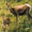

In [ ]:
images4[34]

### 5

0


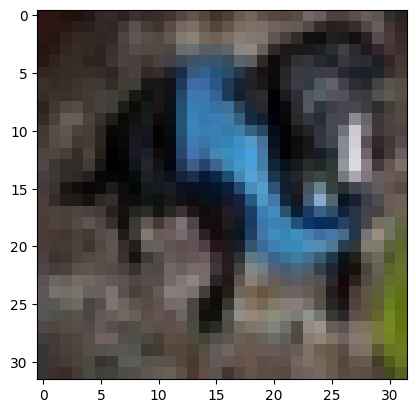

1


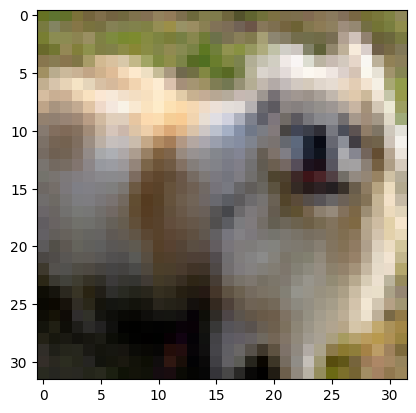

2


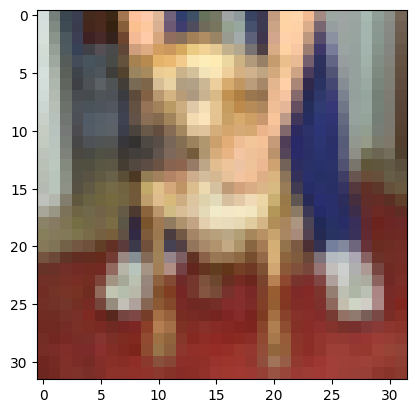

3


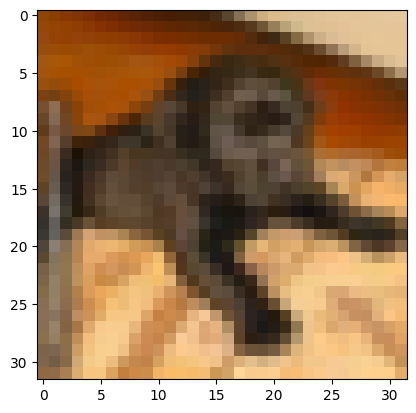

4


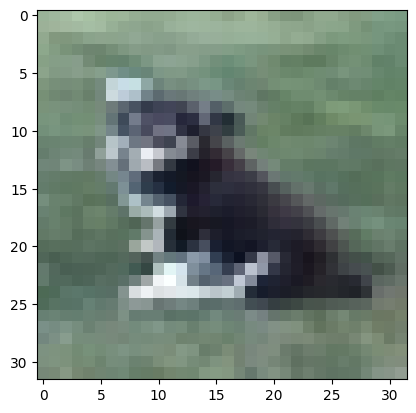

5


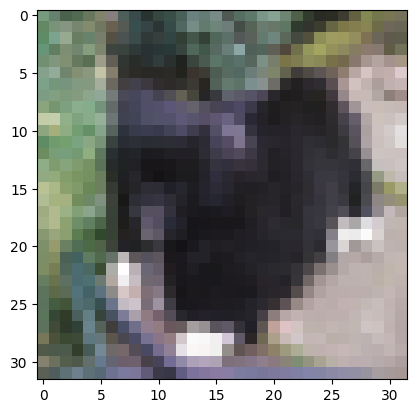

6


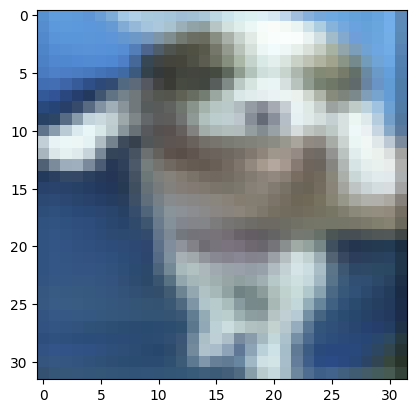

7


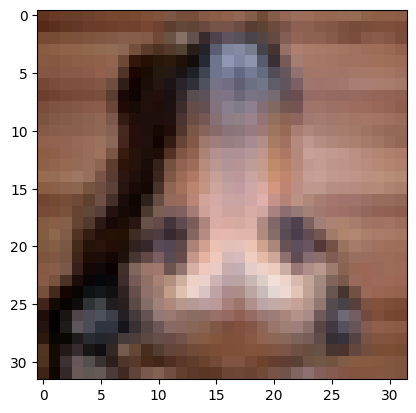

8


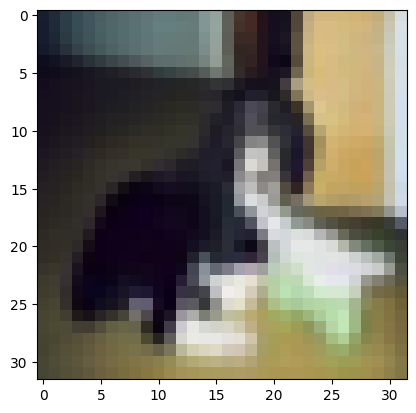

9


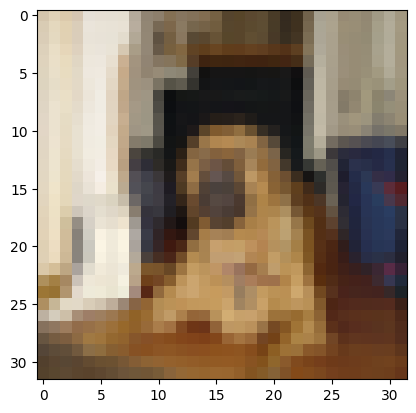

10


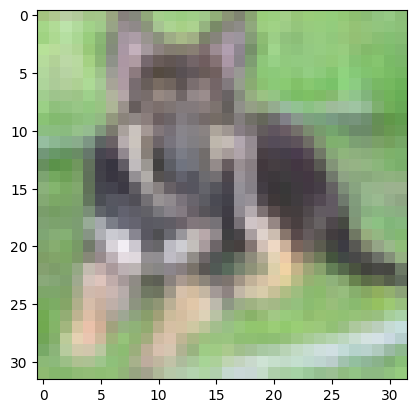

11


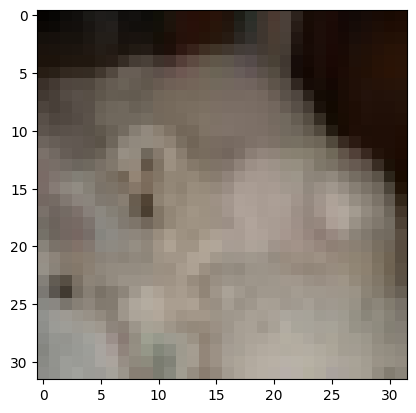

12


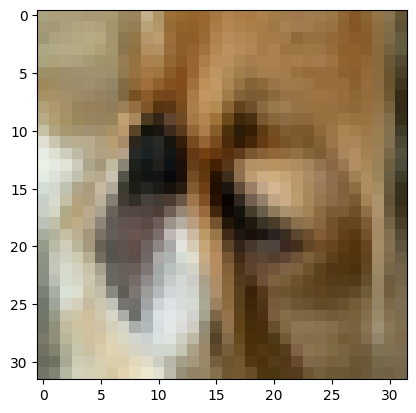

13


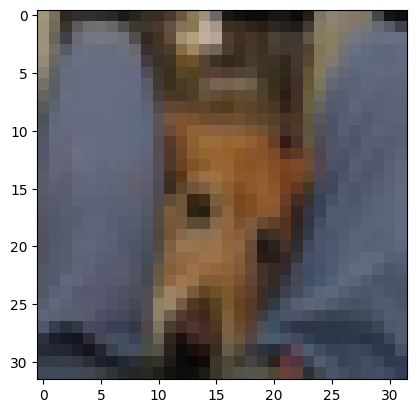

14


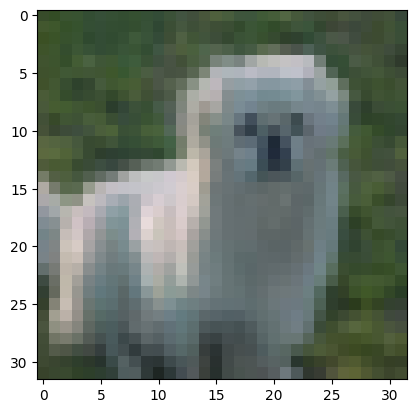

15


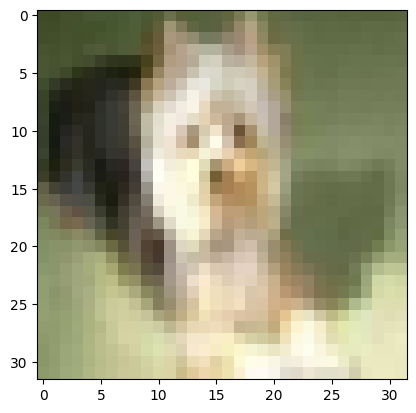

16


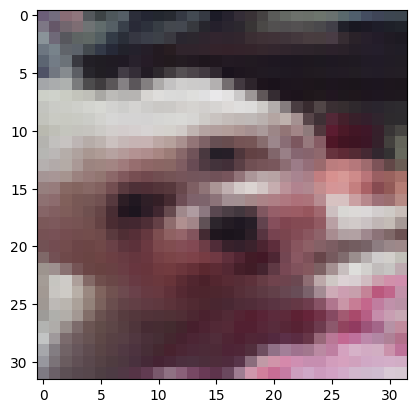

17


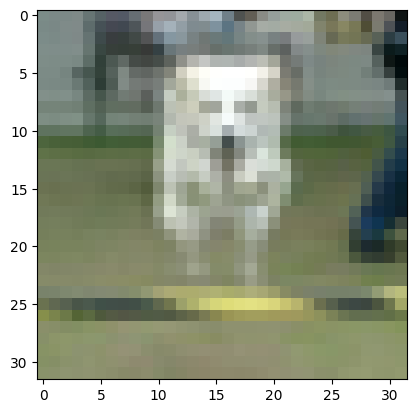

18


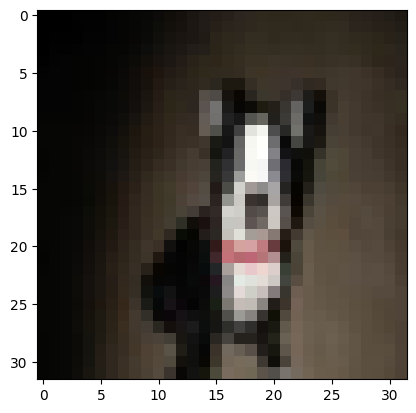

19


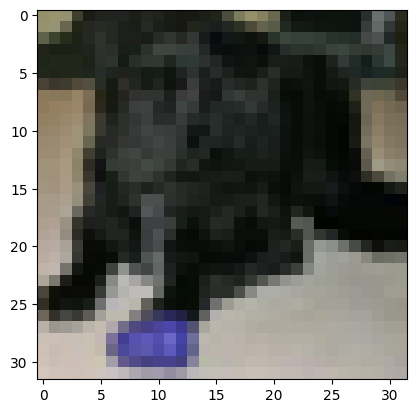

20


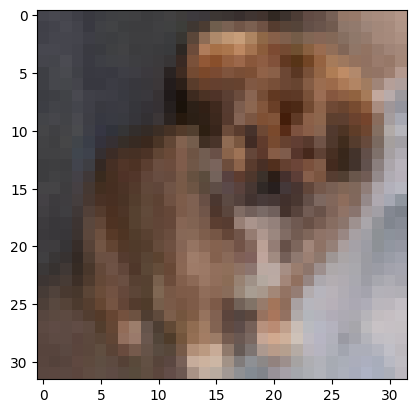

21


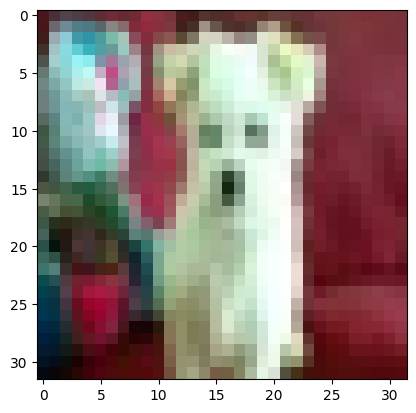

22


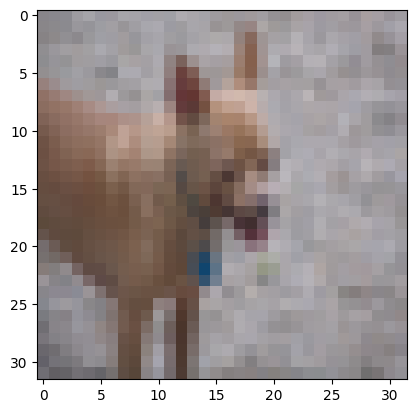

23


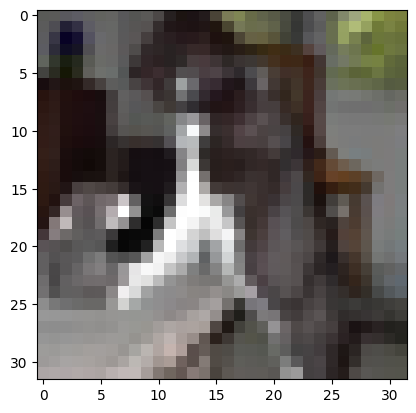

24


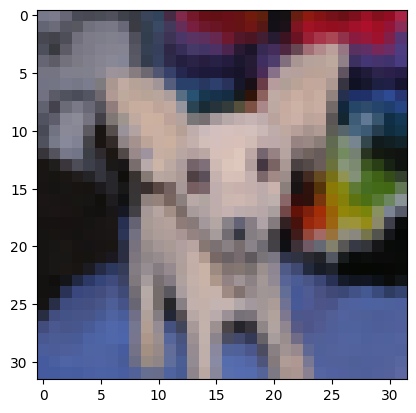

25


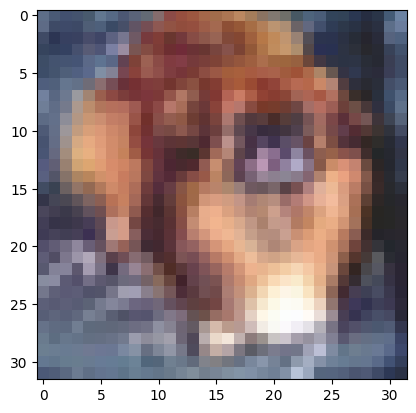

26


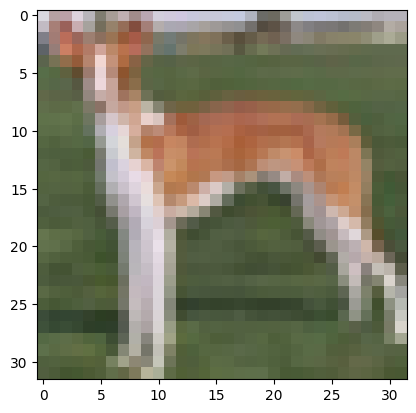

27


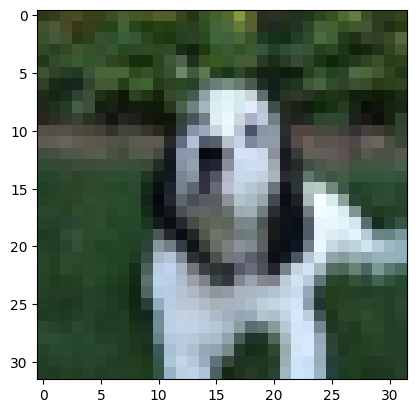

28


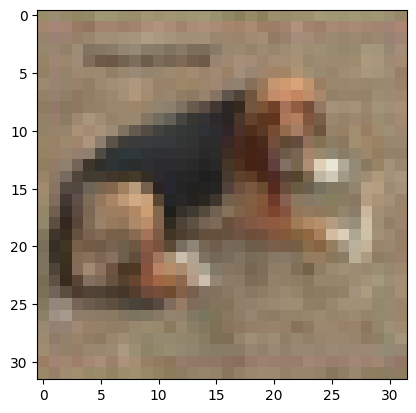

29


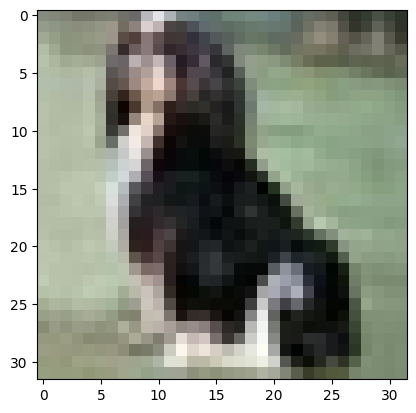

30


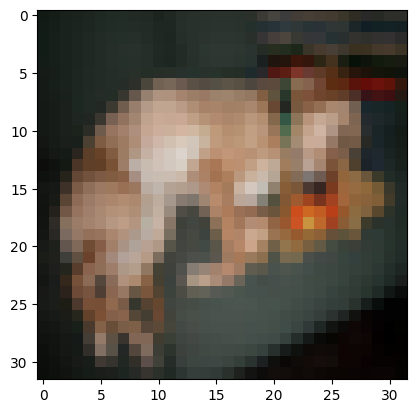

31


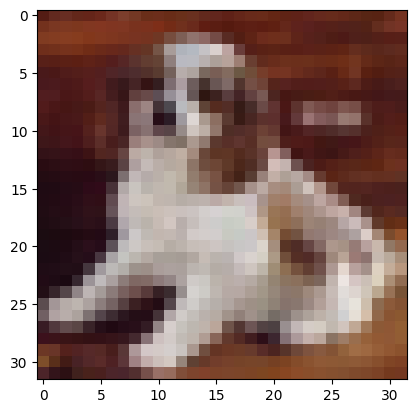

32


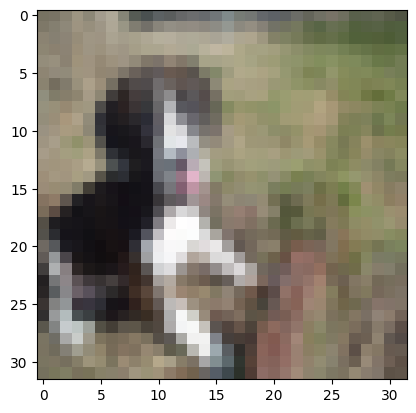

33


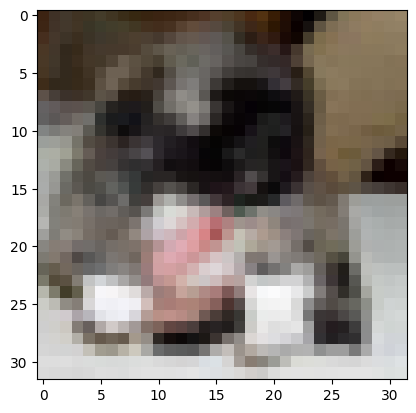

34


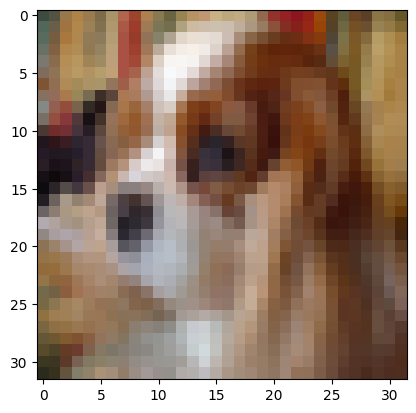

35


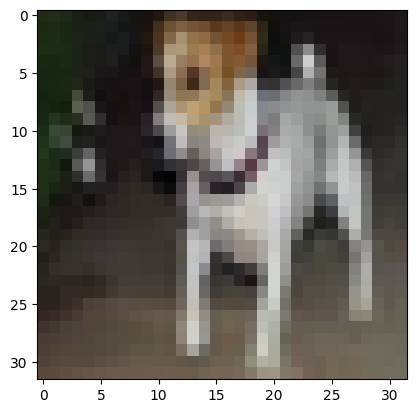

36


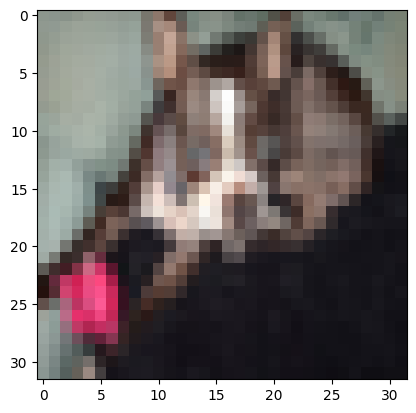

37


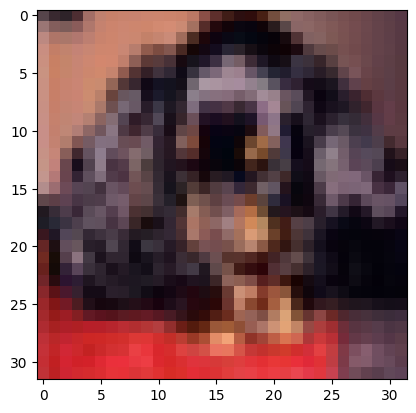

38


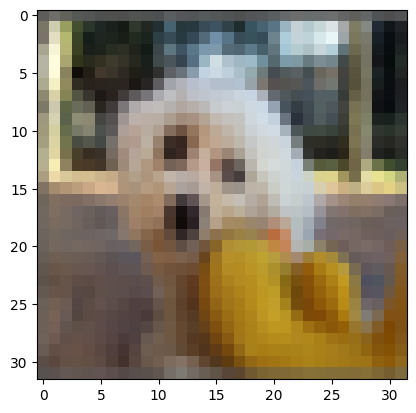

39


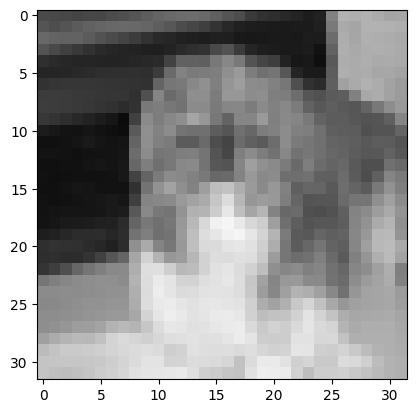

40


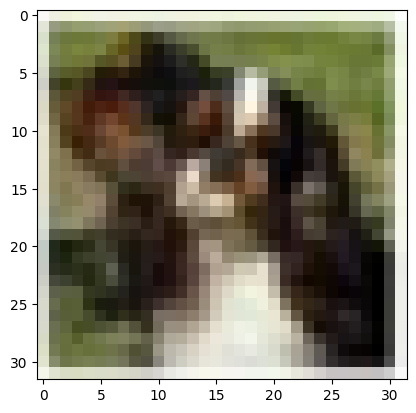

41


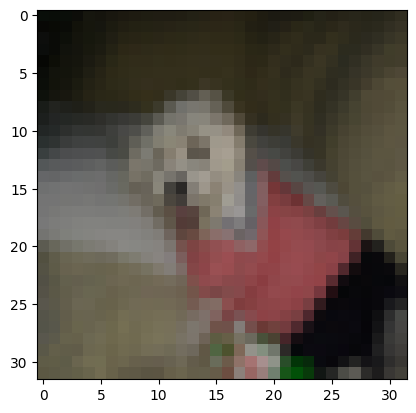

42


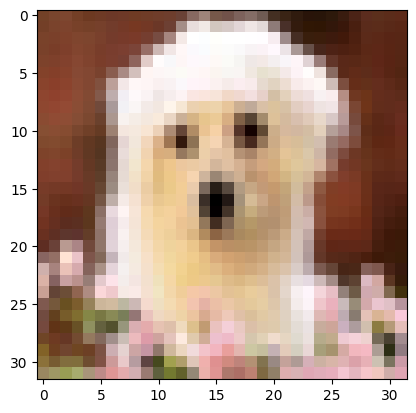

43


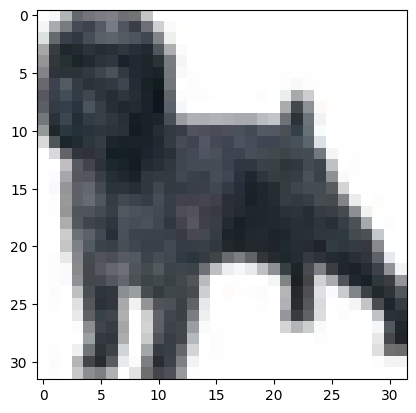

44


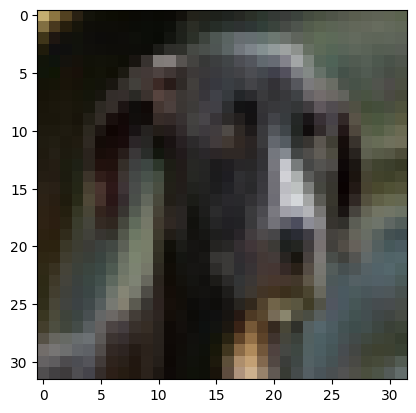

45


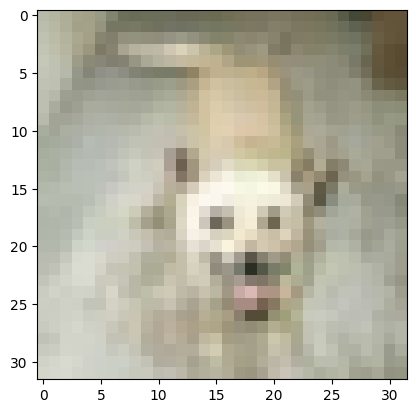

46


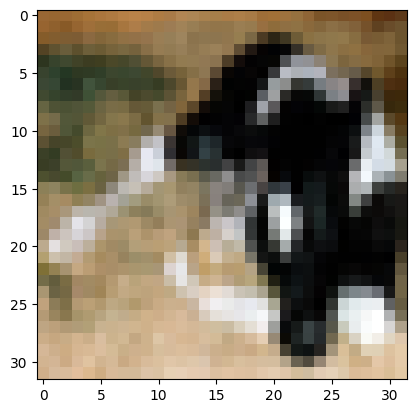

47


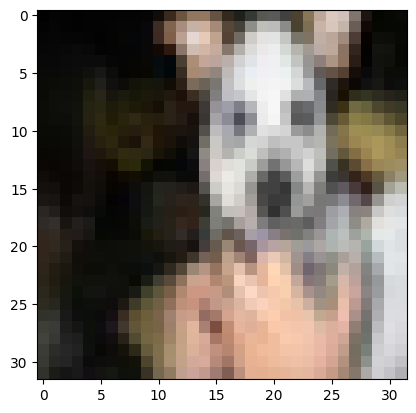

48


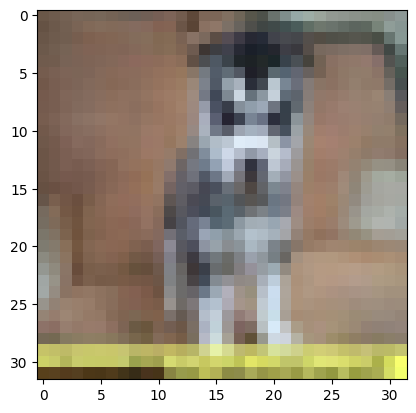

49


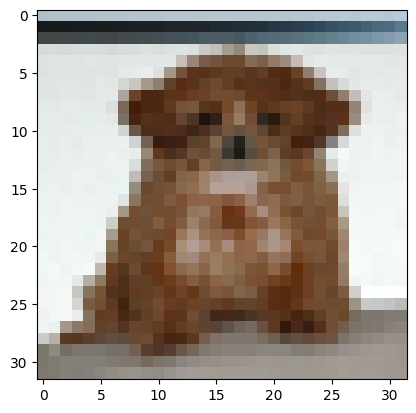

50


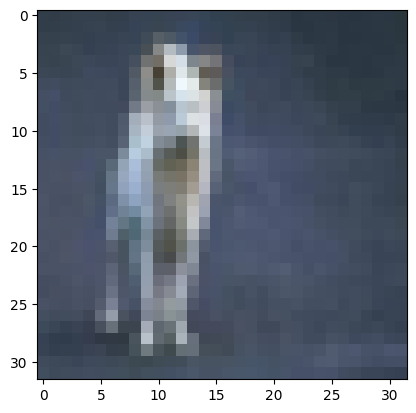

51


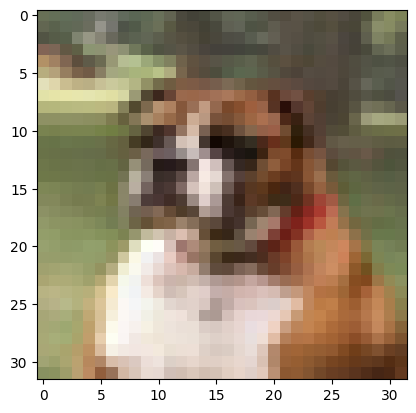

52


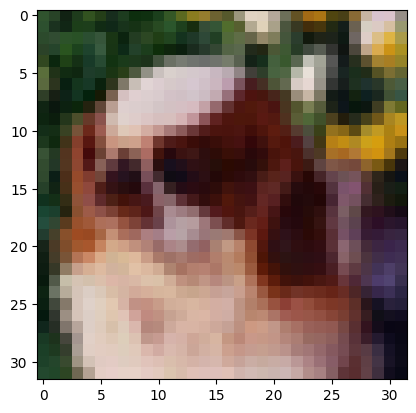

53


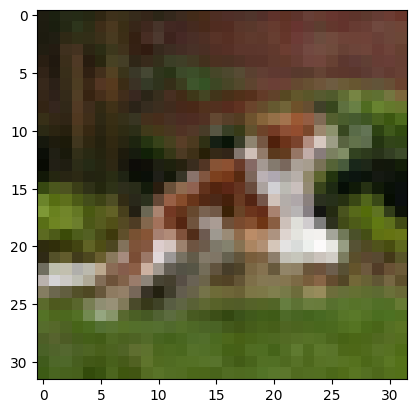

54


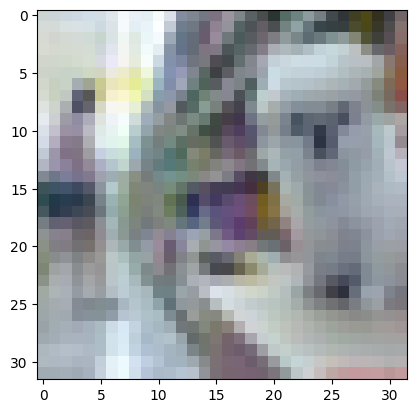

55


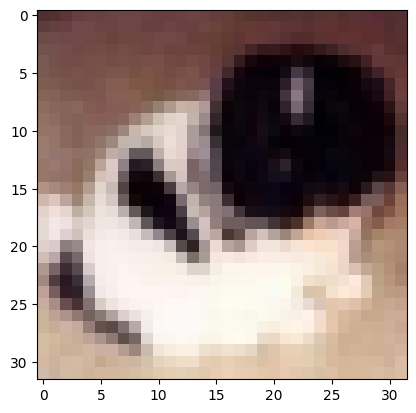

56


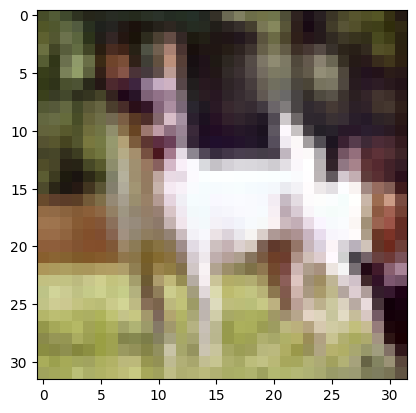

57


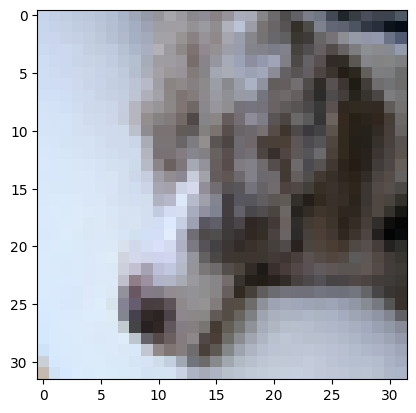

58


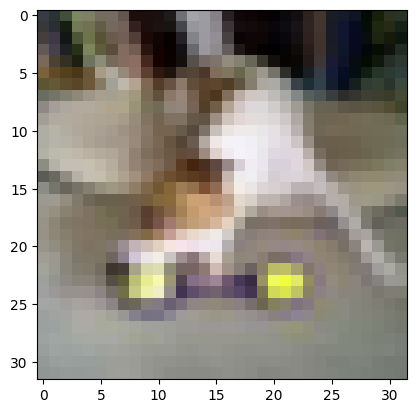

59


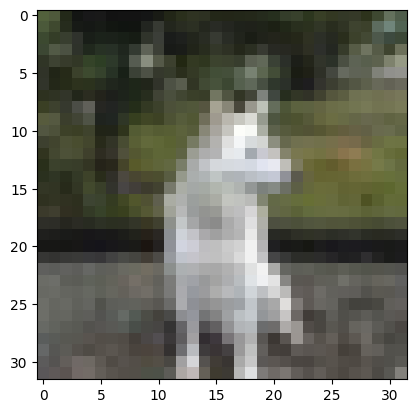

60


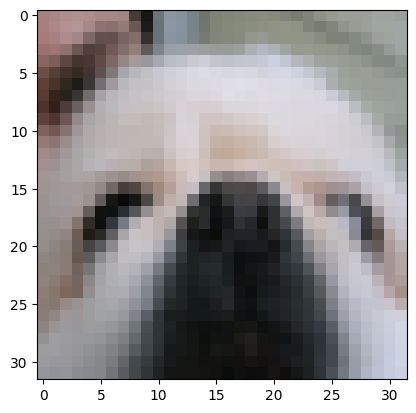

61


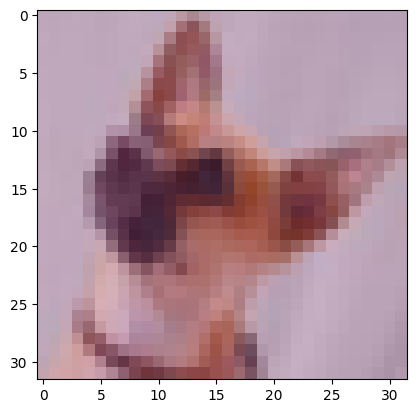

62


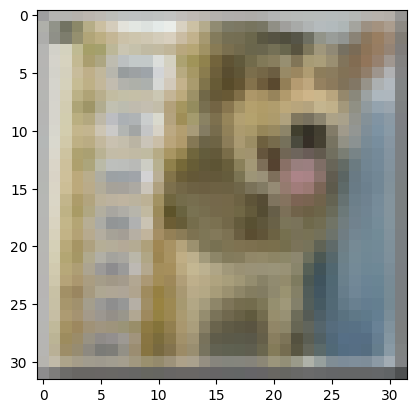

63


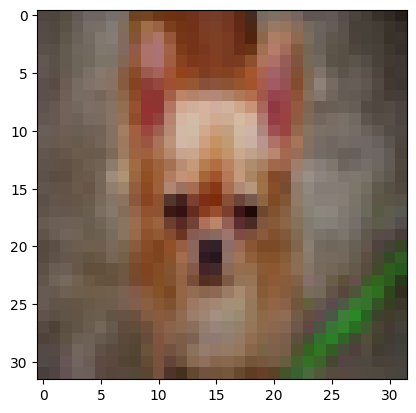

64


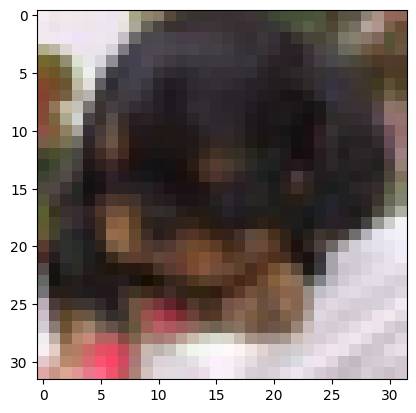

65


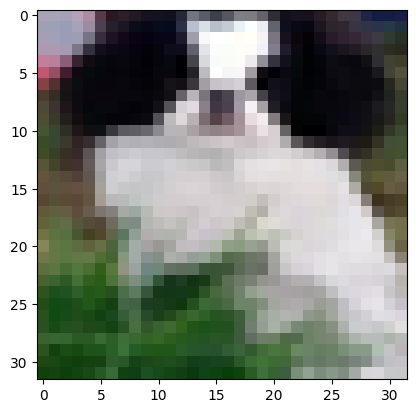

66


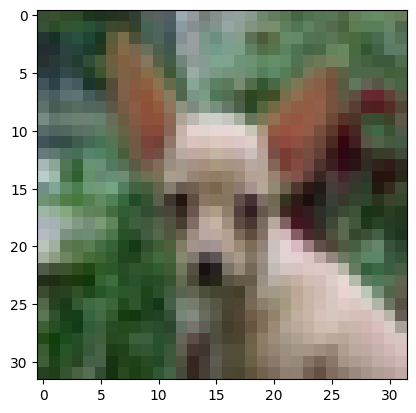

67


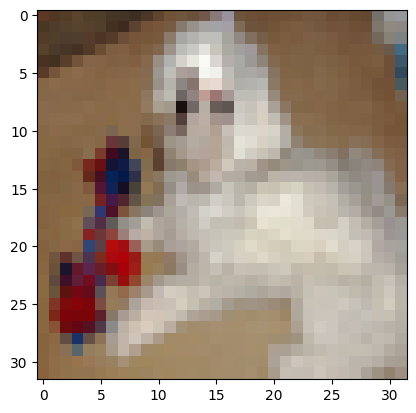

68


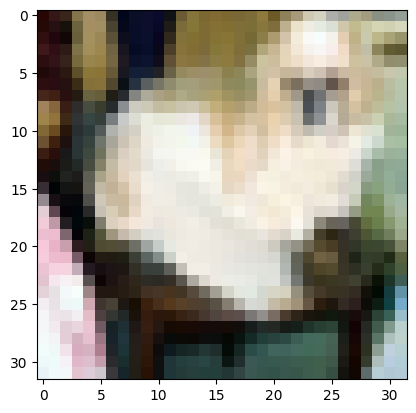

69


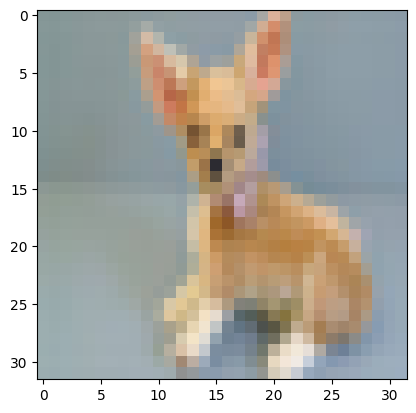

70


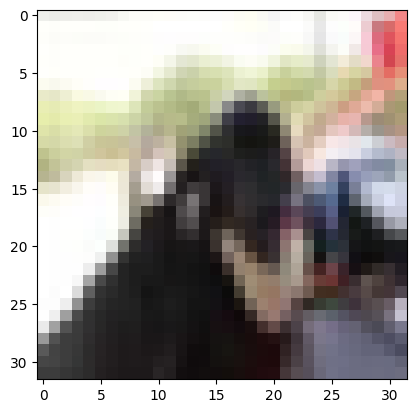

71


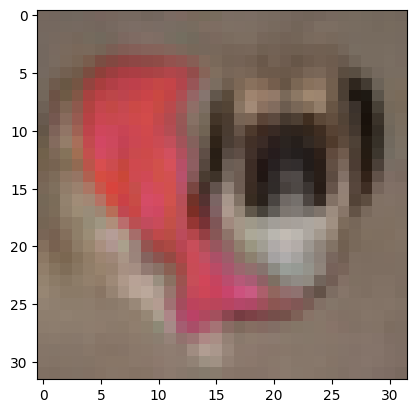

72


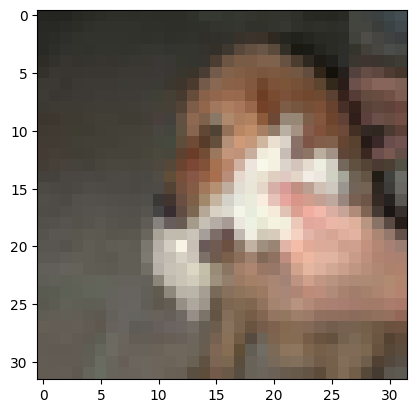

73


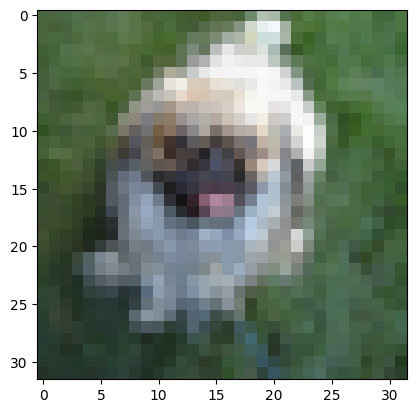

74


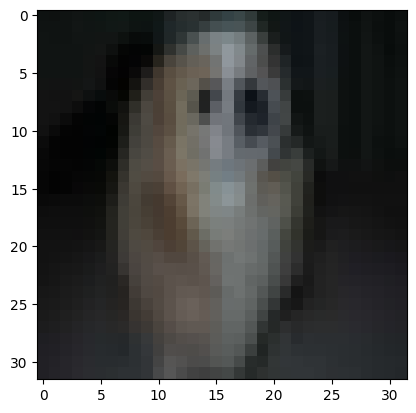

75


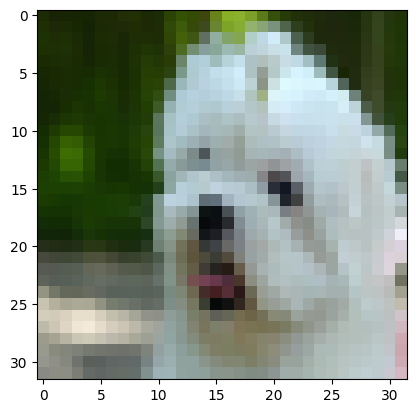

76


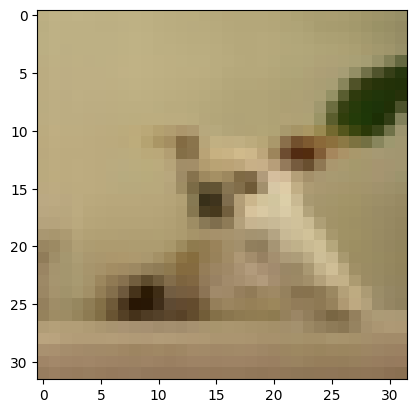

77


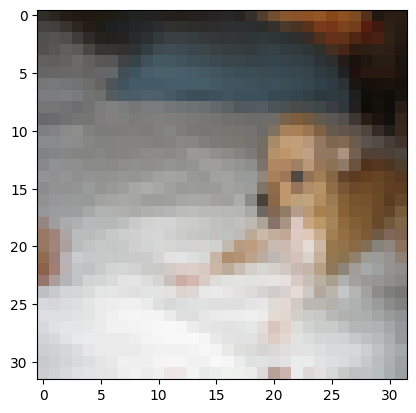

78


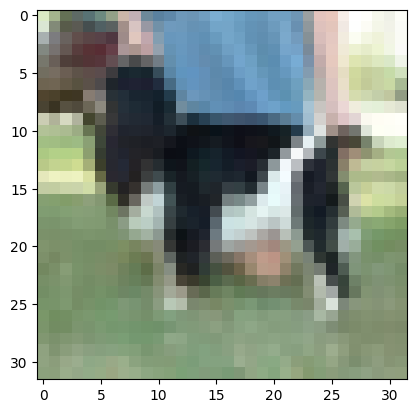

79


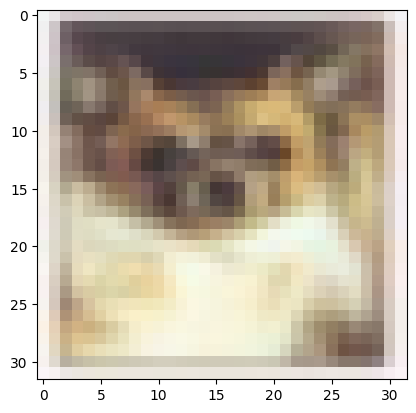

80


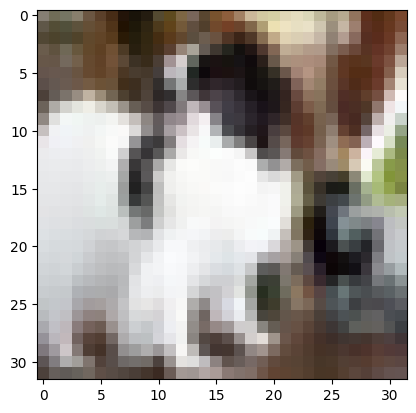

81


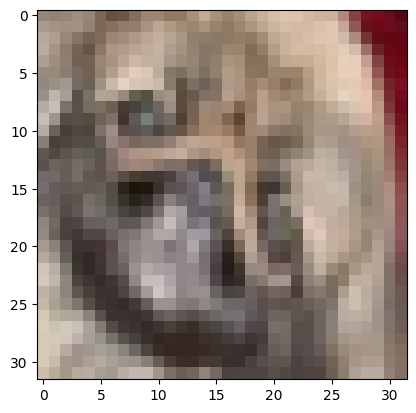

82


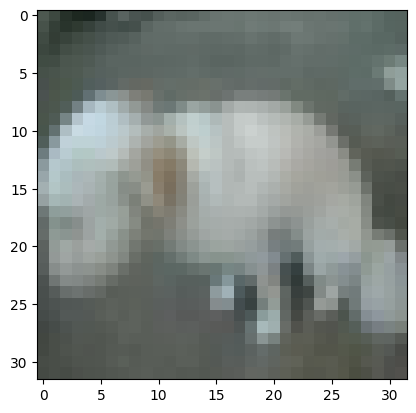

83


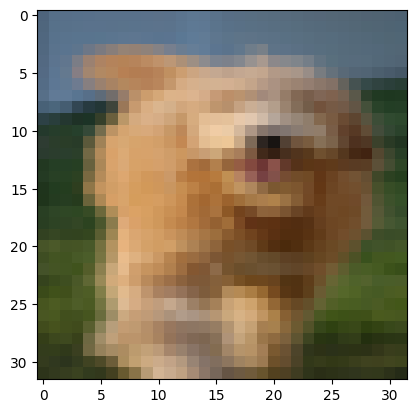

84


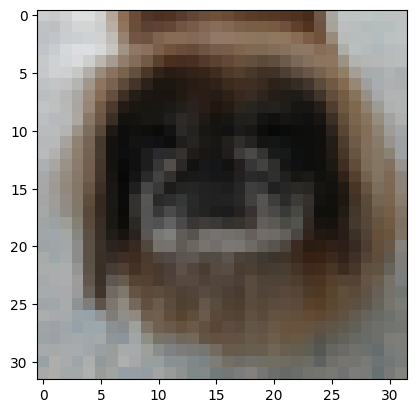

85


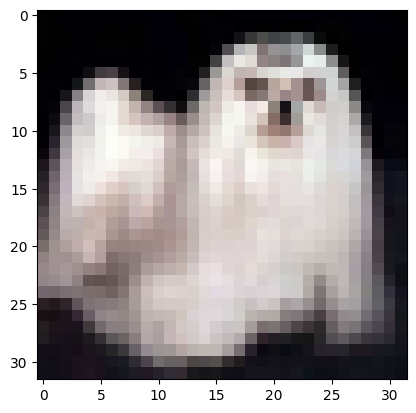

86


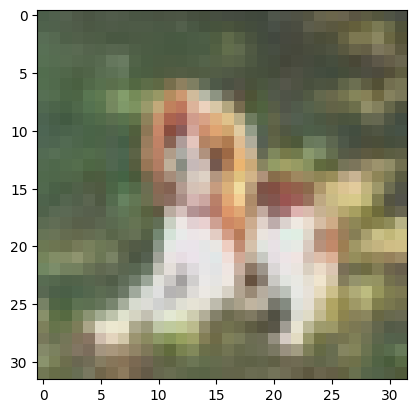

87


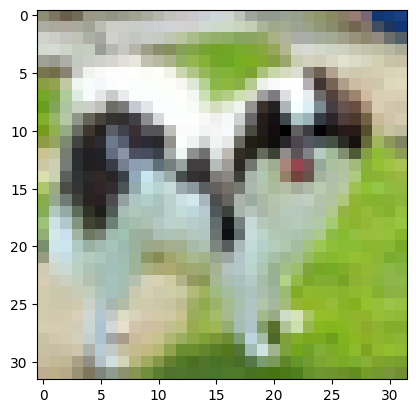

88


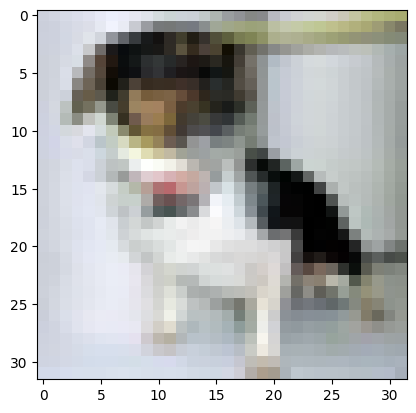

89


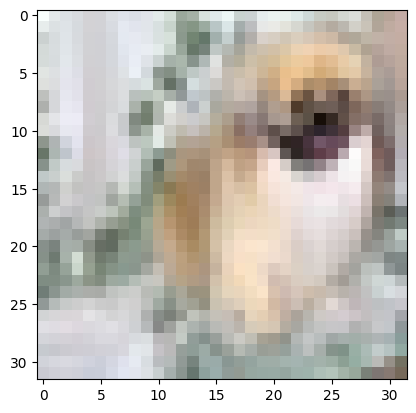

90


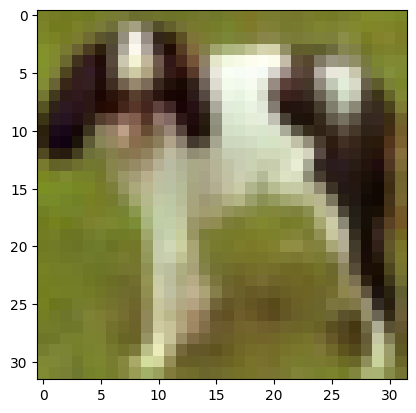

91


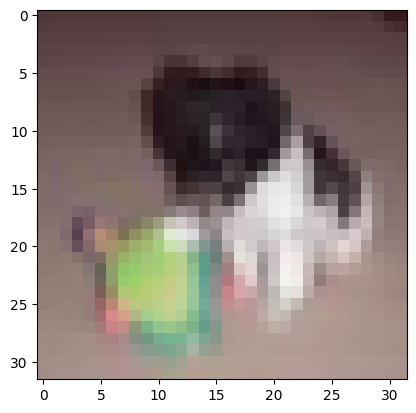

92


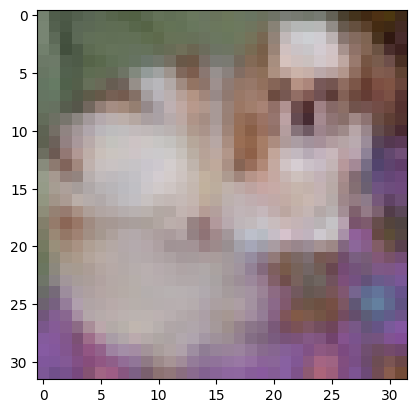

93


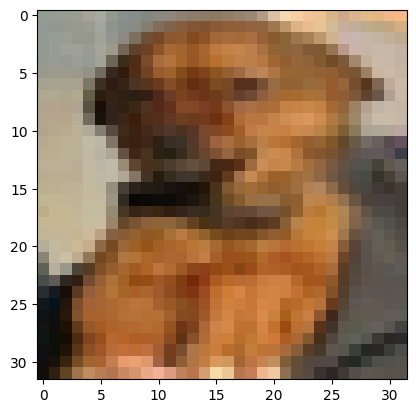

94


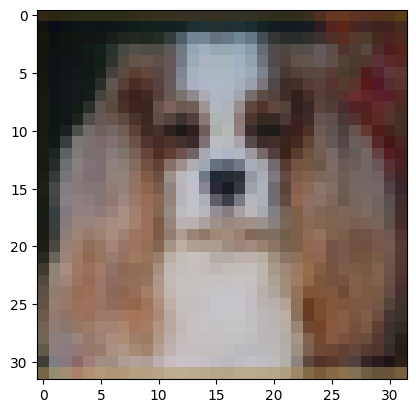

95


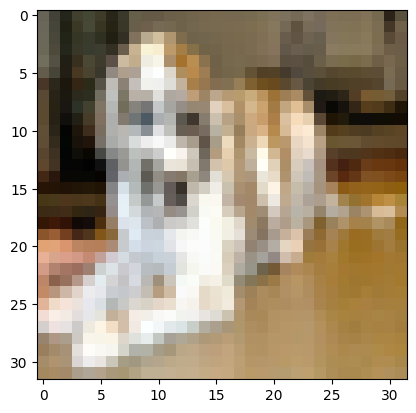

96


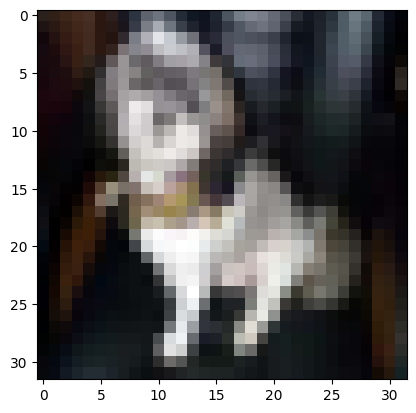

97


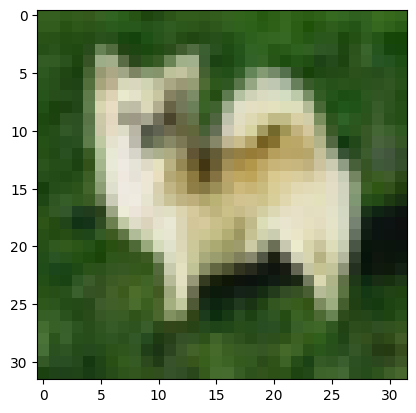

98


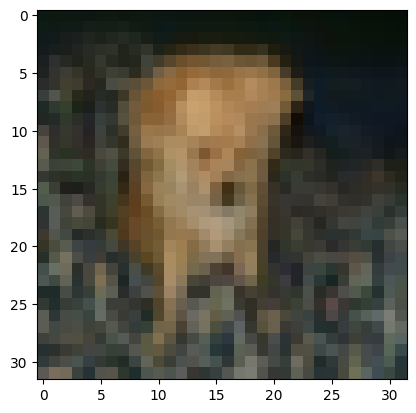

99


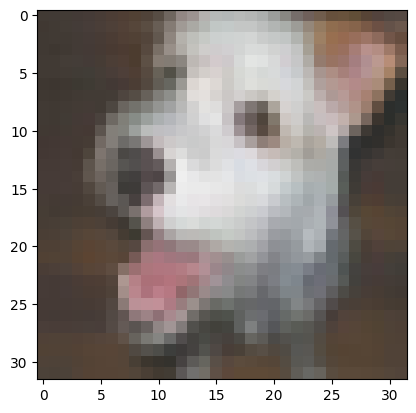

In [ ]:
# Load CIFAR-10
train_data = datasets.CIFAR10(root='./data', train=True, download=True)
clas = 5

# Get all ship images and labels
images5 = [img for img, label in train_data if label == clas]
#print(f"Number of 1 images: {len(ship_images)}")  # Output: 5000 (train)

for i in range(100):
  print(i)
  plt.imshow(images5[i])
  plt.show()

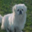

In [ ]:
images5[14]

### 6

0


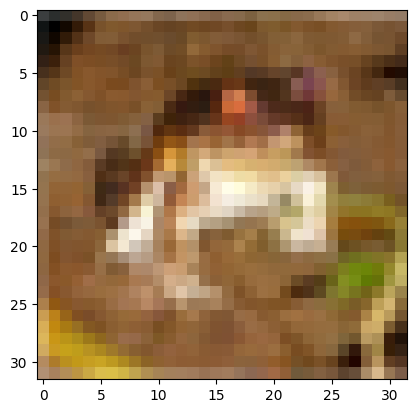

1


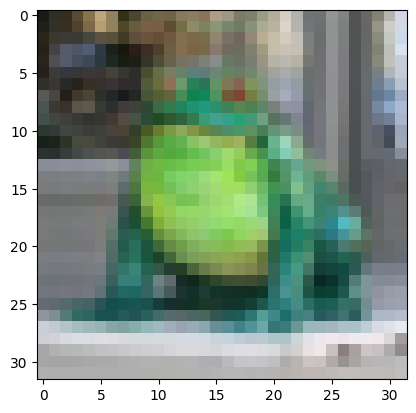

2


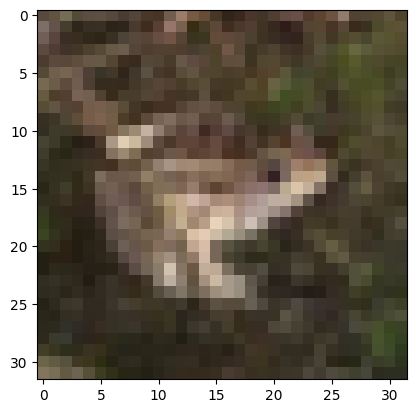

3


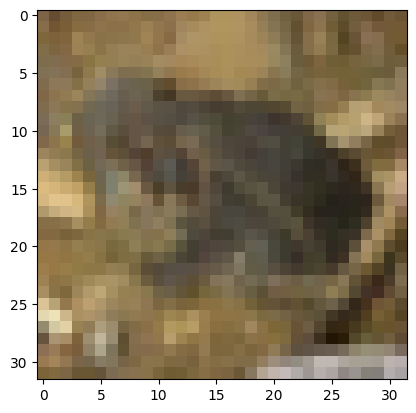

4


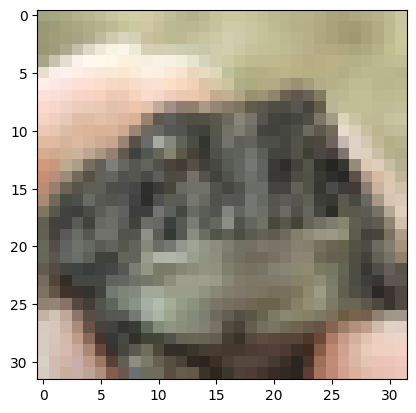

5


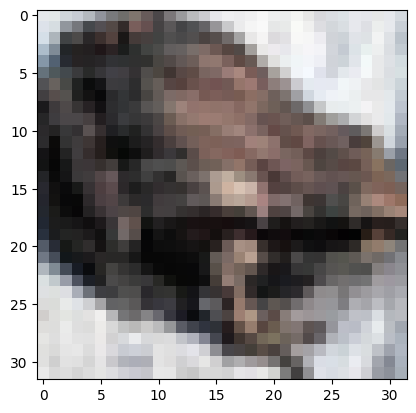

6


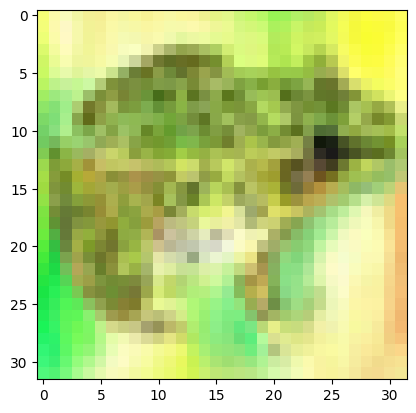

7


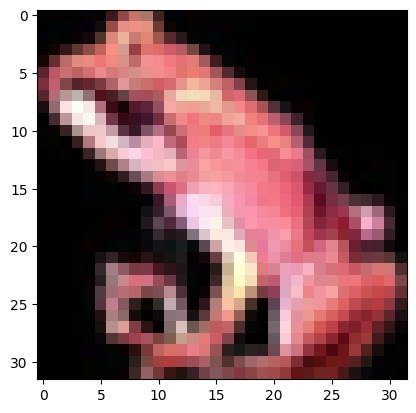

8


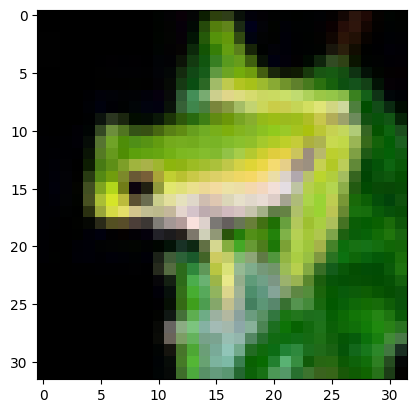

9


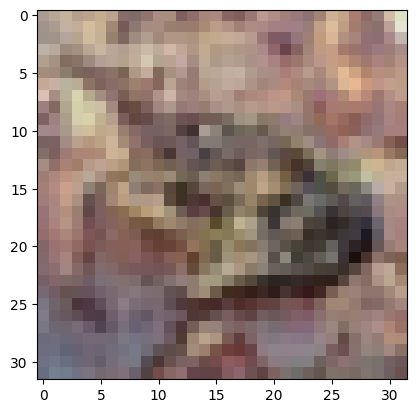

10


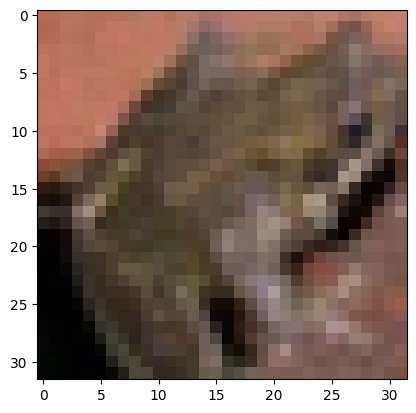

11


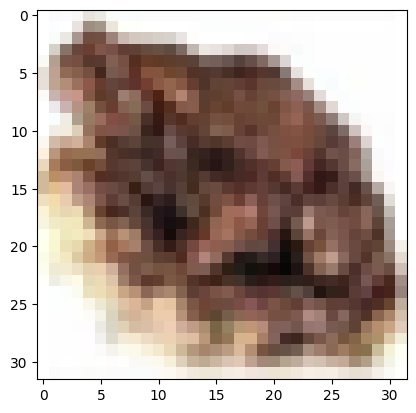

12


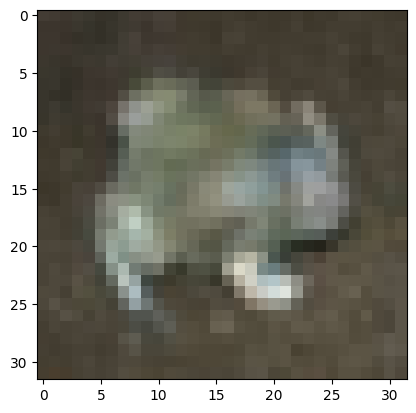

13


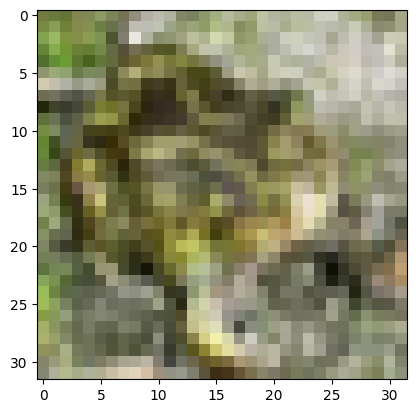

14


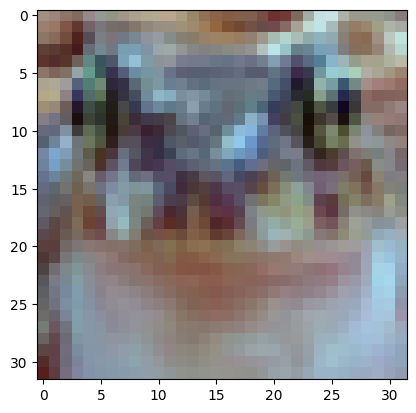

15


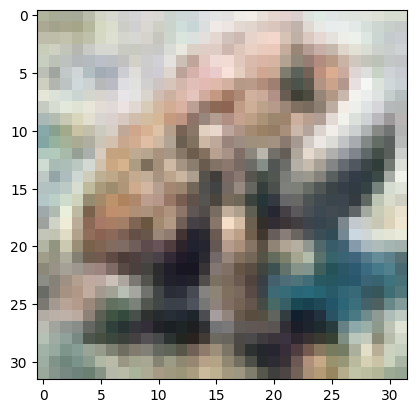

16


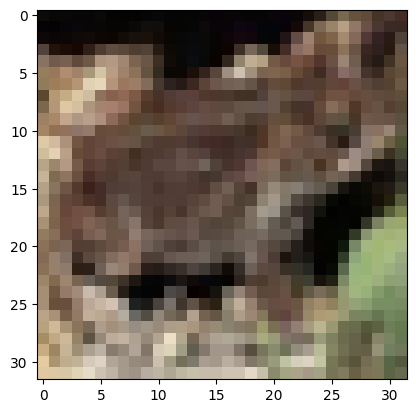

17


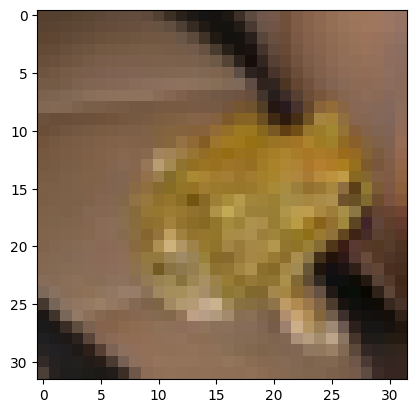

18


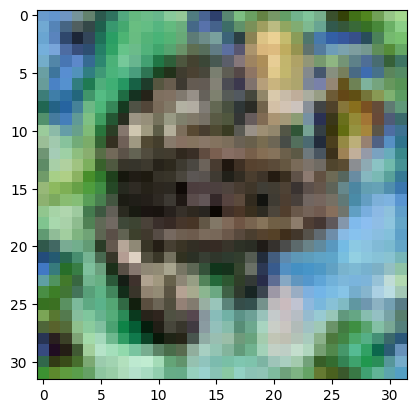

19


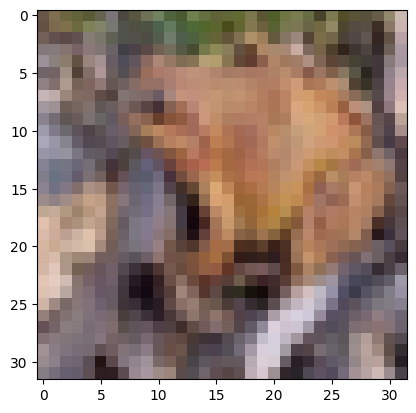

20


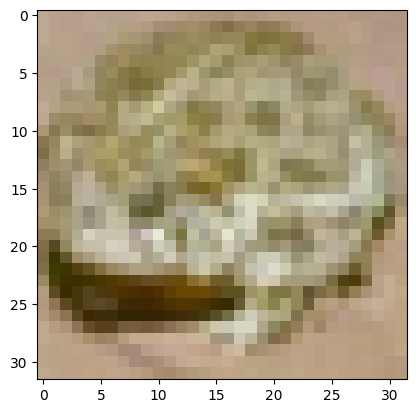

21


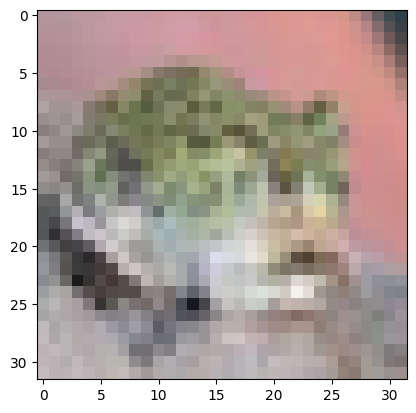

22


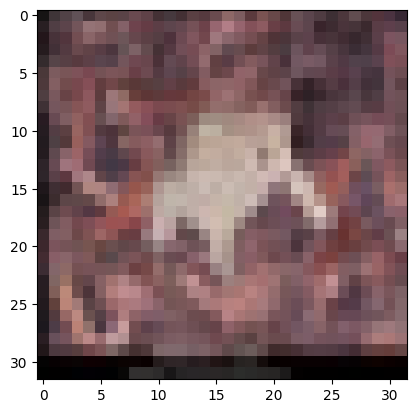

23


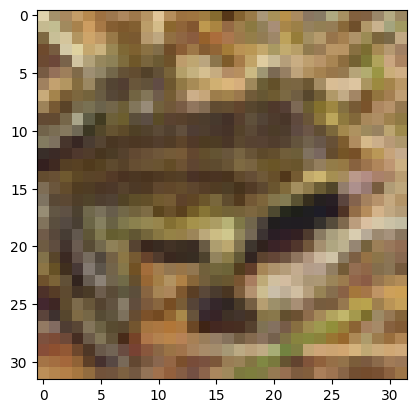

24


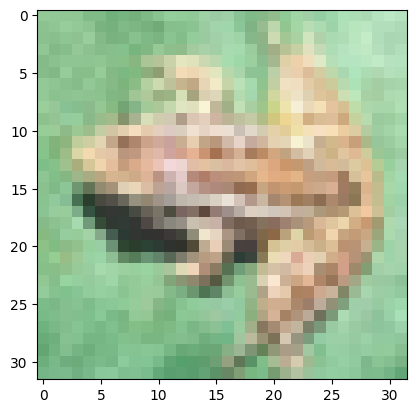

25


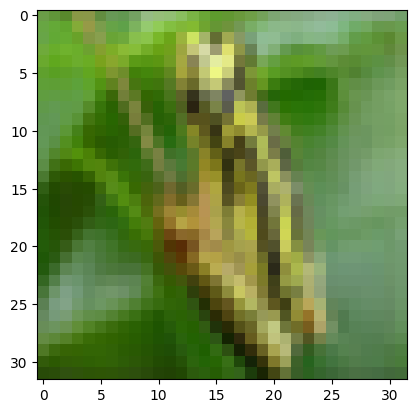

26


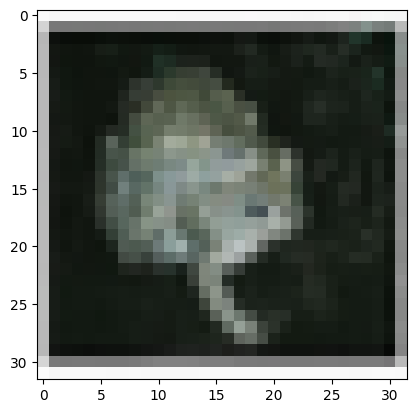

27


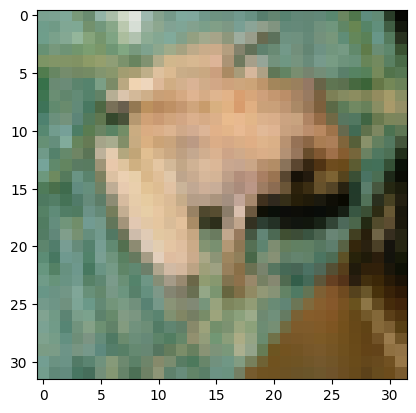

28


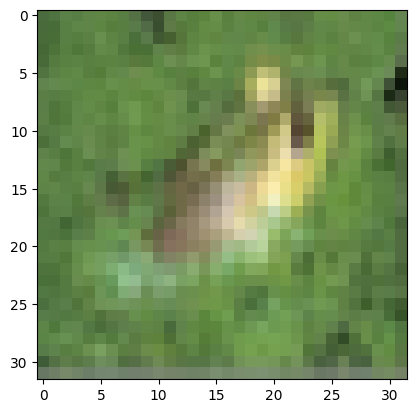

29


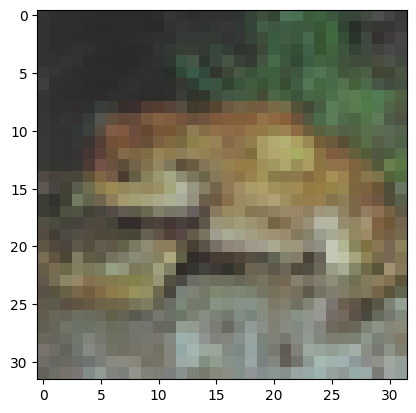

30


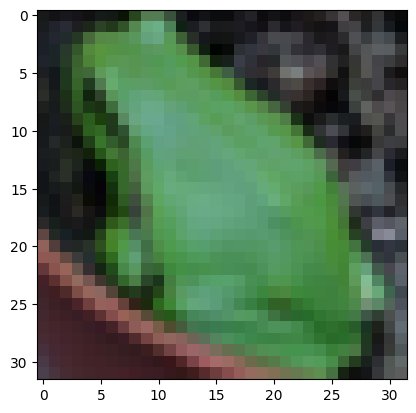

31


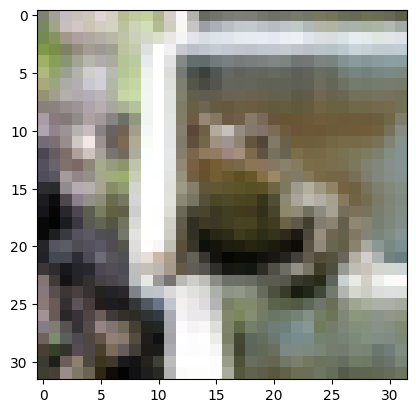

32


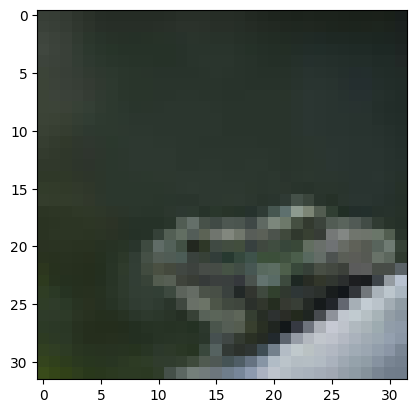

33


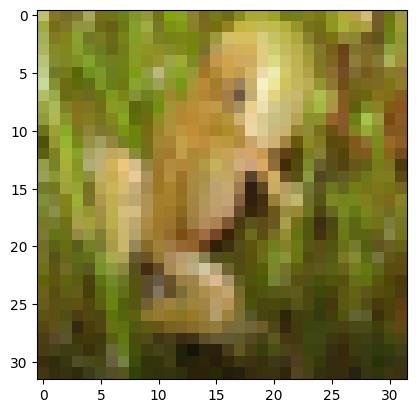

34


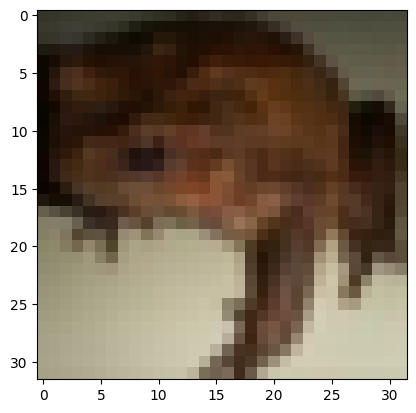

35


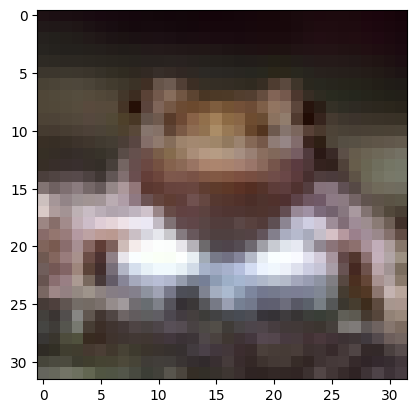

36


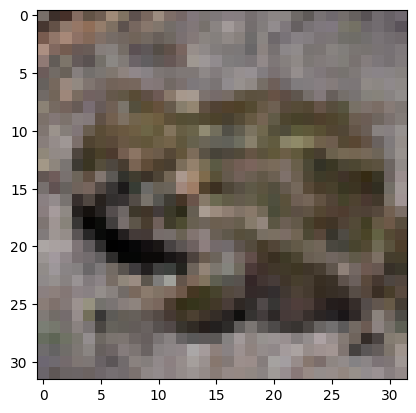

37


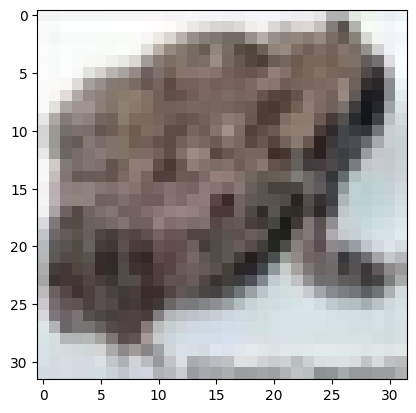

38


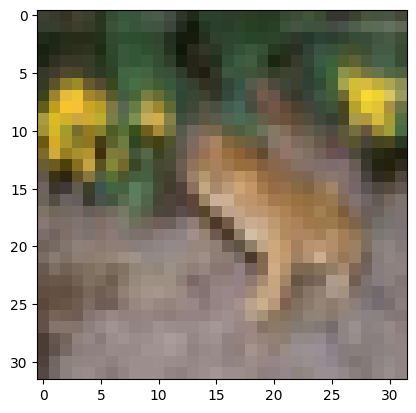

39


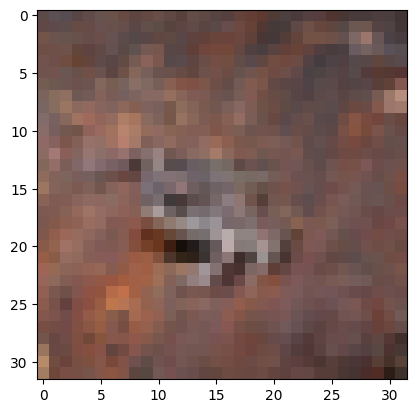

40


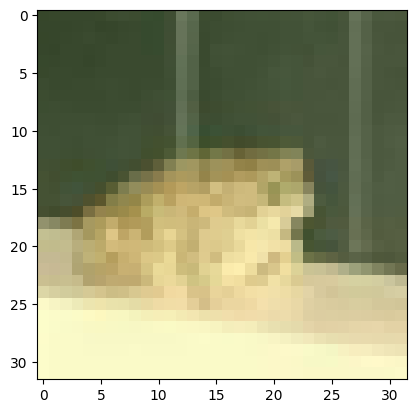

41


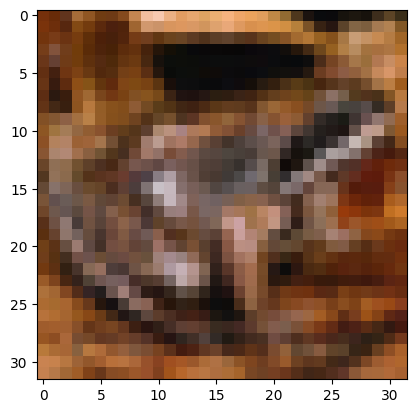

42


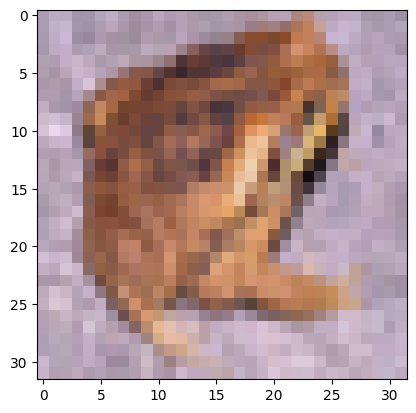

43


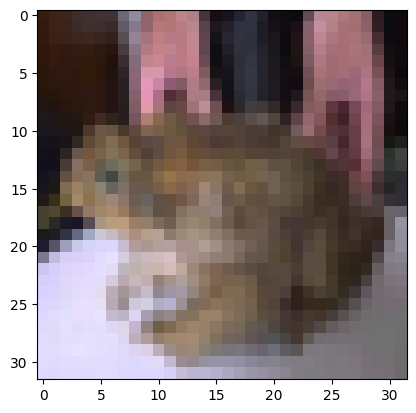

44


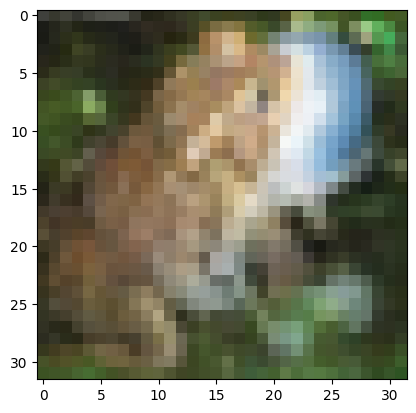

45


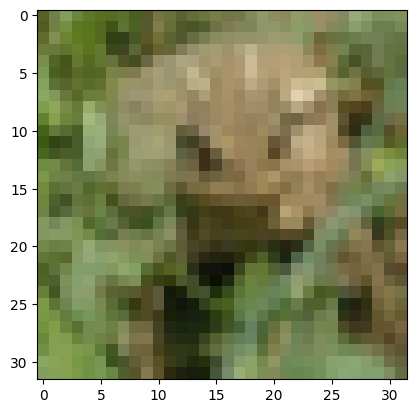

46


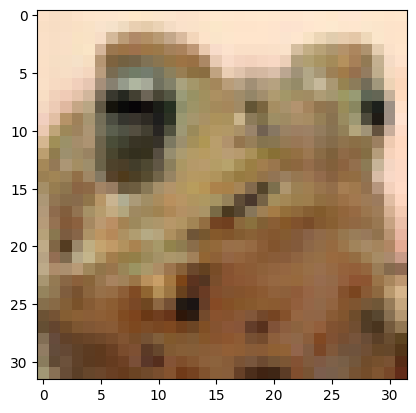

47


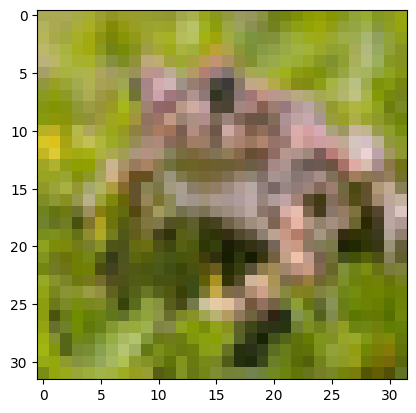

48


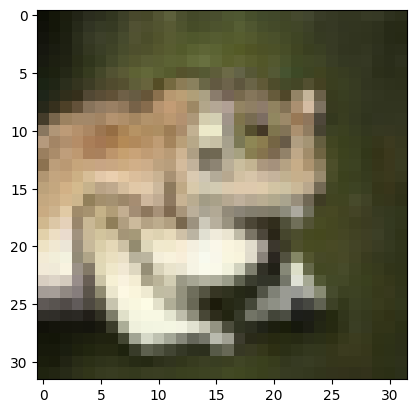

49


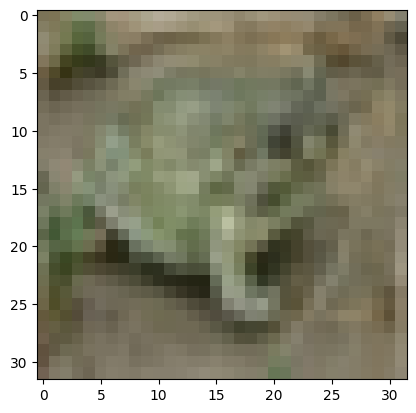

50


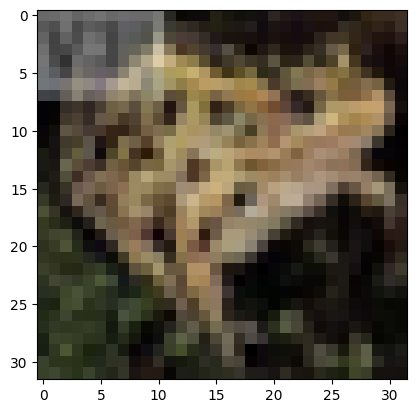

51


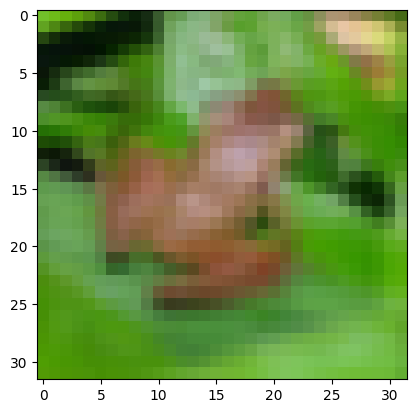

52


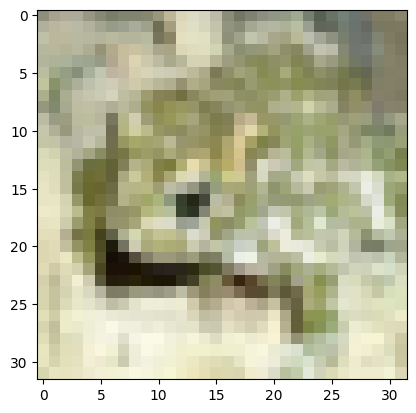

53


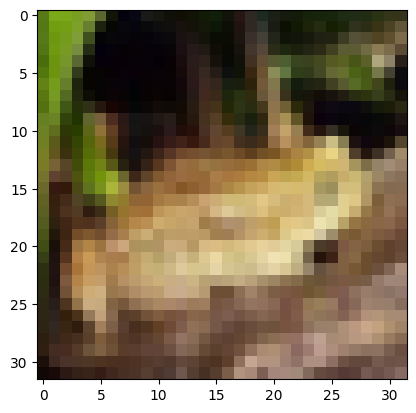

54


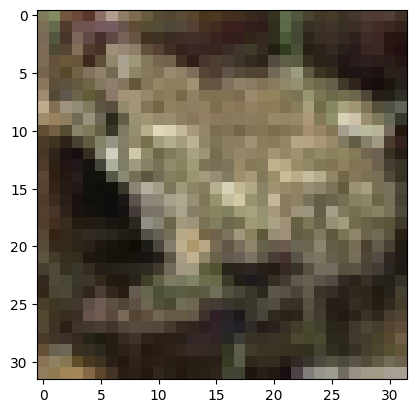

55


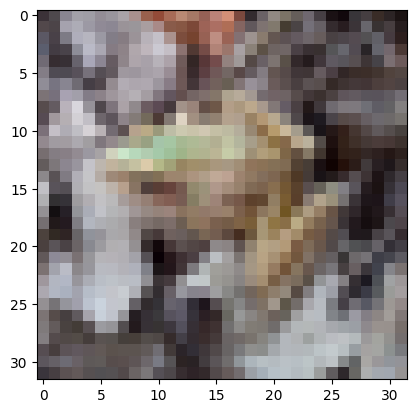

56


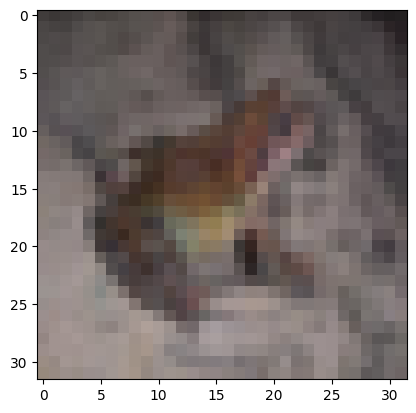

57


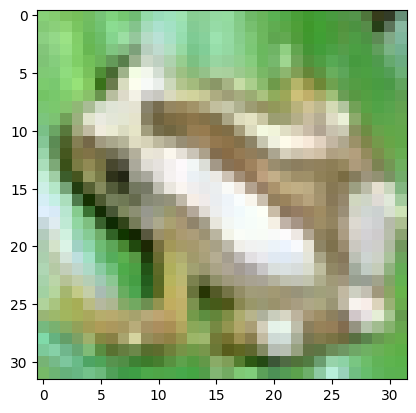

58


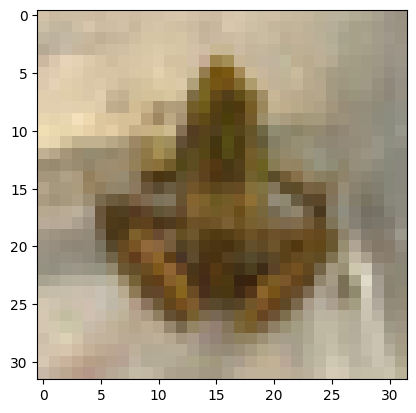

59


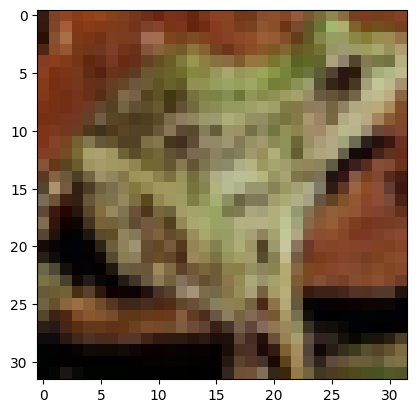

60


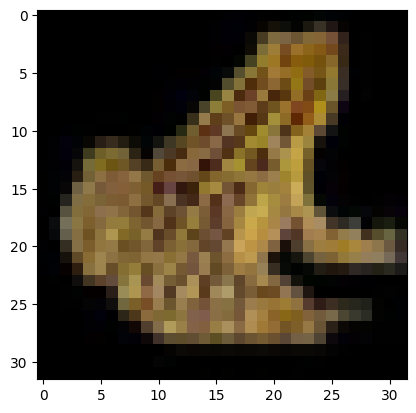

61


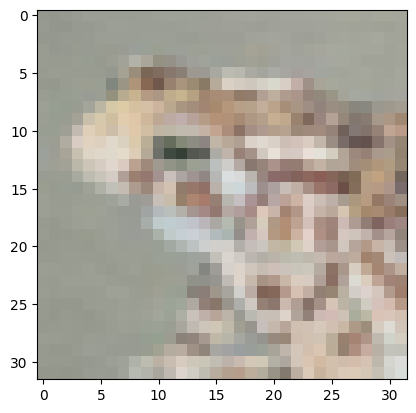

62


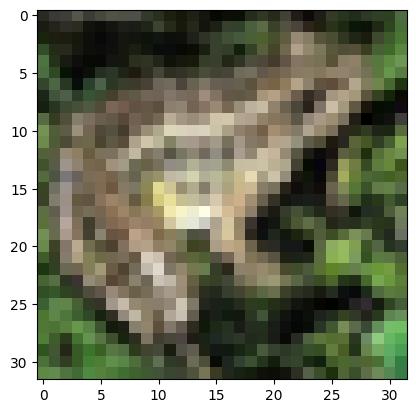

63


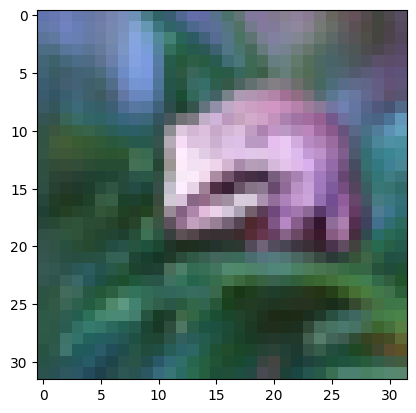

64


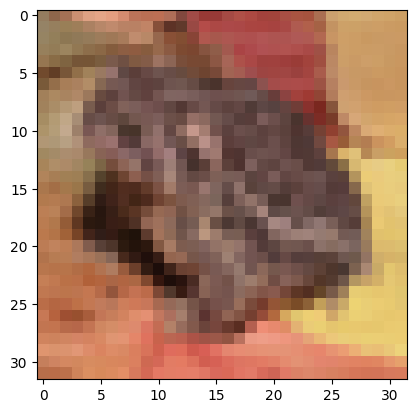

65


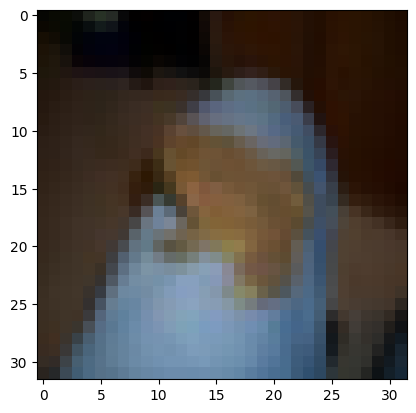

66


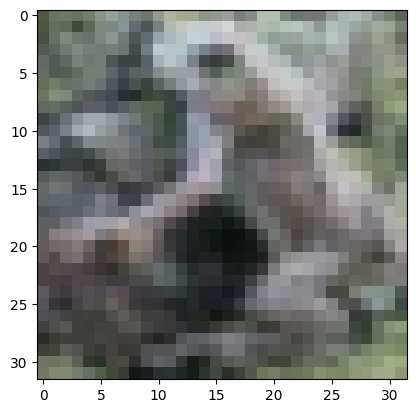

67


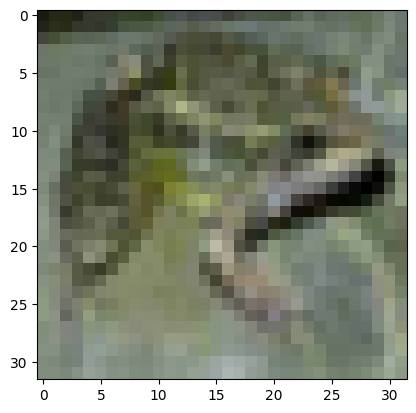

68


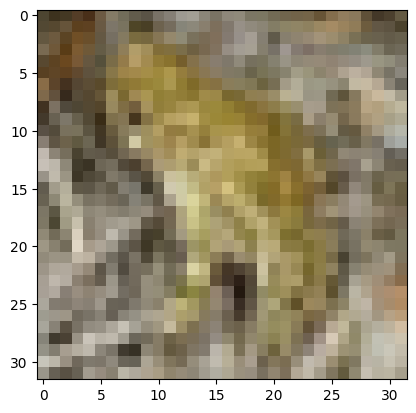

69


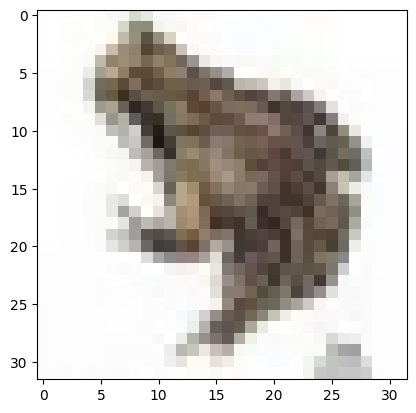

70


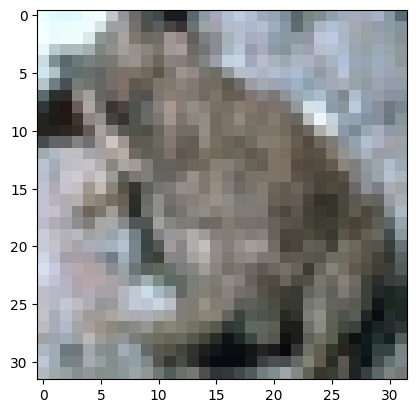

71


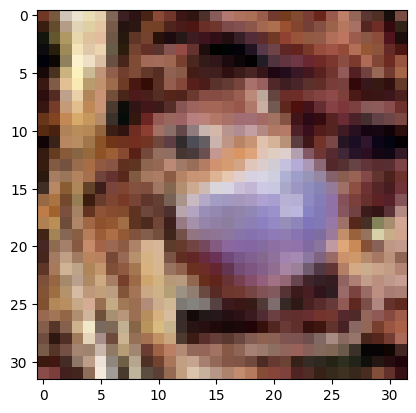

72


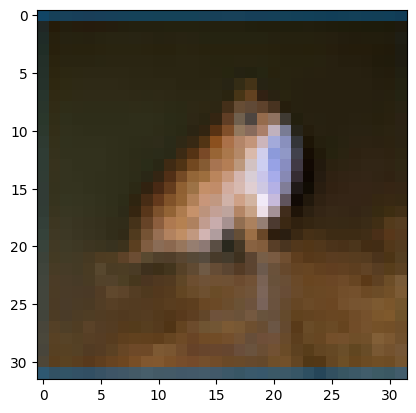

73


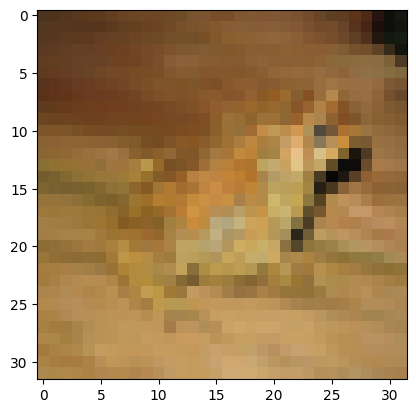

74


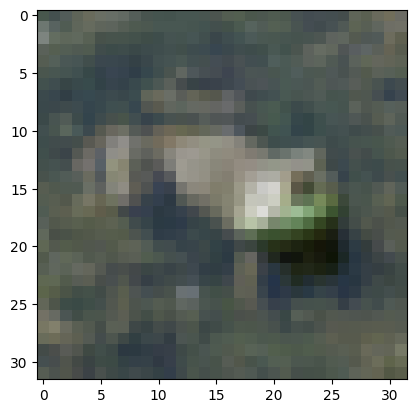

75


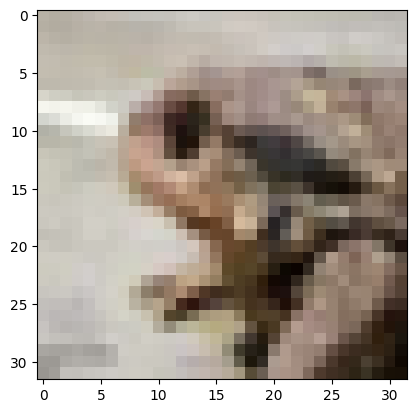

76


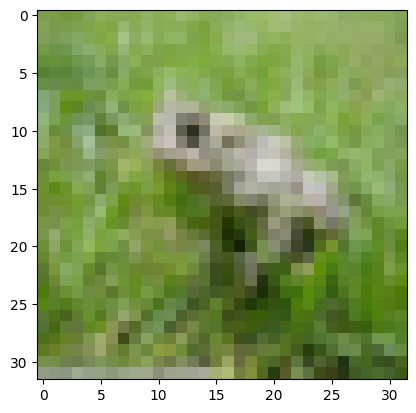

77


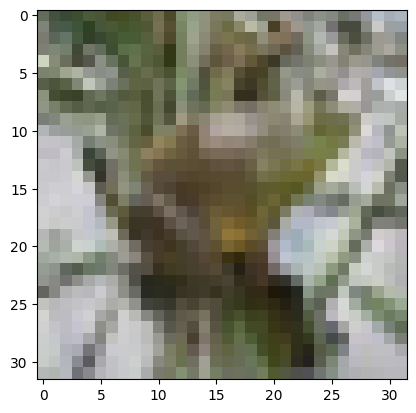

78


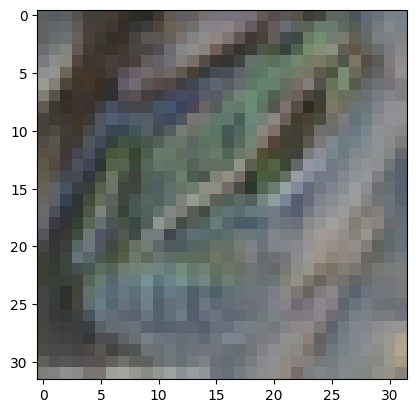

79


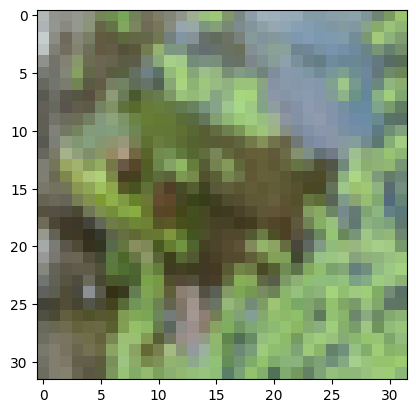

80


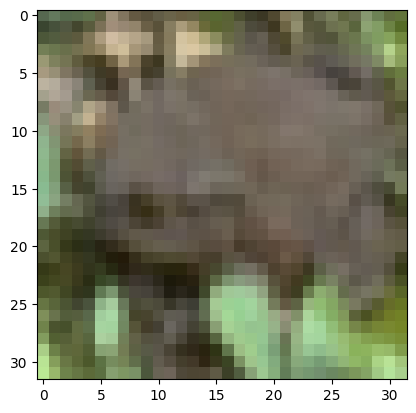

81


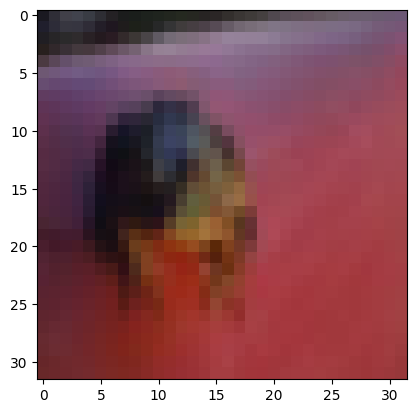

82


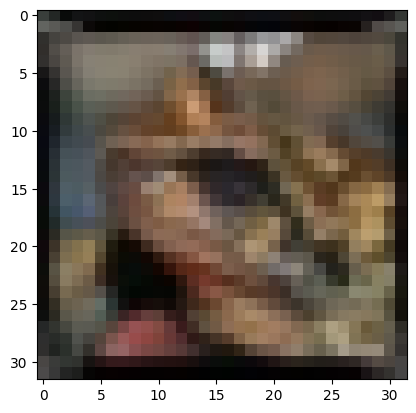

83


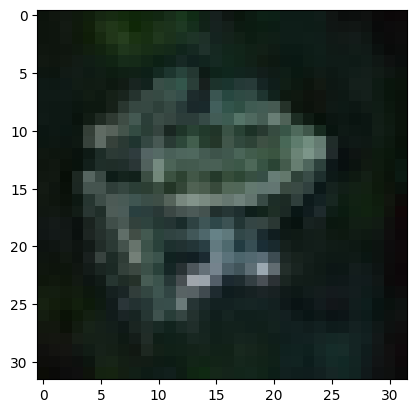

84


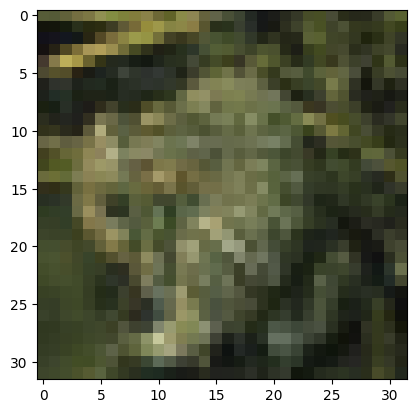

85


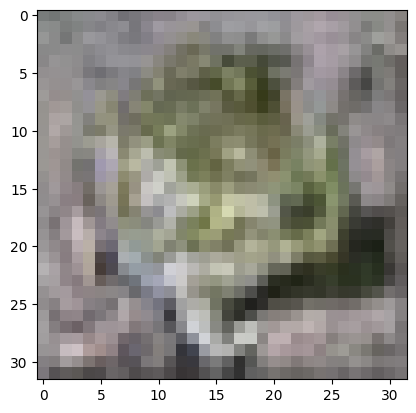

86


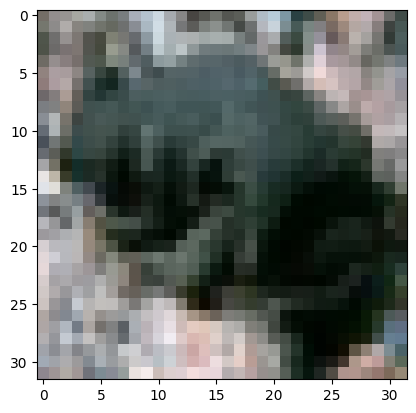

87


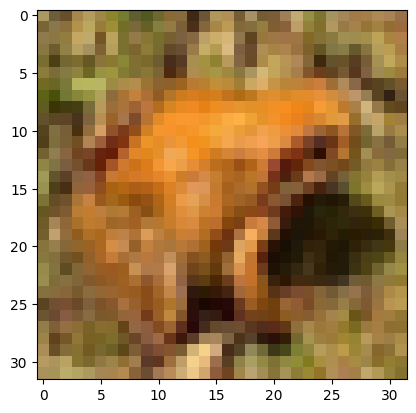

88


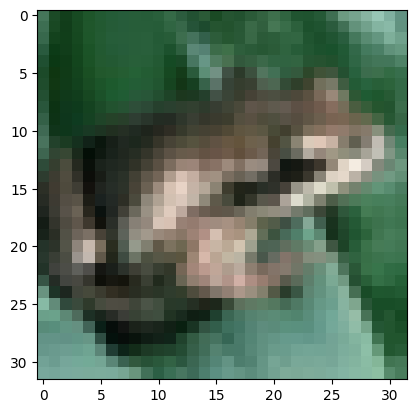

89


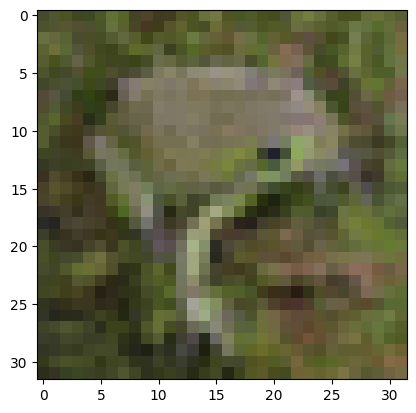

90


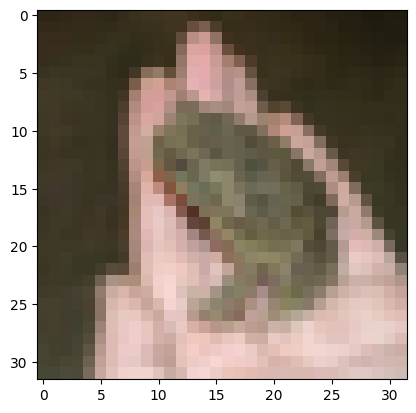

91


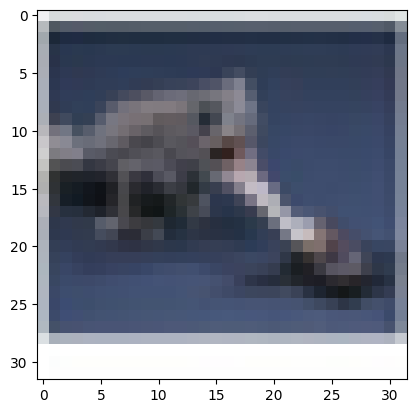

92


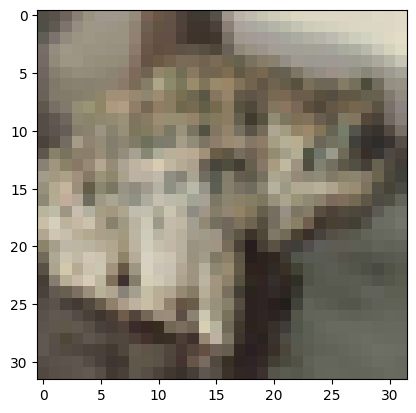

93


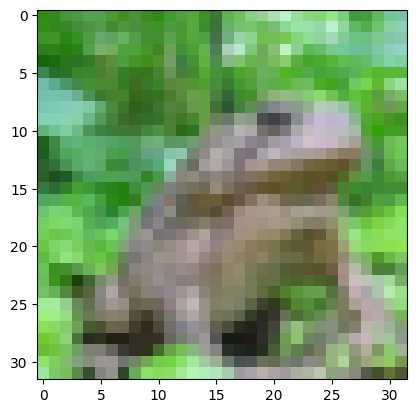

94


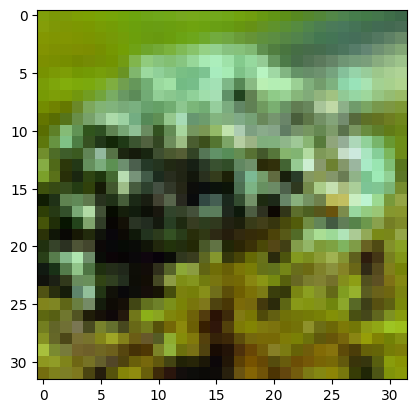

95


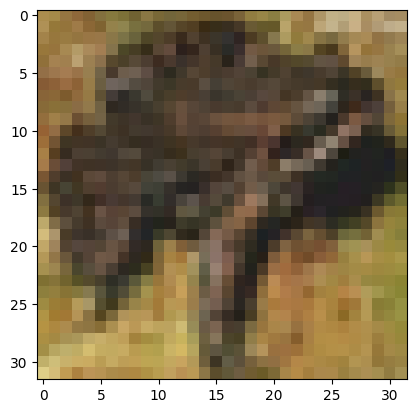

96


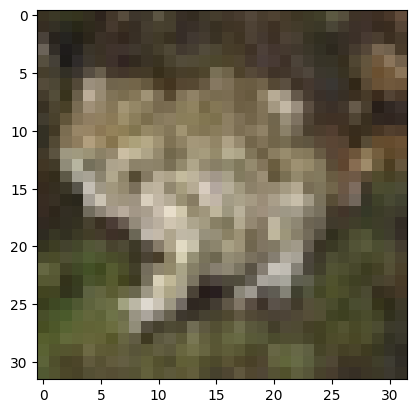

97


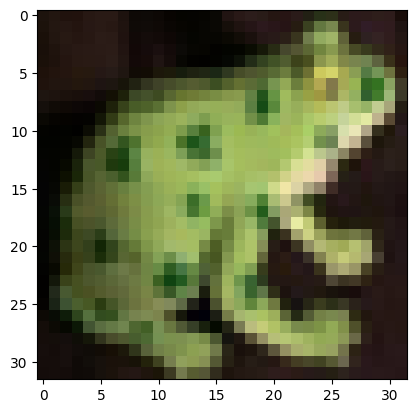

98


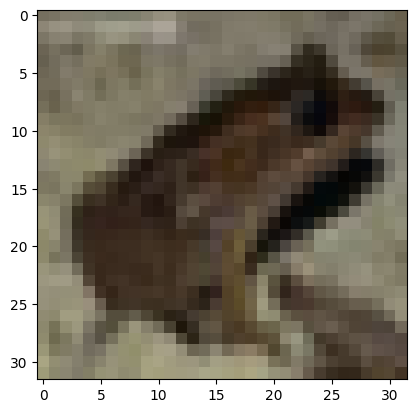

99


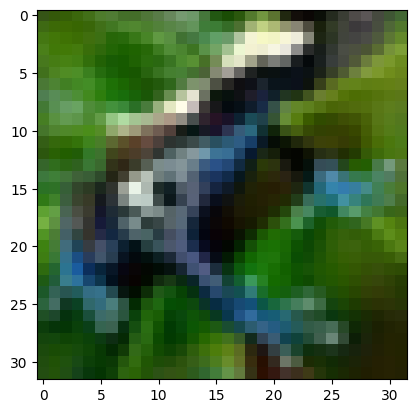

In [ ]:
# Load CIFAR-10
train_data = datasets.CIFAR10(root='./data', train=True, download=True)
clas = 6

# Get all ship images and labels
images6 = [img for img, label in train_data if label == clas]
#print(f"Number of 1 images: {len(ship_images)}")  # Output: 5000 (train)

for i in range(100):
  print(i)
  plt.imshow(images6[i])
  plt.show()

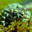

In [ ]:
images6[94]

### 7

0


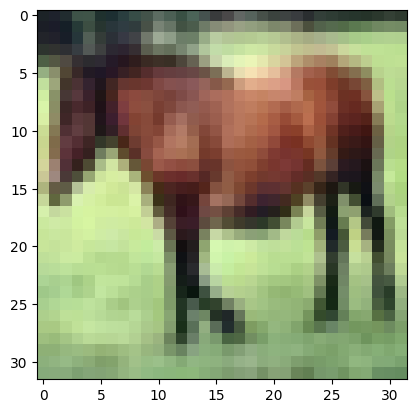

1


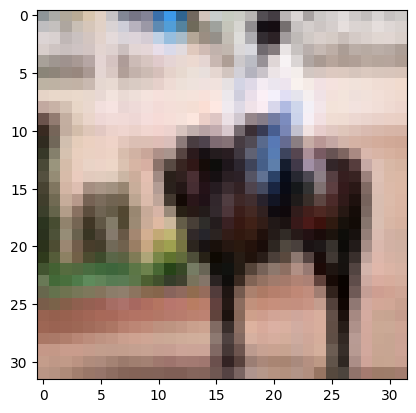

2


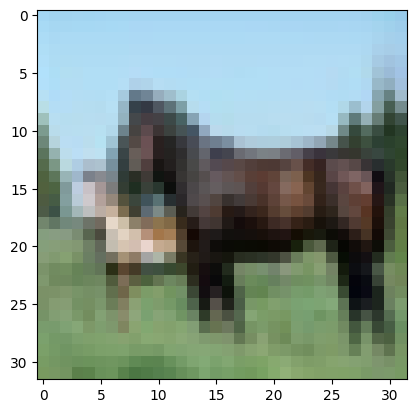

3


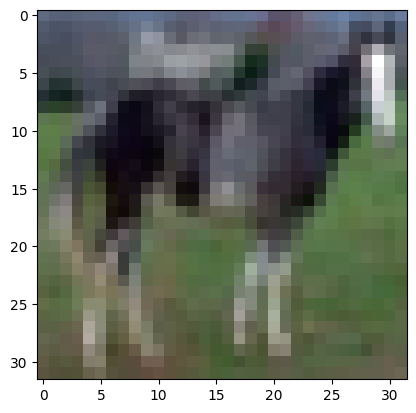

4


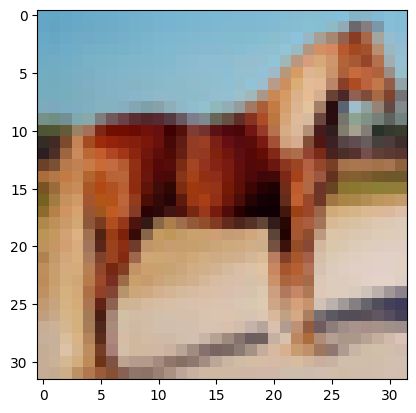

5


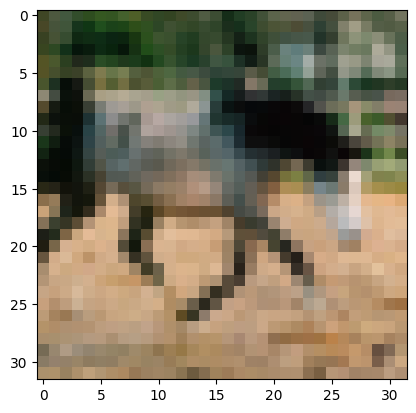

6


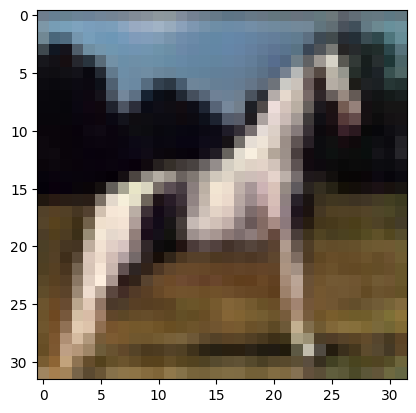

7


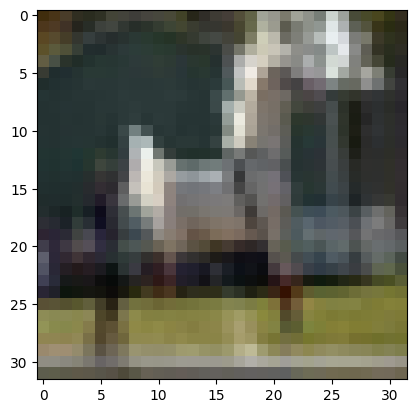

8


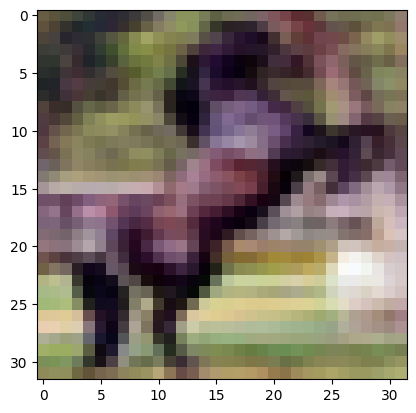

9


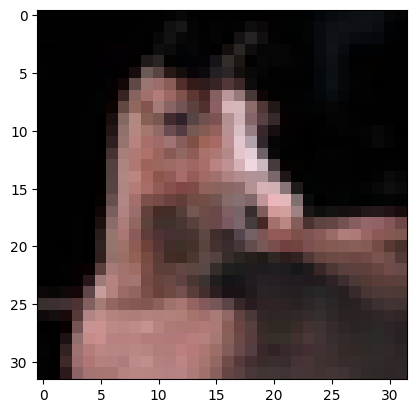

10


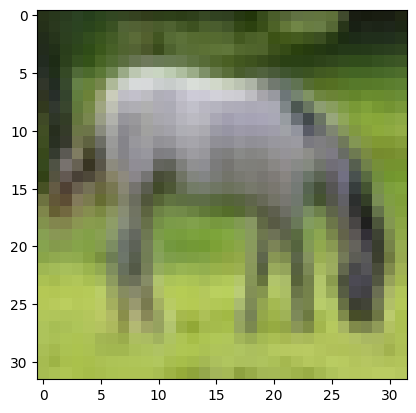

11


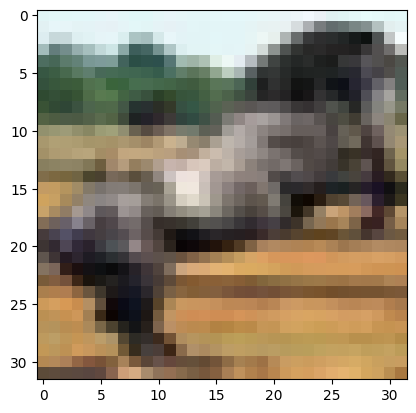

12


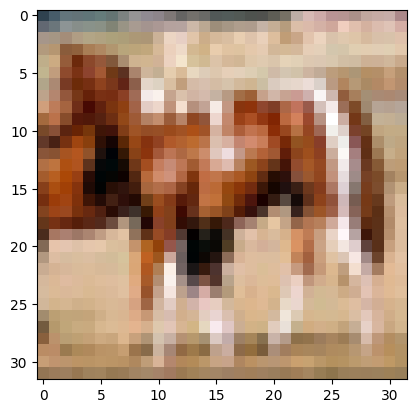

13


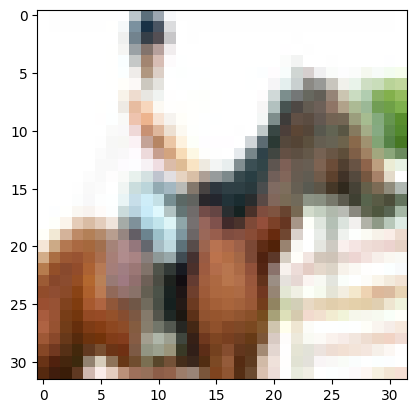

14


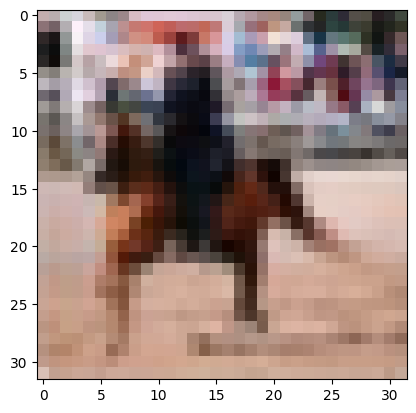

15


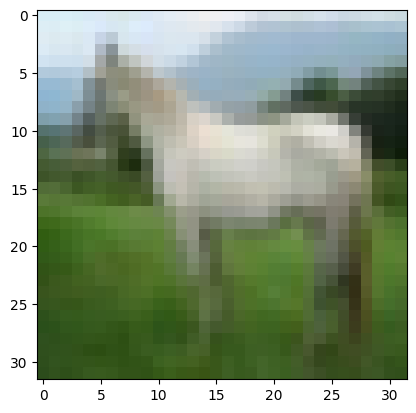

16


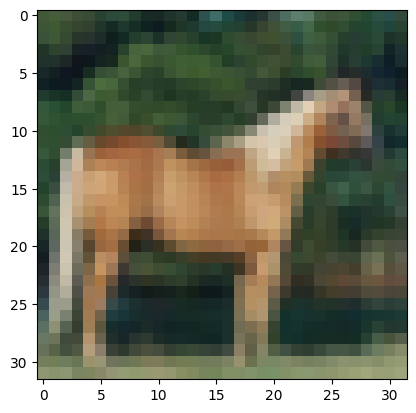

17


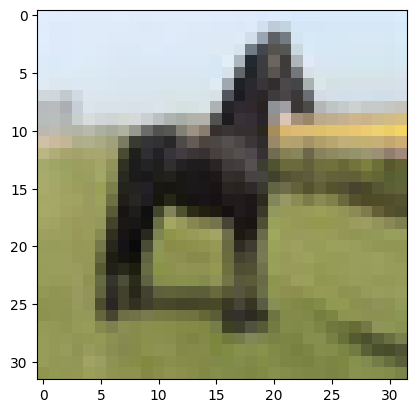

18


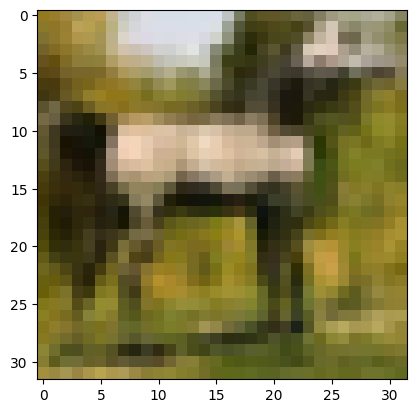

19


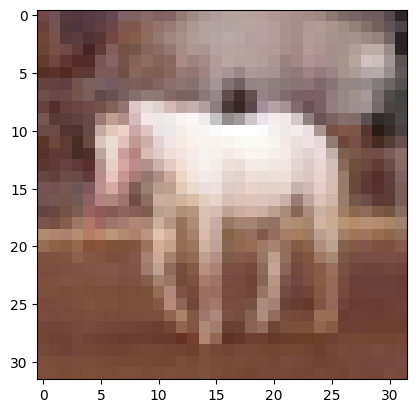

20


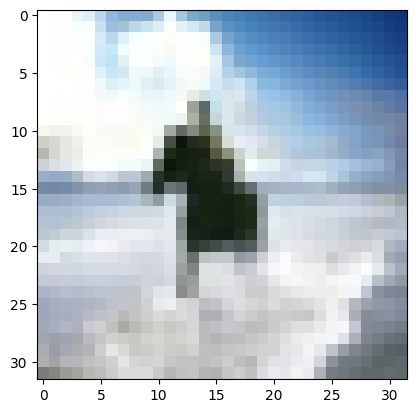

21


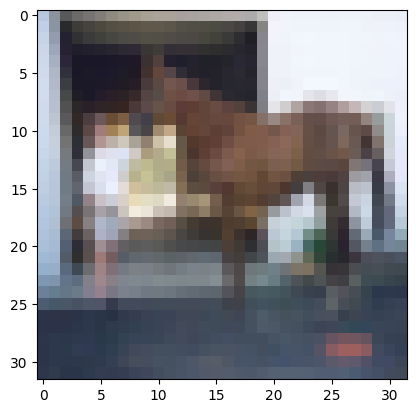

22


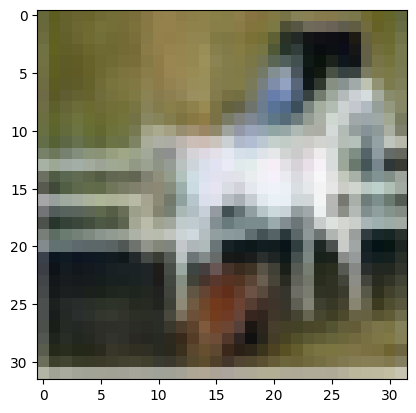

23


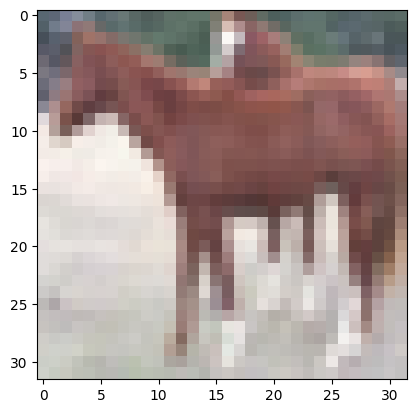

24


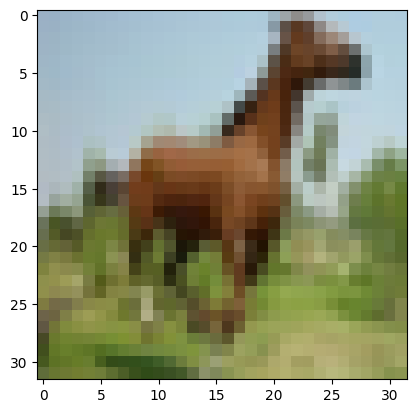

25


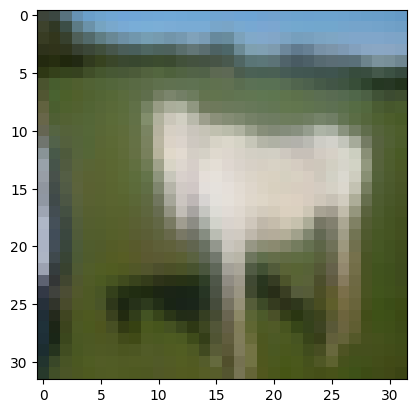

26


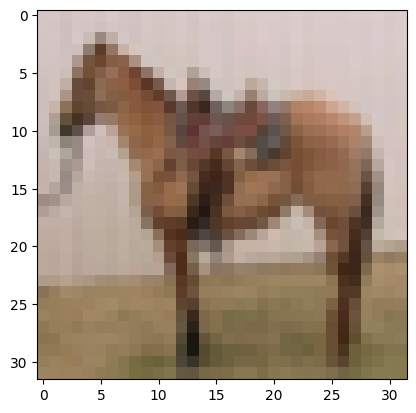

27


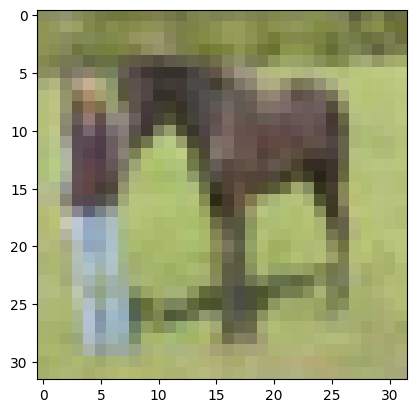

28


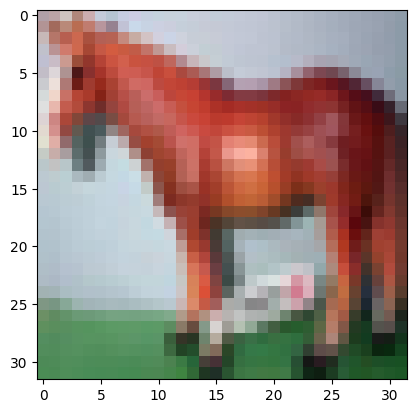

29


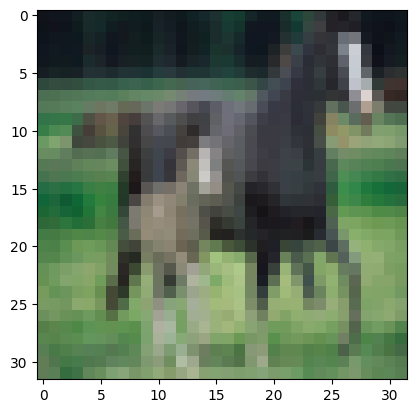

30


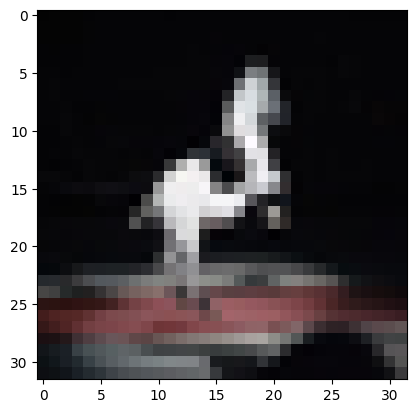

31


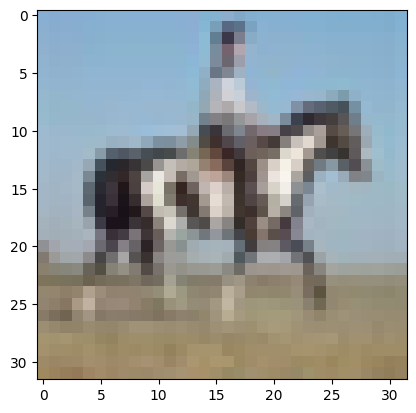

32


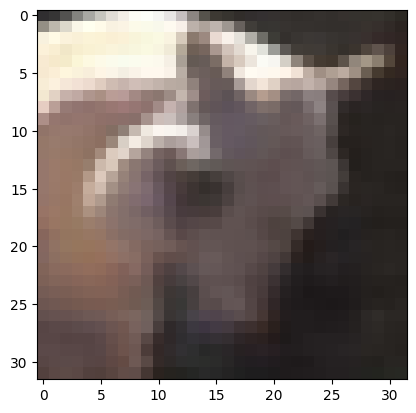

33


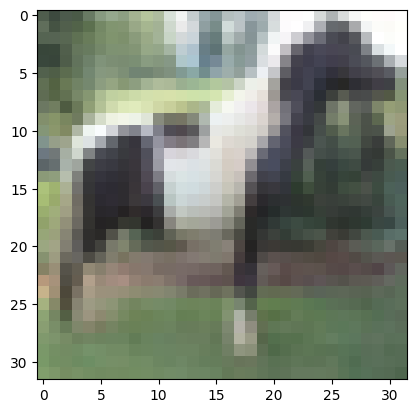

34


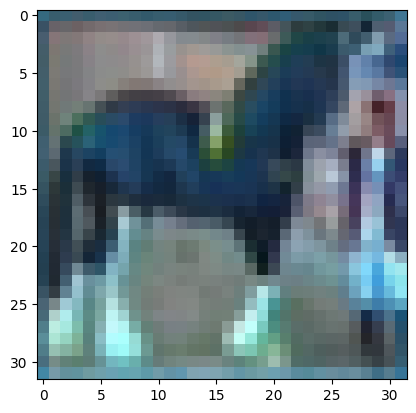

35


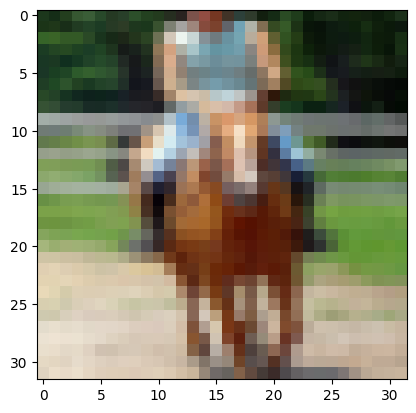

36


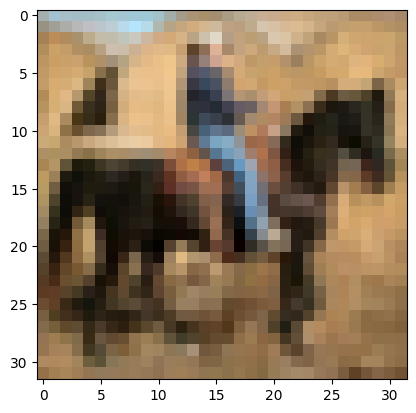

37


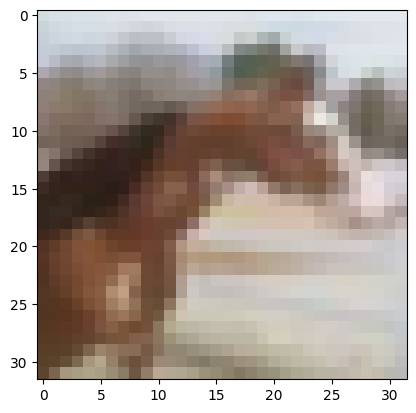

38


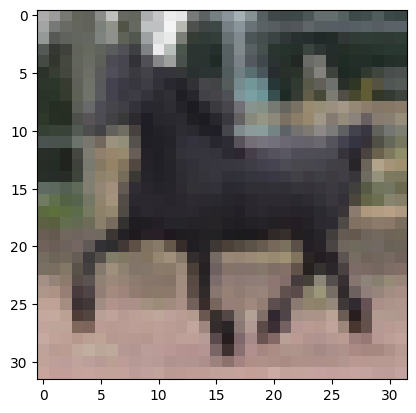

39


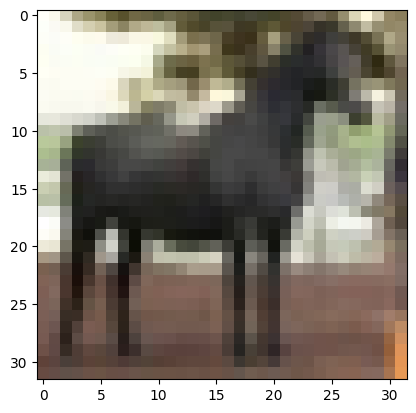

40


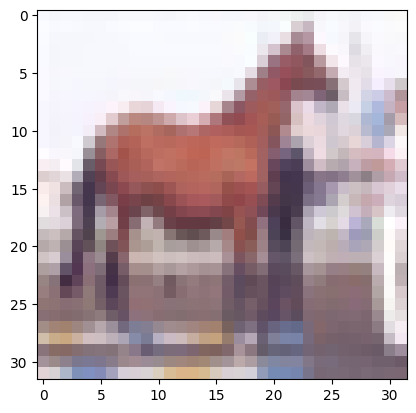

41


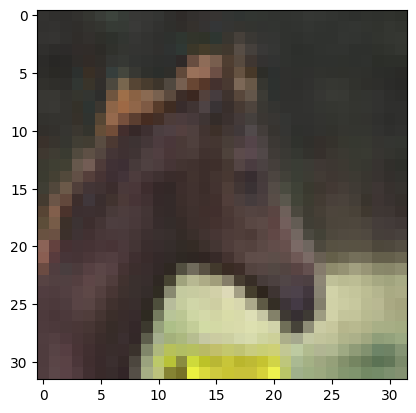

42


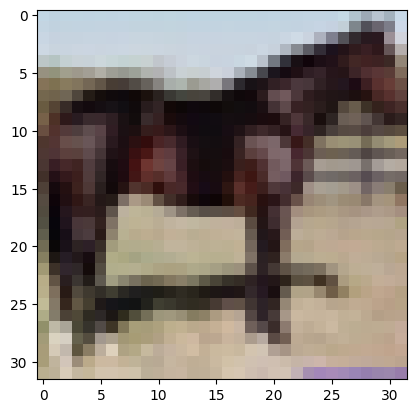

43


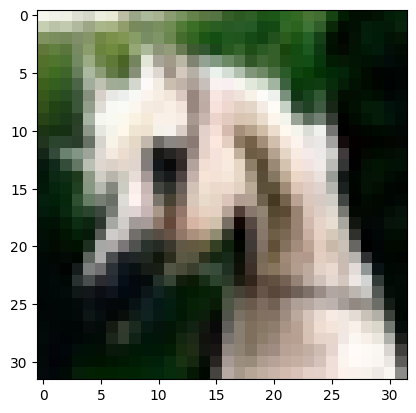

44


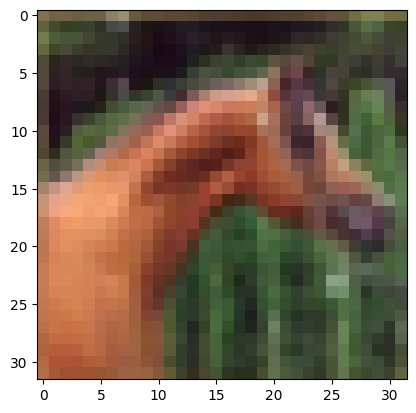

45


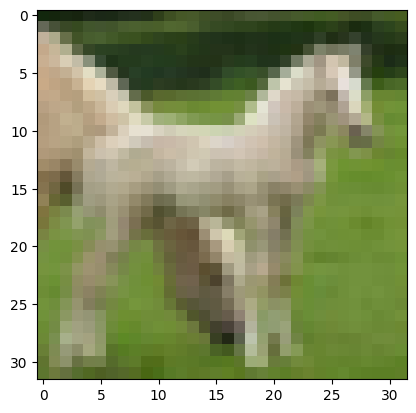

46


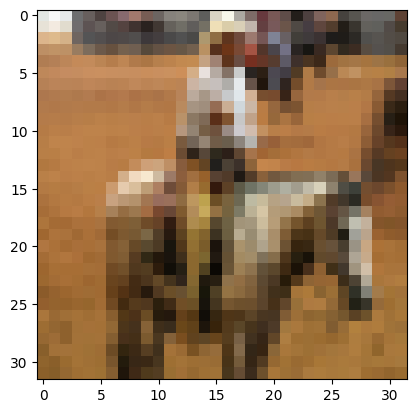

47


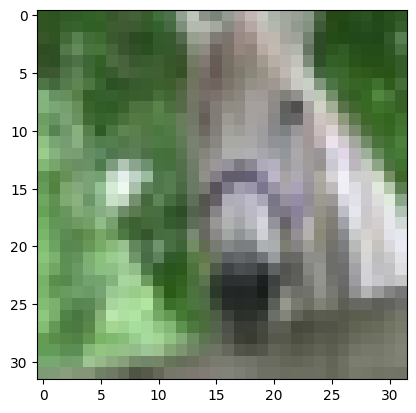

48


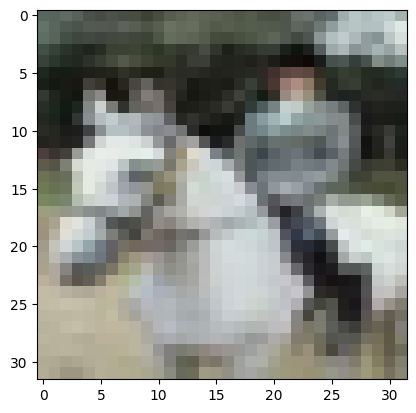

49


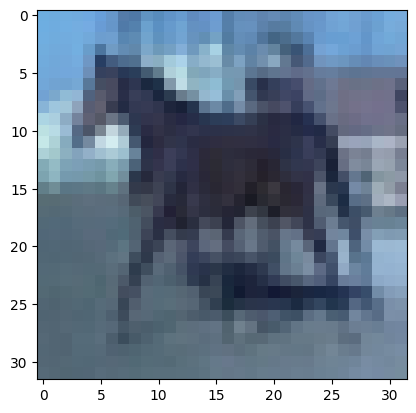

50


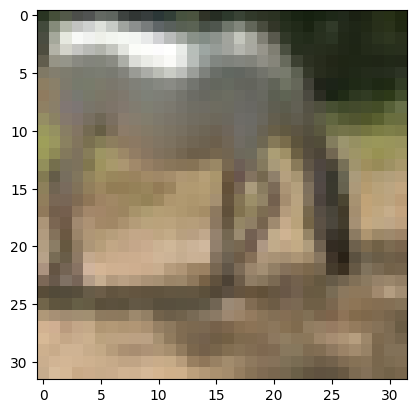

51


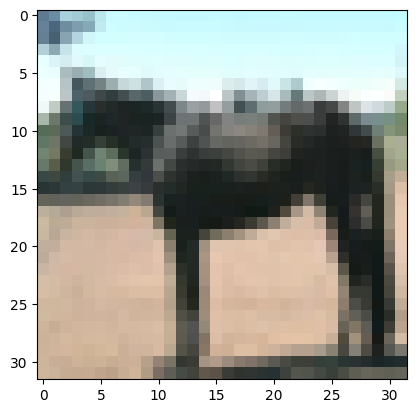

52


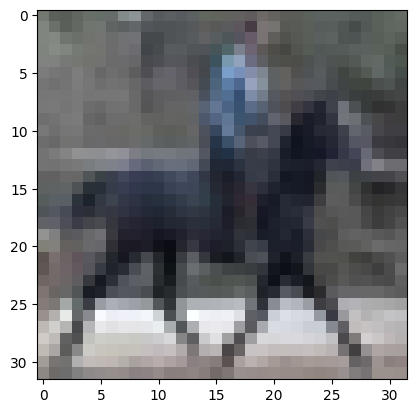

53


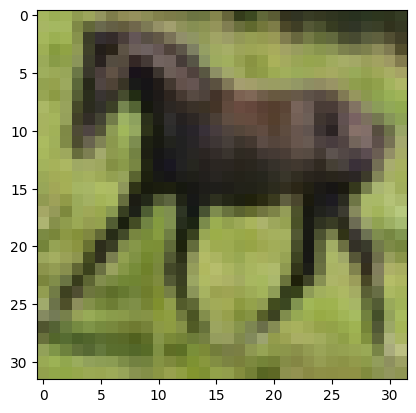

54


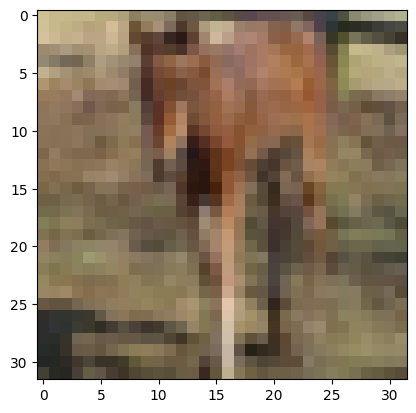

55


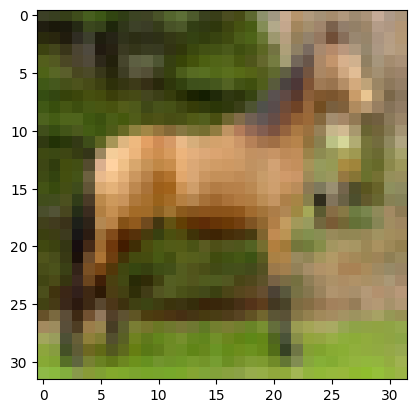

56


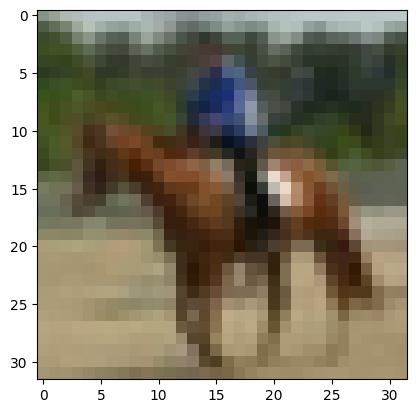

57


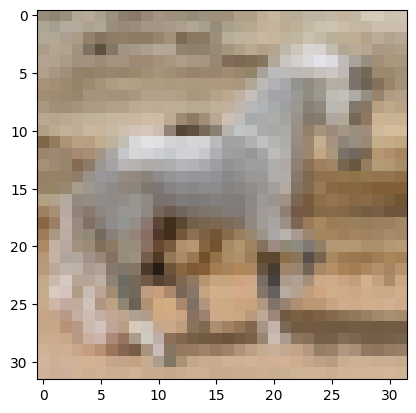

58


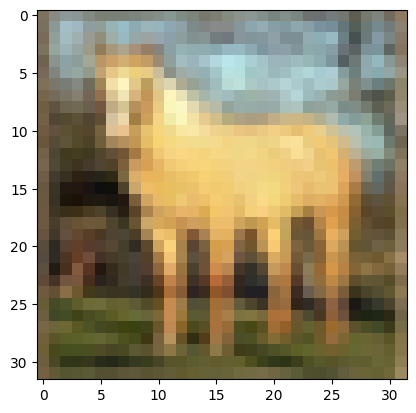

59


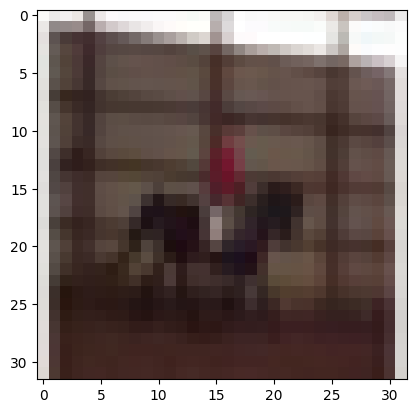

60


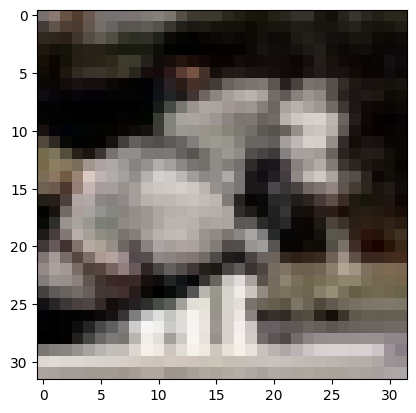

61


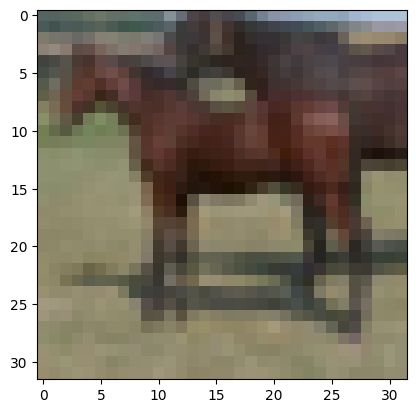

62


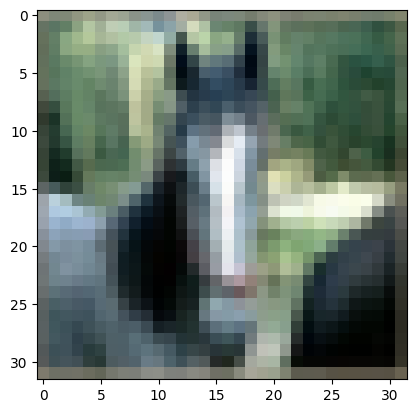

63


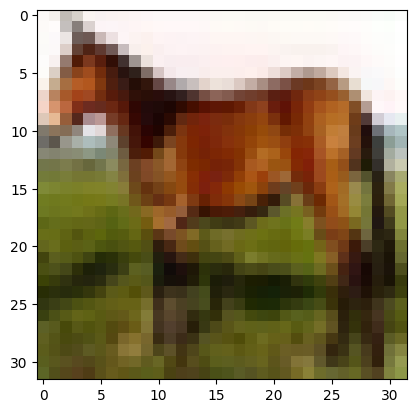

64


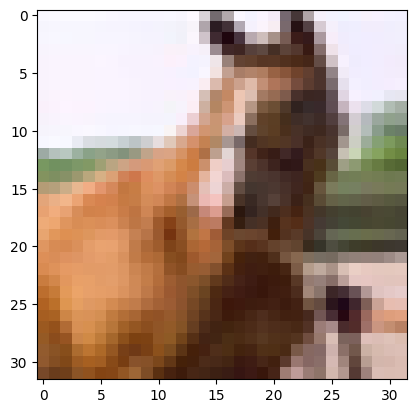

65


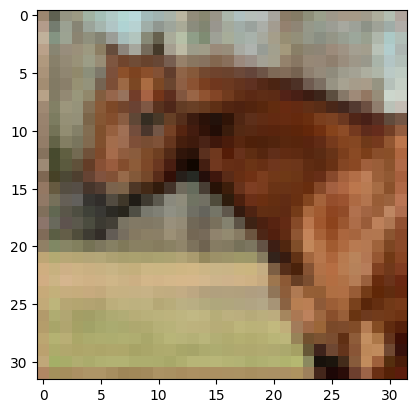

66


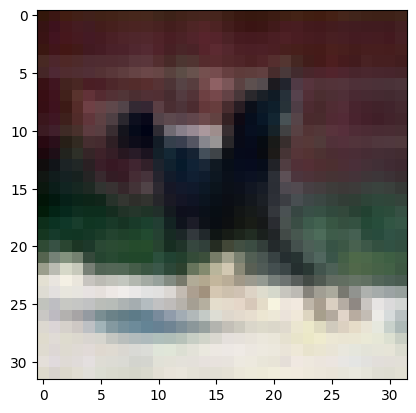

67


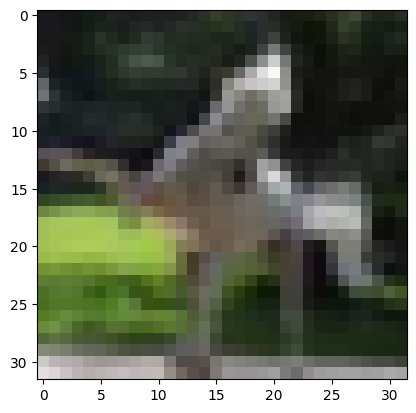

68


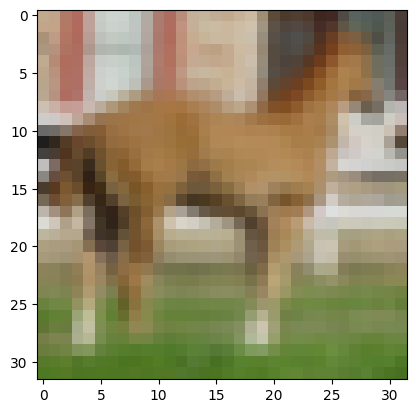

69


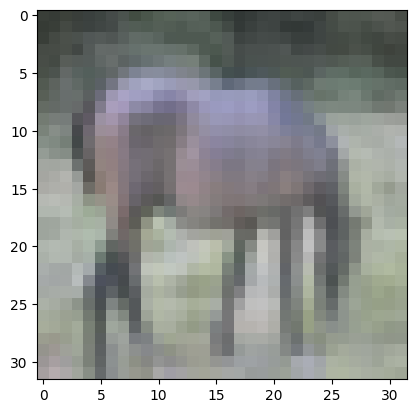

70


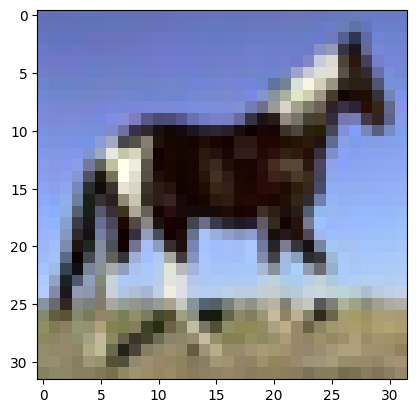

71


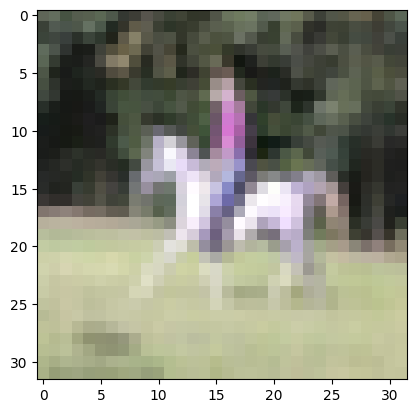

72


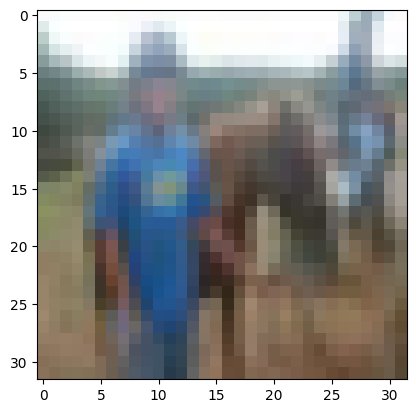

73


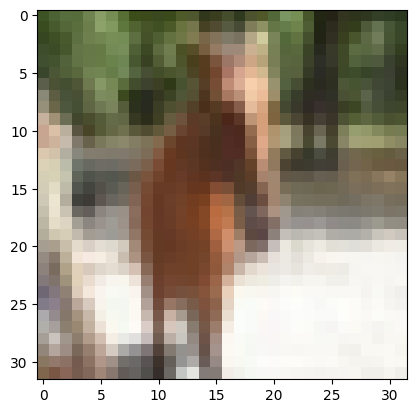

74


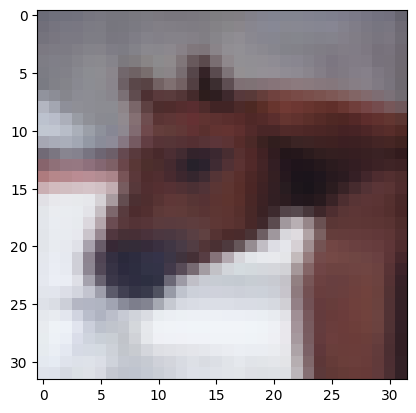

75


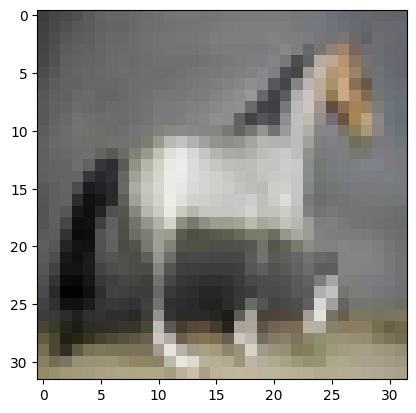

76


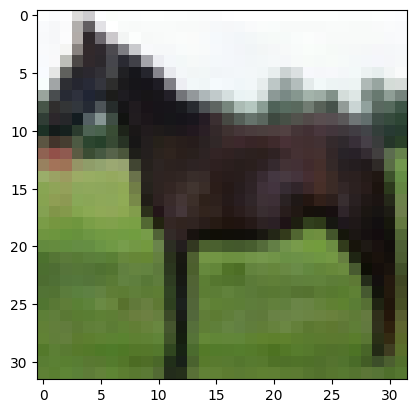

77


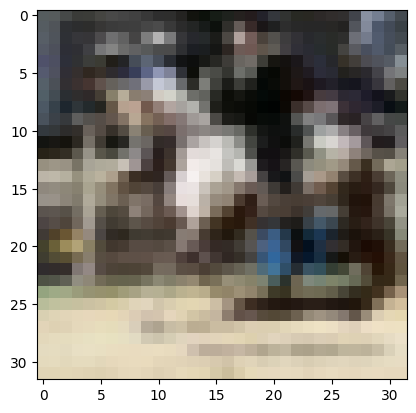

78


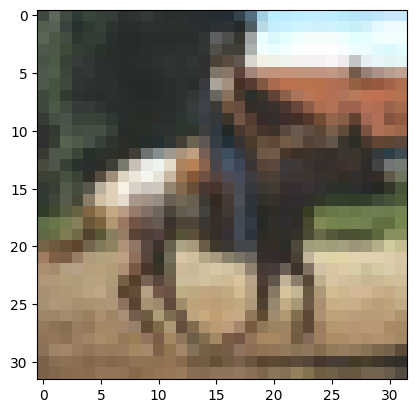

79


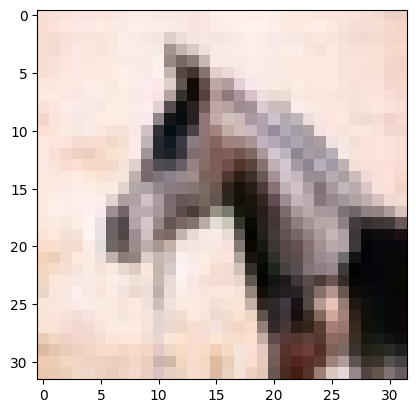

80


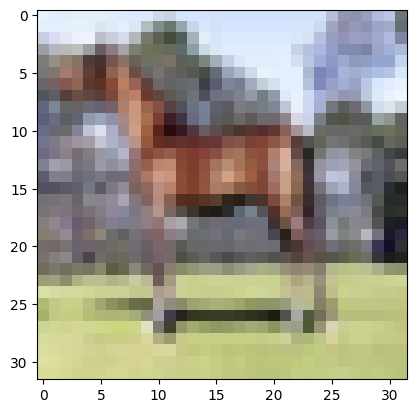

81


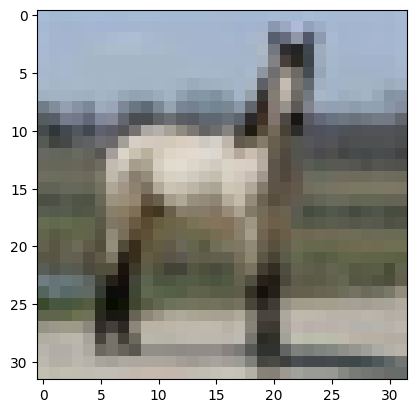

82


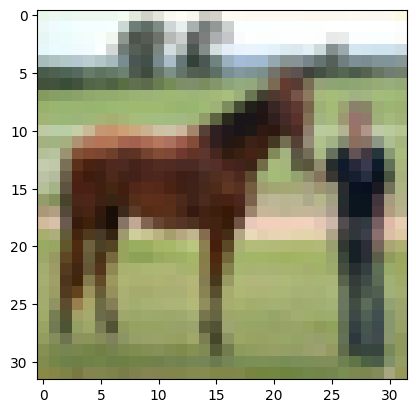

83


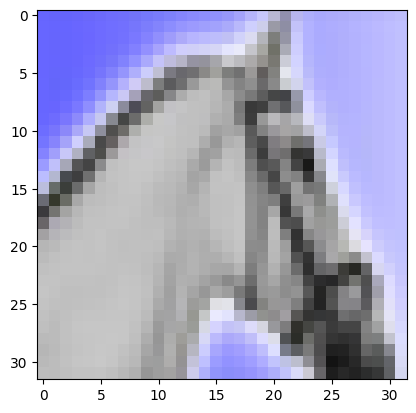

84


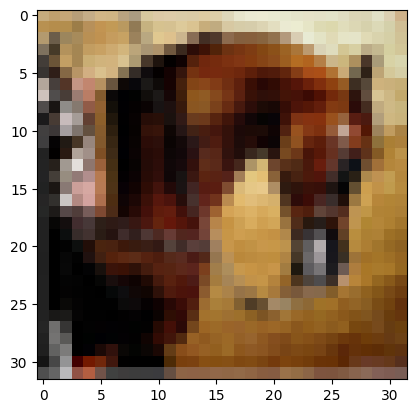

85


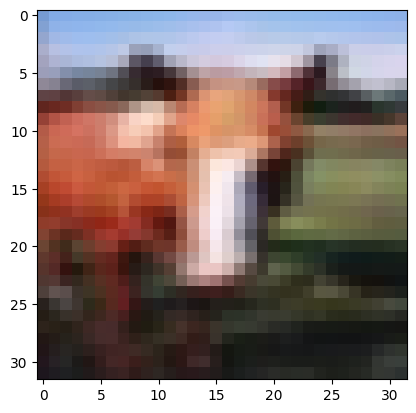

86


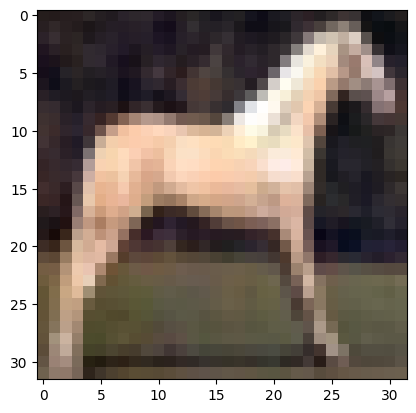

87


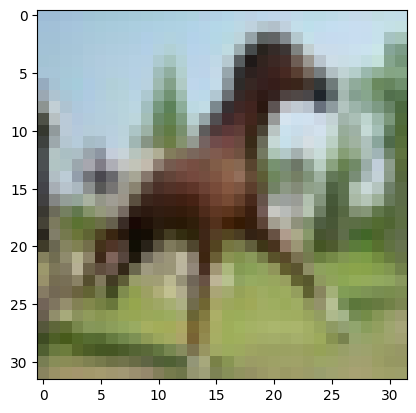

88


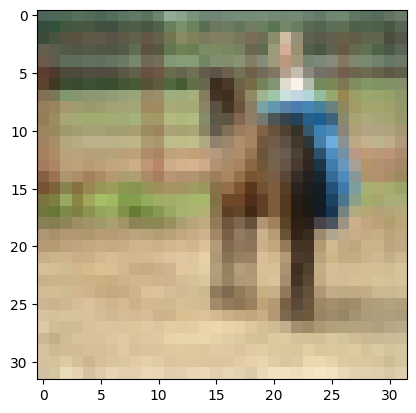

89


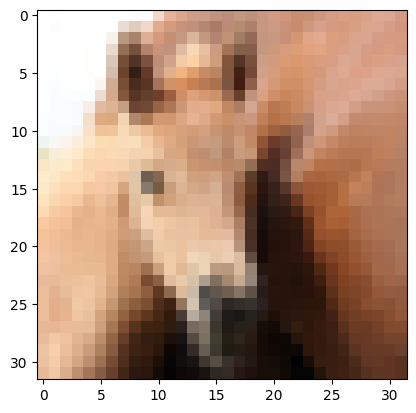

90


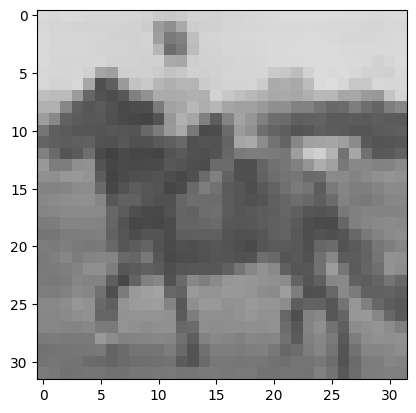

91


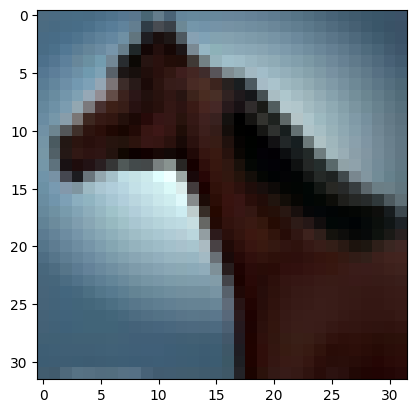

92


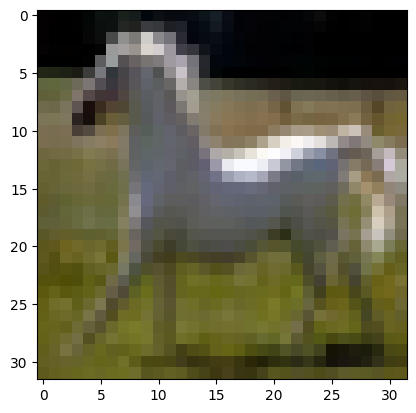

93


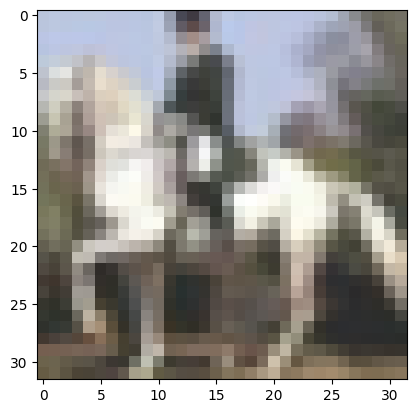

94


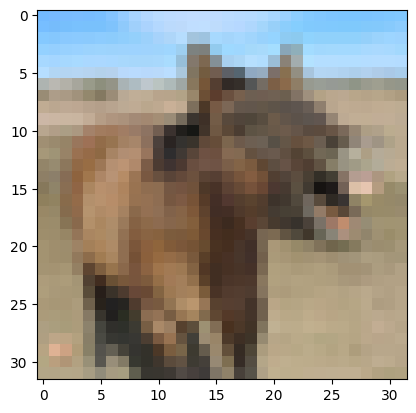

95


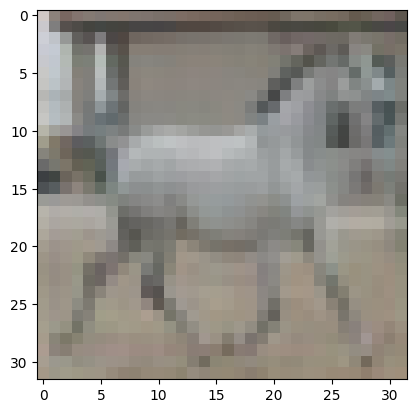

96


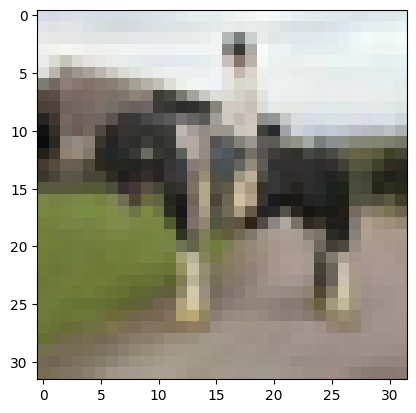

97


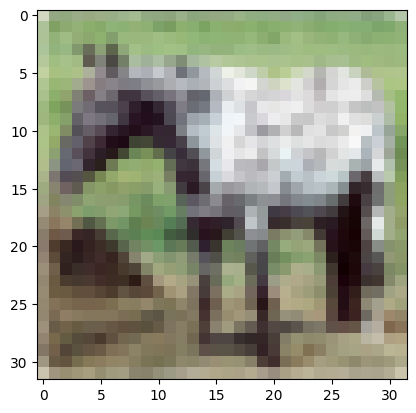

98


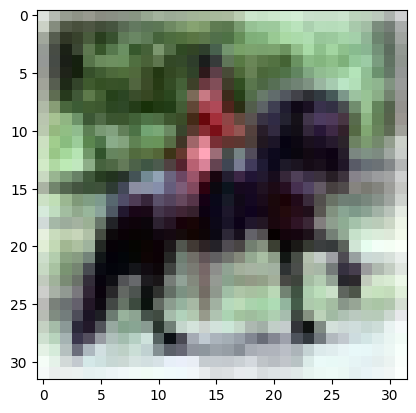

99


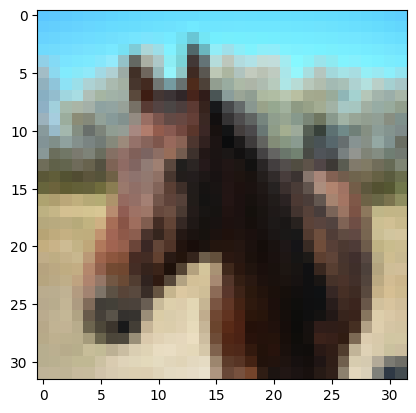

In [ ]:
# Load CIFAR-10
train_data = datasets.CIFAR10(root='./data', train=True, download=True)
clas = 7

# Get all ship images and labels
images7 = [img for img, label in train_data if label == clas]
#print(f"Number of 1 images: {len(ship_images)}")  # Output: 5000 (train)

for i in range(100):
  print(i)
  plt.imshow(images7[i])
  plt.show()

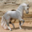

In [ ]:
images7[57]

### 8

In [ ]:

# Load CIFAR-10
train_data = datasets.CIFAR10(root='./data', train=True, download=True)
ship_class = 8

# Get all ship images and labels
images8 = [img for img, label in train_data if label == ship_class]
print(f"Number of ship images: {len(ship_images)}")  # Output: 5000 (train)

NameError: name 'ship_images' is not defined

0


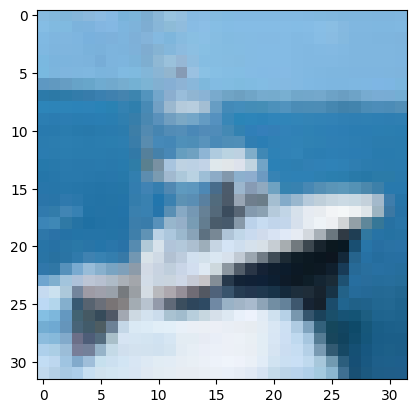

1


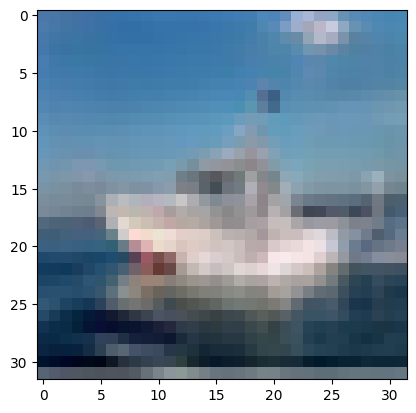

2


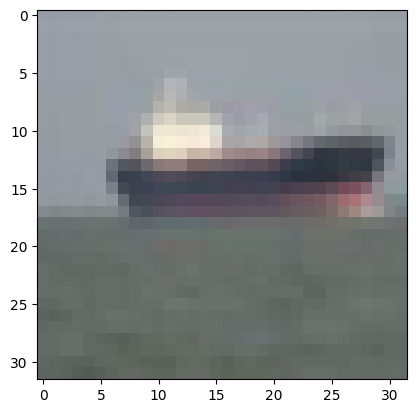

3


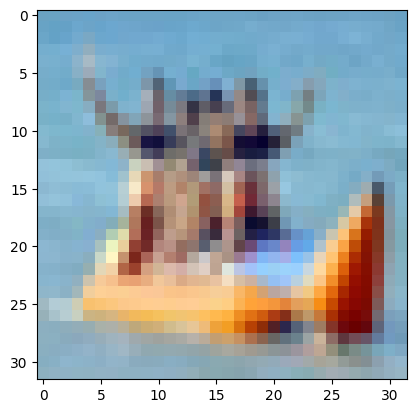

4


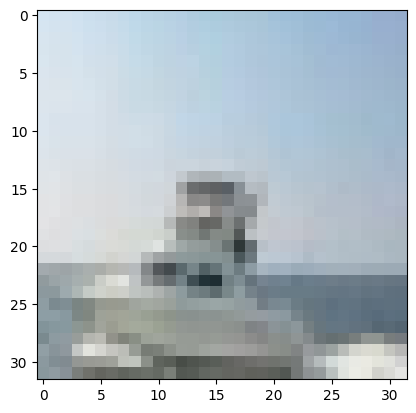

5


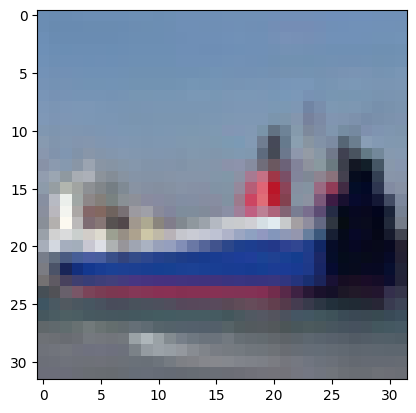

6


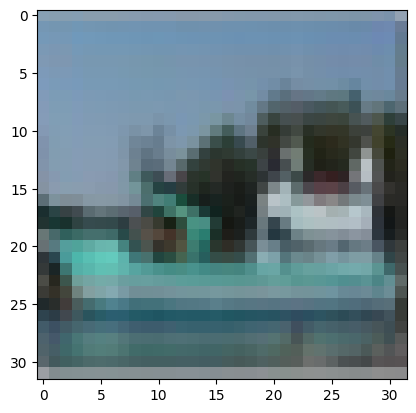

7


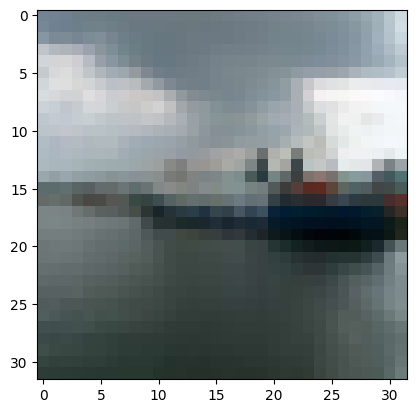

8


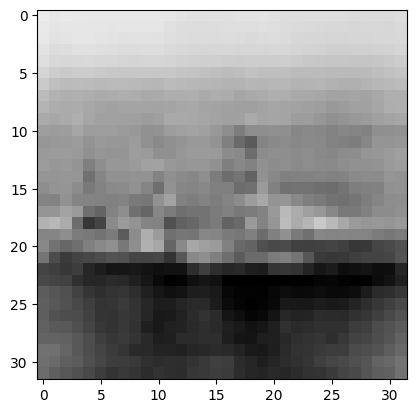

9


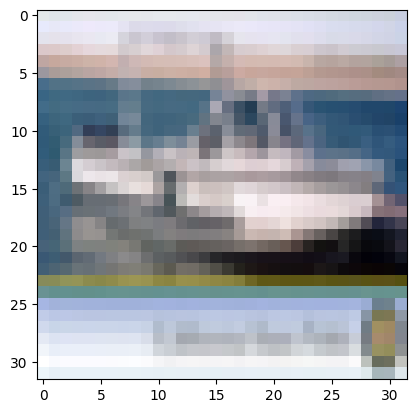

10


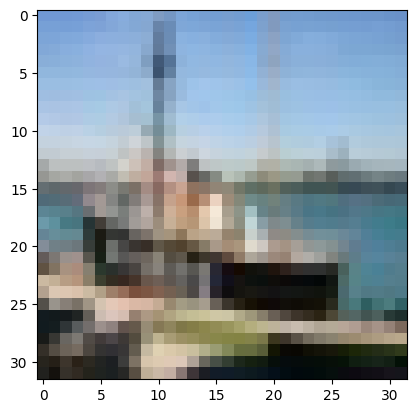

11


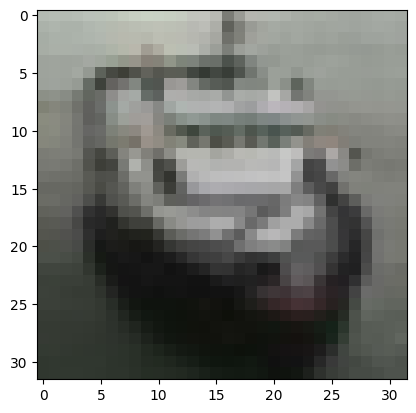

12


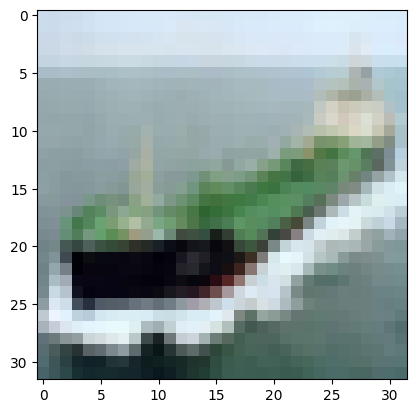

13


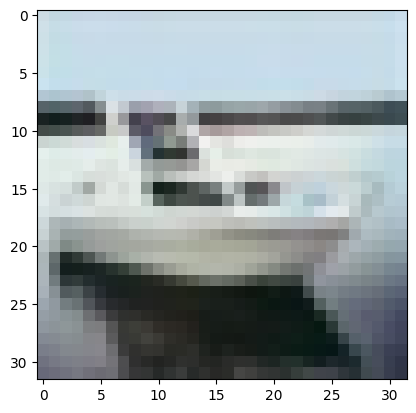

14


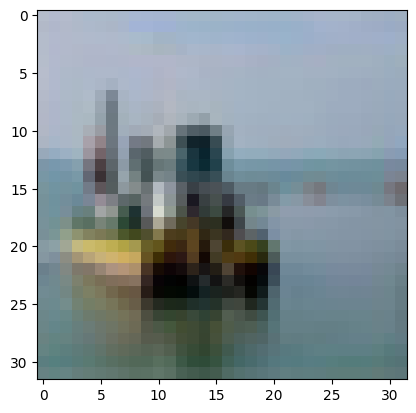

15


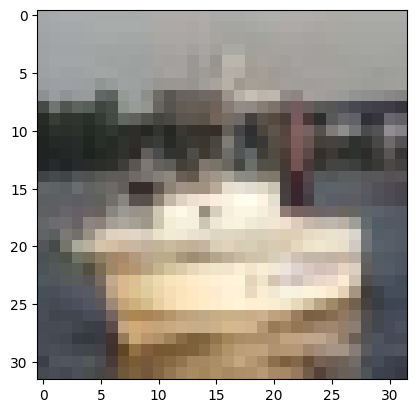

16


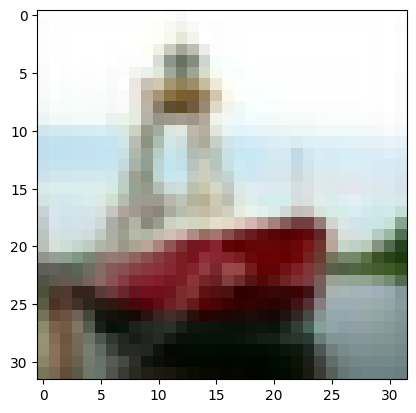

17


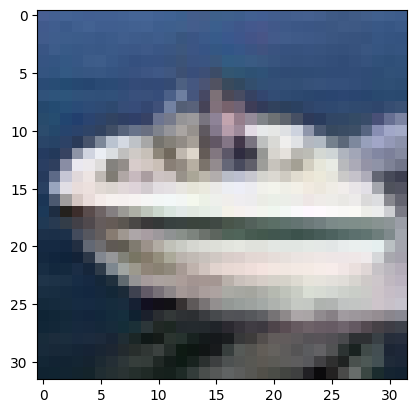

18


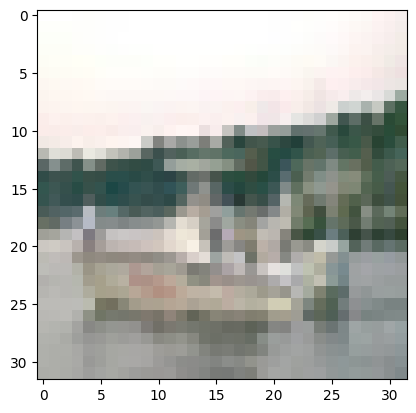

19


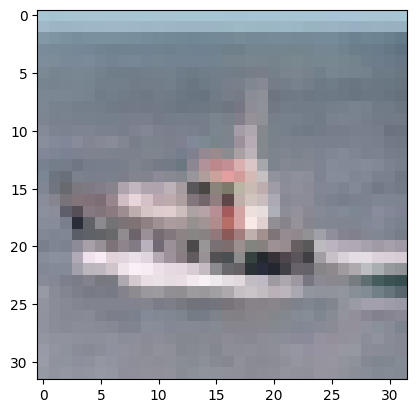

20


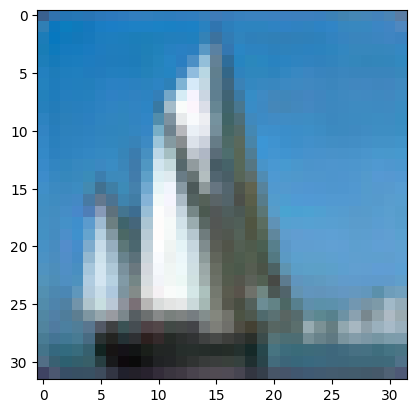

21


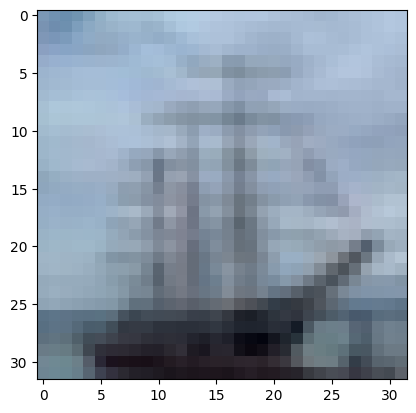

22


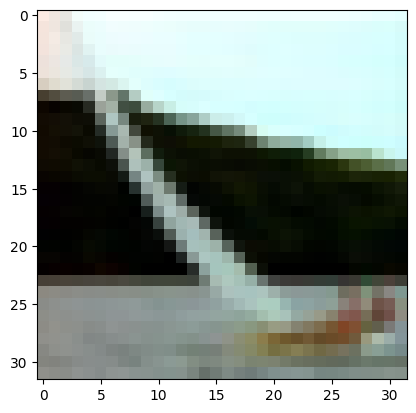

23


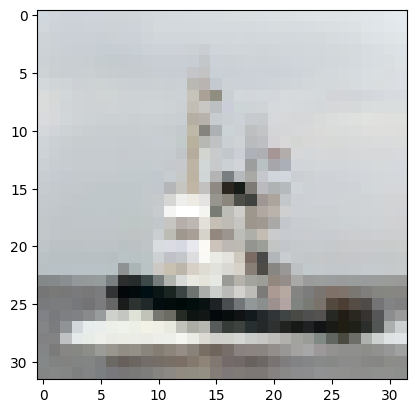

24


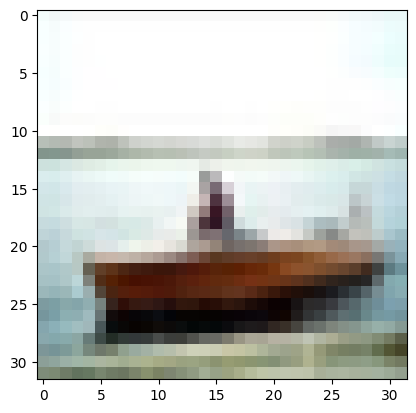

25


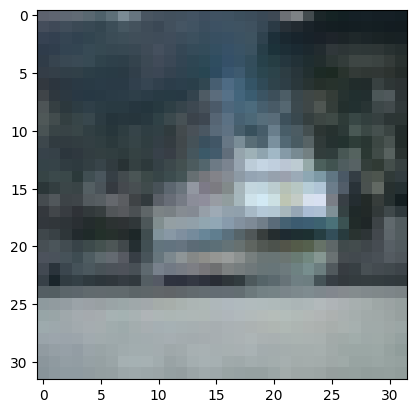

26


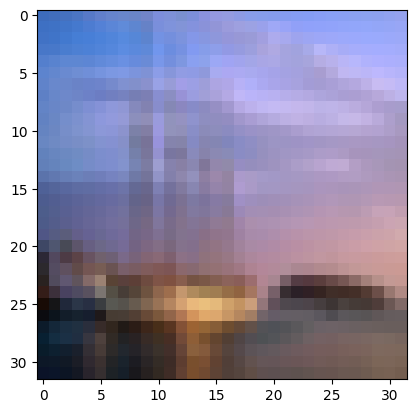

27


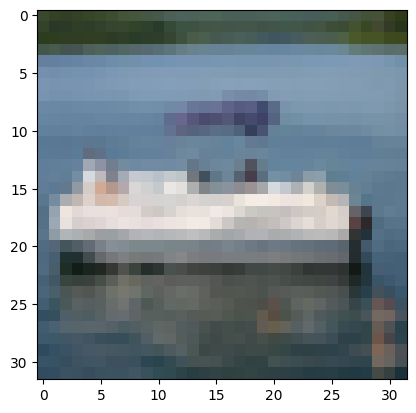

28


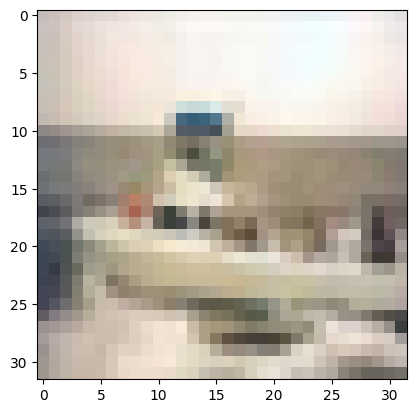

29


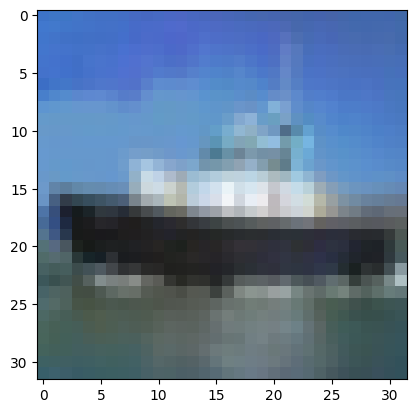

30


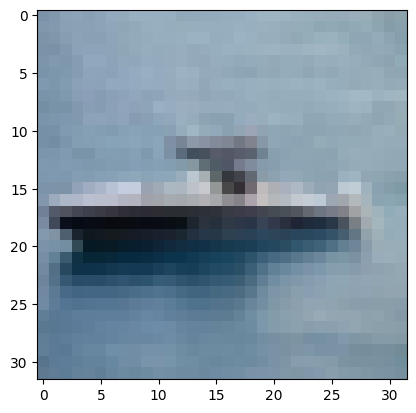

31


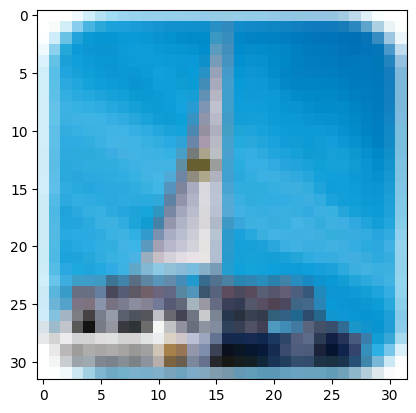

32


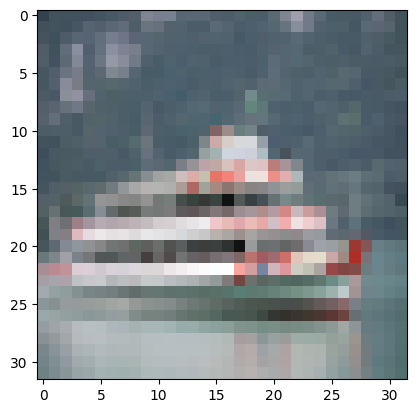

33


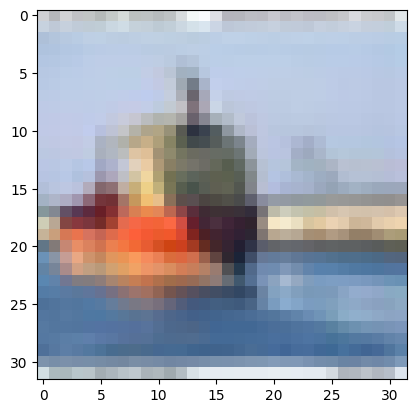

34


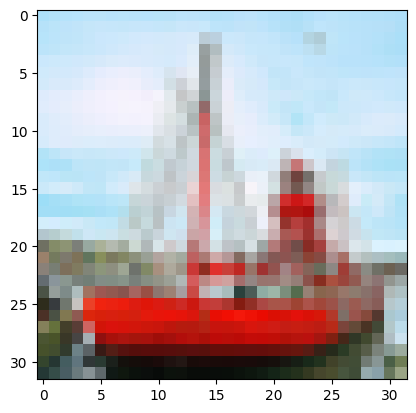

35


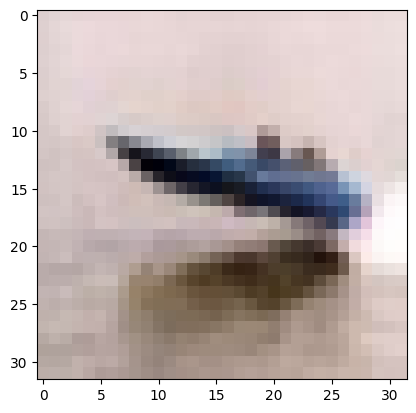

36


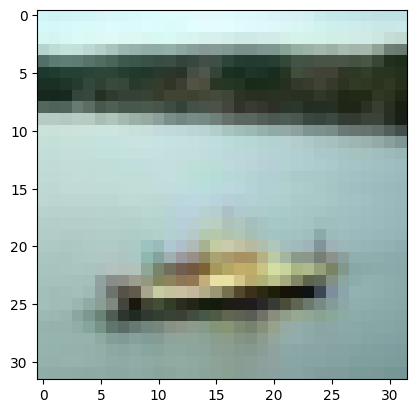

37


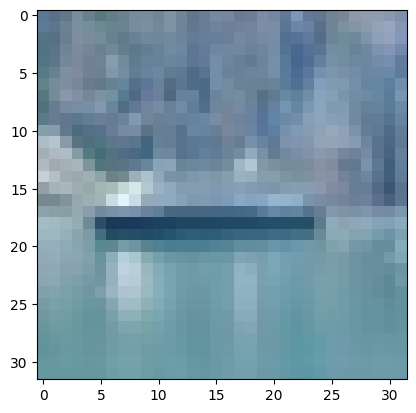

38


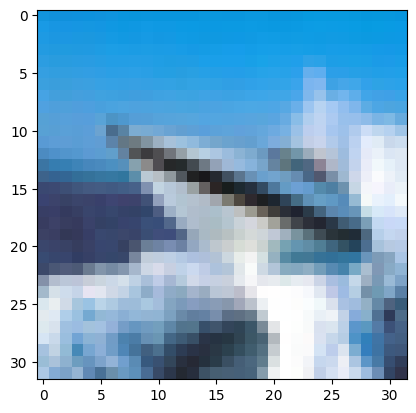

39


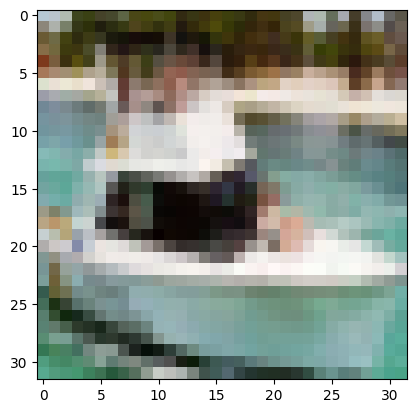

40


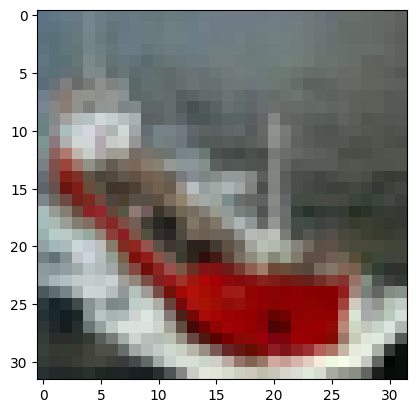

41


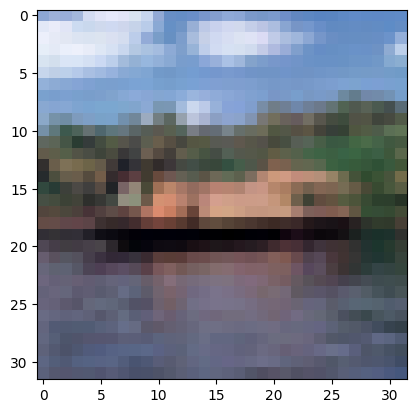

42


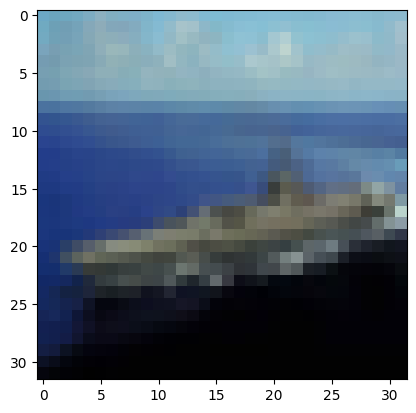

43


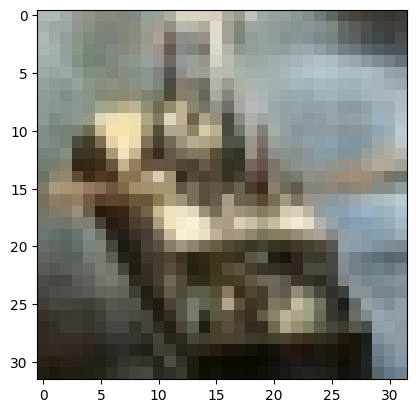

44


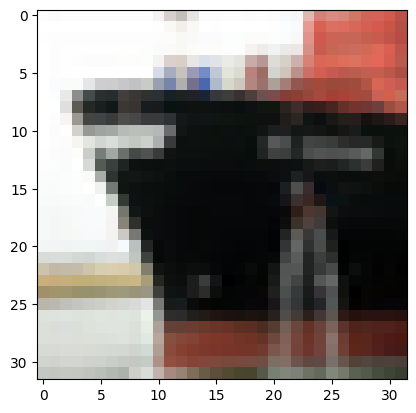

45


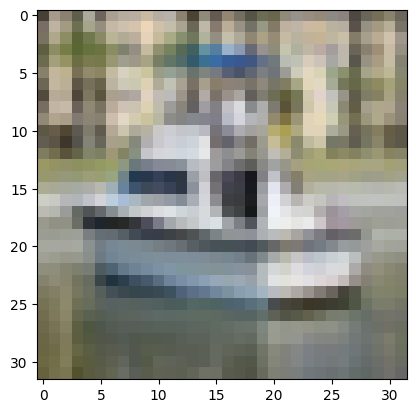

46


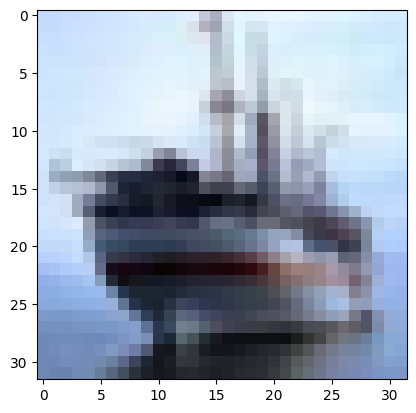

47


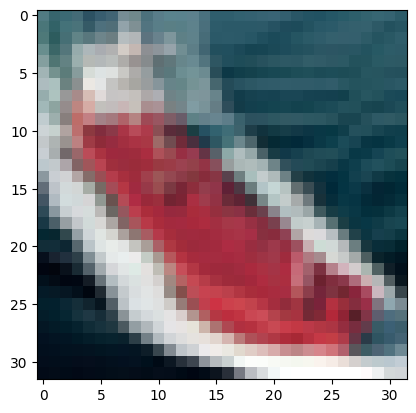

48


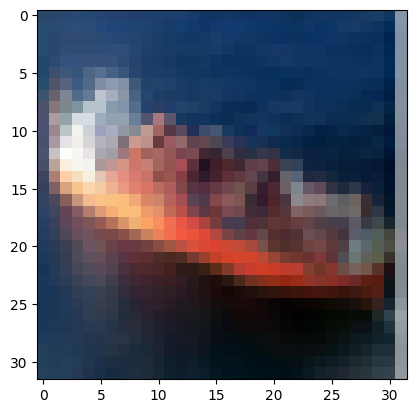

49


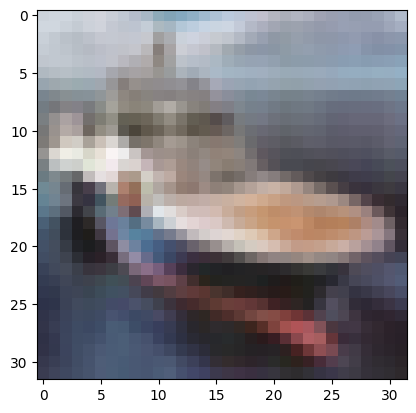

50


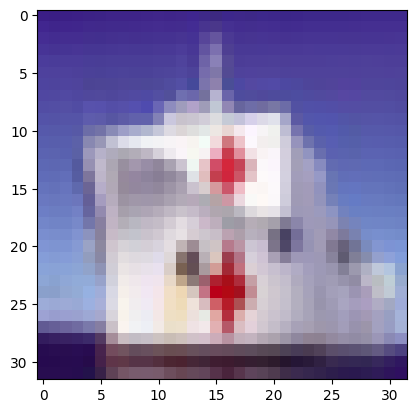

51


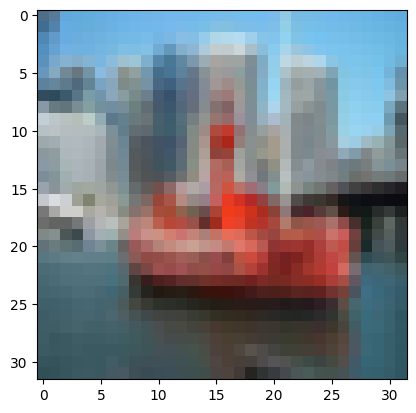

52


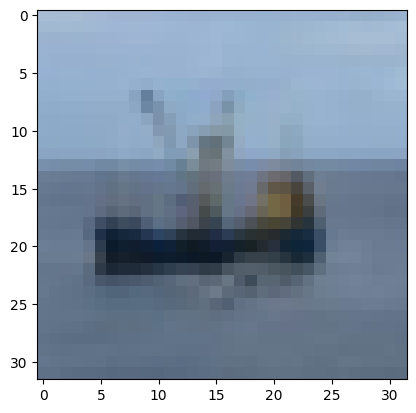

53


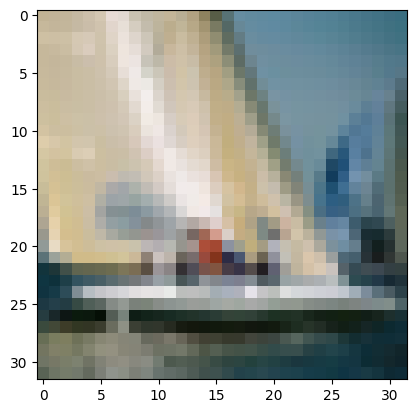

54


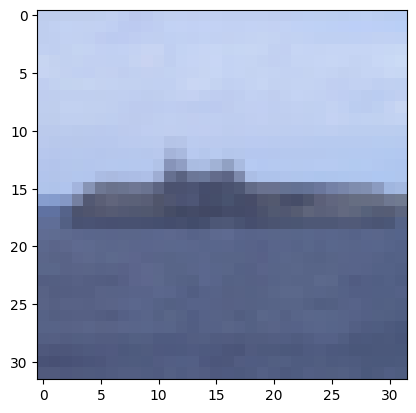

55


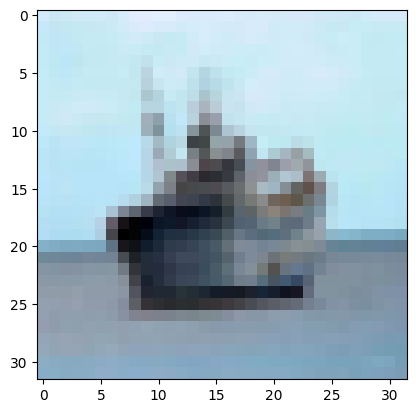

56


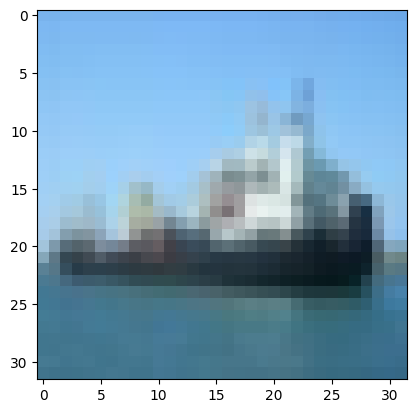

57


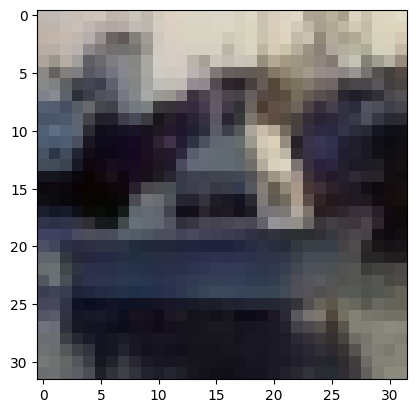

58


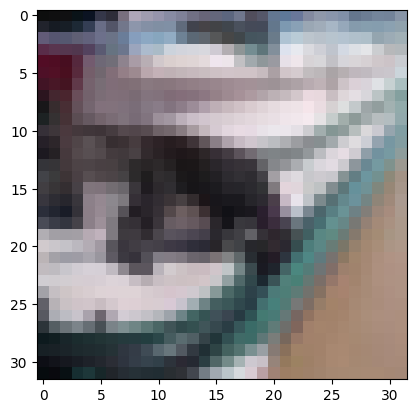

59


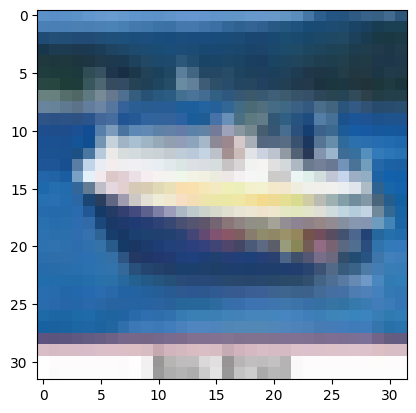

60


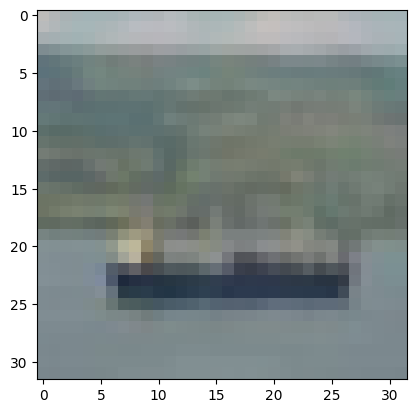

61


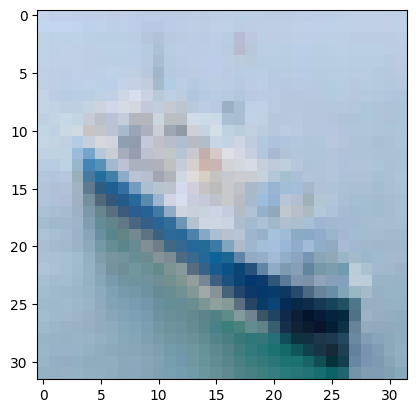

62


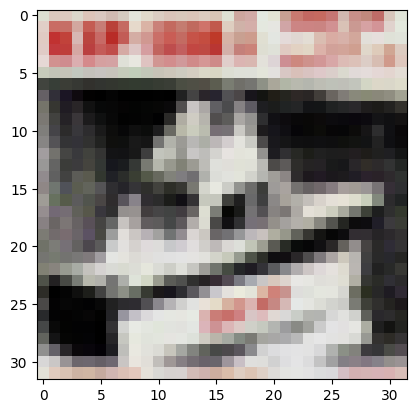

63


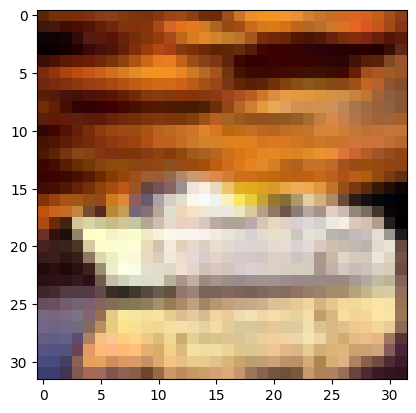

64


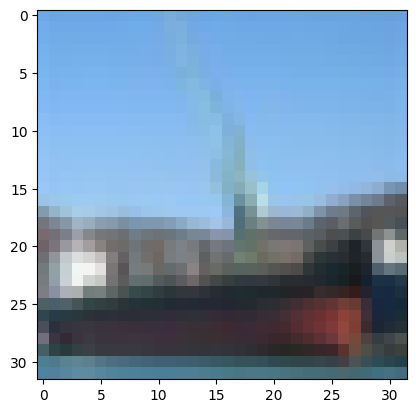

65


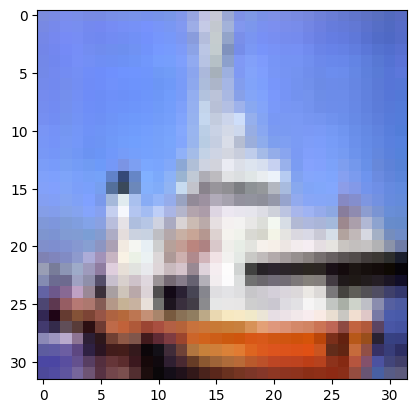

66


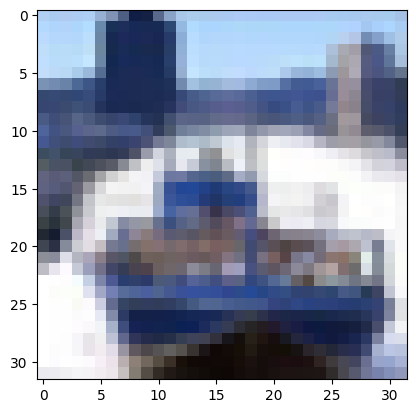

67


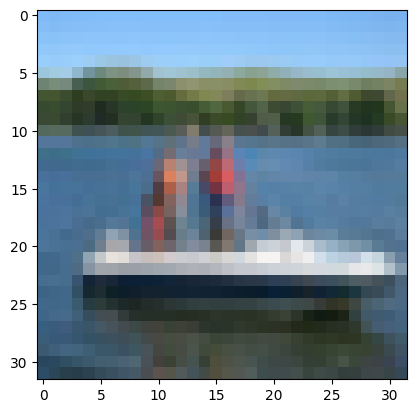

68


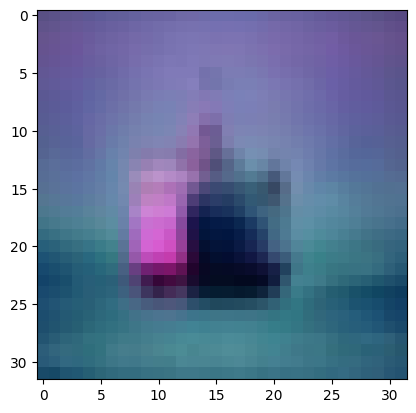

69


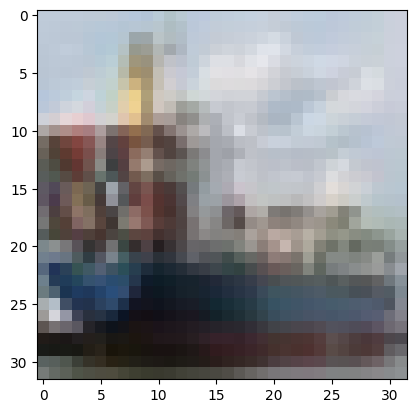

70


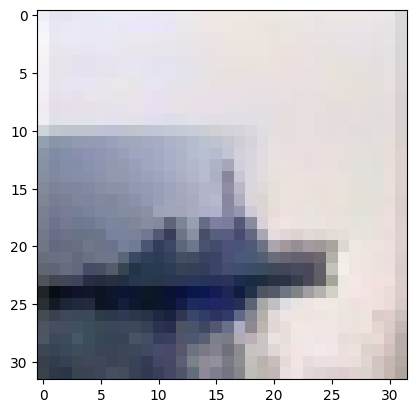

71


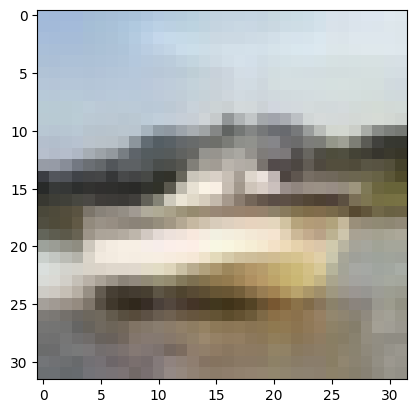

72


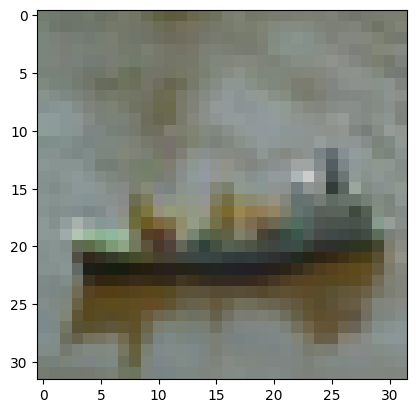

73


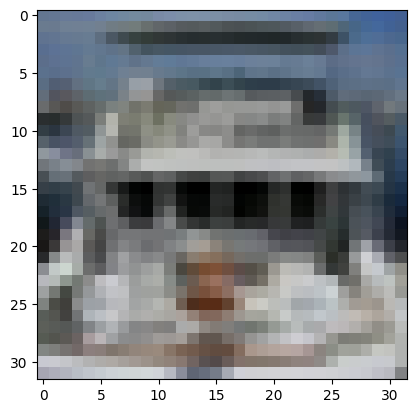

74


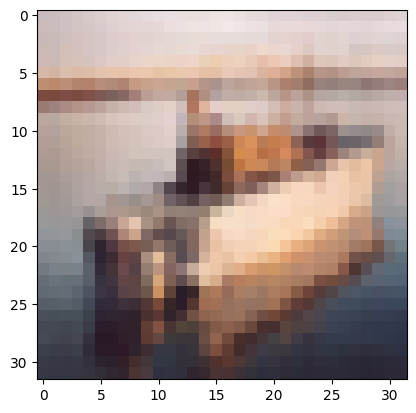

75


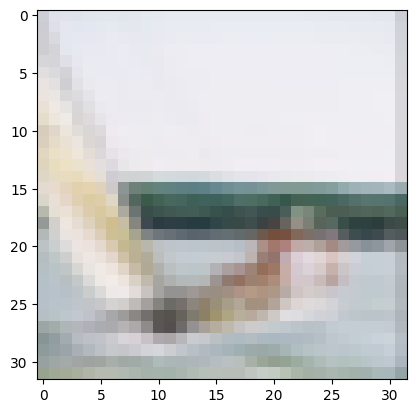

76


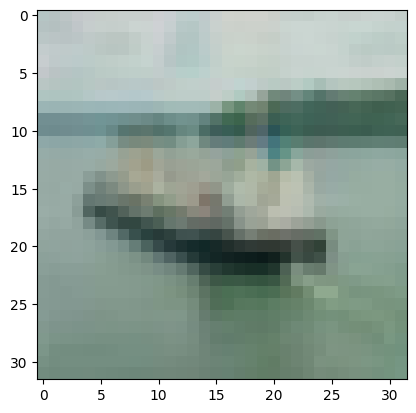

77


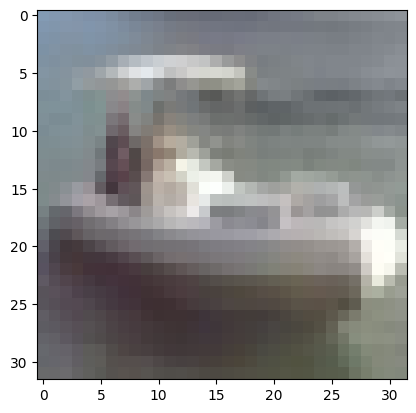

78


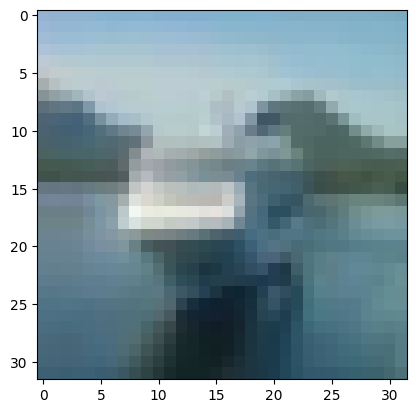

79


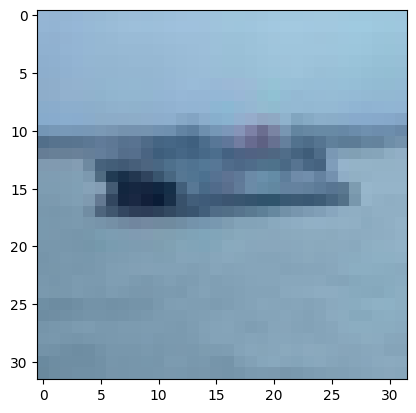

80


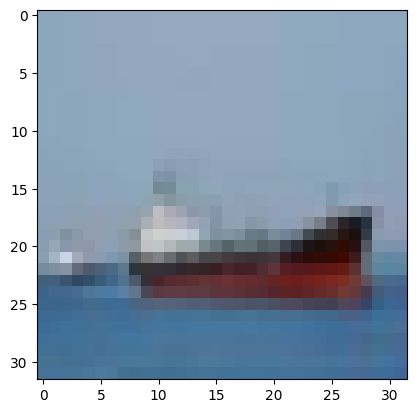

81


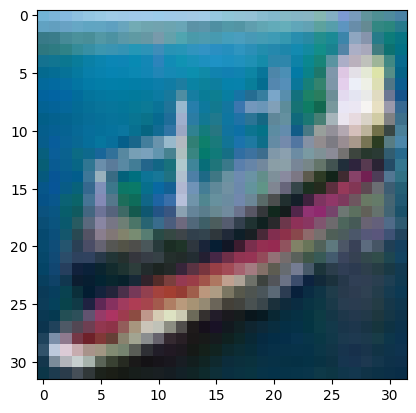

82


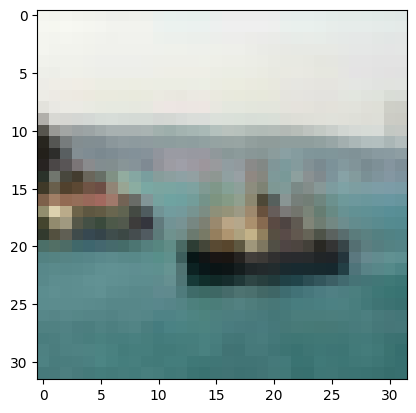

83


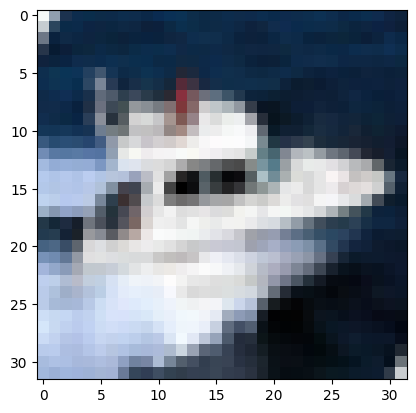

84


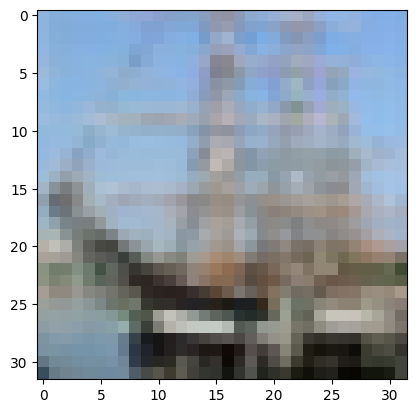

85


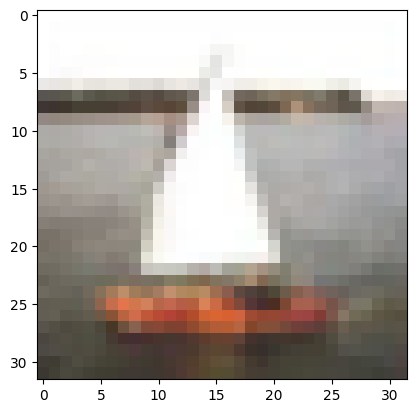

86


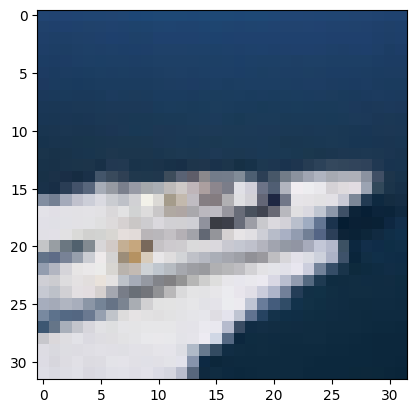

87


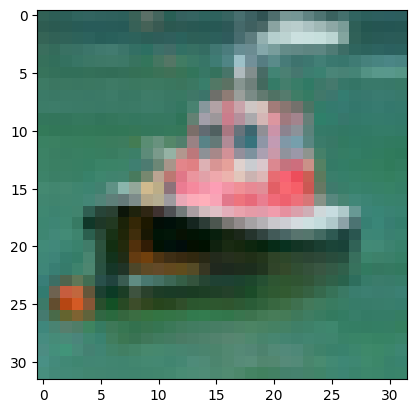

88


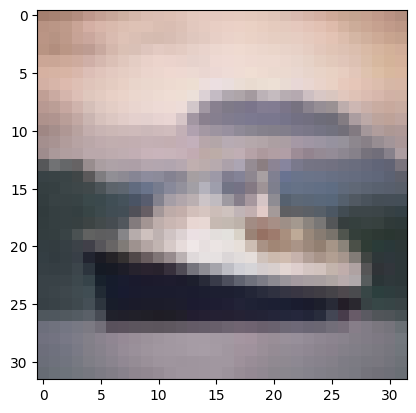

89


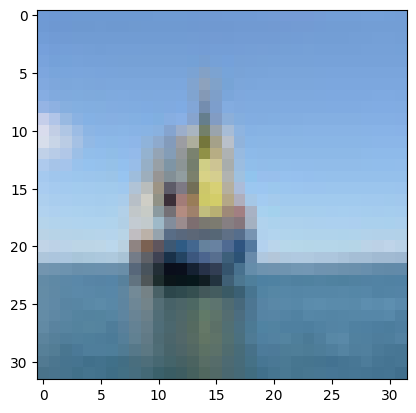

90


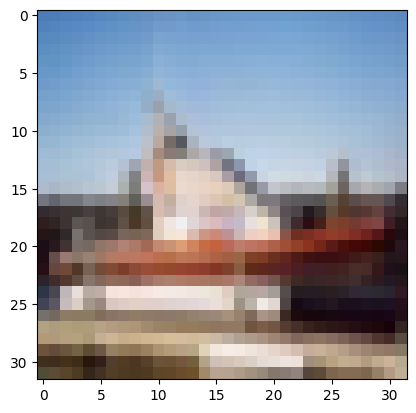

91


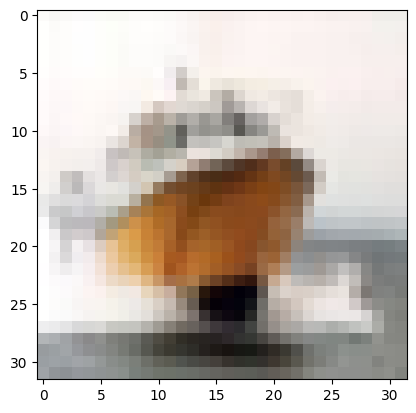

92


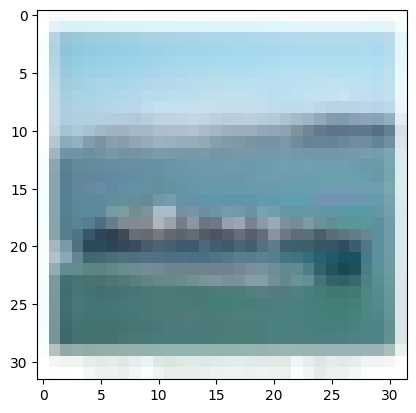

93


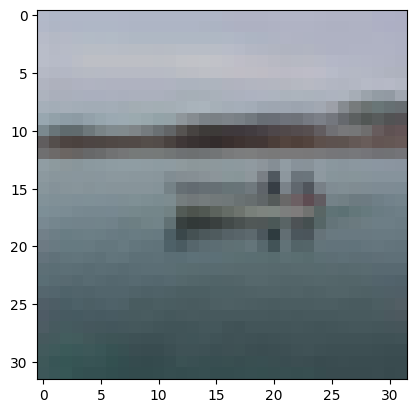

94


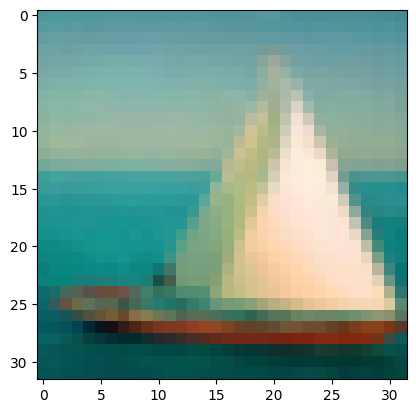

95


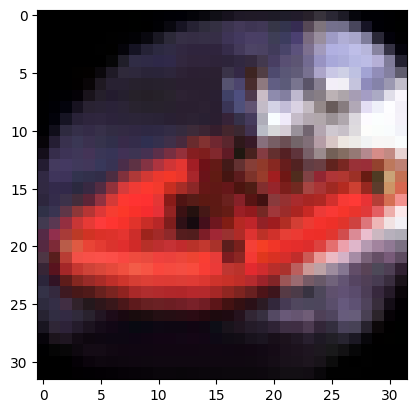

96


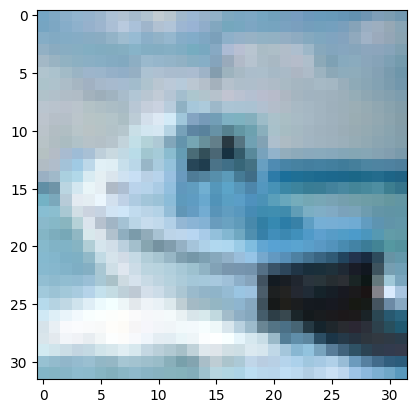

97


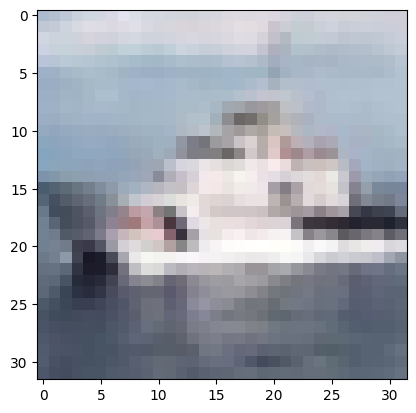

98


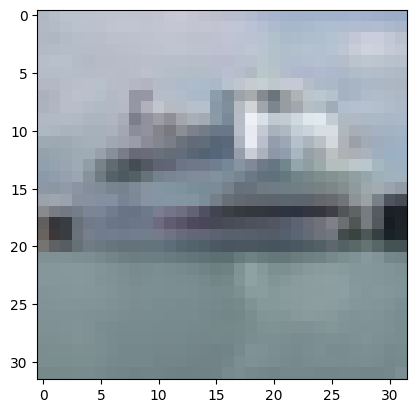

99


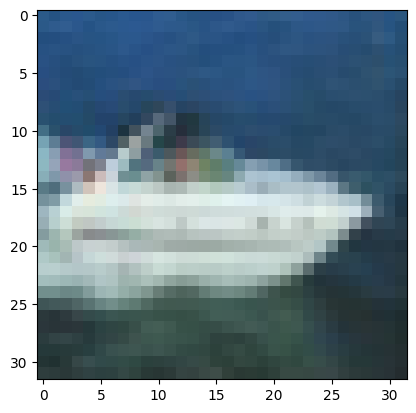

In [ ]:
for i in range(100):
  print(i)
  plt.imshow(images8[i])
  plt.show()

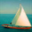

In [ ]:
images8[94]

### 9

0


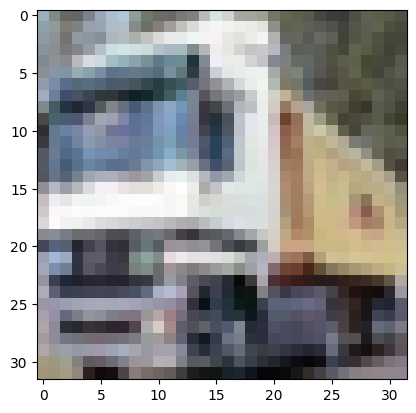

1


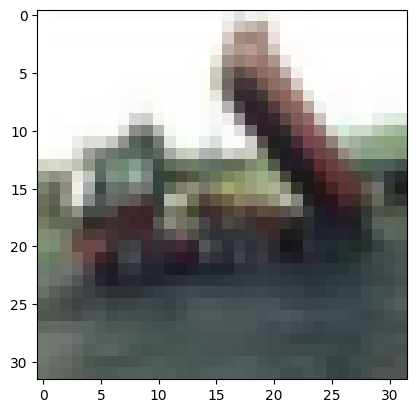

2


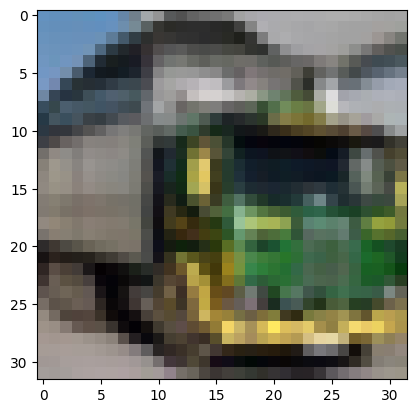

3


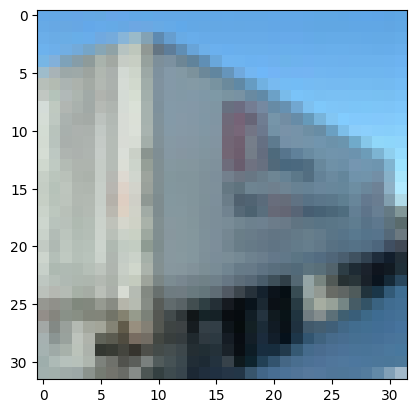

4


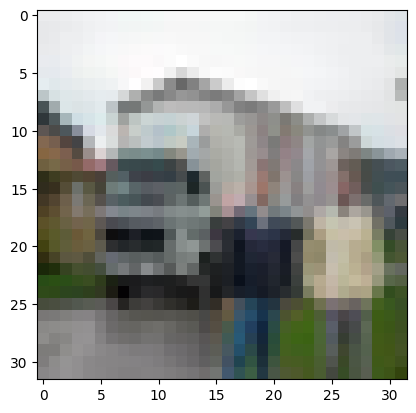

5


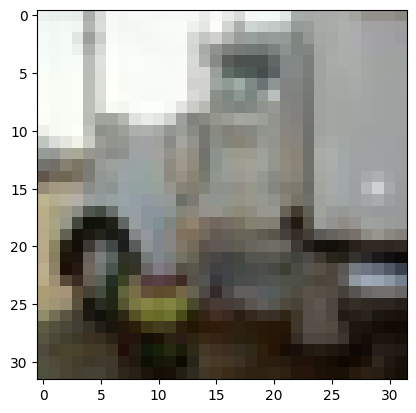

6


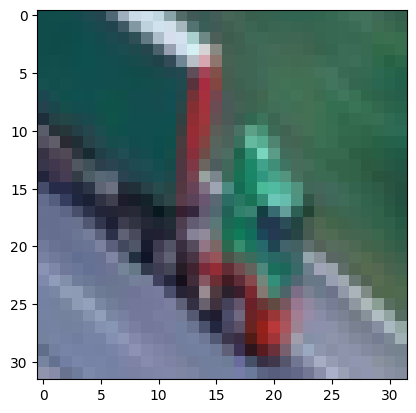

7


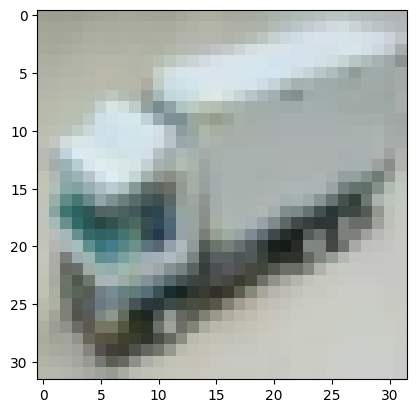

8


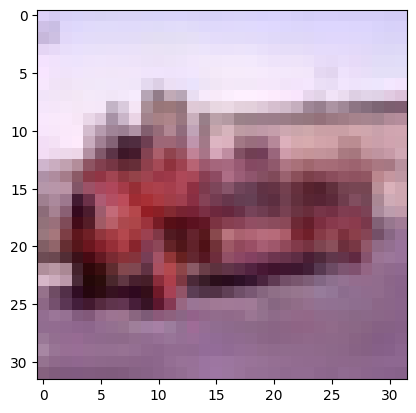

9


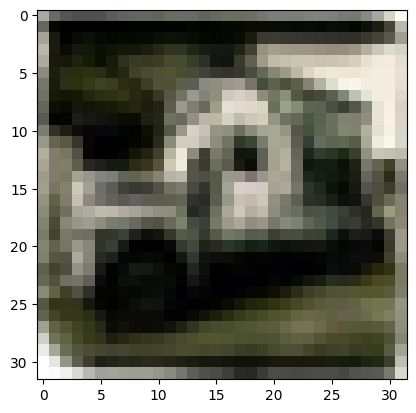

10


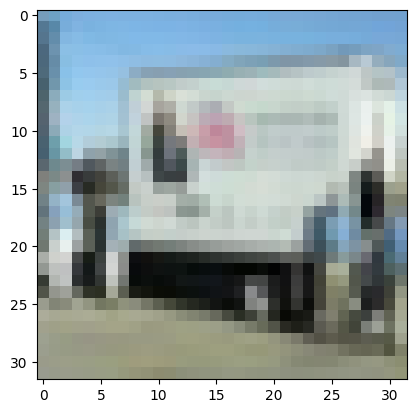

11


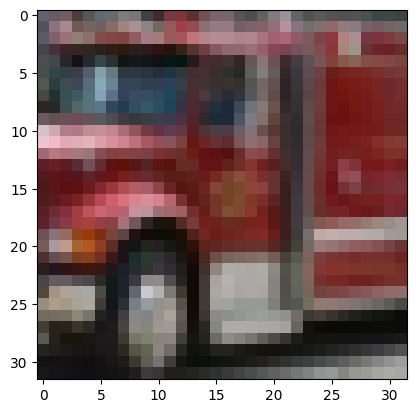

12


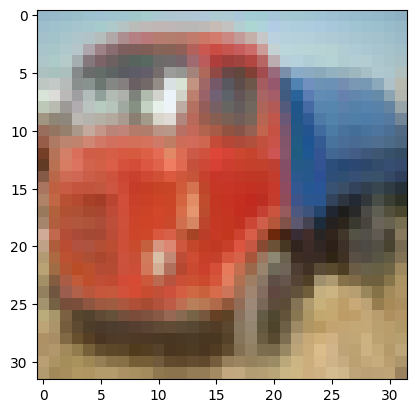

13


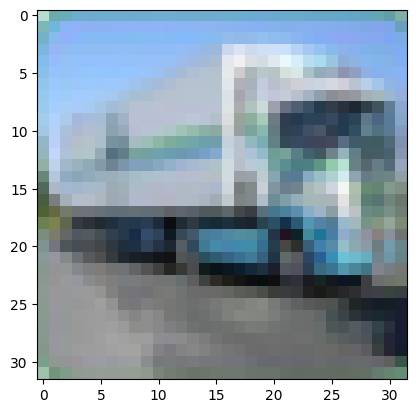

14


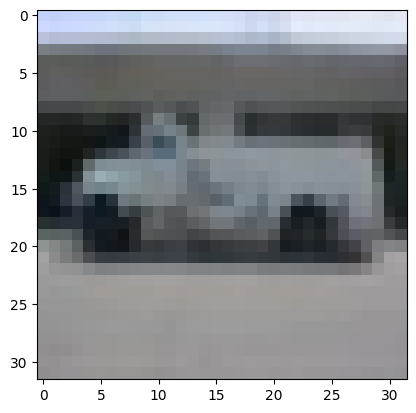

15


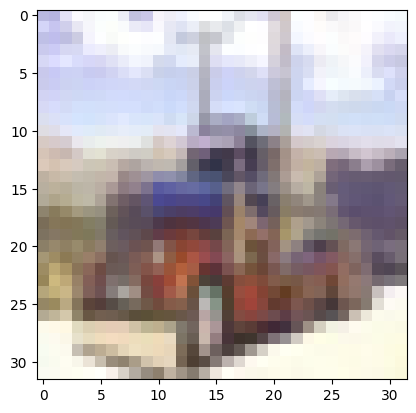

16


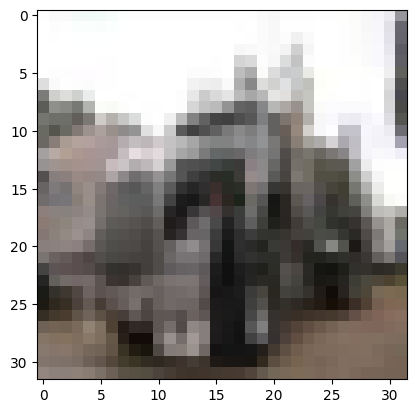

17


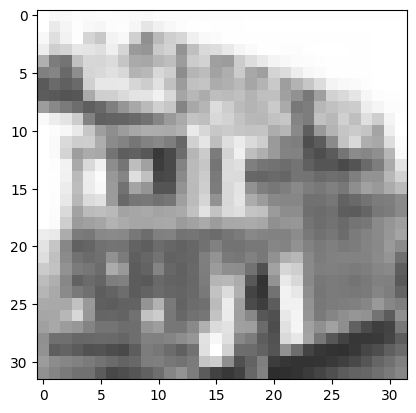

18


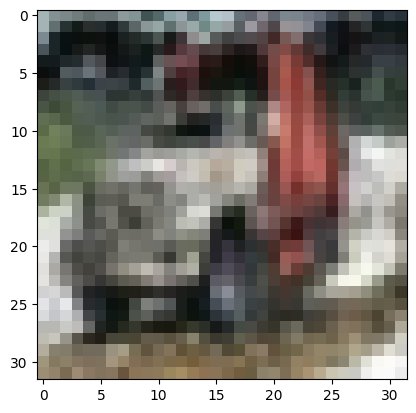

19


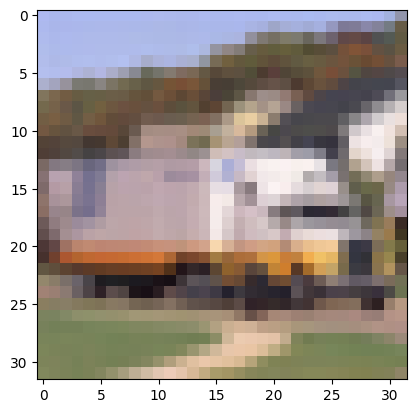

20


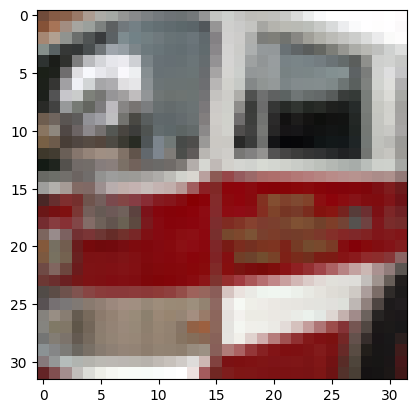

21


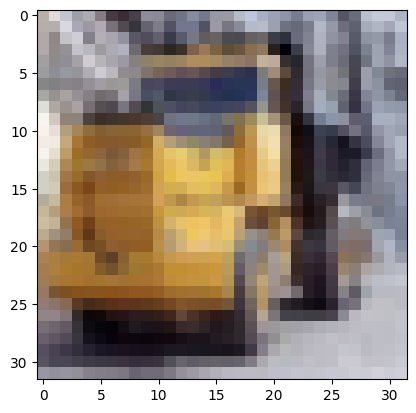

22


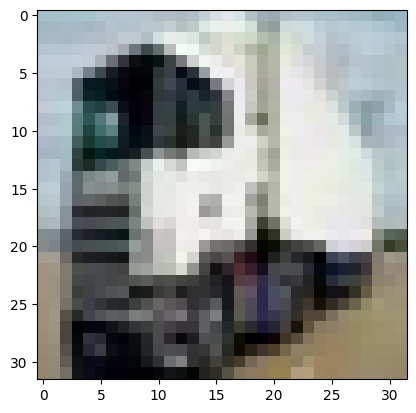

23


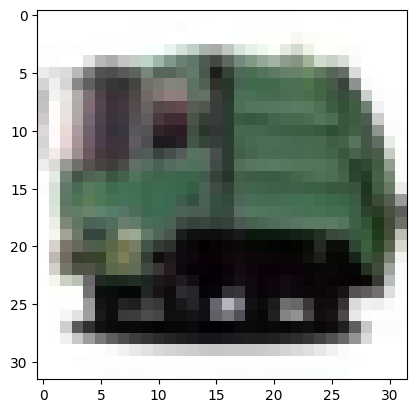

24


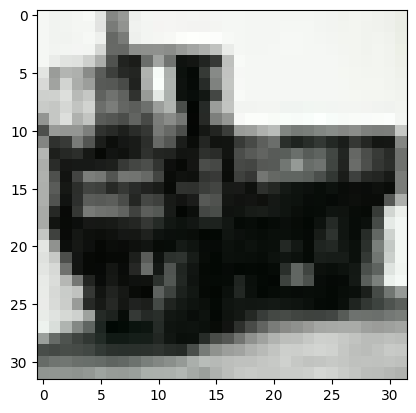

25


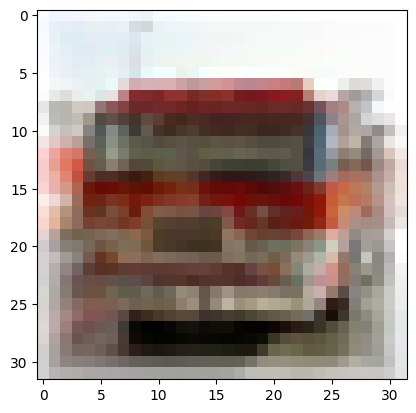

26


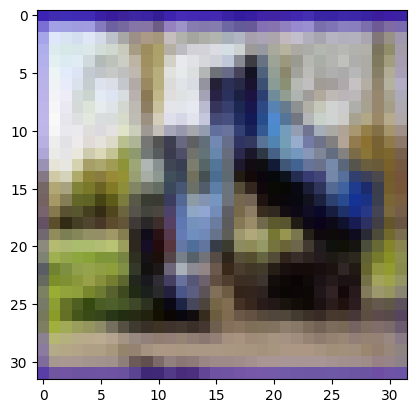

27


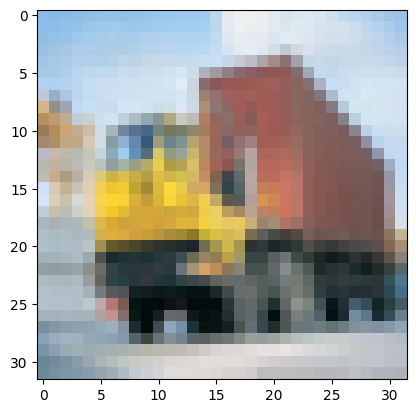

28


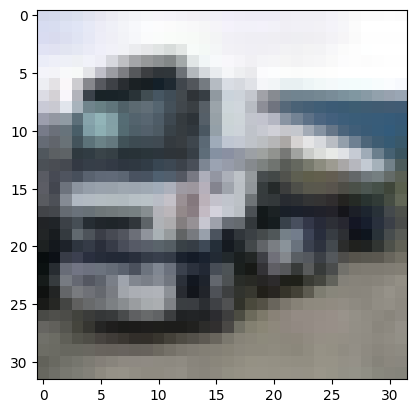

29


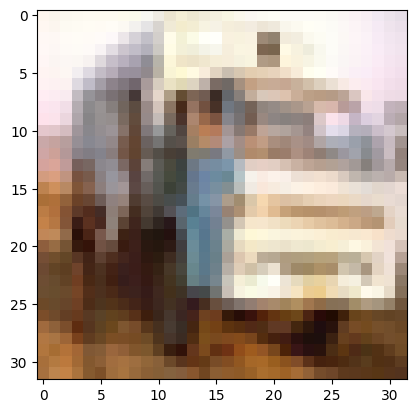

30


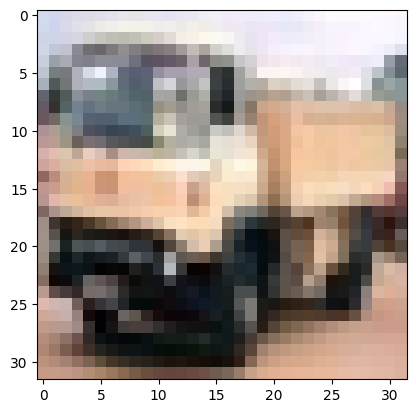

31


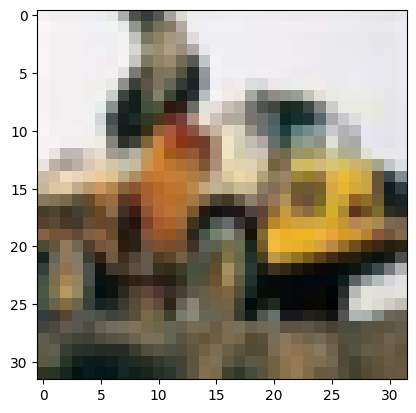

32


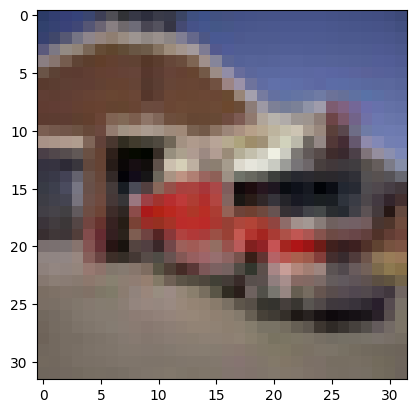

33


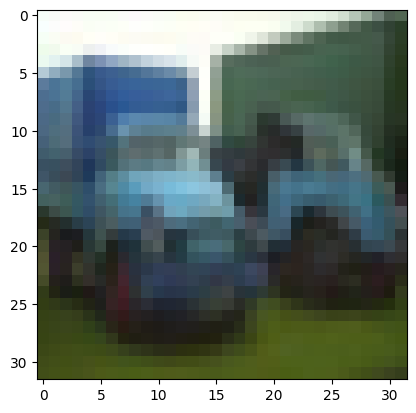

34


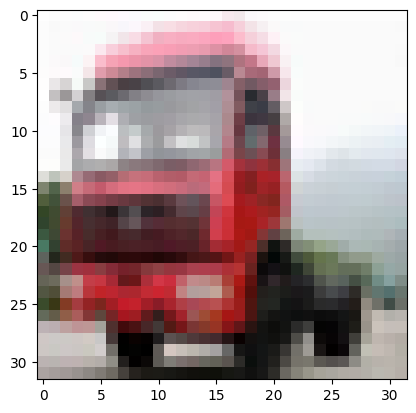

35


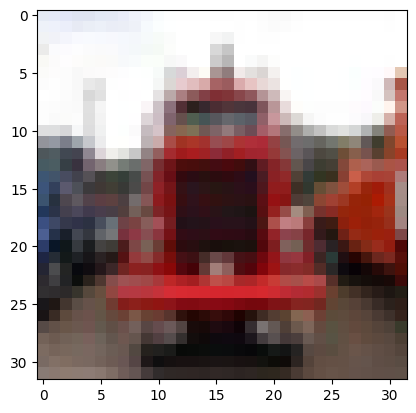

36


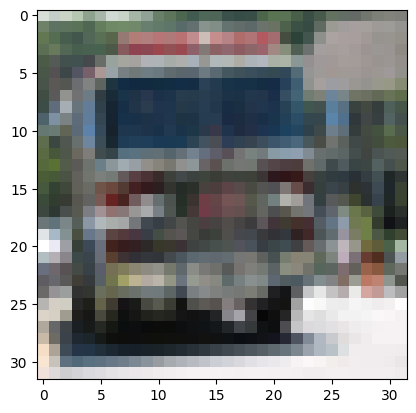

37


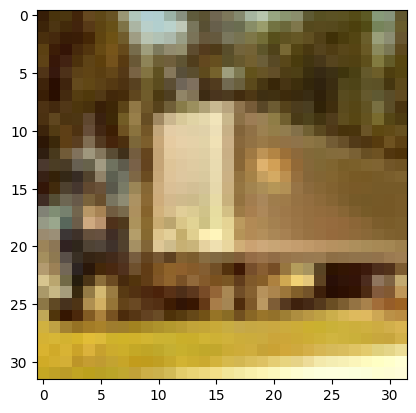

38


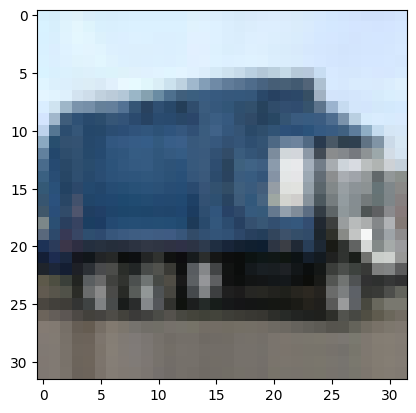

39


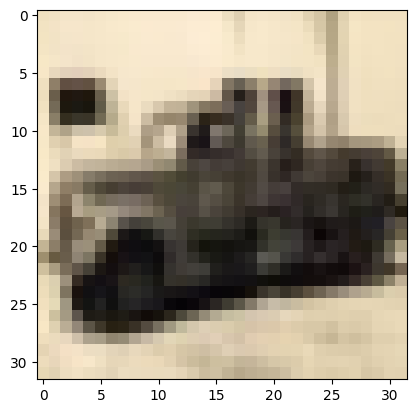

40


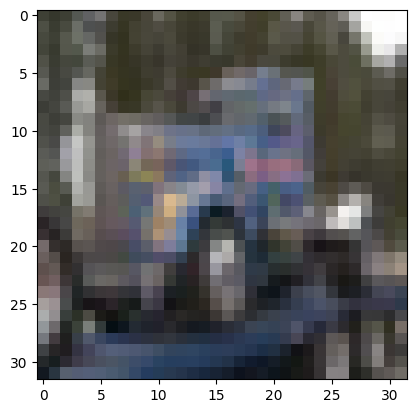

41


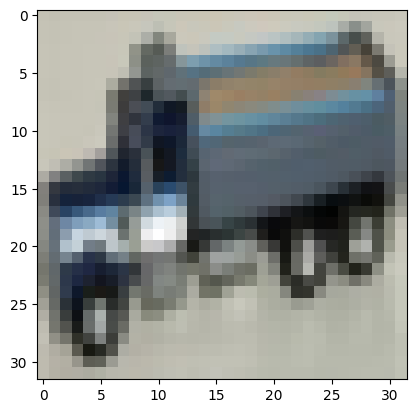

42


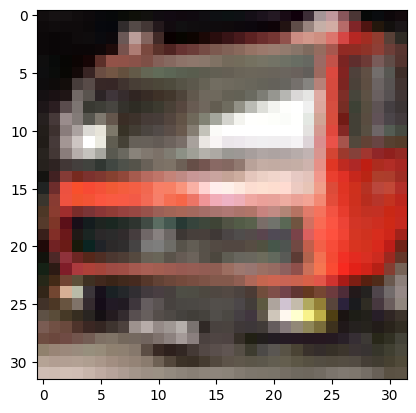

43


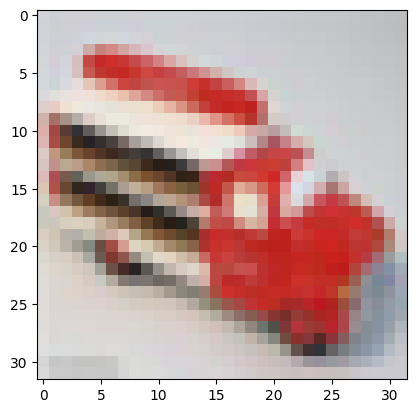

44


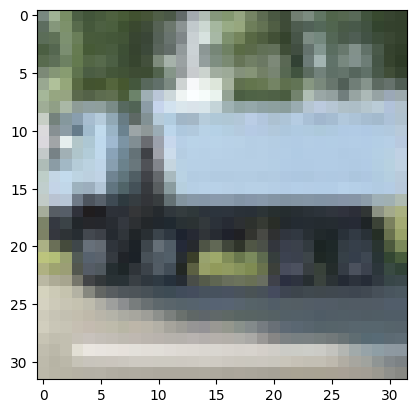

45


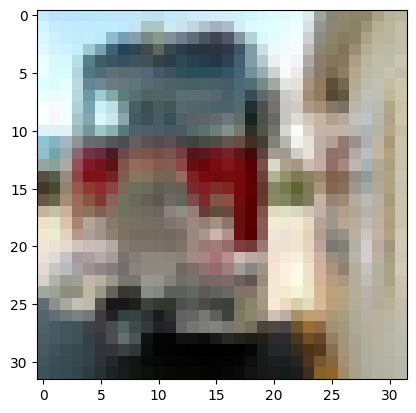

46


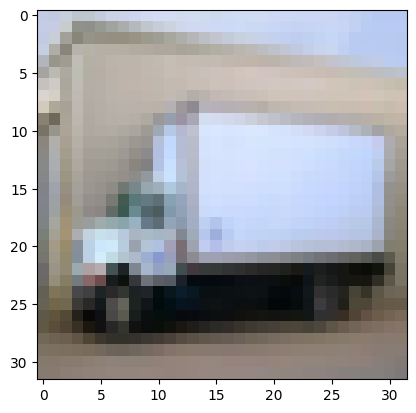

47


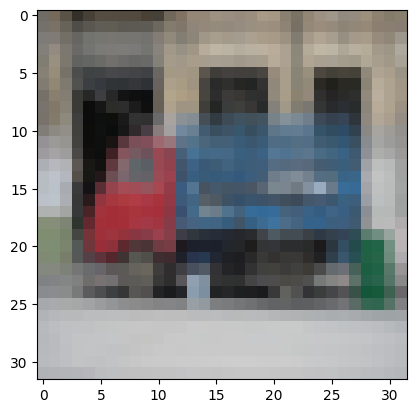

48


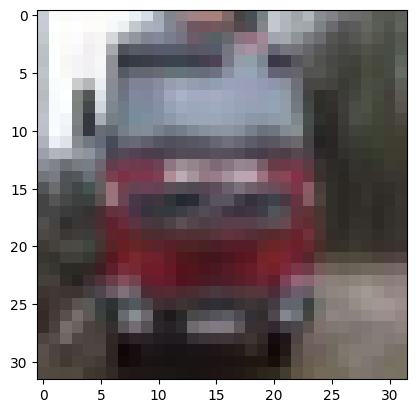

49


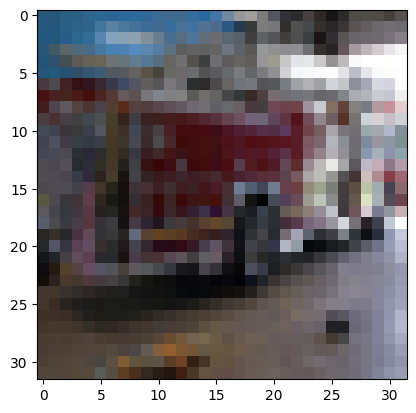

50


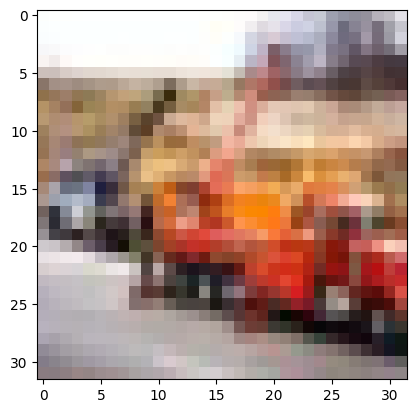

51


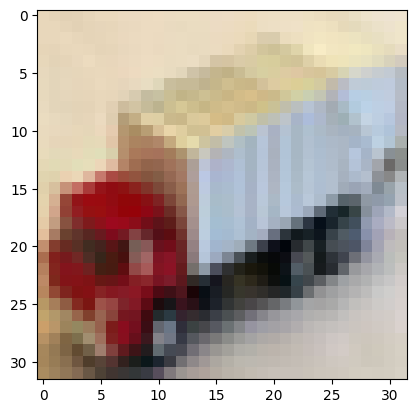

52


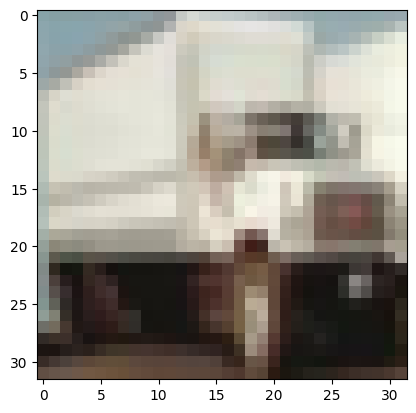

53


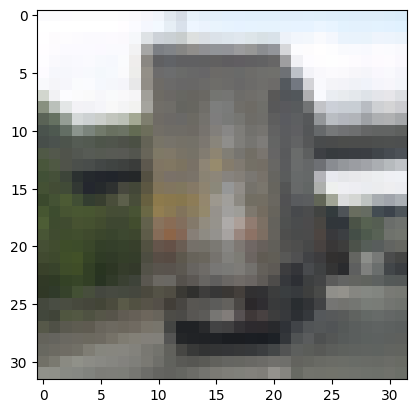

54


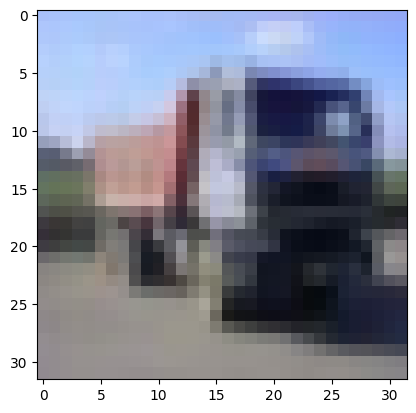

55


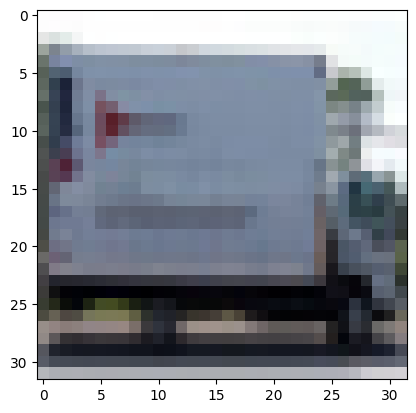

56


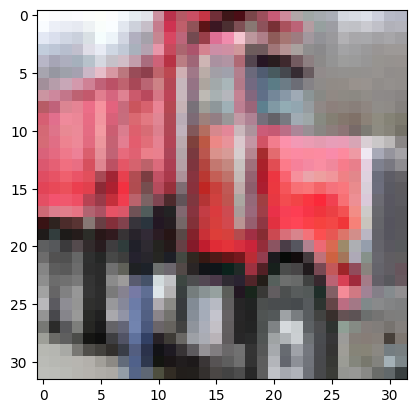

57


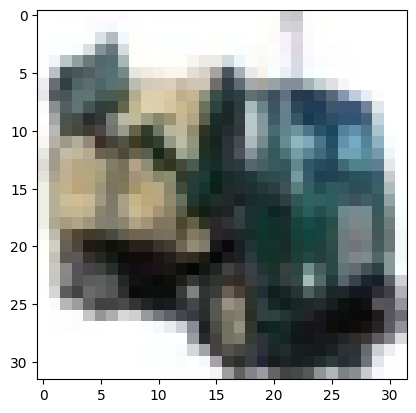

58


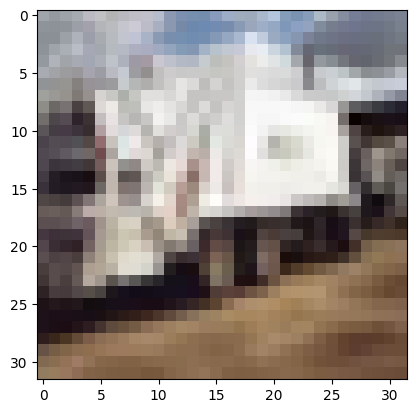

59


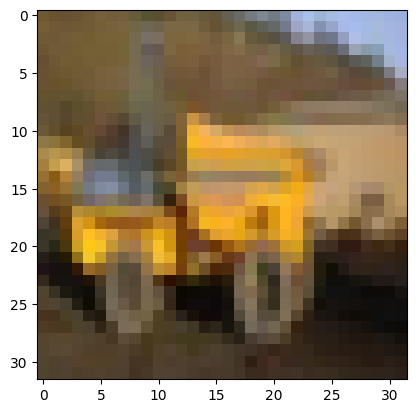

60


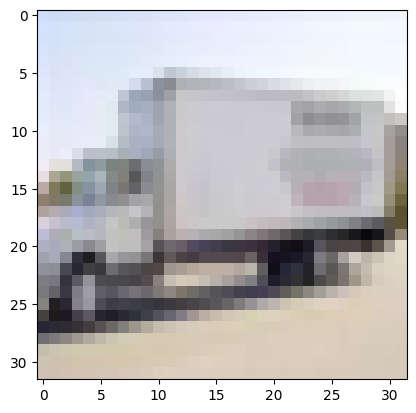

61


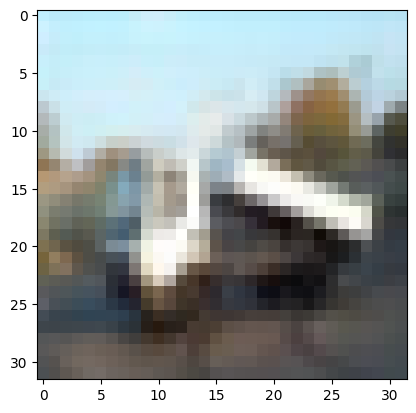

62


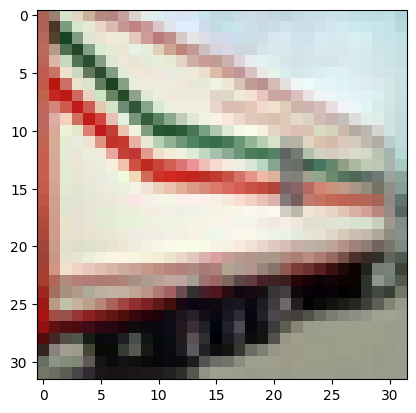

63


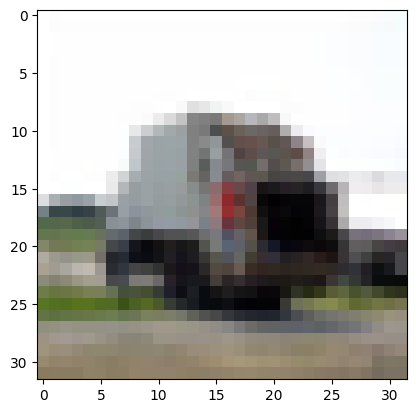

64


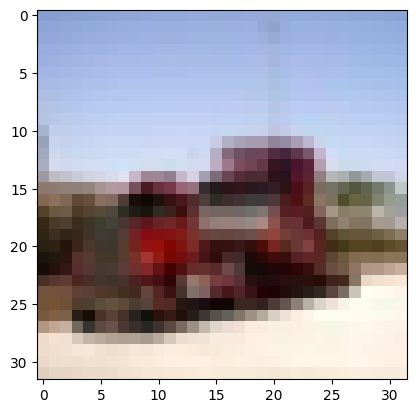

65


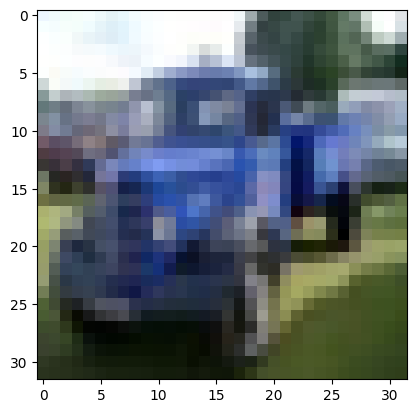

66


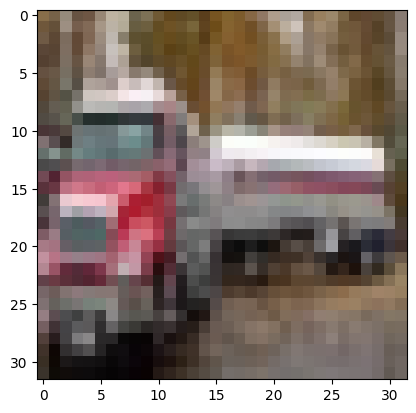

67


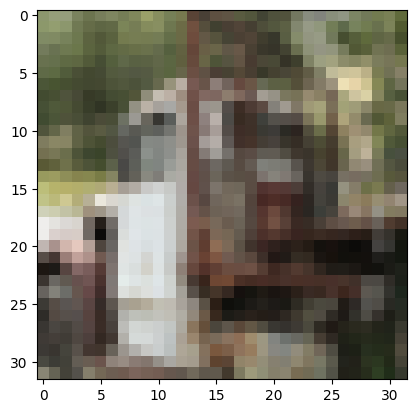

68


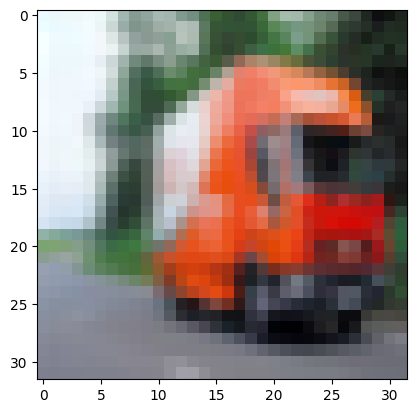

69


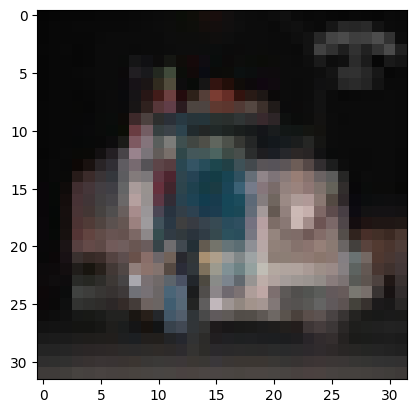

70


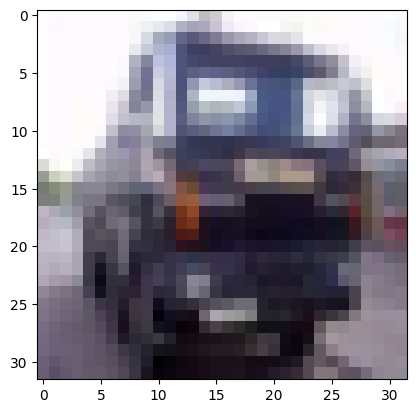

71


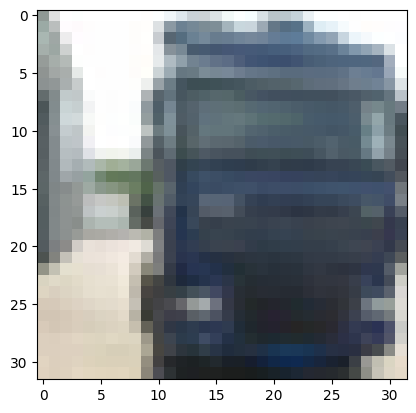

72


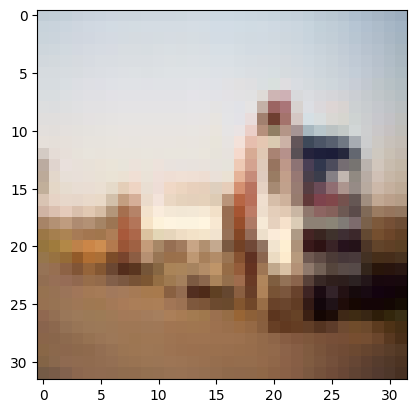

73


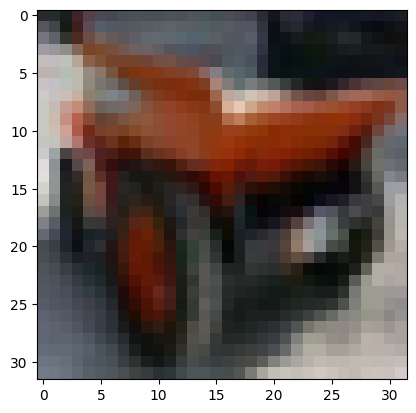

74


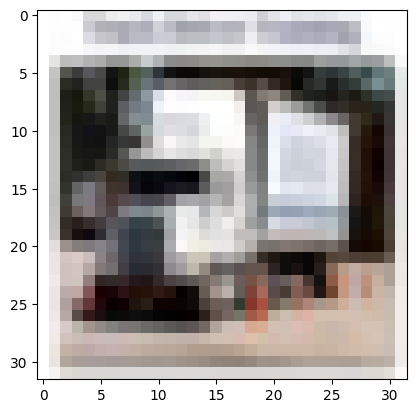

75


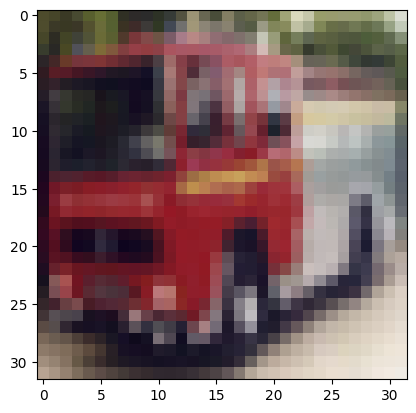

76


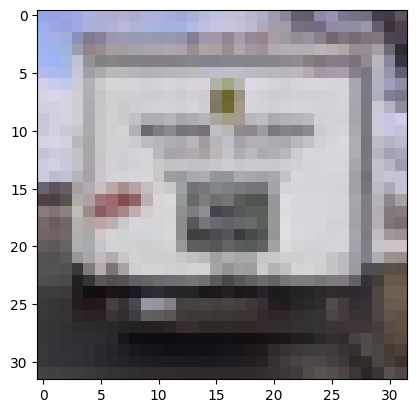

77


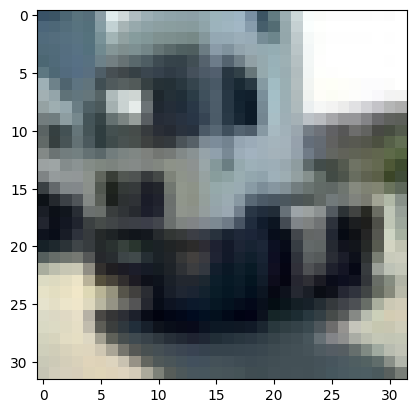

78


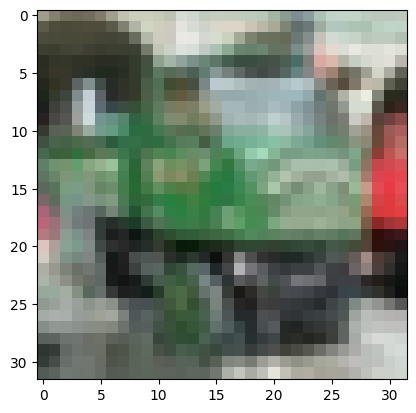

79


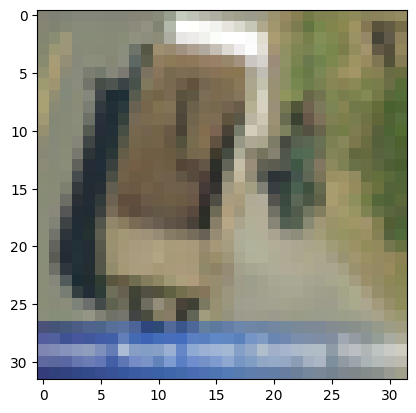

80


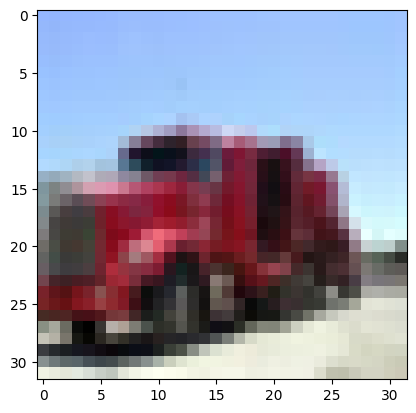

81


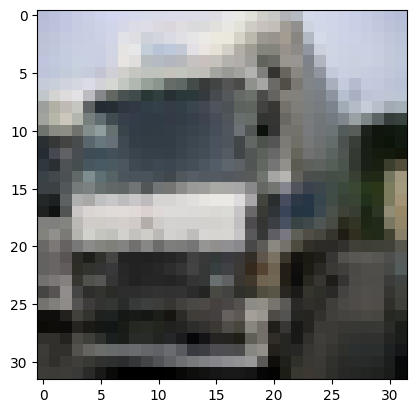

82


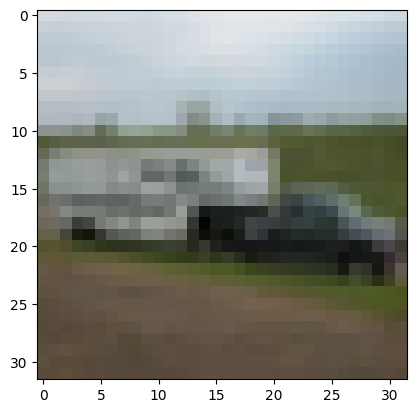

83


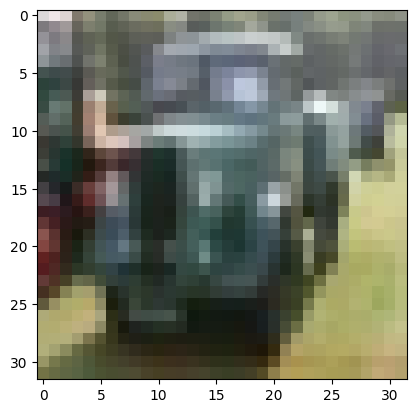

84


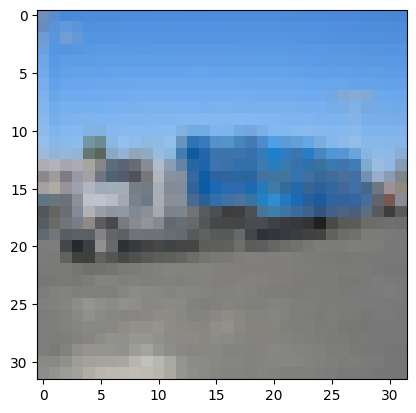

85


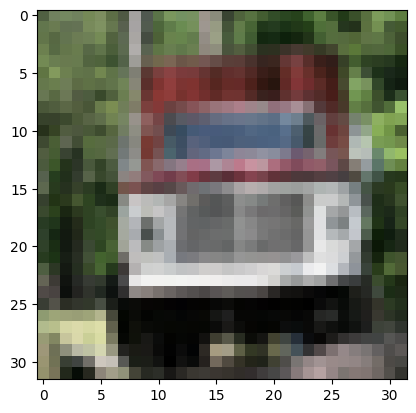

86


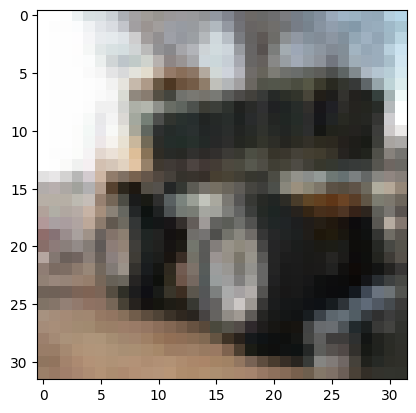

87


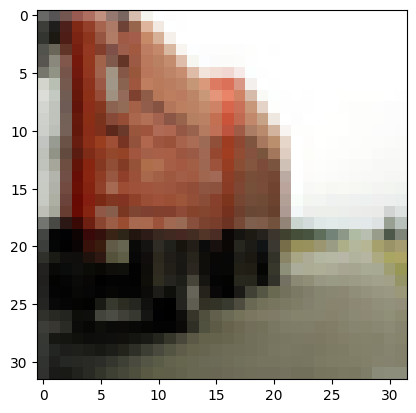

88


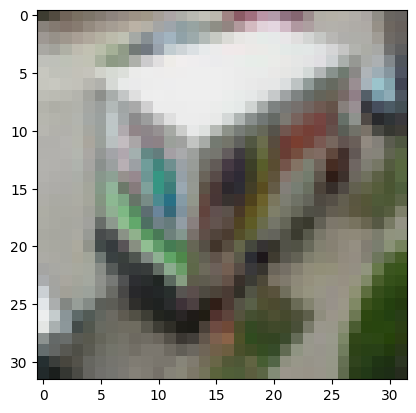

89


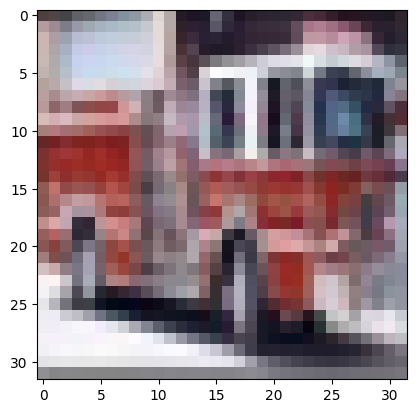

90


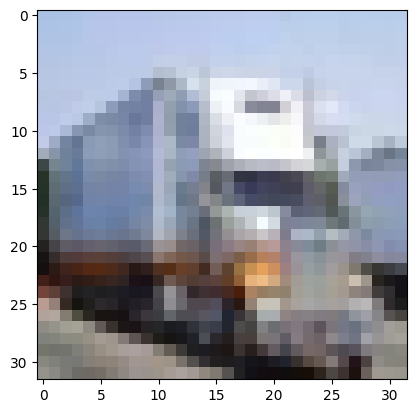

91


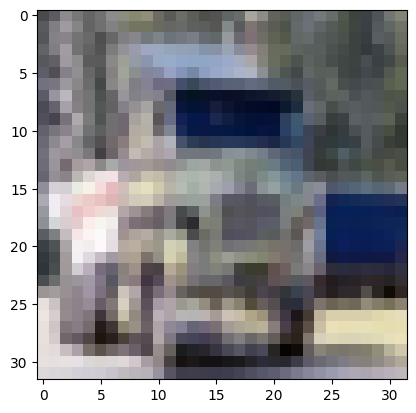

92


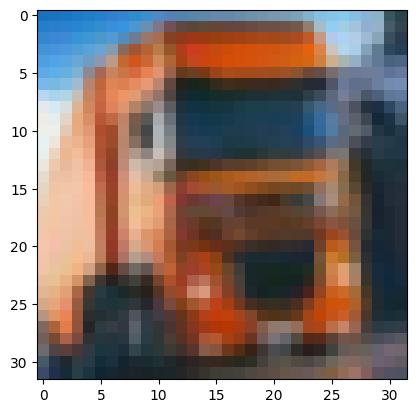

93


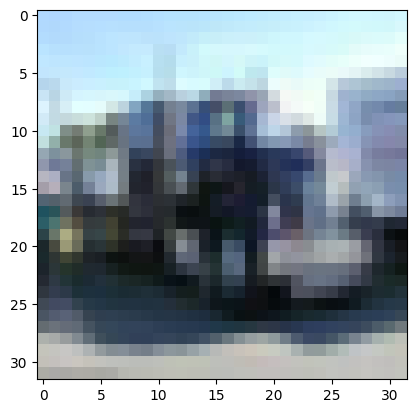

94


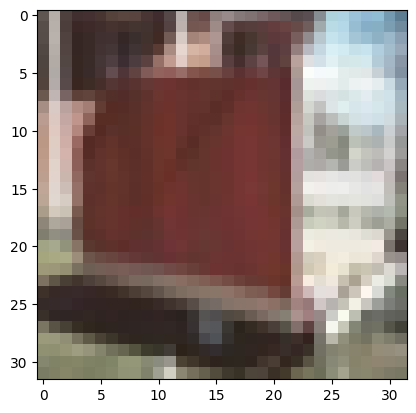

95


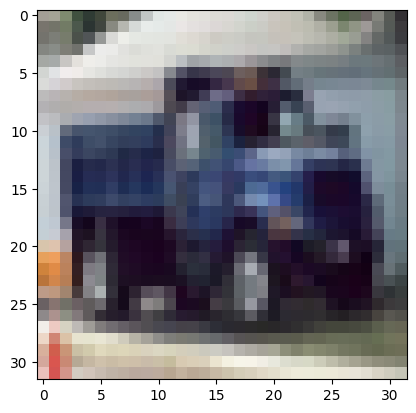

96


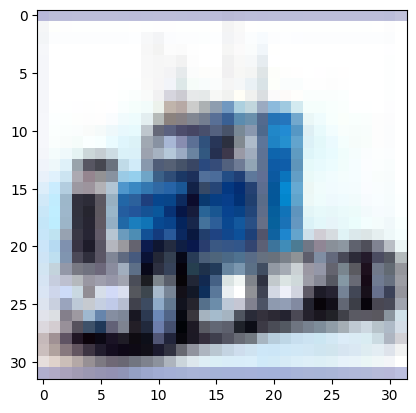

97


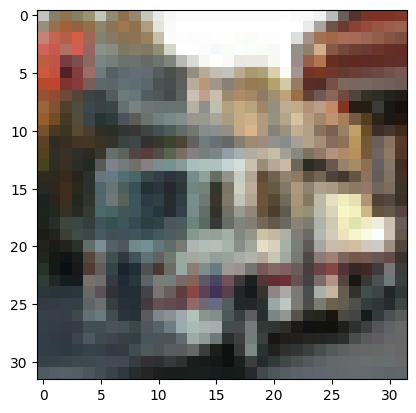

98


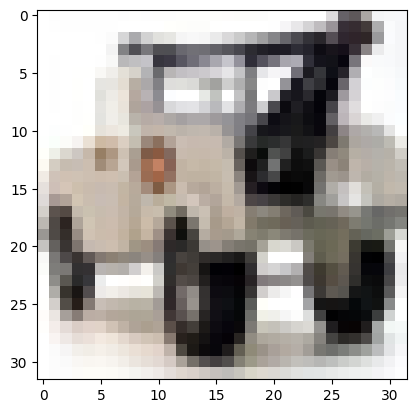

99


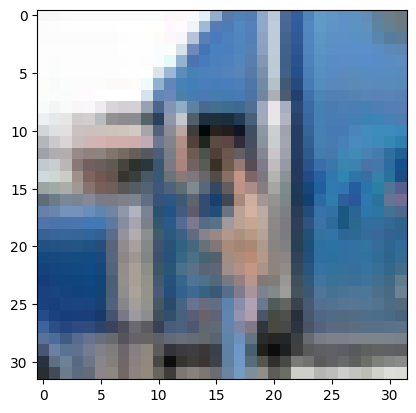

In [ ]:
# Load CIFAR-10
train_data = datasets.CIFAR10(root='./data', train=True, download=True)
clas = 9

# Get all ship images and labels
images9 = [img for img, label in train_data if label == clas]
#print(f"Number of 1 images: {len(ship_images)}")  # Output: 5000 (train)

for i in range(100):
  print(i)
  plt.imshow(images9[i])
  plt.show()

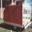

In [ ]:
images9[94]

### 10

0


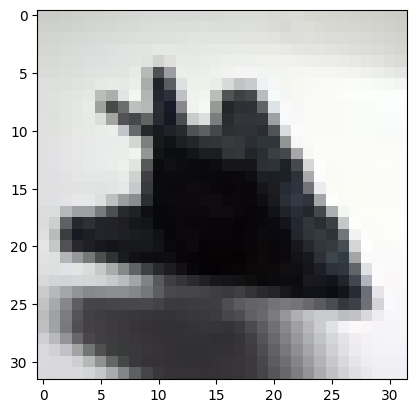

1


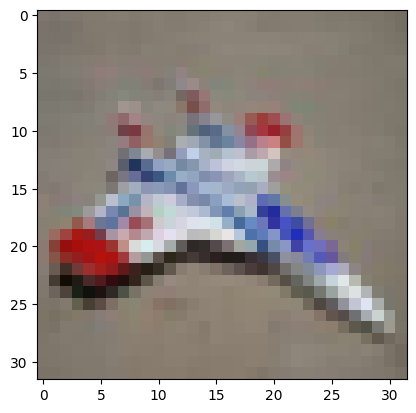

2


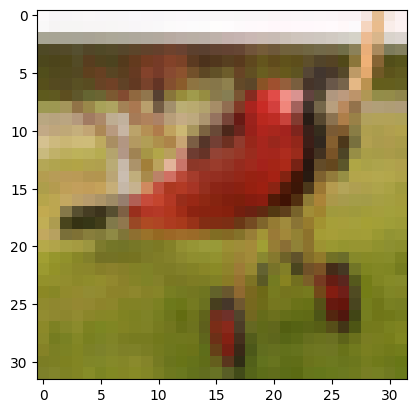

3


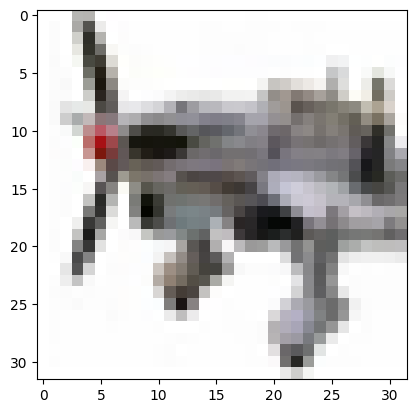

4


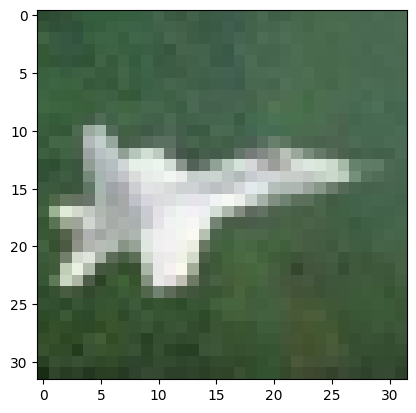

5


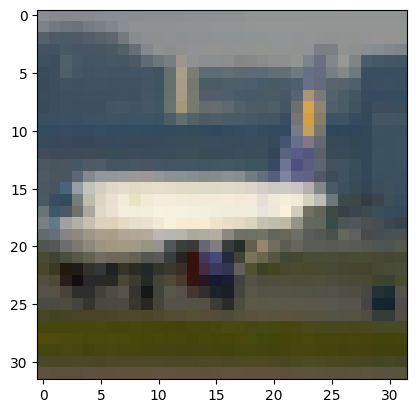

6


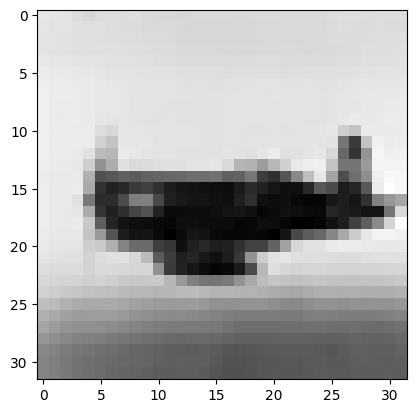

7


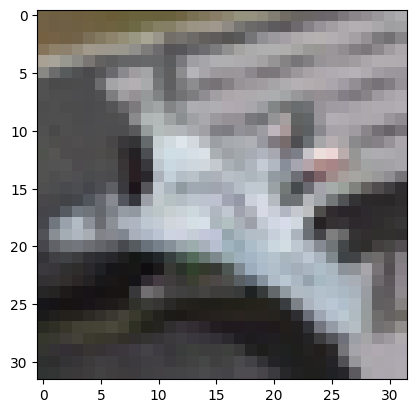

8


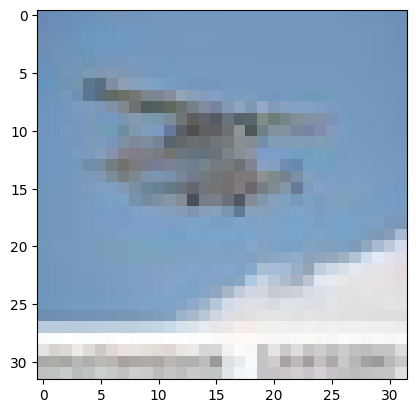

9


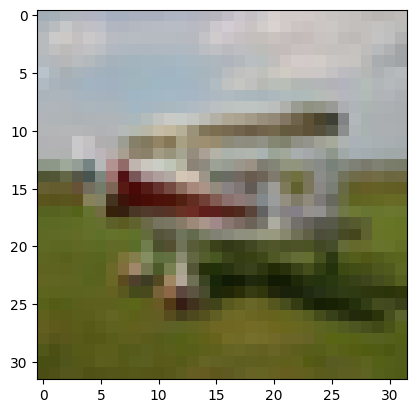

10


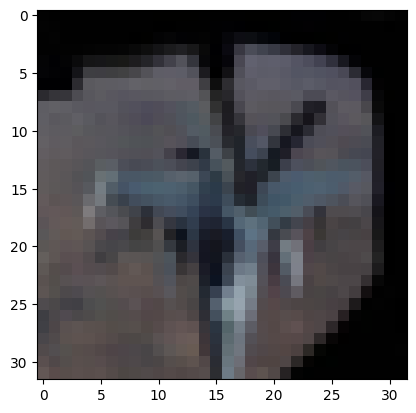

11


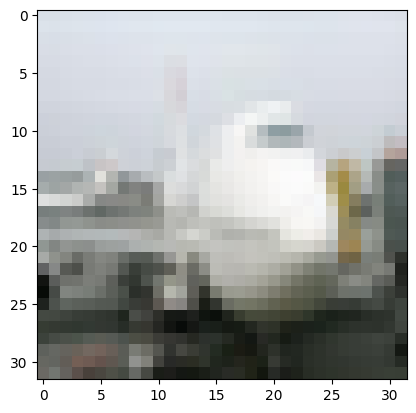

12


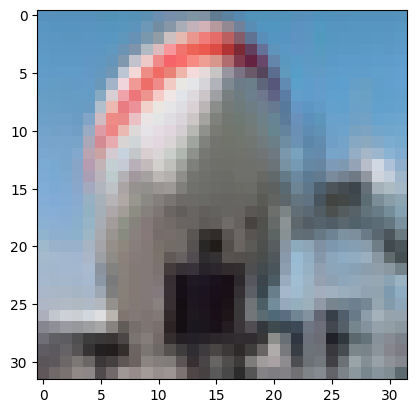

13


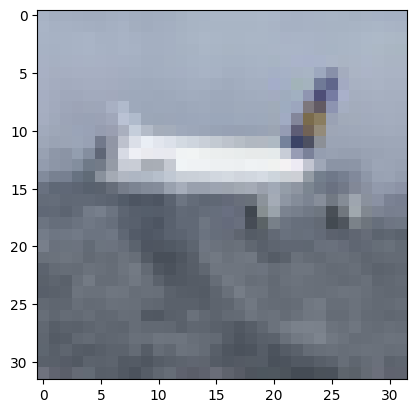

14


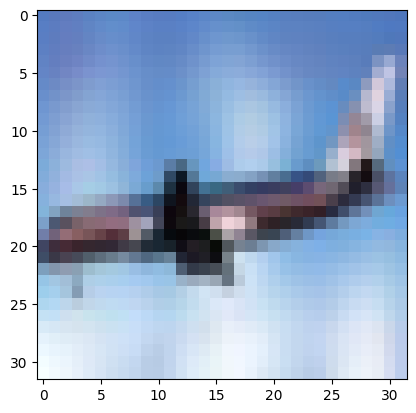

15


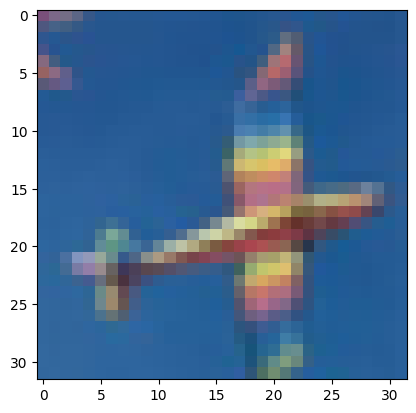

16


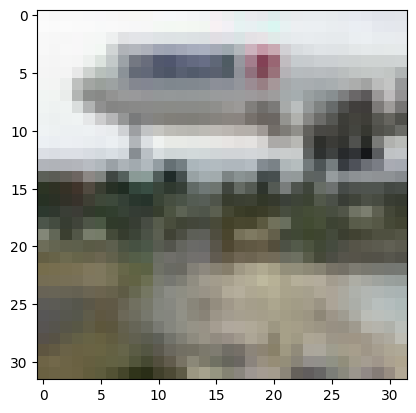

17


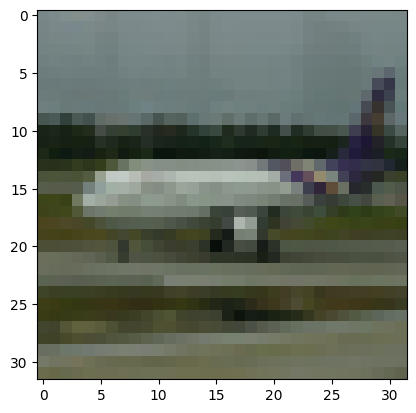

18


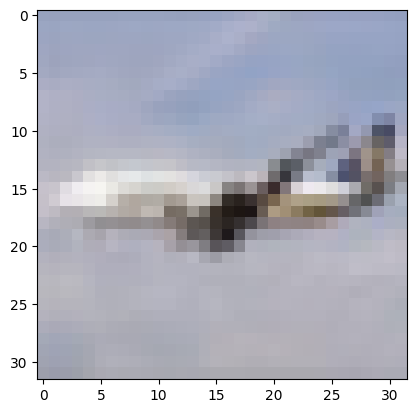

19


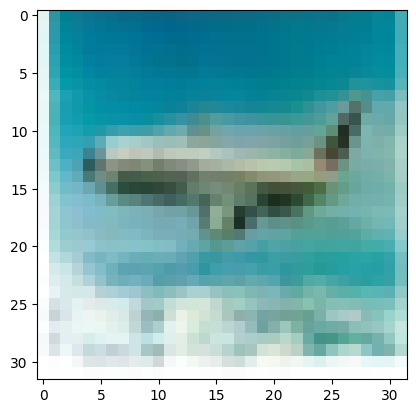

20


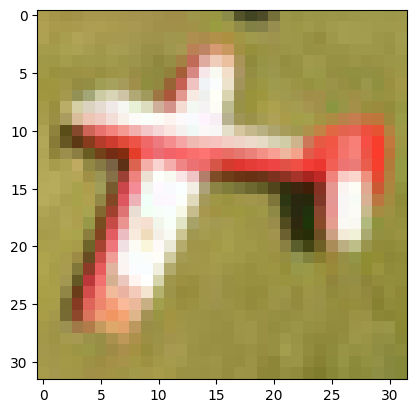

21


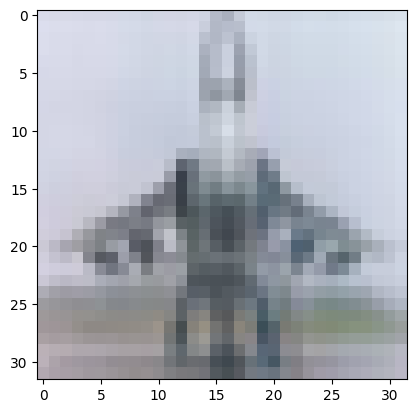

22


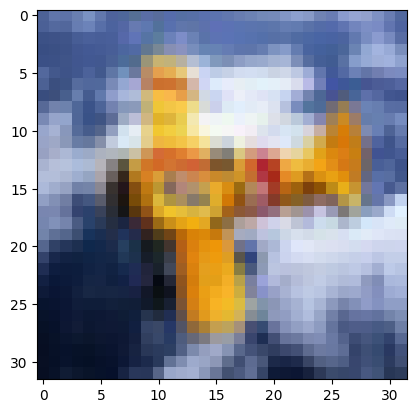

23


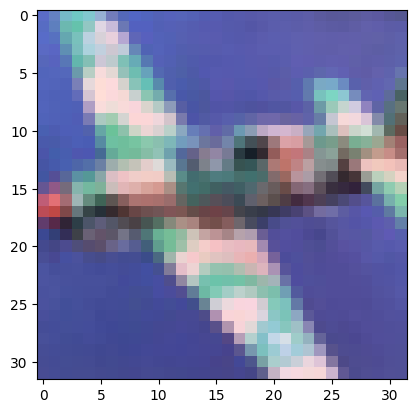

24


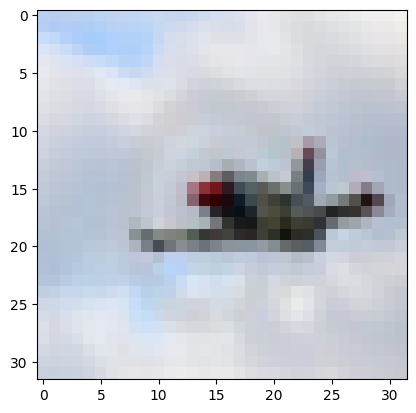

25


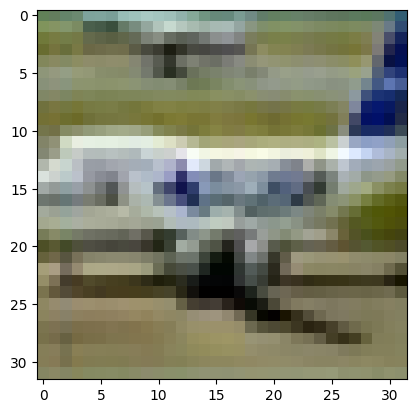

26


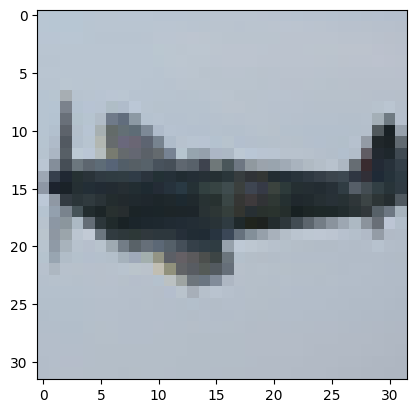

27


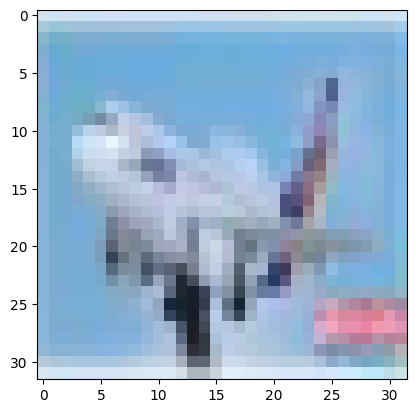

28


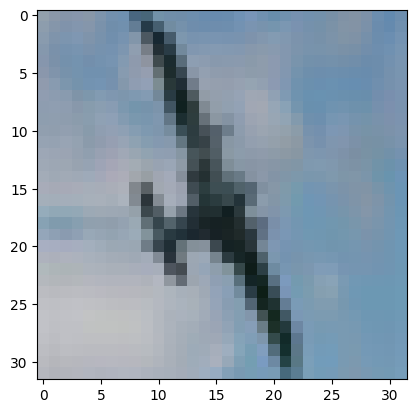

29


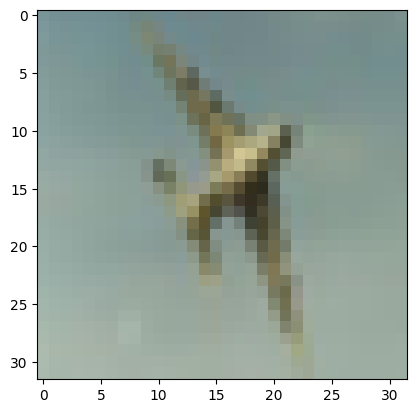

30


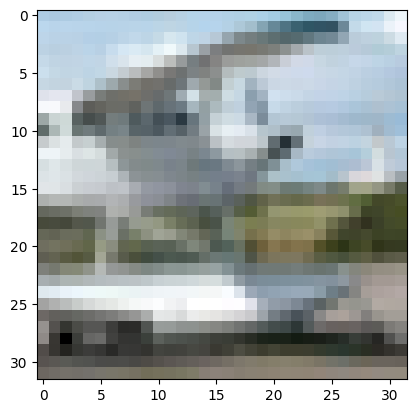

31


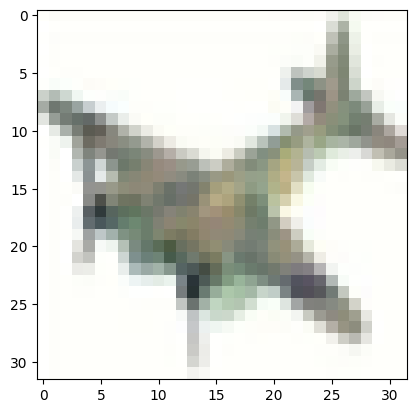

32


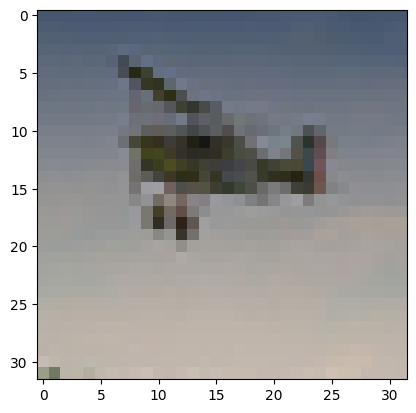

33


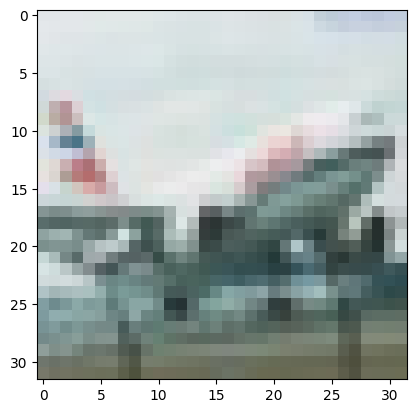

34


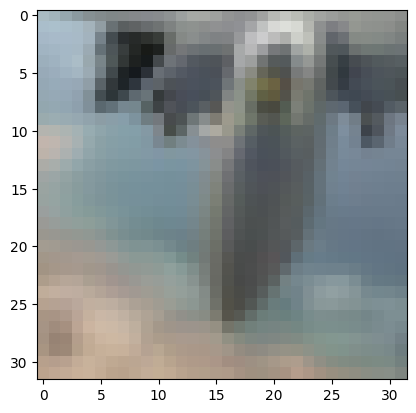

35


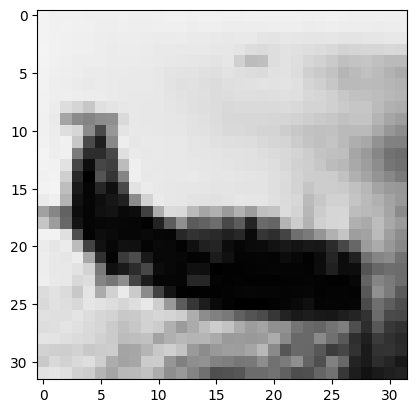

36


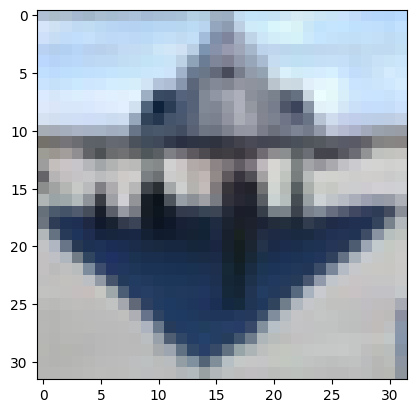

37


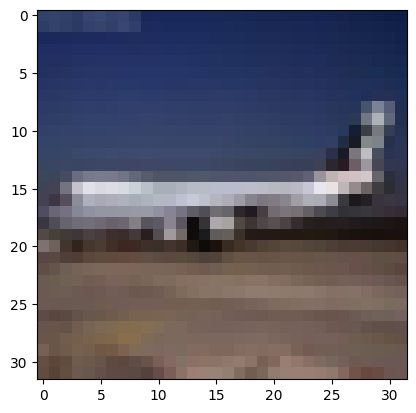

38


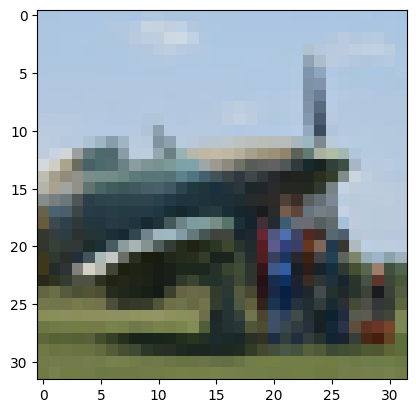

39


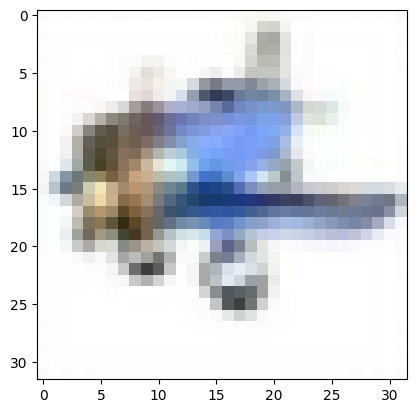

40


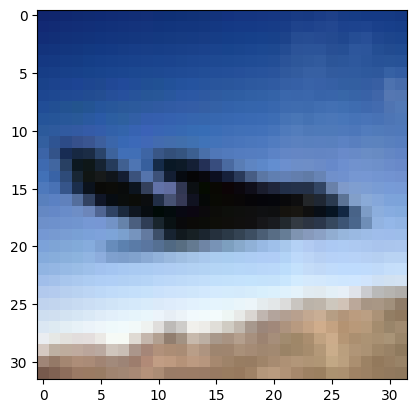

41


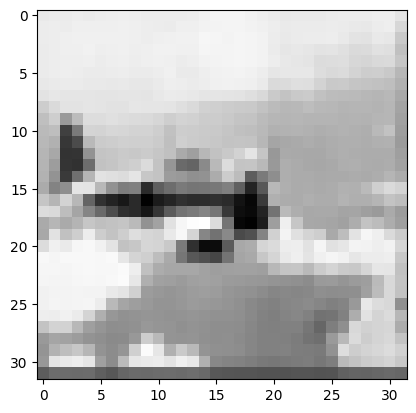

42


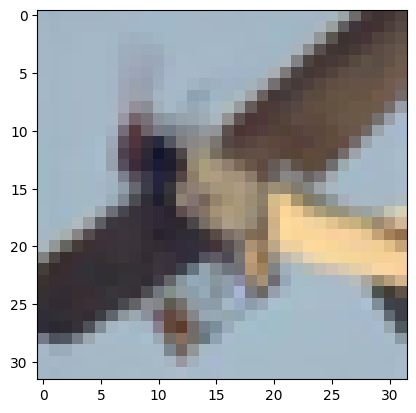

43


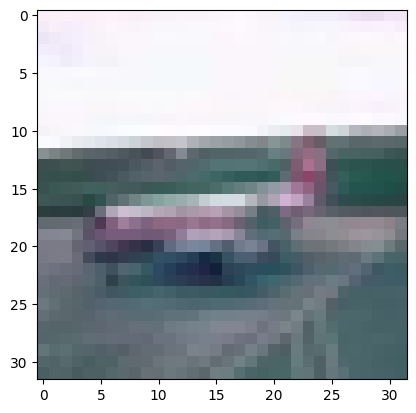

44


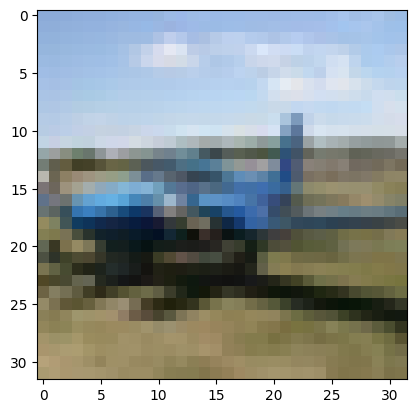

45


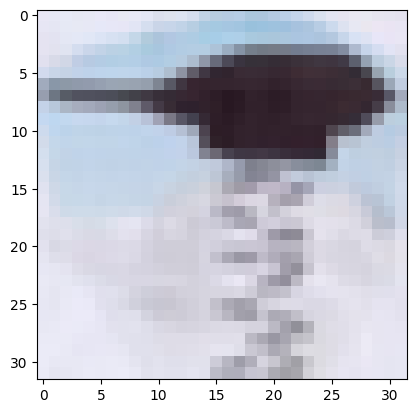

46


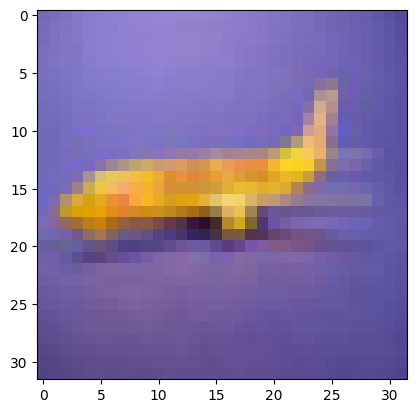

47


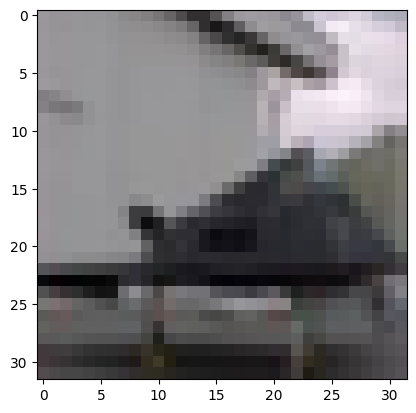

48


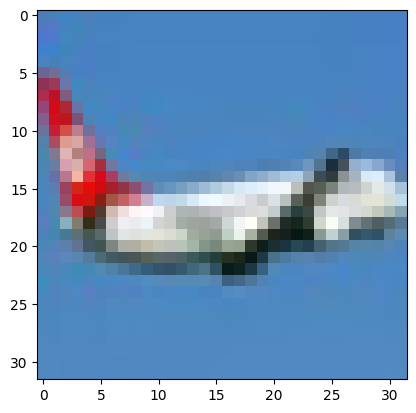

49


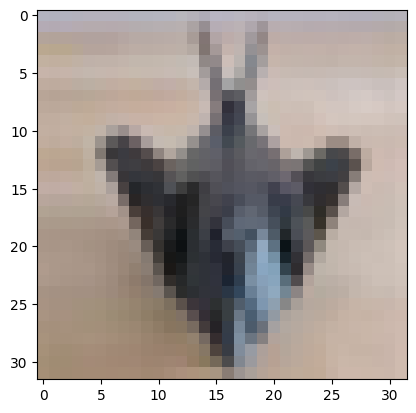

50


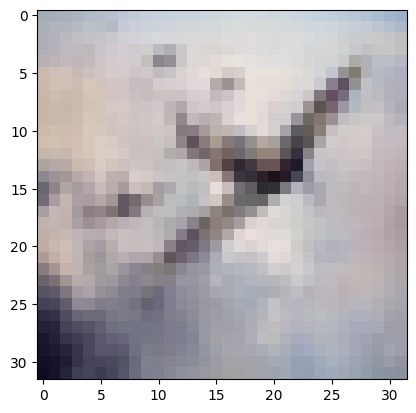

51


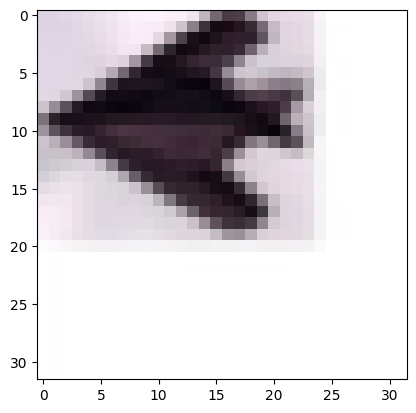

52


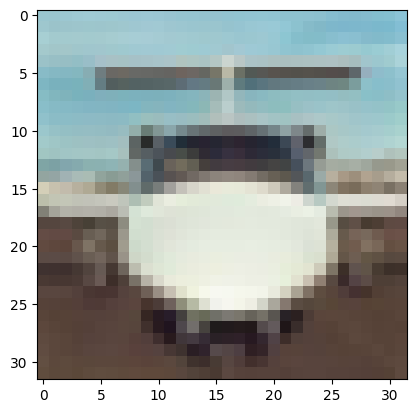

53


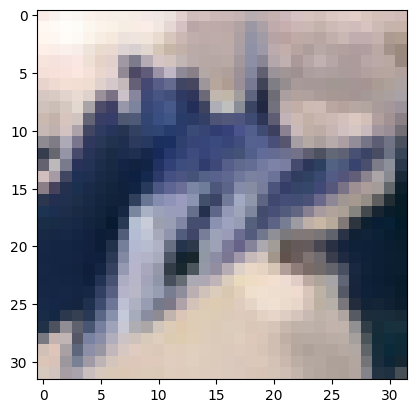

54


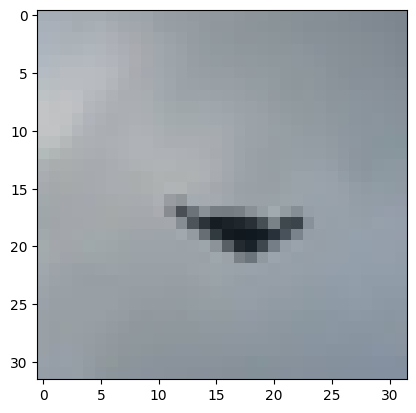

55


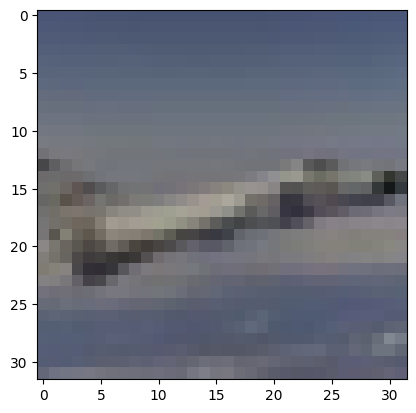

56


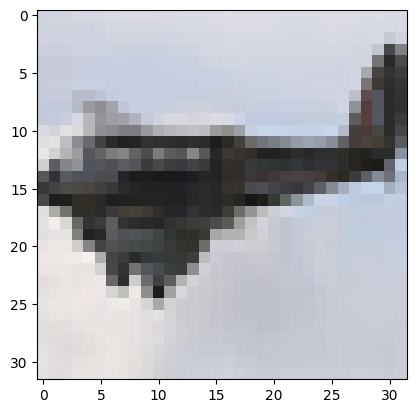

57


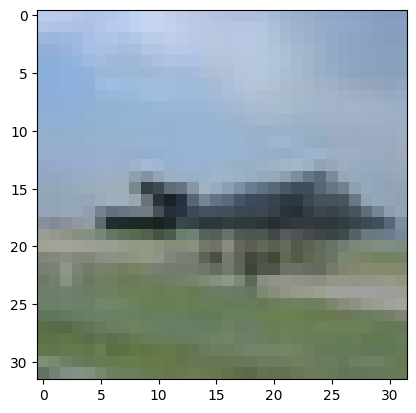

58


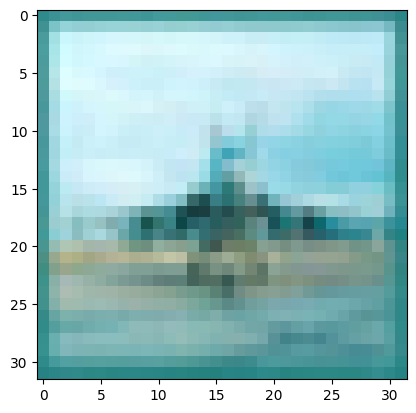

59


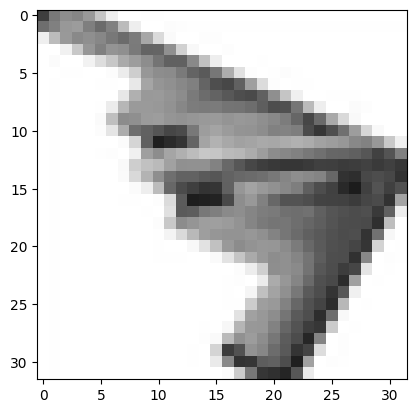

60


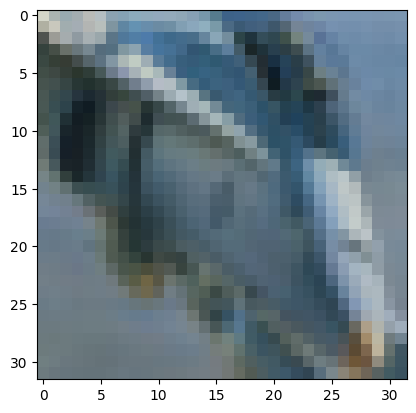

61


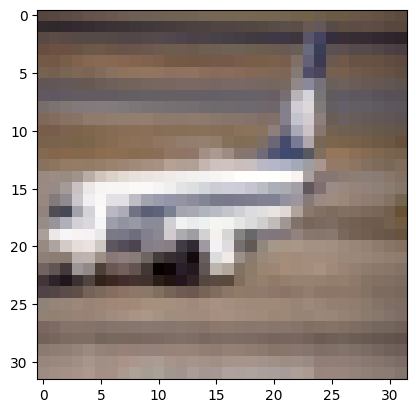

62


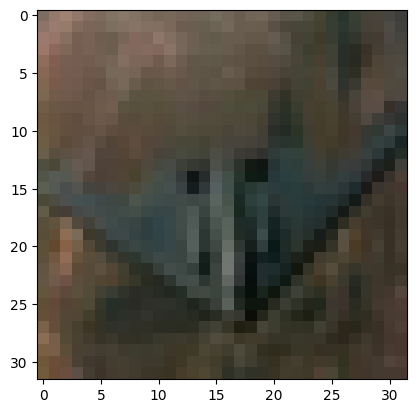

63


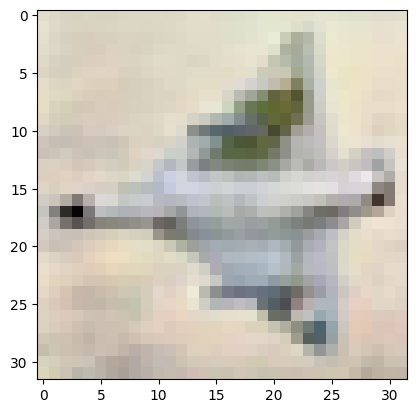

64


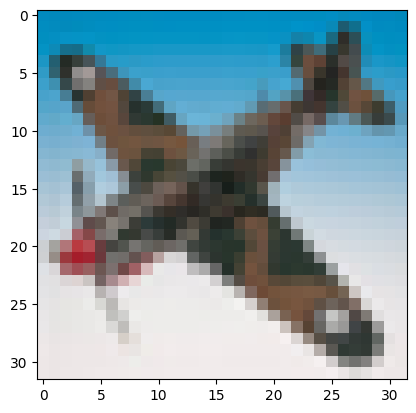

65


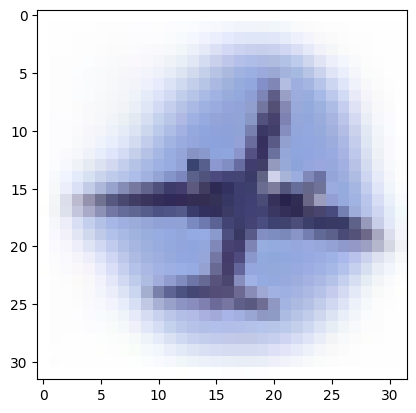

66


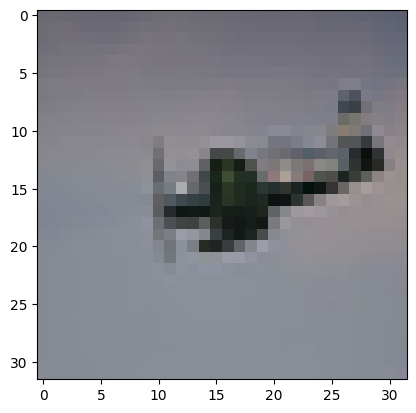

67


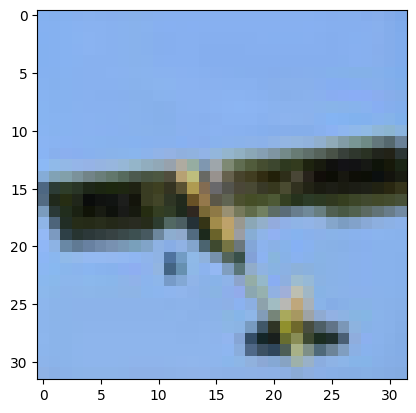

68


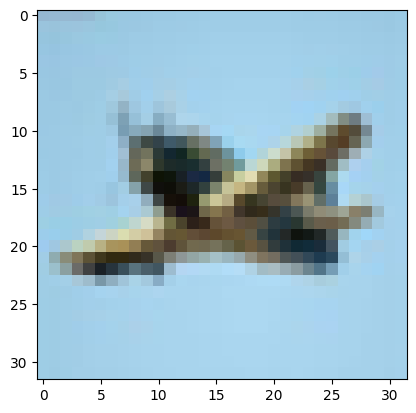

69


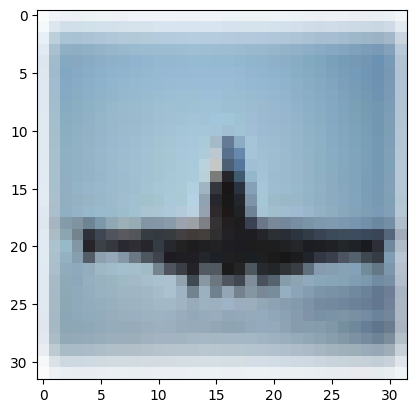

70


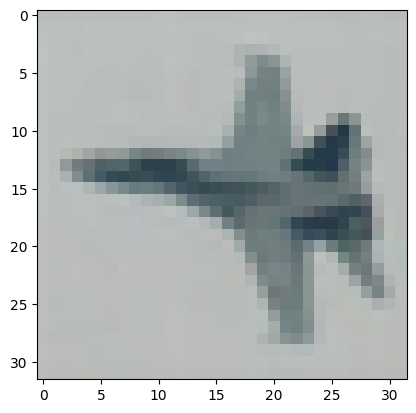

71


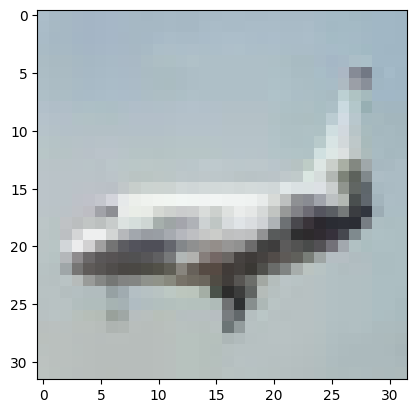

72


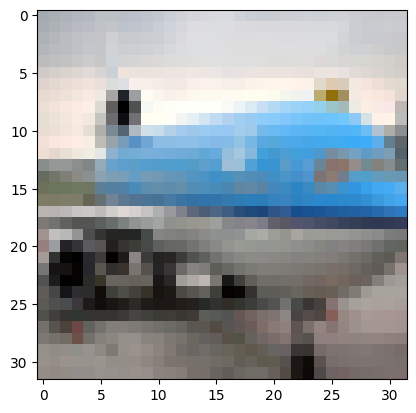

73


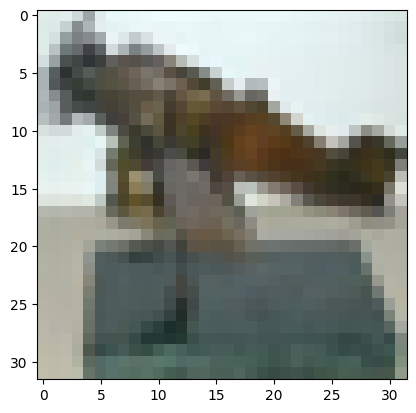

74


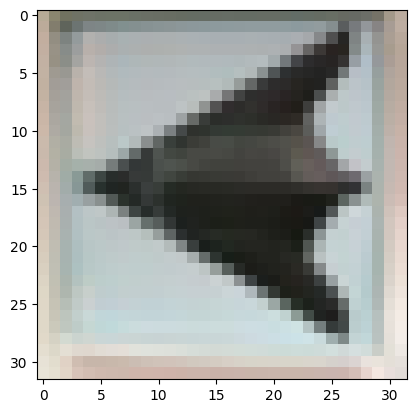

75


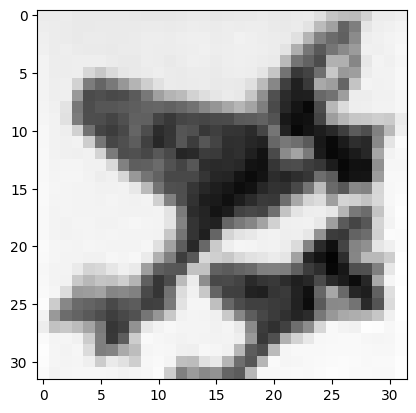

76


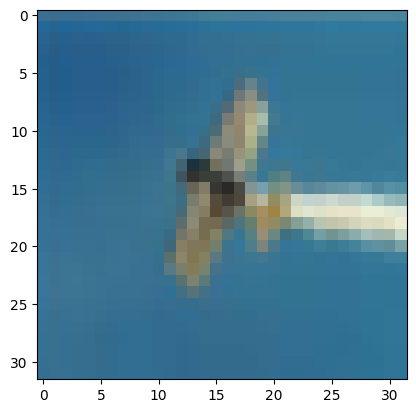

77


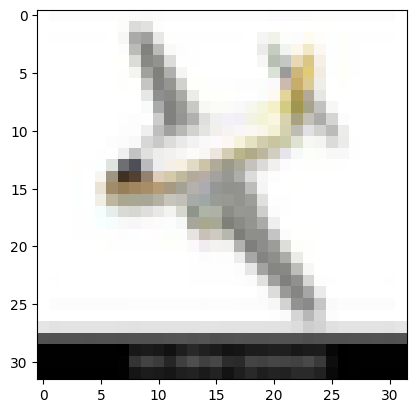

78


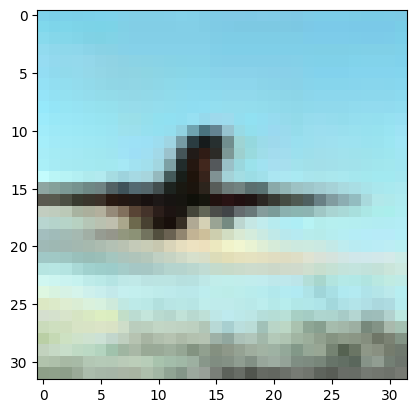

79


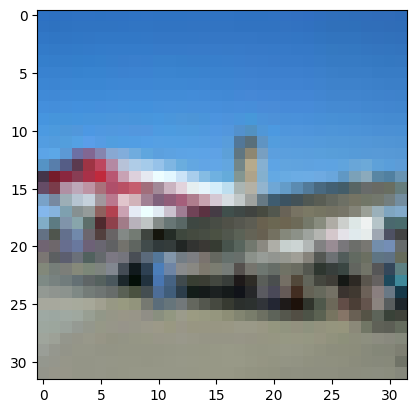

80


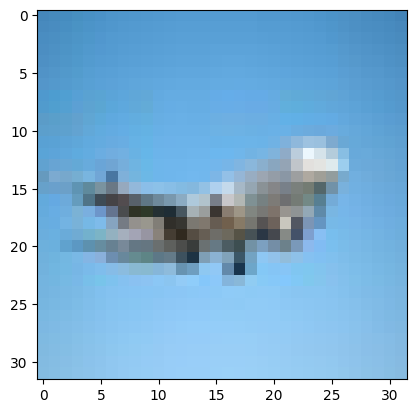

81


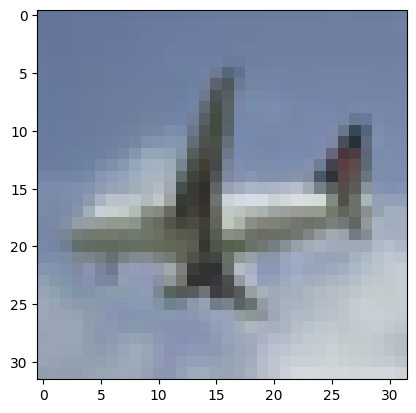

82


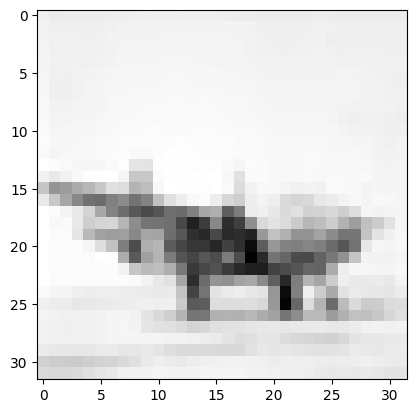

83


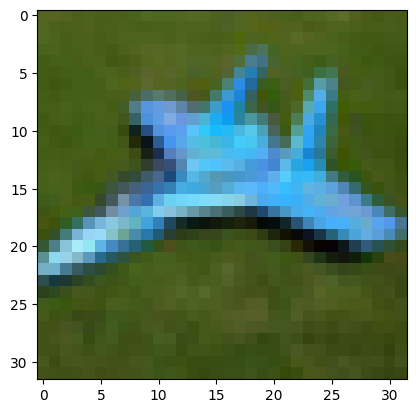

84


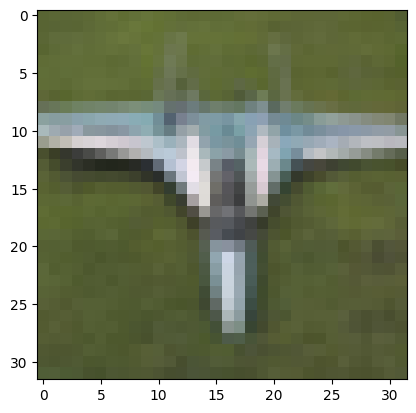

85


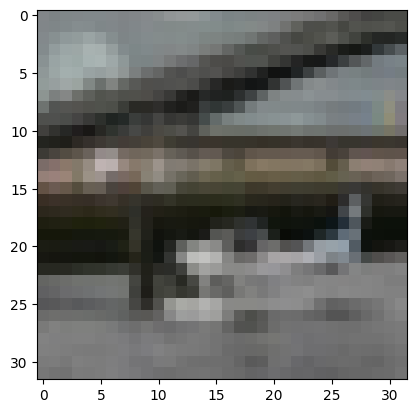

86


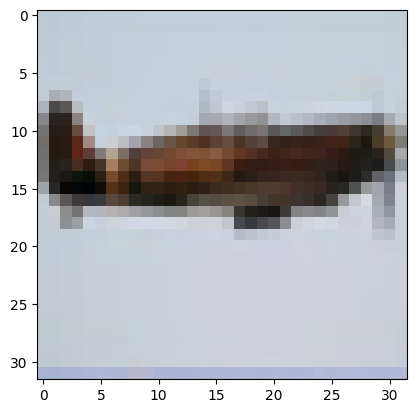

87


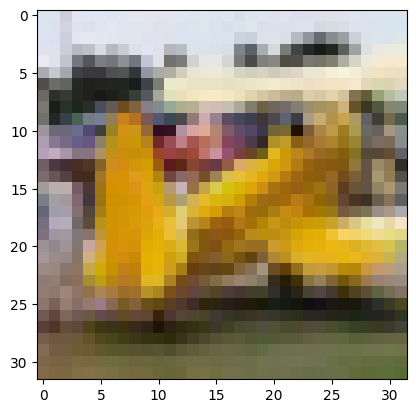

88


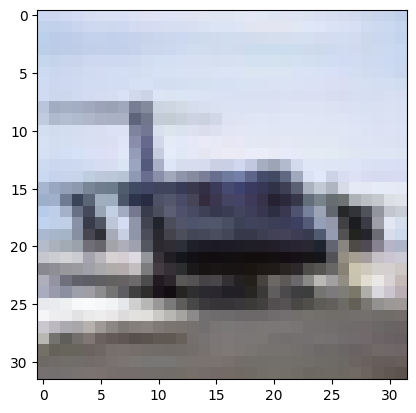

89


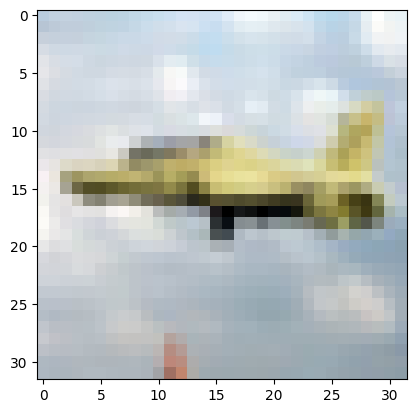

90


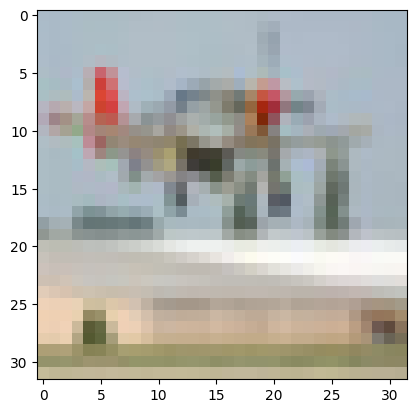

91


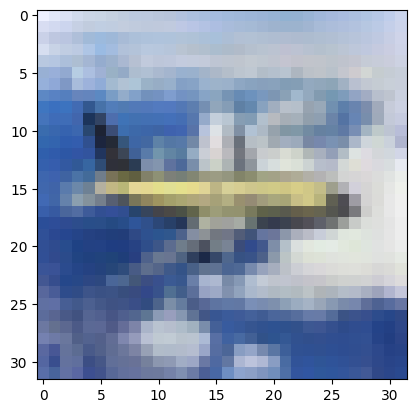

92


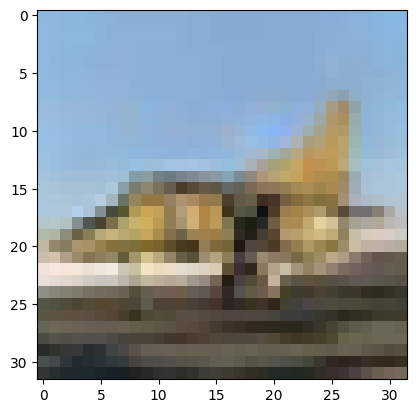

93


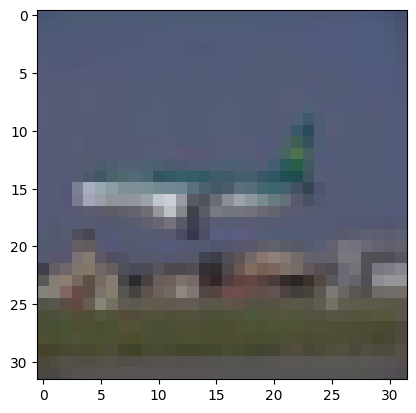

94


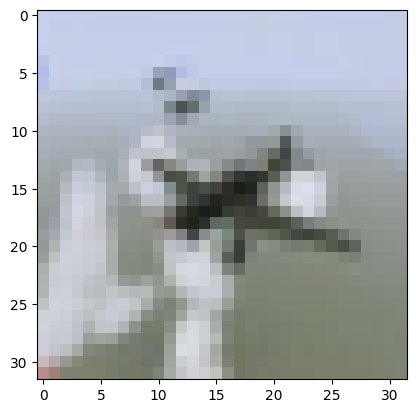

95


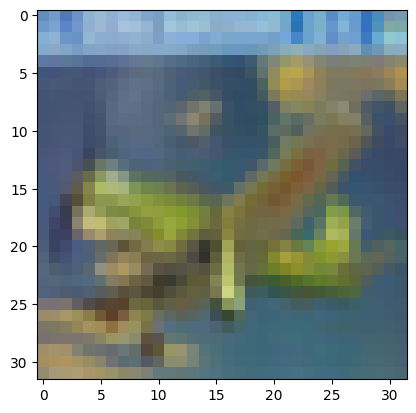

96


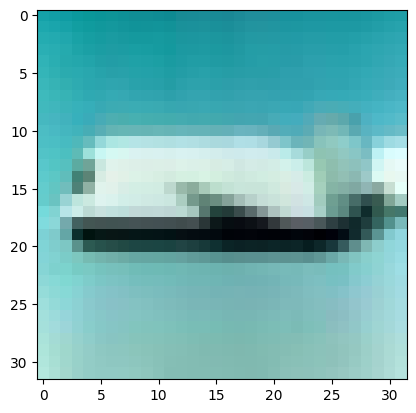

97


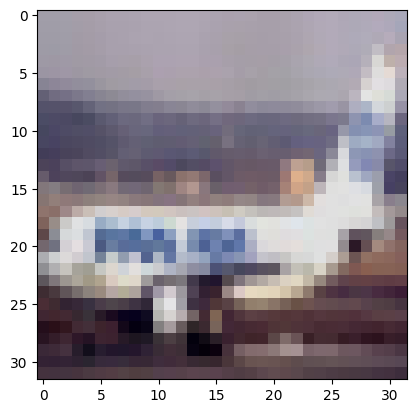

98


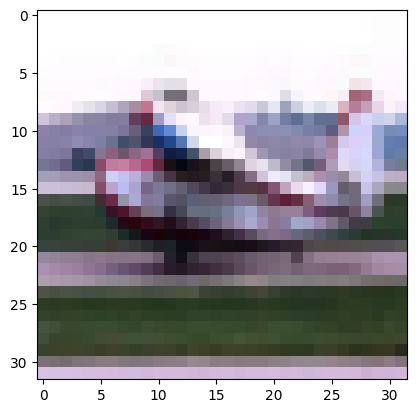

99


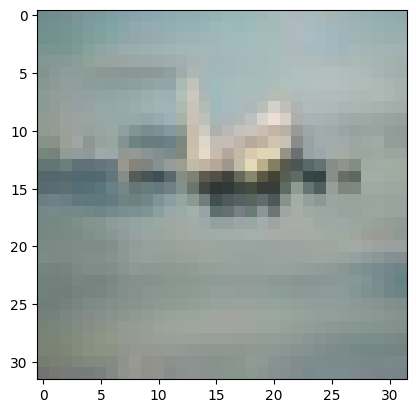

In [ ]:
# Load CIFAR-10
train_data = datasets.CIFAR10(root='./data', train=True, download=True)
clas = 0

# Get all ship images and labels
images0 = [img for img, label in train_data if label == clas]
#print(f"Number of 1 images: {len(ship_images)}")  # Output: 5000 (train)

for i in range(100):
  print(i)
  plt.imshow(images0[i])
  plt.show()

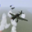

In [ ]:
images0[94]

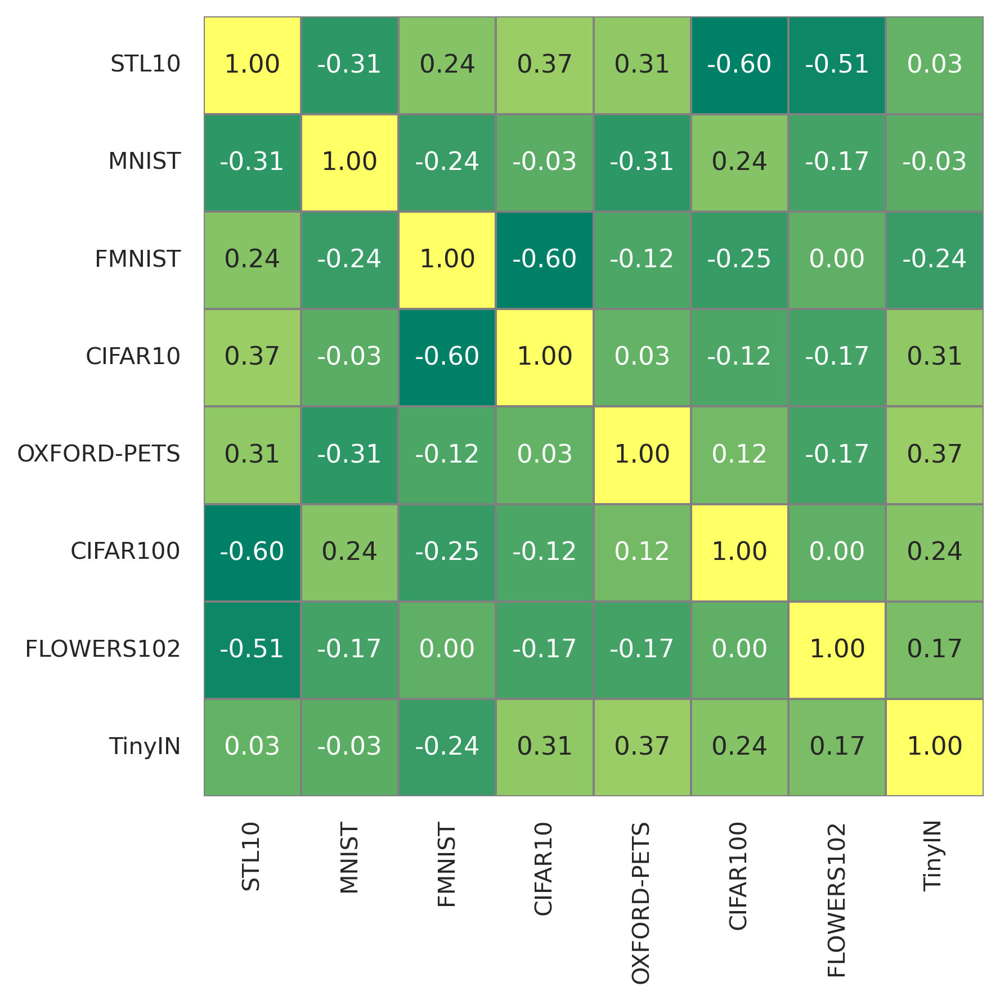

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import pandas as pd

# Dataset names
datasets = [
    "STL10", "MNIST", "FMNIST", "CIFAR10",
    "OXFORD-PETS", "CIFAR100", "FLOWERS102", "TinyIN"
]

# Correlation matrix data
correlation_matrix = np.array([
    [1.00, -0.31,  0.24,  0.37,  0.31, -0.60, -0.51,  0.03],
    [-0.31,  1.00, -0.24, -0.03, -0.31,  0.24, -0.17, -0.03],
    [0.24, -0.24,  1.00, -0.60, -0.12, -0.25,  0.00, -0.24],
    [0.37, -0.03, -0.60,  1.00,  0.03, -0.12, -0.17,  0.31],
    [0.31, -0.31, -0.12,  0.03,  1.00,  0.12, -0.17,  0.37],
    [-0.60,  0.24, -0.25, -0.12,  0.12,  1.00,  0.00,  0.24],
    [-0.51, -0.17,  0.00, -0.17, -0.17,  0.00,  1.00,  0.17],
    [0.03, -0.03, -0.24,  0.31,  0.37,  0.24,  0.17,  1.00]
])

# Create DataFrame
df = pd.DataFrame(correlation_matrix, index=datasets, columns=datasets)

# Plot heatmap without color bar
plt.figure(figsize=(8, 6), dpi=300)
sns.set(style="white", font_scale=0.9)
ax = sns.heatmap(df, annot=True, fmt=".2f", cmap="summer", cbar=False,
                 square=True, linewidths=0.5, linecolor='gray')

# Remove background
plt.gca().set_facecolor('none')
plt.savefig("correlation.png", dpi=300, bbox_inches='tight', transparent=True)
plt.show()


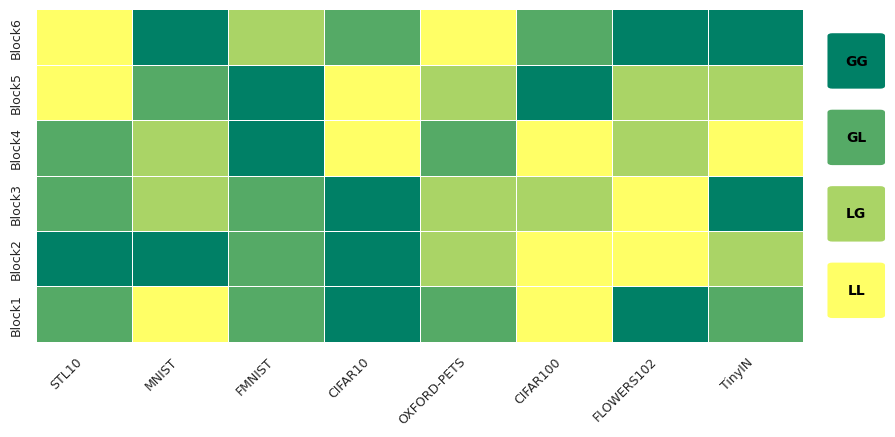

In [ ]:
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap, BoundaryNorm
from matplotlib.patches import FancyBboxPatch


# Define the data
data = np.array([
    [2, 1, 2, 2, 4, 4],  # STL10
    [4, 1, 3, 3, 2, 1],  # MNIST
    [2, 2, 2, 1, 1, 3],  # FMNIST
    [1, 1, 1, 4, 4, 2],  # CIFAR10
    [2, 3, 3, 2, 3, 4],  # OXFORD-PETS
    [4, 4, 3, 4, 1, 2],  # CIFAR100
    [1, 4, 4, 3, 3, 1],  # FLOWERS102
    [2, 3, 1, 4, 3, 1]   # TinyIN
])

# Flip vertically for heatmap layout
cmap_data = data.T[::-1]

# Labels
x_labels = ['STL10', 'MNIST', 'FMNIST', 'CIFAR10', 'OXFORD-PETS', 'CIFAR100', 'FLOWERS102', 'TinyIN']
y_labels = [f'Block{i+1}' for i in range(6)][::-1]

# Value-to-label mapping
label_mapping = {1: 'GG', 2: 'GL', 3: 'LG', 4: 'LL'}

# Create discrete colormap from 'summer'
base_cmap = plt.get_cmap('summer')
colors = base_cmap(np.linspace(0, 1, 4))
custom_cmap = ListedColormap(colors)
norm = BoundaryNorm([0.5, 1.5, 2.5, 3.5, 4.5], custom_cmap.N)

# Create figure
fig, ax = plt.subplots(figsize=(9, 4.5), facecolor='none')
fig.patch.set_alpha(0.0)
ax.set_facecolor('none')

# Draw heatmap
sns.heatmap(
    cmap_data,
    ax=ax,
    cmap=custom_cmap,
    cbar=False,
    square=False,
    linewidths=0.5,
    linecolor='white',
    xticklabels=x_labels,
    yticklabels=y_labels,
    norm=norm
)

# Rotate and align ticks
ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right', fontsize=9)
ax.set_yticklabels(ax.get_yticklabels(), fontsize=9)

# Remove spines
for spine in ax.spines.values():
    spine.set_visible(False)

# Add vertical cluemap to the right side
box_height = 0.9  # Fit in the total height
total_height = len(y_labels)
box_width = 0.5
spacing = (total_height - 4 * box_height) / 5  # 4 boxes + 5 spaces = 6 intervals
start_y = spacing
legend_x = len(x_labels) + 0.3  # To the right of heatmap

for i, k in enumerate(label_mapping):
    y = start_y + i * (box_height + spacing)
    box = FancyBboxPatch((legend_x, y), box_width, box_height,
                         boxstyle="round,pad=0.05", edgecolor='none',
                         facecolor=custom_cmap(norm(k)), transform=ax.transData, clip_on=False)
    ax.add_patch(box)
    ax.text(
    legend_x + box_width / 2, y + box_height / 2, label_mapping[k],
    ha='center', va='center', fontsize=10, color='black', fontweight='bold',
    transform=ax.transData
    )
# plt.title("asd")
plt.tight_layout()
plt.savefig("temprature_map.png", transparent=True, dpi=300)
plt.show()


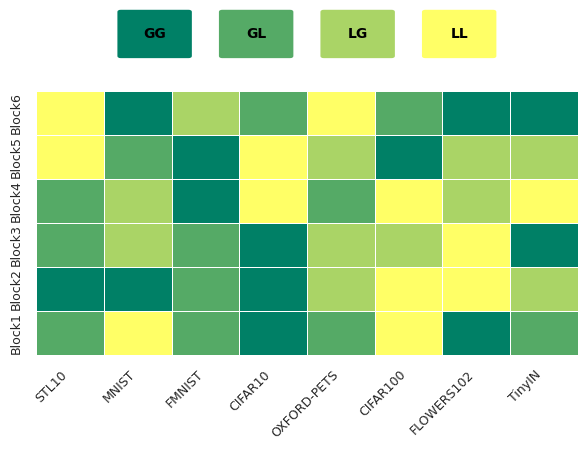

In [ ]:
# Adjust top legend alignment to be centered over the full heatmap width

data = np.array([
    [2, 1, 2, 2, 4, 4],  # STL10
    [4, 1, 3, 3, 2, 1],  # MNIST
    [2, 2, 2, 1, 1, 3],  # FMNIST
    [1, 1, 1, 4, 4, 2],  # CIFAR10
    [2, 3, 3, 2, 3, 4],  # OXFORD-PETS
    [4, 4, 3, 4, 1, 2],  # CIFAR100
    [1, 4, 4, 3, 3, 1],  # FLOWERS102
    [2, 3, 1, 4, 3, 1]   # TinyIN
])

fig, ax = plt.subplots(figsize=(6, 5), facecolor='none')  # Layout
fig.patch.set_alpha(0.0)
ax.set_facecolor('none')

sns.heatmap(
    cmap_data,
    ax=ax,
    cmap=custom_cmap,
    cbar=False,
    square=False,
    linewidths=0.5,
    linecolor='white',
    xticklabels=x_labels,
    yticklabels=y_labels,
    norm=norm
)

# Rotate labels
ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right', fontsize=9)
ax.set_yticklabels(ax.get_yticklabels(), fontsize=9)

# Remove spines
for spine in ax.spines.values():
    spine.set_visible(False)

# Parameters for centered top legend
cell_width = 1
cell_height = 1
num_boxes = len(label_mapping)
total_legend_width = num_boxes * cell_width + (num_boxes - 1) * 0.5
start_x = (len(x_labels) - total_legend_width) / 2
legend_y = -1.8

for i, k in enumerate(label_mapping):
    x = start_x + i * (cell_width + 0.5)
    box = FancyBboxPatch((x, legend_y), cell_width, cell_height,
                         boxstyle="round,pad=0.05", edgecolor='none',
                         facecolor=custom_cmap(norm(k)), transform=ax.transData, clip_on=False)
    ax.add_patch(box)
    ax.text(
        x + cell_width / 2, legend_y + cell_height / 2, label_mapping[k],
        ha='center', va='center', fontsize=10, color='black', fontweight='bold',
        transform=ax.transData
    )

plt.tight_layout()
plt.savefig("figg1.png", transparent=True, dpi=300)
plt.show()


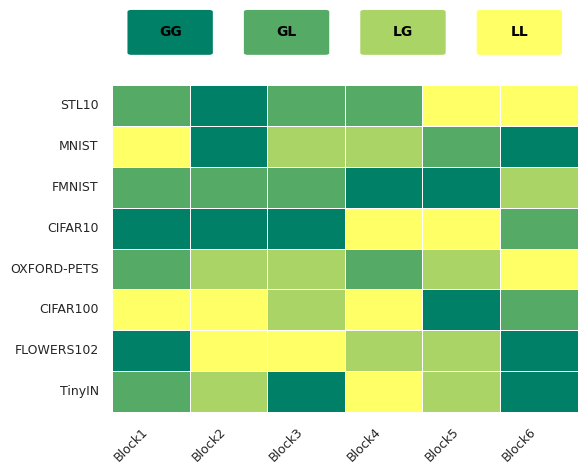

In [ ]:
# Re-generate the plot with datasets on the y-axis and blocks on the x-axis (flipped orientation)

import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap, BoundaryNorm
from matplotlib.patches import FancyBboxPatch

# Define the data
data = np.array([
    [2, 1, 2, 2, 4, 4],  # STL10
    [4, 1, 3, 3, 2, 1],  # MNIST
    [2, 2, 2, 1, 1, 3],  # FMNIST
    [1, 1, 1, 4, 4, 2],  # CIFAR10
    [2, 3, 3, 2, 3, 4],  # OXFORD-PETS
    [4, 4, 3, 4, 1, 2],  # CIFAR100
    [1, 4, 4, 3, 3, 1],  # FLOWERS102
    [2, 3, 1, 4, 3, 1]   # TinyIN
])

# Flip the orientation: datasets on y-axis, blocks on x-axis
cmap_data = data  # Shape: [datasets x blocks]

# Labels
x_labels = [f'Block{i+1}' for i in range(6)]
y_labels = ['STL10', 'MNIST', 'FMNIST', 'CIFAR10', 'OXFORD-PETS', 'CIFAR100', 'FLOWERS102', 'TinyIN']

# Value-to-label mapping
label_mapping = {1: 'GG', 2: 'GL', 3: 'LG', 4: 'LL'}

# Create discrete colormap from 'summer'
base_cmap = plt.get_cmap('summer')
colors = base_cmap(np.linspace(0, 1, 4))
custom_cmap = ListedColormap(colors)
norm = BoundaryNorm([0.5, 1.5, 2.5, 3.5, 4.5], custom_cmap.N)

# Create figure
fig, ax = plt.subplots(figsize=(6, 5), facecolor='none')
fig.patch.set_alpha(0.0)
ax.set_facecolor('none')

# Draw heatmap
sns.heatmap(
    cmap_data,
    ax=ax,
    cmap=custom_cmap,
    cbar=False,
    square=False,
    linewidths=0.5,
    linecolor='white',
    xticklabels=x_labels,
    yticklabels=y_labels,
    norm=norm
)

# Rotate and align ticks
ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right', fontsize=9)
ax.set_yticklabels(ax.get_yticklabels(), fontsize=9)

# Remove spines
for spine in ax.spines.values():
    spine.set_visible(False)

# Add top legend aligned over heatmap
cell_width = 1
cell_height = 1
num_boxes = len(label_mapping)
total_legend_width = num_boxes * cell_width + (num_boxes - 1) * 0.5
start_x = (len(x_labels) - total_legend_width) / 2
legend_y = -1.8

for i, k in enumerate(label_mapping):
    x = start_x + i * (cell_width + 0.5)
    box = FancyBboxPatch((x, legend_y), cell_width, cell_height,
                         boxstyle="round,pad=0.05", edgecolor='none',
                         facecolor=custom_cmap(norm(k)), transform=ax.transData, clip_on=False)
    ax.add_patch(box)
    ax.text(
        x + cell_width / 2, legend_y + cell_height / 2, label_mapping[k],
        ha='center', va='center', fontsize=10, color='black', fontweight='bold',
        transform=ax.transData
    )

plt.tight_layout()
plt.savefig("figg1.png", transparent=True, dpi=300)
plt.show()


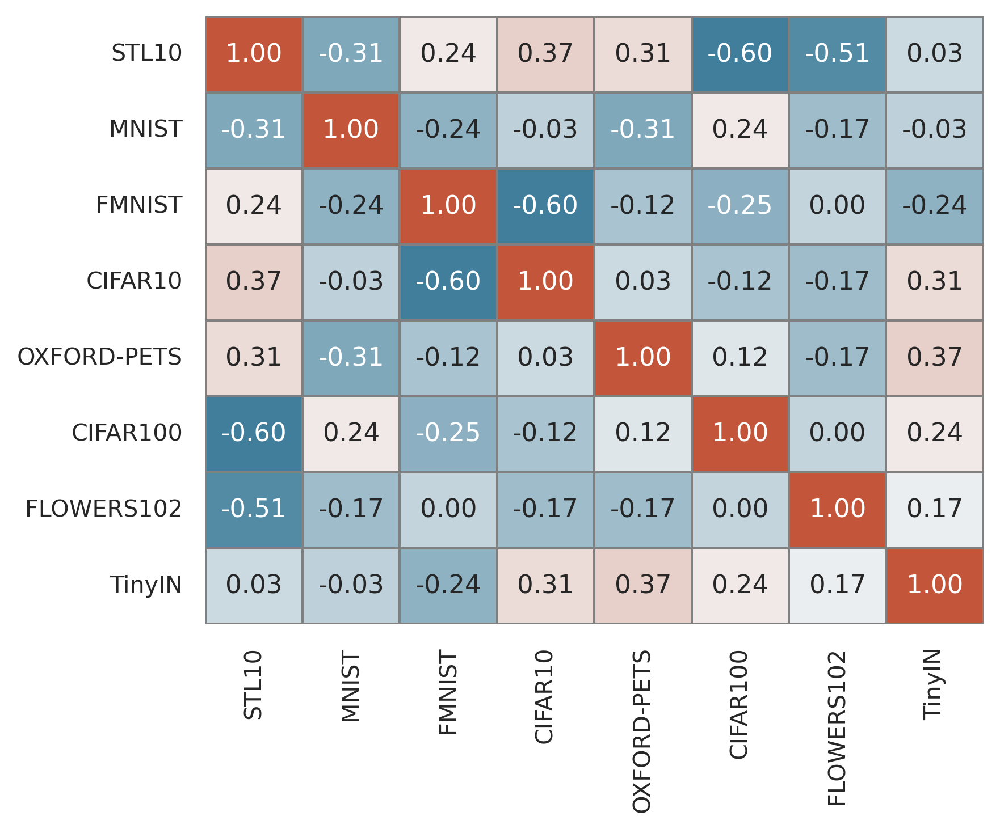

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import pandas as pd

# Dataset names
datasets = [
    "STL10", "MNIST", "FMNIST", "CIFAR10",
    "OXFORD-PETS", "CIFAR100", "FLOWERS102", "TinyIN"
]

# Correlation matrix data
correlation_matrix = np.array([
    [1.00, -0.31,  0.24,  0.37,  0.31, -0.60, -0.51,  0.03],
    [-0.31,  1.00, -0.24, -0.03, -0.31,  0.24, -0.17, -0.03],
    [0.24, -0.24,  1.00, -0.60, -0.12, -0.25,  0.00, -0.24],
    [0.37, -0.03, -0.60,  1.00,  0.03, -0.12, -0.17,  0.31],
    [0.31, -0.31, -0.12,  0.03,  1.00,  0.12, -0.17,  0.37],
    [-0.60,  0.24, -0.25, -0.12,  0.12,  1.00,  0.00,  0.24],
    [-0.51, -0.17,  0.00, -0.17, -0.17,  0.00,  1.00,  0.17],
    [0.03, -0.03, -0.24,  0.31,  0.37,  0.24,  0.17,  1.00]
])

# Create DataFrame
df = pd.DataFrame(correlation_matrix, index=datasets, columns=datasets)

# Plot heatmap with fixed height to match the previous layout
fig, ax = plt.subplots(figsize=(6, 5), dpi=300, facecolor='none')
fig.patch.set_alpha(0.0)
sns.set(style="white", font_scale=0.9)


cmap = sns.diverging_palette(230, 20, as_cmap=True)

sns.heatmap(df, annot=True, fmt=".2f", cmap=cmap, cbar=False,
            square=False, linewidths=0.5, linecolor='gray',
            ax=ax)

# Remove background
ax.set_facecolor('none')
plt.tight_layout()
plt.savefig("figg2.png", dpi=300, transparent=True)
plt.show()


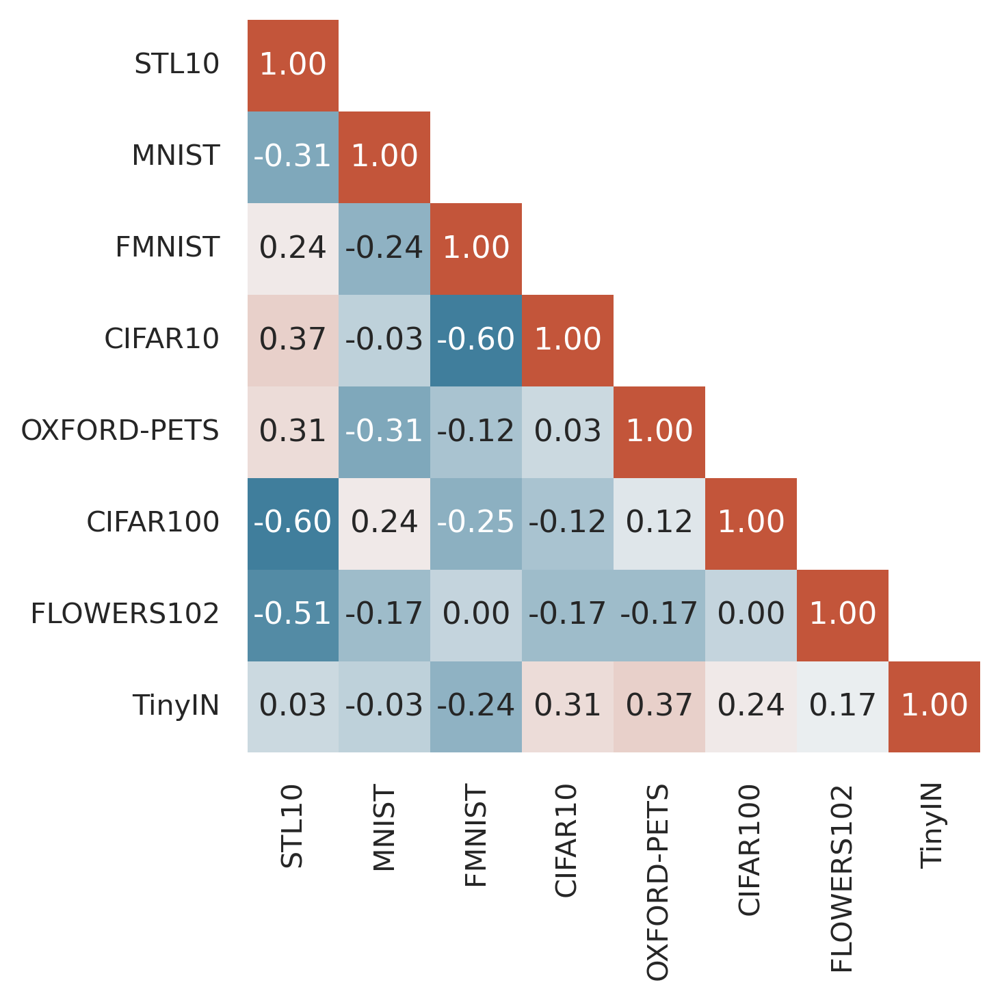

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import pandas as pd

# Dataset names
datasets = [
    "STL10", "MNIST", "FMNIST", "CIFAR10",
    "OXFORD-PETS", "CIFAR100", "FLOWERS102", "TinyIN"
]

# Correlation matrix data
correlation_matrix = np.array([
    [1.00, -0.31,  0.24,  0.37,  0.31, -0.60, -0.51,  0.03],
    [-0.31,  1.00, -0.24, -0.03, -0.31,  0.24, -0.17, -0.03],
    [0.24, -0.24,  1.00, -0.60, -0.12, -0.25,  0.00, -0.24],
    [0.37, -0.03, -0.60,  1.00,  0.03, -0.12, -0.17,  0.31],
    [0.31, -0.31, -0.12,  0.03,  1.00,  0.12, -0.17,  0.37],
    [-0.60,  0.24, -0.25, -0.12,  0.12,  1.00,  0.00,  0.24],
    [-0.51, -0.17,  0.00, -0.17, -0.17,  0.00,  1.00,  0.17],
    [0.03, -0.03, -0.24,  0.31,  0.37,  0.24,  0.17,  1.00]
])

# Create DataFrame
df = pd.DataFrame(correlation_matrix, index=datasets, columns=datasets)

# Set up the matplotlib figure
fig, ax = plt.subplots(figsize=(6, 5), dpi=300, facecolor='none')
fig.patch.set_alpha(0.0)
sns.set(style="white", font_scale=0.9)

# Create a diverging colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)

# Draw the heatmap without borders
sns.heatmap(df, annot=True, fmt=".2f", cmap=cmap, cbar=False,
            square=True, linewidths=0, linecolor='white',
            ax=ax, mask=np.triu(np.ones_like(df, dtype=bool), k=1))

# Remove background
ax.set_facecolor('none')
plt.tight_layout()
plt.savefig("figg2.png", dpi=300, transparent=True)
plt.show()


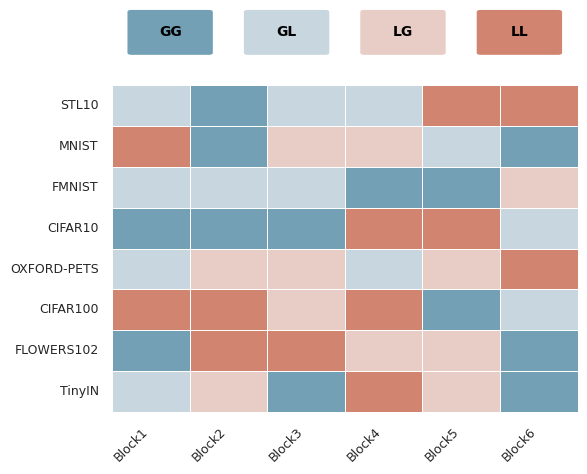

In [ ]:
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap, BoundaryNorm
from matplotlib.patches import FancyBboxPatch

# Define the data
data = np.array([
    [2, 1, 2, 2, 4, 4],  # STL10
    [4, 1, 3, 3, 2, 1],  # MNIST
    [2, 2, 2, 1, 1, 3],  # FMNIST
    [1, 1, 1, 4, 4, 2],  # CIFAR10
    [2, 3, 3, 2, 3, 4],  # OXFORD-PETS
    [4, 4, 3, 4, 1, 2],  # CIFAR100
    [1, 4, 4, 3, 3, 1],  # FLOWERS102
    [2, 3, 1, 4, 3, 1]   # TinyIN
])

# Flip the orientation: datasets on y-axis, blocks on x-axis
cmap_data = data  # Shape: [datasets x blocks]

# Labels
x_labels = [f'Block{i+1}' for i in range(6)]
y_labels = ['STL10', 'MNIST', 'FMNIST', 'CIFAR10', 'OXFORD-PETS', 'CIFAR100', 'FLOWERS102', 'TinyIN']

# Value-to-label mapping
label_mapping = {1: 'GG', 2: 'GL', 3: 'LG', 4: 'LL'}

# Use diverging_palette (same as correlation heatmap) for consistency
base_cmap = sns.diverging_palette(230, 20, as_cmap=True)
colors = base_cmap(np.linspace(0.15, 0.85, 4))  # Sample 4 colors from center range
custom_cmap = ListedColormap(colors)
norm = BoundaryNorm([0.5, 1.5, 2.5, 3.5, 4.5], custom_cmap.N)

# Create figure
fig, ax = plt.subplots(figsize=(6, 5), facecolor='none')
fig.patch.set_alpha(0.0)
ax.set_facecolor('none')

# Draw heatmap
sns.heatmap(
    cmap_data,
    ax=ax,
    cmap=custom_cmap,
    cbar=False,
    square=False,
    linewidths=0.5,
    linecolor='white',
    xticklabels=x_labels,
    yticklabels=y_labels,
    norm=norm
)

# Rotate and align ticks
ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right', fontsize=9)
ax.set_yticklabels(ax.get_yticklabels(), fontsize=9)

# Remove spines
for spine in ax.spines.values():
    spine.set_visible(False)

# Add top legend aligned over heatmap
cell_width = 1
cell_height = 1
num_boxes = len(label_mapping)
total_legend_width = num_boxes * cell_width + (num_boxes - 1) * 0.5
start_x = (len(x_labels) - total_legend_width) / 2
legend_y = -1.8

for i, k in enumerate(label_mapping):
    x = start_x + i * (cell_width + 0.5)
    box = FancyBboxPatch((x, legend_y), cell_width, cell_height,
                         boxstyle="round,pad=0.05", edgecolor='none',
                         facecolor=custom_cmap(norm(k)), transform=ax.transData, clip_on=False)
    ax.add_patch(box)
    ax.text(
        x + cell_width / 2, legend_y + cell_height / 2, label_mapping[k],
        ha='center', va='center', fontsize=10, color='black', fontweight='bold',
        transform=ax.transData
    )

plt.tight_layout()
plt.savefig("figg1.png", transparent=True, dpi=300)
plt.show()
